<img src="escudo_utfsm.gif" style="float:right;height:100px">
<img src="IsotipoDIisocolor.png" style="float:left;height:100px">
<center>
    <h1> ILI286 Computación Científica I</h1>
    <h1> Tarea N°2: Busqueda de ceros 1D</h1>
    <h3> Carlos Tomas Molina Yugovic </h3>
    <h3> 201273507-6 </h3>
    <h3> carlos.molina.12@sansano.usm.cl</h3></center>
</center>

<p>
<center>_Marzo 2018_ </center>
</p>

In [403]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import scipy.optimize as optimize
from matplotlib import gridspec
from ipywidgets import widgets,fixed
from matplotlib.image import BboxImage
from matplotlib.transforms import Bbox, TransformedBbox

## Introducción

Las raices de una función $f(x)$ se definen como los valores $r$ donde función es $0$, es decir $f(r)=0$. En otras palabras, encontrar las raices de $f(x)$ es equivalente a resolver la ecuación:

$$
f(r) = 0.
$$

Uno de los tantos problemas que podemos resolver a través de búsqueda de ceros es un típico problema de física, el lanzamiento de un proyectil. El contexto es el siguiente: Tenemos un cañón que dispara un proyectil con ciertos parámetros iniciales (rapidez y ángulo). Sabiendo estos datos, la pregunta es ¿Cómo encontramos la trayectoria recorrida por el proyectil dado el contexto del problema?. Para esto, contamos con dos ecuaciones importantes:

\begin{align}
x(t) &= v\,\cos(\theta)\,t \\
y(t) &= v\,\sin(\theta)\,t - \frac{1}{2}\,g\,t^2
\end{align}

## Pregunta 1 [10 puntos]

a) Encuentre una expresión que acople estas dos ecuaciónes y que esta dependa de la posición $x$, el angulo $\theta$ y la velocidad $v$.

b) Usando la ecuación anterior, encuentre las expresiones para encontrar la distancia $d$ recorrida en el eje x por el proyectil, el angulo $\theta$ de lanzamiento y la velocidad necesaría para que el proyectil recorra la distancia $d$.

## Desarrollo y Análisis de Resultados
### a)
Despejando t en la primera ecuación y reemplazandolo en la segunda, se tiene:
$$y(t)=x\cdot tan(\theta)-\frac{g\cdot x^2}{2\cdot v^2\cdot cos^2(\theta)}$$




### b)
Ya que se busca la distancia en el eje x, se reemplaza y=0 y se despeja x:
$$d=\frac{sen(\theta)\cdot cos(\theta)\cdot 2 \cdot v^2}{g} $$


Reemplazando la igualdad $$2\cdot sen(\theta)\cdot cos(\theta)=sen(2\theta)$$ en la ecuación anterior, se obtiene:
$$d=\frac{sen(2\theta)\cdot v^2}{g}$$
$$sen(2\theta)=\frac{d\cdot g}{v^2}$$
$$\theta=\frac{arcsin(\frac{d\cdot g}{v^2})}{2}$$

Para calcular v, lo despejamos de la ecuación de distancia de x:
$$v^2=\frac{d\cdot g}{sen(2\theta)}$$
$$v=\sqrt{\frac{d\cdot g}{sen(2\theta)}}$$

## Pregunta 2  [20 puntos]

Implemente los algoritmos de búsqueda de cero punto fijo, bisección y newton. Resuelva los siguientes casos:

   * Usando $d = 900, \theta = 20º$, encuentre el valor de $v$.
   * Usando $d = 900, v = 100$, encuentre el valor de $\theta$.
   * Usando $v = 100, \theta = 20º$, encuentre el valor de $d$.
   
a) Realice un gráfico por cada item donde se comparen el como se acerca cada método al valor real en cada iteración (usted define el número de iteraciones, pero recuerde que su resultado debe ser interpretable. Puede usar un bajo número de iteraciones, para que su resultado sea significativo dentro del contexto de búsqueda de ceros y los algoritmos involucrados). Muestre además, un gráfico de convergencia por cada item. Concluya.

b) Muestre con un _widget_ la trayectoria del proyectil a través del tiempo. 

## Desarrollo y Análisis de Resultados
### a)
Se implementan los algoritmos del jupyter notebook del profesor [[1]](#bib), con algunos cambios, para responder a las preguntas de la tarea.

In [473]:
def bisect(f, a, b,realValue, tol=1e-10):
    fa = f(a)
    fb = f(b)
    i = 0
    # Just checking if the sign is not negative => not root  necessarily 
    if np.sign(f(a)*f(b)) >= 0:
        print('f(a)f(b)<0 not satisfied!')
        return None
  
    #Printing the evolution of the computation of the root
    print(' i |     a     |     c     |     b     |     fa    |     fc     |     fb     |   b-a')
    print('----------------------------------------------------------------------------------------')
    values=[]
    errors=[]
    while(b-a)/2 > tol:
        c = (a+b)/2.
        fc = f(c)
        print('%2d | %.7f | %.7f | %.7f | %.7f | %.7f | %.7f | %.7f' %
              (i+1, a, c, b, fa, fc, fb, b-a))
        # Did we find the root?
        if fc == 0:
            print('f(c)==0')
            break
        elif np.sign(fa*fc) < 0:
            b = c
            fb = fc
        else:
            a = c
            fa = fc
        i += 1
        values.append(c)
        errors.append(np.abs(c-realValue))
    
    values.append((a+b)/2)
    errors.append(np.abs((a+b)/2-realValue))
    return values,errors

def fpi(g, x0, k,realValue):
    x = np.empty(k+1)
    x[0] = x0
    error_i = np.inf
    
    print(' i |     x(i)     |    x(i+1)    ||x(i+1)-x(i)| | e_i/e_{i-1}')
    print('--------------------------------------------------------------')
    values=[]
    values.append(x0)
    errors=[]
    errors.append(np.abs(realValue-x0))
    for i in range(k):
        x[i+1] = g(x[i])
        values.append(x[i+1]);
        errors.append(np.abs(realValue-x[i+1]))
        error_iminus1 = error_i
        error_i = abs(x[i+1]-x[i])
        print('%2d | %.10f | %.10f | %.10f | %.10f' %
              (i,x[i],x[i+1],error_i,error_i/error_iminus1))
    return x,errors

def newton_method(f, fp, x0, realValue,rel_error=1e-8, m=1):
    #Initialization of hybrid error and absolute
    hybrid_error = 100
    error_i = np.inf
    
    print('i |     x(i)     |     x(i+1)   |      |x(i+1)-x(i)|     |  e_i/e_{i-1} | e_i/e_{i-1}^2')
    print('----------------------------------------------------------------------------------------')
    
    values=[]
    values.append(x0)
    errors=[]
    errors.append(np.abs(realValue-x0))
    #Iteration counter
    i = 1
    while (hybrid_error > rel_error and hybrid_error < 1e12 and i < 1e4):
        #Newton's iteration
        x1 = x0-m*f(x0)/fp(x0)
        #Checking if root was found
        if f(x1) == 0.0:
            hybrid_error = 0.0
            break
        
        #Computation of hybrid error
        hybrid_error = abs(x1-x0)/np.max([abs(x1),1e-12])
        
        #Computation of absolute error
        error_iminus1 = error_i
        error_i = abs(x1-x0)
        
        #Increasing counter
        i += 1
        
        #Showing some info
        print("%d | %.10f | %.10f | %.20f | %.10f | %.10f" % 
              (i, x0, x1, error_i, error_i/error_iminus1, error_i/(error_iminus1**2)))
        #Updating solution
        x0 = x1
        values.append(x1)
        errors.append(np.abs(realValue-x1))
    
    #Checking if solution was obtained
    if hybrid_error < rel_error: 
        return values,errors
    elif i>=1e4:
        print('Newton''s Method diverged. Too many iterations!!')
        return [[None],[None]]
    else:
        print('Newton''s Method diverged!')
        return [[None],[None]]

### Caso 1

A partir de las ecuaciones del item 1.b, se obtiene el valor teórico de v:
$$v=\sqrt{\frac{d\cdot g}{sen(2\theta)}}$$

$$v=\sqrt{\frac{900\cdot 9.8}{sen(40)}}$$


In [405]:
g=9.8
theta=np.radians(20)
d=900;
vReal=np.sqrt(d*g/np.sin(theta*2))
print(vReal)

117.138738908


$$v=117.138738908$$

### Bisección
Se elige como intervalo un número mayor y un número menor a v, como v=70 y v=200.
Se tiene que la función a evaluar es:
$$y=d\cdot tan(\theta) - \frac{g\cdot d^2}{2\cdot v^2 \cdot cos^2(\theta)}$$

Reemplazando las constantes:
$$y=900\cdot tan(20) - \frac{9.8\cdot 900^2}{2\cdot v^2 \cdot cos^2(20)}$$

Luego se aplica el algoritmo de bisección sobre la función anterior, en el intervalo v=70 a v=200.

In [406]:
f = lambda v: d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
valuesBisect,errorsBisect=bisect(f,70 , 200,vReal, tol=1e-8)

 i |     a     |     c     |     b     |     fa    |     fc     |     fb     |   b-a
----------------------------------------------------------------------------------------
 1 | 70.0000000 | 135.0000000 | 200.0000000 | -589.7309976 | 80.9454675 | 215.2034453 | 130.0000000
 2 | 70.0000000 | 102.5000000 | 135.0000000 | -589.7309976 | -100.2474313 | 80.9454675 | 65.0000000
 3 | 102.5000000 | 118.7500000 | 135.0000000 | -100.2474313 | 8.8290560 | 80.9454675 | 32.5000000
 4 | 102.5000000 | 110.6250000 | 118.7500000 | -100.2474313 | -39.7115410 | 8.8290560 | 16.2500000
 5 | 110.6250000 | 114.6875000 | 118.7500000 | -39.7115410 | -14.1522156 | 8.8290560 | 8.1250000
 6 | 114.6875000 | 116.7187500 | 118.7500000 | -14.1522156 | -2.3616537 | 8.8290560 | 4.0625000
 7 | 116.7187500 | 117.7343750 | 118.7500000 | -2.3616537 | 3.3061011 | 8.8290560 | 2.0312500
 8 | 116.7187500 | 117.2265625 | 117.7343750 | -2.3616537 | 0.4906376 | 3.3061011 | 1.0156250
 9 | 116.7187500 | 116.9726562 | 117.2265625 | -

Se observa como V converge a v=117.1387389, igual que el valor real v=117.138738908, excepto por los 2 dígitos menos de presición.
### Punto Fijo

Primero se transforma el problema de obtención de raiz, a problema de obtención de punto fijo, aplicando:
$$g(x)=x-\frac{f(x)}{f'(x)}$$
Para
$$f(v)=900\cdot tan(20) - \frac{9.8\cdot 900^2}{2\cdot v^2 \cdot cos^2(20)}$$
$$f'(v)=\frac{9.8\cdot 900^2}{v^3 \cdot cos^2(20)}$$
Reemplazando f y f' en g, se obtiene que:
$$g(v)=\frac{3}{2}\cdot v - \frac{sen(2\theta)}{2\cdot g\cdot d}\cdot v^3$$
Luego se aplica el algoritmo de punto fijo, con valor inicial $v_0=100$.

In [407]:
f2 = lambda v: 3/2*v-np.sin(2*theta)/2/g/d*v**3
valuesFpi,errorsFpi=fpi(f2, 100, 20,vReal)

 i |     x(i)     |    x(i+1)    ||x(i+1)-x(i)| | e_i/e_{i-1}
--------------------------------------------------------------
 0 | 100.0000000000 | 113.5607931017 | 13.5607931017 | 0.0000000000
 1 | 113.5607931017 | 116.9764780394 | 3.4156849378 | 0.2518794374
 2 | 116.9764780394 | 117.1384019172 | 0.1619238778 | 0.0474059759
 3 | 117.1384019172 | 117.1387389063 | 0.0003369891 | 0.0020811576
 4 | 117.1387389063 | 117.1387389078 | 0.0000000015 | 0.0000043153
 5 | 117.1387389078 | 117.1387389078 | 0.0000000000 | 0.0000000000
 6 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
 7 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
 8 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
 9 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
10 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
11 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
12 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
13 | 117.1387389078 | 117.1387389078 | 0.0000000000 | nan
14 | 117

/Users/carlos/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:56: RuntimeWarning: invalid value encountered in double_scalars


Se observa que V converge a v=117.1387389078, igual que el valor real v=117.138738908, pero con un dígito más de presición.


### Newton
Se tiene que:
$$f(v)=900\cdot tan(20) - \frac{9.8\cdot 900^2}{2\cdot v^2 \cdot cos^2(20)}$$
$$f'(v)=\frac{9.8\cdot 900^2}{v^3 \cdot cos^2(20)}$$
Luego se aplica el algoritmo del método de newton, con valor inicial $x_0=100$.

In [408]:
f = lambda v: d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
df = lambda v: g*d**2/v**3/np.cos(theta)**2

valuesNewton,errorsNewton=newton_method(f, df, 100, vReal, rel_error=1e-10, m=1)

i |     x(i)     |     x(i+1)   |      |x(i+1)-x(i)|     |  e_i/e_{i-1} | e_i/e_{i-1}^2
----------------------------------------------------------------------------------------
2 | 100.0000000000 | 113.5607931017 | 13.56079310167011442445 | 0.0000000000 | 0.0000000000
3 | 113.5607931017 | 116.9764780394 | 3.41568493775120884948 | 0.2518794374 | 0.0185740934
4 | 116.9764780394 | 117.1384019172 | 0.16192387781764239207 | 0.0474059759 | 0.0138789077
5 | 117.1384019172 | 117.1387389063 | 0.00033698910299051477 | 0.0020811576 | 0.0128526910
6 | 117.1387389063 | 117.1387389078 | 0.00000000145419676301 | 0.0000043153 | 0.0128053502


Se observa como V converge a v=117.1387389063, similar al valor real v=117.138738908, con un poco menos de precisión.

### Gráficos

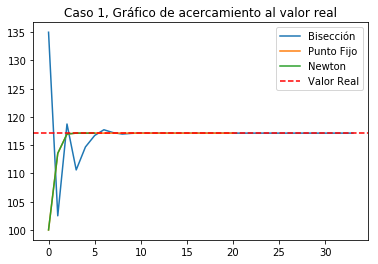

In [409]:
plt.plot(valuesBisect,label='Bisección')
plt.plot(valuesFpi,label='Punto Fijo')
plt.plot(valuesNewton,label='Newton')
plt.axhline(y=117.138738908,linestyle="--",color="r",label='Valor Real')
plt.legend()
plt.title('Caso 1, Gráfico de acercamiento al valor real')
plt.show()

Cabe destacar que punto fijo se superpone con newton, debido a que se usó el mismo valor inicial en ambos casos, y los algoritmos son similares. Bisección muestra un comportamiento más errático que los otros algoritmos, ya que va saltando entre mitades.

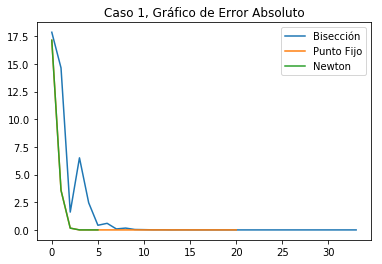

In [410]:
plt.plot(errorsBisect,label='Bisección')
plt.plot(errorsFpi,label='Punto Fijo')
plt.plot(errorsNewton,label='Newton')
plt.legend()
plt.title('Caso 1, Gráfico de Error Absoluto')
plt.show()

Nuevamente newton y punto fijo se superponen, mientras que bisección tiene errores mayores en las primeras iteraciones.

### Caso 2

A partir de las ecuaciones del item 1.b, se obtiene el valor teórico de $\theta$:

$$\theta=\frac{arcsin(\frac{d\cdot g}{v^2})}{2}$$

$$\theta=\frac{arcsin(\frac{900\cdot 9.8}{100^2})}{2}$$


In [411]:
g=9.8
v=100
d=900;
thetaReal=np.arcsin(d*g/v**2)/2
print(thetaReal)

0.540044763537


$$\theta=0.540044763537$$

### Bisección
Se elige como intervalo un número mayor y un número menor a v, como v=0.2 y v=0.8.
Se tiene que la función a evaluar es:
$$y=d\cdot tan(\theta) - \frac{g\cdot d^2}{2\cdot v^2 \cdot cos^2(\theta)}$$

Reemplazando las constantes:
$$y=900\cdot tan(\theta) - \frac{9.8\cdot 900^2}{2\cdot 100^2 \cdot cos^2(\theta)}$$

Luego se aplica el algoritmo de bisección sobre la función anterior, en el intervalo $\theta=0.2$ a $\theta=0.8$.

In [412]:
f = lambda theta: d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
valuesBisect,errorsBisect=bisect(f,0.2 , 0.8,thetaReal, tol=1e-8)

 i |     a     |     c     |     b     |     fa    |     fc     |     fb     |   b-a
----------------------------------------------------------------------------------------
 1 | 0.2000000 | 0.5000000 | 0.8000000 | -230.7701282 | -23.6811394 | 108.9989603 | 0.6000000
 2 | 0.5000000 | 0.6500000 | 0.8000000 | -23.6811394 | 57.9111911 | 108.9989603 | 0.3000000
 3 | 0.5000000 | 0.5750000 | 0.6500000 | -23.6811394 | 19.6576451 | 57.9111911 | 0.1500000
 4 | 0.5000000 | 0.5375000 | 0.5750000 | -23.6811394 | -1.4696871 | 19.6576451 | 0.0750000
 5 | 0.5375000 | 0.5562500 | 0.5750000 | -1.4696871 | 9.2391794 | 19.6576451 | 0.0375000
 6 | 0.5375000 | 0.5468750 | 0.5562500 | -1.4696871 | 3.9197261 | 9.2391794 | 0.0187500
 7 | 0.5375000 | 0.5421875 | 0.5468750 | -1.4696871 | 1.2336095 | 3.9197261 | 0.0093750
 8 | 0.5375000 | 0.5398437 | 0.5421875 | -1.4696871 | -0.1159100 | 1.2336095 | 0.0046875
 9 | 0.5398437 | 0.5410156 | 0.5421875 | -0.1159100 | 0.5593843 | 1.2336095 | 0.0023438
10 | 0.5398437 |

Se observa como V converge a v=0.5400447.
### Punto Fijo

Primero se transforma el problema de obtención de raiz, a problema de obtención de punto fijo, aplicando:
$$g(x)=x-\frac{f(x)}{f'(x)}$$
Para
$$f(\theta)=900\cdot tan(\theta) - \frac{9.8\cdot 900^2}{2\cdot 100^2 \cdot cos^2(\theta)}$$
$$f'(\theta)=sec^2(\theta)\cdot (900-tan(\theta)\cdot \frac{9.8\cdot 900^2}{100^2})$$
Reemplazando f y f' en g, se obtiene que:
$$g(\theta)=\theta - \frac{900\cdot tan(\theta) - \frac{9.8\cdot 900^2}{2\cdot 100^2 \cdot cos^2(\theta)}}{sec^2(\theta)\cdot (900-tan(\theta)\cdot \frac{9.8\cdot 900^2}{100^2})}$$
Luego se aplica el algoritmo de punto fijo, con valor inicial $\theta_0=30º$.

In [413]:
ft=lambda t:d*np.tan(t)-g*d**2/2/v**2/np.cos(t)**2
dft=lambda t:1/np.cos(t)*(d-np.tan(t)*g*d**2/v**2)
f2 = lambda t: t-ft(t)/dft(t)
valuesFpi,errorsFpi=fpi(f2, np.radians(30), 20,thetaReal)

 i |     x(i)     |    x(i+1)    ||x(i+1)-x(i)| | e_i/e_{i-1}
--------------------------------------------------------------
 0 | 0.5235987756 | 0.5423912949 | 0.0187925193 | 0.0000000000
 1 | 0.5423912949 | 0.5396471825 | 0.0027441124 | 0.1460215303
 2 | 0.5396471825 | 0.5401104993 | 0.0004633168 | 0.1688403262
 3 | 0.5401104993 | 0.5400338497 | 0.0000766496 | 0.1654367222
 4 | 0.5400338497 | 0.5400465743 | 0.0000127246 | 0.1660096404
 5 | 0.5400465743 | 0.5400444631 | 0.0000021112 | 0.1659148098
 6 | 0.5400444631 | 0.5400448134 | 0.0000003503 | 0.1659305513
 7 | 0.5400448134 | 0.5400447553 | 0.0000000581 | 0.1659279400
 8 | 0.5400447553 | 0.5400447649 | 0.0000000096 | 0.1659283786
 9 | 0.5400447649 | 0.5400447633 | 0.0000000016 | 0.1659283474
10 | 0.5400447633 | 0.5400447636 | 0.0000000003 | 0.1659284153
11 | 0.5400447636 | 0.5400447635 | 0.0000000000 | 0.1659281037
12 | 0.5400447635 | 0.5400447635 | 0.0000000000 | 0.1659317456
13 | 0.5400447635 | 0.5400447635 | 0.0000000000 | 0.1659

Se observa que $\theta$  converge a $\theta=0.5400447635$.

### Newton
Se tiene que:
$$f(\theta)=900\cdot tan(\theta) - \frac{9.8\cdot 900^2}{2\cdot 100^2 \cdot cos^2(\theta)}$$
$$f'(\theta)=sec^2(\theta)\cdot (900-tan(\theta)\cdot \frac{9.8\cdot 900^2}{100^2})$$
Luego se aplica el algoritmo del método de newton, con valor inicial $x_0=100$.

In [414]:
f=lambda t:d*np.tan(t)-g*d**2/2/v**2/np.cos(t)**2
df=lambda t:1/np.cos(t)*(d-np.tan(t)*g*d**2/v**2)

valuesNewton,errorsNewton=newton_method(f, df, np.radians(30), thetaReal, rel_error=1e-10, m=1)

i |     x(i)     |     x(i+1)   |      |x(i+1)-x(i)|     |  e_i/e_{i-1} | e_i/e_{i-1}^2
----------------------------------------------------------------------------------------
2 | 0.5235987756 | 0.5423912949 | 0.01879251930981429286 | 0.0000000000 | 0.0000000000
3 | 0.5423912949 | 0.5396471825 | 0.00274411242687211399 | 0.1460215303 | 7.7701945036
4 | 0.5396471825 | 0.5401104993 | 0.00046331683725830963 | 0.1688403262 | 61.5282101920
5 | 0.5401104993 | 0.5400338497 | 0.00007664961889941591 | 0.1654367222 | 357.0703866196
6 | 0.5400338497 | 0.5400465743 | 0.00001272457566703356 | 0.1660096404 | 2165.8247326105
7 | 0.5400465743 | 0.5400444631 | 0.00000211119555115769 | 0.1659148098 | 13038.9267279485
8 | 0.5400444631 | 0.5400448134 | 0.00000035031184175693 | 0.1659305513 | 78595.5385484201
9 | 0.5400448134 | 0.5400447553 | 0.00000005812652226211 | 0.1659279400 | 473657.8106320812
10 | 0.5400447553 | 0.5400447649 | 0.00000000964483959365 | 0.1659283786 | 2854607.0220686863
11 | 0.5400447

Se observa que $\theta$  converge a $\theta=0.5400447636$.

### Gráficos

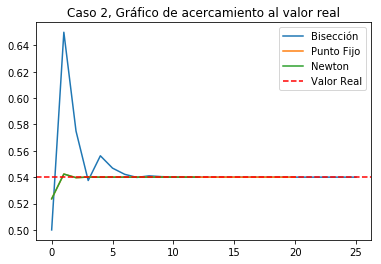

In [415]:
plt.plot(valuesBisect,label='Bisección')
plt.plot(valuesFpi,label='Punto Fijo')
plt.plot(valuesNewton,label='Newton')
plt.axhline(y=0.5400447636,linestyle="--",color="r",label='Valor Real')
plt.legend()
plt.title('Caso 2, Gráfico de acercamiento al valor real')
plt.show()

Cabe destacar que punto fijo se superpone con newton, debido a que se usó el mismo valor inicial en ambos casos, y los algoritmos son similares. Bisección muestra un comportamiento más errático que los otros algoritmos, ya que va saltando entre mitades.

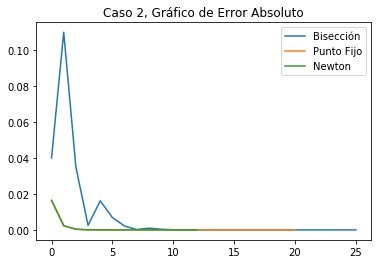

In [416]:
plt.plot(errorsBisect,label='Bisección')
plt.plot(errorsFpi,label='Punto Fijo')
plt.plot(errorsNewton,label='Newton')
plt.legend()
plt.title('Caso 2, Gráfico de Error Absoluto')
plt.show()

Nuevamente newton y punto fijo se superponen, mientras que bisección tiene errores mayores en las primeras iteraciones.

### Caso 3

A partir de las ecuaciones del item 1.b, se obtiene el valor teórico de v:
$$d=\frac{sen(\theta)\cdot cos(\theta)\cdot 2 \cdot v^2}{g} $$

$$d=\frac{sen(20)\cdot cos(20)\cdot 2 \cdot 100^2}{9.8} $$


In [417]:
g=9.8
theta=np.radians(20)
v=100;
dReal=np.sin(2*theta)*v**2/g
print(dReal)

655.90572417


$$d=655.90572417$$

### Bisección
Se elige como intervalo un número mayor y un número menor a v, como v=550 y v=750.
Se tiene que la función a evaluar es:
$$y=d\cdot tan(\theta) - \frac{g\cdot d^2}{2\cdot v^2 \cdot cos^2(\theta)}$$

Reemplazando las constantes:
$$y=d\cdot tan(20) - \frac{9.8\cdot d^2}{2\cdot 100^2 \cdot cos^2(20)}$$

Luego se aplica el algoritmo de bisección sobre la función anterior, en el intervalo d=550 a d=750.

In [418]:
f = lambda d: d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
valuesBisect,errorsBisect=bisect(f,550 , 750,dReal, tol=1e-8)

 i |     a     |     c     |     b     |     fa    |     fc     |     fb     |   b-a
----------------------------------------------------------------------------------------
 1 | 550.0000000 | 650.0000000 | 750.0000000 | 32.3226211 | 2.1301538 | -39.1605619 | 200.0000000
 2 | 650.0000000 | 700.0000000 | 750.0000000 | 2.1301538 | -17.1279230 | -39.1605619 | 100.0000000
 3 | 650.0000000 | 675.0000000 | 700.0000000 | 2.1301538 | -7.1520643 | -17.1279230 | 50.0000000
 4 | 650.0000000 | 662.5000000 | 675.0000000 | 2.1301538 | -2.4242502 | -7.1520643 | 25.0000000
 5 | 650.0000000 | 656.2500000 | 662.5000000 | 2.1301538 | -0.1253719 | -2.4242502 | 12.5000000
 6 | 650.0000000 | 653.1250000 | 656.2500000 | 2.1301538 | 1.0078100 | -0.1253719 | 6.2500000
 7 | 653.1250000 | 654.6875000 | 656.2500000 | 1.0078100 | 0.4425738 | -0.1253719 | 3.1250000
 8 | 654.6875000 | 655.4687500 | 656.2500000 | 0.4425738 | 0.1589396 | -0.1253719 | 1.5625000
 9 | 655.4687500 | 655.8593750 | 656.2500000 | 0.1589396 |

Se observa como d converge a d=655.9057242.
### Punto Fijo

Primero se transforma el problema de obtención de raiz, a problema de obtención de punto fijo, aplicando:
$$g(x)=x-\frac{f(x)}{f'(x)}$$
Para
$$f(v)=d\cdot tan(20) - \frac{9.8\cdot d^2}{2\cdot 100^2 \cdot cos^2(20)}$$
$$f'(v)=tan(20) - \frac{9.8\cdot d}{100^2 \cdot cos^2(20)}$$
Reemplazando f y f' en g, se obtiene que:
$$g(v)=d-\frac{d\cdot tan(20) - \frac{9.8\cdot d^2}{2\cdot 100^2 \cdot cos^2(20)}}{tan(20) - \frac{9.8\cdot d}{100^2 \cdot cos^2(20)}}$$
Luego se aplica el algoritmo de punto fijo, con valor inicial $d_0=500$.

In [419]:
fd=lambda d:d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
dfd=lambda d:np.tan(theta)-g*d/v**2/np.cos(theta)**2
f2 = lambda d: d-fd(d)/dfd(d)
valuesFpi,errorsFpi=fpi(f2, 500, 20,dReal)

 i |     x(i)     |    x(i+1)    ||x(i+1)-x(i)| | e_i/e_{i-1}
--------------------------------------------------------------
 0 | 500.0000000000 | 726.5450708150 | 226.5450708150 | 0.0000000000
 1 | 726.5450708150 | 662.1651507031 | 64.3799201120 | 0.2841815091
 2 | 662.1651507031 | 655.9643402380 | 6.2008104651 | 0.0963159080
 3 | 655.9643402380 | 655.9057294073 | 0.0586108307 | 0.0094521242
 4 | 655.9057294073 | 655.9057241699 | 0.0000052374 | 0.0000893586
 5 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 0.0000000217
 6 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
 7 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
 8 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
 9 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
10 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
11 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
12 | 655.9057241699 | 655.9057241699 | 0.0000000000 | 1.0000000000
1

Se observa que d converge a d=655.9057241699.


### Newton
Se tiene que:
$$f(v)=d\cdot tan(20) - \frac{9.8\cdot d^2}{2\cdot 100^2 \cdot cos^2(20)}$$
$$f'(v)=tan(20) - \frac{9.8\cdot d}{100^2 \cdot cos^2(20)}$$
Luego se aplica el algoritmo del método de newton, con valor inicial $d_0=500$.

In [420]:
f=lambda d:d*np.tan(theta)-g*d**2/2/v**2/np.cos(theta)**2
df=lambda d:np.tan(theta)-g*d/v**2/np.cos(theta)**2

valuesNewton,errorsNewton=newton_method(f, df, 500, dReal, rel_error=1e-10, m=1)

i |     x(i)     |     x(i+1)   |      |x(i+1)-x(i)|     |  e_i/e_{i-1} | e_i/e_{i-1}^2
----------------------------------------------------------------------------------------
2 | 500.0000000000 | 726.5450708150 | 226.54507081503345489182 | 0.0000000000 | 0.0000000000
3 | 726.5450708150 | 662.1651507031 | 64.37992011196763542102 | 0.2841815091 | 0.0012544149
4 | 662.1651507031 | 655.9643402380 | 6.20081046505072208674 | 0.0963159080 | 0.0014960551
5 | 655.9643402380 | 655.9057294073 | 0.05861083069419237290 | 0.0094521242 | 0.0015243369
6 | 655.9057294073 | 655.9057241699 | 0.00000523738287938613 | 0.0000893586 | 0.0015246093
7 | 655.9057241699 | 655.9057241699 | 0.00000000000011368684 | 0.0000000217 | 0.0041445896


Se observa que d converge a d=655.9057241699.


### Gráficos

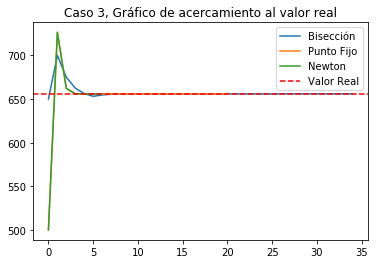

In [421]:
plt.plot(valuesBisect,label='Bisección')
plt.plot(valuesFpi,label='Punto Fijo')
plt.plot(valuesNewton,label='Newton')
plt.axhline(y=655.90572417,linestyle="--",color="r",label='Valor Real')
plt.legend()
plt.title('Caso 3, Gráfico de acercamiento al valor real')
plt.show()

Cabe destacar que punto fijo se superpone con newton, debido a que se usó el mismo valor inicial en ambos casos, y los algoritmos son similares. Bisección muestra un comportamiento más errático que los otros algoritmos, ya que va saltando entre mitades.

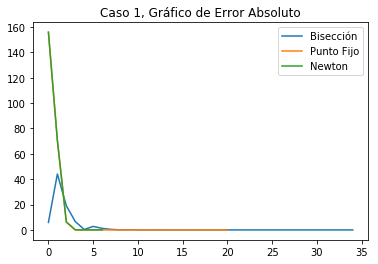

In [422]:
plt.plot(errorsBisect,label='Bisección')
plt.plot(errorsFpi,label='Punto Fijo')
plt.plot(errorsNewton,label='Newton')
plt.legend()
plt.title('Caso 1, Gráfico de Error Absoluto')
plt.show()

Nuevamente newton y punto fijo se superponen, mientras que bisección tiene errores mayores en las primeras iteraciones.

### Widgets


In [423]:
def trayectoria(t):
    x = np.linspace(0,d/v/np.cos(theta),1000)
    plt.figure(figsize=(8,8))
    plt.plot(fx(x),fy(x),'b-')
    plt.grid()
    plt.ylabel('$trayectoria(x)$',fontsize=16)
    plt.xlabel('$x$',fontsize=16)
    plt.plot(fx(t),fy(t),'k.',markersize=20)
    plt.show()

### Caso 1

In [424]:
g=9.8
theta=np.radians(20)
d=900
v=117.138738908
fx=lambda t:v*t*np.cos(theta)
fy=lambda t:v*t*np.sin(theta)-1/2*g*t**2
widgets.interact(trayectoria,t=(0,d/v/np.cos(theta),0.1))

A Jupyter Widget

<function __main__.trayectoria>

### Caso 2

In [425]:
g=9.8
theta=0.540044763537
d=900
v=100
fx=lambda t:v*t*np.cos(theta)
fy=lambda t:v*t*np.sin(theta)-1/2*g*t**2
widgets.interact(trayectoria,t=(0,d/v/np.cos(theta),0.1))

A Jupyter Widget

<function __main__.trayectoria>

### Caso 3

In [426]:
g=9.8
theta=np.radians(20)
v=100
d=655.90572417
fx=lambda t:v*t*np.cos(theta)
fy=lambda t:v*t*np.sin(theta)-1/2*g*t**2
widgets.interact(trayectoria,t=(0,d/v/np.cos(theta),0.1))

A Jupyter Widget

<function __main__.trayectoria>

## Pregunta 3  [60 puntos]

La tierra esta bajo ataque, seres de otra galaxia han venido para apoderarse de la tierra y esclavizar la humanidad. Los aliens se hacen llamar los singulares y han colocado una nave nodriza que genera un escudo que divide la tierra en dos, de esta manera las fuerzas que pelean en un frente no pueden recibir apoyo del otro. Unos físicos se dieron cuenta que el escudo tiene una debilidad, un pequeño agujero que se encuentra entre $\alpha$ y $\beta$ metros de altura sobre el nivel del mar, es por esto que se realizará una ofensiva con projectiles de largo alcance que serán lanzados por un buque de guerra. Para que el ataque tenga éxito se necesita conocer el ángulo y la velocidad que debe ser lanzado el projectil para que este impacte a la nave alienígena, como usted tiene conocimientos sobre algoritmos de búsqueda de ceros se le pide que encuentre los distintos parámetros que harán que la misión sea un éxito. Usted dispone de la siguiente información:


* El buque de guerra se encuentra a $x_b$ metros de la barrera y $x_0$ de la nave (eje $x$).
* La nave se encuentra a una altura de $y_0$ metros (eje $y$).
* El buque se encuentra en el origen de su sistema de coordenadas.
* La velocidad máxima a la que se pueden lanzar los misiles son de $v \left[\dfrac{m}{s}\right]$.
* Aproxime la gravedad a $9.8 \left[\dfrac{m}{s^2}\right]$

<a id='example'></a>
![title](example.png)

Encuentre la velocidad, el ángulo y el tiempo en el cual se logra impactar al ovni en el menor tiempo posible. Utilice la siguientre estructura:

```python
'''
Input: 
ovni_location - (2D-array) List with the functions to modelate x and y coordinates of the O.V.N.I. as a function of time. 
barrier_coordinates - (3D-array) Array with the x position of the barrier and the range of the hole. 

Output:
best_angle - (double) The best angle for the projectile to impact the O.V.N.I in the less time possible.
best_speed - (double) The best speed for the projectile to impact the O.V.N.I in the less time possible.
time_of_collision - (double) Time of collision.
'''

def shoot_projectile(ovni_location, barrier_coordinates):
    ...
    return [best_angle, best_speed, time_of_collision]
```
Las entradas de su función son las siguientes:
   * *ovni_location*: Una lista de funciones para modelar el movimiento del ovni. Por ejemplo [$x_0 + \cos(t), y_0 + \sin(t)$] o [$x_0 , y_0 + \sin(t)$].
   * *barrier_coordinates*: Un arreglo donde el primer elemento es la posición en el eje $x$ de la barrera, y la segunda y tercera posición son el rango donde se encuentra la debilidad del escudo. La estructura de su arreglo debe ser $[x_b, \alpha, \beta]$
   * Nota: en caso de no encontrar una solución, su algoritmo debe retornar [-1,-1,-1].
   
Un ejemplo de estos *inputs* se encuentra en la siguiente celda:

In [434]:
#Examples Values
x0 = 5000
y0 = 8000
x_ovni = lambda t: x0 + np.cos(t)
y_ovni = lambda t: y0 + np.sin(t)
#Examples Input 
ovni_position = [x_ovni, y_ovni]
barrier_coordinates = np.array([4000, 7500, 7600])

In [ ]:
def shoot_projectile(ovni_location, barrier_coordinates):
    theta=0
    g=9.8
    while(theta<90):
        theta+=1
        f=lambda t:4000*np.tan(np.radians(theta))-1/2*g*t**2-7550
        df=lambda t:-g*t
        valuesNewton,errorsNewton=newton_method(f, df, 30, thetaReal, rel_error=1e-10, m=1)
        tiempo=valuesNewton[-1]
    return [-1,-1,-1]
angle,speed,time=(shoot_projectile(ovni_position, barrier_coordinates))

i |     x(i)     |     x(i+1)   |      |x(i+1)-x(i)|     |  e_i/e_{i-1} | e_i/e_{i-1}^2
----------------------------------------------------------------------------------------
2 | 30.0000000000 | -10.4427882323 | 40.44278823226915164923 | 0.0000000000 | 0.0000000000
3 | -10.4427882323 | 67.8705455068 | 78.31333373906588235513 | 1.9363979874 | 0.0478799329
4 | 67.8705455068 | 22.6891034281 | 45.18144207867124606537 | 0.5769316657 | 0.0073669660
5 | 22.6891034281 | -22.2964270662 | 44.98553049429543904125 | 0.9956638926 | 0.0220370100
6 | -22.2964270662 | 23.0852376249 | 45.38166469110453249414 | 1.0088058136 | 0.0224251176
7 | 23.0852376249 | -21.5210931306 | 44.60633075553364790267 | 0.9829152601 | 0.0216588630
8 | -21.5210931306 | 24.7062228193 | 46.22731594992824710744 | 1.0363398013 | 0.0232330206
9 | 24.7062228193 | -18.5412771235 | 43.24749994286081289374 | 0.9355399303 | 0.0202378163
10 | -18.5412771235 | 31.8960859245 | 50.43736304803942260833 | 1.1662492194 | 0.0269668587
11 |

240 | -11.8481179346 | 58.4982949612 | 70.34641289582076240094 | 1.7229842056 | 0.0422007953
241 | 58.4982949612 | 16.2011834763 | 42.29711148493739614196 | 0.6012689168 | 0.0085472577
242 | 16.2011834763 | -39.0122409808 | 55.21342445708333457333 | 1.3053710412 | 0.0308619429
243 | -39.0122409808 | 0.0591141072 | 39.07135508801587775451 | 0.7076423075 | 0.0128164901
244 | 0.0591141072 | -12912.0092534322 | 12912.06836753945935925003 | 330.4740349663 | 8.4582178996
245 | -12912.0092534322 | -6455.9455124735 | 6456.06374095867067808285 | 0.5000022891 | 0.0000387236
246 | -6455.9455124735 | -3227.8545266691 | 3228.09098580446288906387 | 0.5000091566 | 0.0000774480
247 | -3227.8545266691 | -1613.6907955382 | 1614.16373113092458879692 | 0.5000366279 | 0.0001549017
248 | -1613.6907955382 | -806.3723928730 | 807.31840266510869241756 | 0.5001465385 | 0.0003098487
249 | -806.3723928730 | -402.2396317305 | 404.13276114250169257502 | 0.5005865837 | 0.0006200609
250 | -402.2396317305 | -199.22223

1333 | -124.4574368773 | -56.0958294276 | 68.36160744971152780636 | 0.5240596336 | 0.0040174377
1334 | -56.0958294276 | -14.4411340537 | 41.65469537391040688590 | 0.6093287874 | 0.0089133186
1335 | -14.4411340537 | 45.6342603108 | 60.07539436447235203786 | 1.4422238316 | 0.0346233196
1336 | 45.6342603108 | 6.0910203911 | 39.54323991962956341695 | 0.6582268887 | 0.0109566803
1337 | 6.0910203911 | -122.2674255613 | 128.35844595241235310823 | 3.2460275439 | 0.0820880522
1338 | -122.2674255613 | -54.8909736090 | 67.37645195228724048775 | 0.5249085984 | 0.0040893966
1339 | -54.8909736090 | -13.5400375697 | 41.35093603928594774288 | 0.6137297949 | 0.0091089658
1340 | -13.5400375697 | 49.6023245738 | 63.14236214348348852354 | 1.5269874927 | 0.0369275194
1341 | 49.6023245738 | 9.4131002651 | 40.18922430871616313652 | 0.6364859176 | 0.0100801727
1342 | 9.4131002651 | -76.3808308020 | 85.79393106704918636751 | 2.1347496137 | 0.0531174625
1343 | -76.3808308020 | -28.1972844157 | 48.18354638626366

2580 | -51.3880886252 | -10.8407258221 | 40.54736280310222440448 | 0.6281090869 | 0.0097298813
2581 | -10.8407258221 | 64.9885432353 | 75.82926905745671319892 | 1.8701405915 | 0.0461223730
2582 | 64.9885432353 | 20.7493761489 | 44.23916708646190443233 | 0.5834048994 | 0.0076936638
2583 | 20.7493761489 | -26.4111719674 | 47.16054811627321896594 | 1.0660360767 | 0.0240971100
2584 | -26.4111719674 | 15.6944434399 | 42.10561540724602025421 | 0.8928143775 | 0.0189313825
2585 | 15.6944434399 | -40.7867836778 | 56.48122711764816017421 | 1.3414179218 | 0.0318584091
2586 | -40.7867836778 | -1.6793973009 | 39.10738637687862961911 | 0.6923961885 | 0.0122588730
2587 | -1.6793973009 | 453.6588566061 | 455.33825390704004121289 | 11.6432801087 | 0.2977258566
2588 | 453.6588566061 | 225.1469225262 | 228.51193407993218897900 | 0.5018509473 | 0.0011021498
2589 | 225.1469225262 | 109.1833032347 | 115.96361929147980163179 | 0.5074729237 | 0.0022207721
2590 | 109.1833032347 | 47.6008057247 | 61.58249751004

3666 | 114.3401371275 | 50.4945155502 | 63.84562157728331754925 | 0.5283858849 | 0.0043729176
3667 | 50.4945155502 | 10.1310884516 | 40.36342709867053457629 | 0.6322035263 | 0.0099020655
3668 | 10.1310884516 | -70.2751904462 | 80.40627889776054360027 | 1.9920577780 | 0.0493530387
3669 | -70.2751904462 | -24.2762422745 | 45.99894817172242511560 | 0.5720815439 | 0.0071148864
3670 | -24.2762422745 | 19.3034684769 | 43.57971075140773820067 | 0.9474066796 | 0.0205962683
3671 | 19.3034684769 | -29.8895351391 | 49.19300361603794158327 | 1.1288051886 | 0.0259020808
3672 | -29.8895351391 | 10.5920513678 | 40.48158650687786774824 | 0.8229134944 | 0.0167282628
3673 | 10.5920513678 | -66.7659026872 | 77.35795405500019228384 | 1.9109417572 | 0.0472052091
3674 | -66.7659026872 | -21.9507139852 | 44.81518870200919479885 | 0.5793223108 | 0.0074888525
3675 | -21.9507139852 | 23.7972543895 | 45.74796837473746791147 | 1.0208139182 | 0.0227783024
3676 | 23.7972543895 | -20.1758144393 | 43.9730688288371922

4681 | -40.8453813452 | -1.7355436359 | 39.10983770930774028329 | 0.6919210315 | 0.0122412861
4682 | -1.7355436359 | 438.9273627803 | 440.66290641628188495815 | 11.2673161595 | 0.2880941681
4683 | 438.9273627803 | 217.7247065354 | 221.20265624499390355595 | 0.5019770283 | 0.0011391406
4684 | 217.7247065354 | 105.3566250519 | 112.36808148343114055479 | 0.5079870350 | 0.0022964780
4685 | 105.3566250519 | 45.4335507790 | 59.92307427294959865094 | 0.5332748720 | 0.0047457860
4686 | 45.4335507790 | 5.9167755242 | 39.51677525481318298262 | 0.6594584095 | 0.0110050831
4687 | 5.9167755242 | -126.0449255885 | 131.96170111268745017696 | 3.3393843567 | 0.0845054875
4688 | -126.0449255885 | -56.9668152273 | 69.07811036122697601058 | 0.5234708994 | 0.0039668396
4689 | -56.9668152273 | -15.0846658388 | 41.88214938853398905394 | 0.6063013185 | 0.0087770397
4690 | -15.0846658388 | 43.0576376154 | 58.14230345412154576934 | 1.3882359025 | 0.0331462430
4691 | 43.0576376154 | 3.8017977902 | 39.25583982510

5640 | -27.7813728938 | 13.5839689593 | 41.36534185308497768574 | 0.8628324285 | 0.0179976707
5641 | 13.5839689593 | -49.3980472597 | 62.98201621900737734450 | 1.5225793719 | 0.0368080935
5642 | -49.3980472597 | -9.2473268663 | 40.15072039340031295751 | 0.6374949994 | 0.0101218576
5643 | -9.2473268663 | 77.9173409026 | 87.16466776888810841228 | 2.1709365838 | 0.0540696795
5644 | 77.9173409026 | 29.1626014617 | 48.75473944088229671934 | 0.5593406215 | 0.0064170568
5645 | 29.1626014617 | -11.5920723124 | 40.75467377409055558246 | 0.8359120414 | 0.0171452468
5646 | -11.5920723124 | 60.0492783308 | 71.64135064326853807870 | 1.7578683378 | 0.0431329262
5647 | 60.0492783308 | 17.3136846263 | 42.73559370450561800681 | 0.5965213291 | 0.0083264947
5648 | 17.3136846263 | -35.4287271910 | 52.74241181735224159866 | 1.2341565249 | 0.0288788904
5649 | -35.4287271910 | 3.8298381720 | 39.25856536298356758152 | 0.7443452813 | 0.0141128412
5650 | 3.8298381720 | -197.3842712959 | 201.21410946791161222791

6674 | 11.4073667239 | -61.2077840644 | 72.61515078833731706709 | 1.7840454829 | 0.0438313252
6675 | -61.2077840644 | -18.1335231300 | 43.07426093438682102033 | 0.5931855882 | 0.0081688956
6676 | -18.1335231300 | 33.0256460435 | 51.15916917354496717962 | 1.1876969695 | 0.0275732408
6677 | 33.0256460435 | -6.5990230255 | 39.62466906898975338436 | 0.7745369933 | 0.0151397493
6678 | -6.5990230255 | 112.3666475567 | 118.96567058219491741511 | 3.0023132906 | 0.0757687915
6679 | 112.3666475567 | 49.3905283754 | 62.97611918130708374974 | 0.5293637978 | 0.0044497189
6680 | 49.3905283754 | 9.2412151610 | 40.14931321440212741436 | 0.6375323493 | 0.0101233985
6681 | 9.2412151610 | -77.9749854957 | 87.21620065670009580572 | 2.1722962032 | 0.0541054387
6682 | -77.9749854957 | -29.1986657014 | 48.77631979431324538155 | 0.5592575626 | 0.0064123128
6683 | -29.1986657014 | 11.5417125921 | 40.74037829346157479904 | 0.8352491222 | 0.0171240702
6684 | 11.5417125921 | -60.3617597155 | 71.903472307616169700

7606 | 54.8526620324 | 13.5111695876 | 41.34149244477398355002 | 0.6138739765 | 0.0091153279
7607 | 13.5111695876 | -49.7372037852 | 63.24837337282048110865 | 1.5299005825 | 0.0370064188
7608 | -49.7372037852 | -9.5222697935 | 40.21493399169762028578 | 0.6358255849 | 0.0100528369
7609 | -9.5222697935 | 75.3966072718 | 84.91887706533762525396 | 2.1116254246 | 0.0525084891
7610 | 75.3966072718 | 27.5747228199 | 47.82188445190630687875 | 0.5631478666 | 0.0066315981
7611 | 27.5747228199 | -13.8931941464 | 41.46791696632264745404 | 0.8671326411 | 0.0181325485
7612 | -13.8931941464 | 47.9927954757 | 61.88598962215201737536 | 1.4923824043 | 0.0359888442
7613 | 47.9927954757 | 8.0922679742 | 39.90052750155445693281 | 0.6447424974 | 0.0104182304
7614 | 8.0922679742 | -90.2764526354 | 98.36872060956457630709 | 2.4653488755 | 0.0617873755
7615 | -90.2764526354 | -36.6832679682 | 53.59318466713467898899 | 0.5448193728 | 0.0055385428
7616 | -36.6832679682 | 2.4657719326 | 39.14903990087000806852 | 

8695 | -71.4308950868 | -25.0298241022 | 46.40107098464650192682 | 0.5699095813 | 0.0069997723
8696 | -25.0298241022 | 17.9800544278 | 43.00987852996354376955 | 0.9269156426 | 0.0199761691
8697 | 17.9800544278 | -33.4616600173 | 51.44171444508310031551 | 1.1960441695 | 0.0278085921
8698 | -33.4616600173 | 6.0798627834 | 39.54152280074261938125 | 0.7686665040 | 0.0149424745
8699 | 6.0798627834 | -122.5029754394 | 128.58283822288248643417 | 3.2518433564 | 0.0822386981
8700 | -122.5029754394 | -55.0207521459 | 67.48222329352944370839 | 0.5248151637 | 0.0040815335
8701 | -55.0207521459 | -13.6377258965 | 41.38302624945406904544 | 0.6132433733 | 0.0090874803
8702 | -13.6377258965 | 49.1496799572 | 62.78740585364358395282 | 1.5172260597 | 0.0366630041
8703 | 49.1496799572 | 9.0450613995 | 40.10461855768006955714 | 0.6387366704 | 0.0101730062
8704 | 9.0450613995 | -79.8642537846 | 88.90931518411342437958 | 2.2169345672 | 0.0552787845
8705 | -79.8642537846 | -30.3748642773 | 49.489389507272584

9752 | -6.9817801335 | 105.8341864002 | 112.81596653370955607443 | 2.8424131413 | 0.0716149736
9753 | 105.8341864002 | 45.7050223851 | 60.12916401513172104387 | 0.5329845222 | 0.0047243714
9754 | 45.7050223851 | 6.1522973619 | 39.55272502324939409846 | 0.6577960241 | 0.0109397168
9755 | 6.1522973619 | -120.9886684232 | 127.14096578503838941288 | 3.2144679212 | 0.0812704540
9756 | -120.9886684232 | -54.1856140900 | 66.80305433320329200342 | 0.5254250974 | 0.0041326184
9757 | -54.1856140900 | -13.0063440642 | 41.17927002574789696610 | 0.6164279528 | 0.0092275414
9758 | -13.0063440642 | 52.1823158497 | 65.18865991390136116479 | 1.5830455439 | 0.0384427782
9759 | 52.1823158497 | 11.4639104648 | 40.71840538481598059661 | 0.6246240594 | 0.0095817901
9760 | 11.4639104648 | -60.8494830393 | 72.31339350416527622656 | 1.7759387388 | 0.0436151348
9761 | -60.8494830393 | -17.8809431364 | 42.96853990287379332358 | 0.5941989142 | 0.0082169967
9762 | -17.8809431364 | 33.7465187736 | 51.62746191004703

1095 | -10.0127551514 | 70.5127753980 | 80.52553054931104270509 | 2.0052799039 | 0.0499363055
1096 | 70.5127753980 | 24.5327311177 | 45.98004428028637846637 | 0.5709995820 | 0.0070909136
1097 | 24.5327311177 | -18.5559177139 | 43.08864883156386582641 | 0.9371162970 | 0.0203809351
1098 | -18.5559177139 | 31.4721026394 | 50.02802035330927310497 | 1.1610487149 | 0.0269455819
1099 | 31.4721026394 | -8.2901409124 | 39.76224355179369496227 | 0.7947994598 | 0.0158870860
1100 | -8.2901409124 | 87.0662606846 | 95.35640159697646822679 | 2.3981645169 | 0.0603126057
1101 | 87.0662606846 | 34.8483105049 | 52.21795017970809027474 | 0.5476082288 | 0.0057427527
1102 | 34.8483105049 | -4.2743080879 | 39.12261859276783582118 | 0.7492178161 | 0.0143478979
1103 | -4.2743080879 | 174.7697914585 | 179.04409954639572788437 | 4.5764855725 | 0.1169779973
1104 | 174.7697914585 | 83.0583197137 | 91.71147174478389274555 | 0.5122283950 | 0.0028609063
1105 | 83.0583197137 | 32.4252580374 | 50.63306167632055831973 |

2067 | -2.1140546845 | 356.6228347223 | 358.73688940687850390532 | 9.2111724394 | 0.2365123304
2068 | 356.6228347223 | 176.1910966348 | 180.43173808755136633408 | 0.5029639923 | 0.0014020415
2069 | 176.1910966348 | 83.8038740932 | 92.38722254160310853877 | 0.5120342104 | 0.0028378278
2070 | 83.8038740932 | 32.8790273524 | 50.92484674074086825613 | 0.5512109287 | 0.0059663113
2071 | 32.8790273524 | -6.5585750402 | 39.43760239268570444438 | 0.7744275126 | 0.0152072625
2072 | -6.5585750402 | 112.0132544304 | 118.57182947063969891133 | 3.0065679016 | 0.0762360722
2073 | 112.0132544304 | 49.2560440649 | 62.75721036544992159634 | 0.5292758883 | 0.0044637575
2074 | 49.2560440649 | 9.2765092929 | 39.97953477201748029302 | 0.6370508590 | 0.0101510385
2075 | 9.2765092929 | -76.8746037020 | 86.15111299488546592329 | 2.1548803278 | 0.0538995849
2076 | -76.8746037020 | -28.6010913009 | 48.27351240100707485681 | 0.5603353308 | 0.0065040986
2077 | -28.6010913009 | 12.1374241461 | 40.73851544701481941

3152 | -36.7502020776 | 2.2004263111 | 38.95062838871452015610 | 0.7279681369 | 0.0136053674
3153 | 2.2004263111 | -342.5399188245 | 344.74034513558331127570 | 8.8507004738 | 0.2272286954
3154 | -342.5399188245 | -169.0624654928 | 173.47745333165289594035 | 0.5032119268 | 0.0014596839
3155 | -169.0624654928 | -80.0585972282 | 89.00386826463866896120 | 0.5130572680 | 0.0029574867
3156 | -80.0585972282 | -30.5842819120 | 49.47431531613645461221 | 0.5558670233 | 0.0062454254
3157 | -30.5842819120 | 9.4314994465 | 40.01578135853800688437 | 0.8088193056 | 0.0163482668
3158 | 9.4314994465 | -75.4575877458 | 84.88908719225902643757 | 2.1213902193 | 0.0530138397
3159 | -75.4575877458 | -27.7078693966 | 47.74971834916217261480 | 0.5624953681 | 0.0066262389
3160 | -27.7078693966 | 13.4363190971 | 41.14418849368198749517 | 0.8616634802 | 0.0180454149
3161 | 13.4363190971 | -49.5587703531 | 62.99508945019225336637 | 1.5310811018 | 0.0372125726
3162 | -49.5587703531 | -9.5216460806 | 40.03712427247

4122 | 63.1398804624 | 19.5940735931 | 43.54580686928417065928 | 0.5872273784 | 0.0079189254
4123 | 19.5940735931 | -28.7939577901 | 48.38803138323846297908 | 1.1111984106 | 0.0255179199
4124 | -28.7939577901 | 11.8639051930 | 40.65786298310338509054 | 0.8402462721 | 0.0173647542
4125 | 11.8639051930 | -57.8037883475 | 69.66769354043644568719 | 1.7135109528 | 0.0421446389
4126 | -57.8037883475 | -15.8204887922 | 41.98329955528456736147 | 0.6026222116 | 0.0086499521
4127 | -15.8204887922 | 39.8856737892 | 55.70616258138107212972 | 1.3268648051 | 0.0316045861
4128 | 39.8856737892 | 0.9847821314 | 38.90089165779406954471 | 0.6983229477 | 0.0125358293
4129 | 0.9847821314 | -767.3472801173 | 768.33206224869672951172 | 19.7510141672 | 0.5077265154
4130 | -767.3472801173 | -382.6882260127 | 384.65905410461488145302 | 0.5006416796 | 0.0006515955
4131 | -382.6882260127 | -189.3682100740 | 193.32001593871154909721 | 0.5025749787 | 0.0013065466
4132 | -189.3682100740 | -90.6910652989 | 98.6771447

5121 | -22.7368388943 | 21.8883930535 | 44.62523194772943213593 | 0.9906270968 | 0.0219907438
5122 | 21.8883930535 | -23.6017286179 | 45.49012167140826790046 | 1.0193811816 | 0.0228431570
5123 | -23.6017286179 | 20.2372461279 | 43.83897474584651376972 | 0.9637031763 | 0.0211848890
5124 | 20.2372461279 | -27.2458870667 | 47.48313319458664238937 | 1.0831259962 | 0.0247069190
5125 | -27.2458870667 | 14.1300448760 | 41.37593194264081830624 | 0.8713816709 | 0.0183513937
5126 | 14.1300448760 | -46.4489468806 | 60.57899175654455348194 | 1.4641118378 | 0.0353855918
5127 | -46.4489468806 | -6.9452068746 | 39.50374000593637902057 | 0.6521029628 | 0.0107645067
5128 | -6.9452068746 | 105.4017327216 | 112.34693959624011938558 | 2.8439570425 | 0.0719920960
5129 | 105.4017327216 | 45.5268401998 | 59.87489252183013377362 | 0.5329463601 | 0.0047437550
5130 | 45.5268401998 | 6.1544311025 | 39.37240909724542348158 | 0.6575779503 | 0.0109825325
5131 | 6.1544311025 | -119.7862588082 | 125.94068991075189956

6189 | 56.5145117752 | 14.8774218554 | 41.63708991978899121023 | 0.6069392117 | 0.0088472851
6190 | 14.8774218554 | -43.3869492782 | 58.26437113361510000686 | 1.3993382161 | 0.0336079735
6191 | -43.3869492782 | -4.2653124719 | 39.12163680634775175804 | 0.6714504258 | 0.0115242027
6192 | -4.2653124719 | 175.1473890010 | 179.41270147286616065685 | 4.5860223682 | 0.1172247059
6193 | 175.1473890010 | 83.2564460832 | 91.89094291782018331105 | 0.5121763519 | 0.0028547385
6194 | 83.2564460832 | 32.5459858872 | 50.71046019602005117122 | 0.5518548247 | 0.0060055410
6195 | 32.5459858872 | -6.9604340782 | 39.50641996540174005759 | 0.7790585968 | 0.0153628777
6196 | -6.9604340782 | 105.1559368936 | 112.11637097181628064391 | 2.8379278879 | 0.0718346003
6197 | 105.1559368936 | 45.3871734208 | 59.76876347272769862684 | 0.5330957732 | 0.0047548433
6198 | 45.3871734208 | 6.0334880312 | 39.35368538965124685092 | 0.6584323165 | 0.0110163282
6199 | 6.0334880312 | -122.3095654182 | 128.3430534494236212594

7211 | -41.9675123370 | -2.9661338255 | 39.00137851148039658256 | 0.6816608748 | 0.0119139776
7212 | -2.9661338255 | 253.4463571971 | 256.41249102258757375239 | 6.5744468736 | 0.1685696025
7213 | 253.4463571971 | 123.7396881419 | 129.70666905517293798766 | 0.5058516008 | 0.0019728041
7214 | 123.7396881419 | 55.7589931442 | 67.98069499775458268687 | 0.5241110229 | 0.0040407407
7215 | 55.7589931442 | 14.3183695624 | 41.44062358181376026778 | 0.6095939970 | 0.0089671634
7216 | 14.3183695624 | -45.6509333450 | 59.96930290734378843354 | 1.4471139120 | 0.0349201770
7217 | -45.6509333450 | -6.2616259675 | 39.38930737752767186066 | 0.6568244997 | 0.0109526786
7218 | -6.2616259675 | 117.6293205492 | 123.89094651664834145777 | 3.1452938568 | 0.0798514639
7219 | 117.6293205492 | 52.3863753501 | 65.24294519907307687845 | 0.5266159234 | 0.0042506409
7220 | 52.3863753501 | 11.7589997224 | 40.62737562772725397053 | 0.6227090991 | 0.0095444664
7221 | 11.7589997224 | -58.4248462408 | 70.183845963214523

8629 | 30.9529628491 | -8.9526755401 | 39.90563838923237227618 | 0.8028807038 | 0.0161535425
8630 | -8.9526755401 | 79.9849815944 | 88.93765713454880028621 | 2.2286990191 | 0.0558492261
8631 | 79.9849815944 | 30.5387812021 | 49.44620039229820918081 | 0.5559647284 | 0.0062511735
8632 | 30.5387812021 | -9.4910863465 | 40.02986754865266760817 | 0.8095640763 | 0.0163726246
8633 | -9.4910863465 | 74.9244503715 | 84.41553671809103320811 | 2.1088137905 | 0.0526810084
8634 | 74.9244503715 | 27.3699951566 | 47.55445521499345318261 | 0.5633377109 | 0.0066733890
8635 | 27.3699951566 | -13.9421460744 | 41.31214123093134560349 | 0.8687333509 | 0.0182681801
8636 | -13.9421460744 | 47.2641059610 | 61.20625203535854552683 | 1.4815560320 | 0.0358624847
8637 | 47.2641059610 | 7.6335532186 | 39.63055274237721903319 | 0.6474919052 | 0.0105788524
8638 | 7.6335532186 | -95.2399491786 | 102.87350239721344280497 | 2.5958129594 | 0.0655002966
8639 | -95.2399491786 | -39.6805038684 | 55.55944531019456888998 | 0

9518 | 327.5393942458 | 161.4611052367 | 166.07828900907935576470 | 0.5035118110 | 0.0015265339
9519 | 161.4611052367 | 76.0473517518 | 85.41375348492640284803 | 0.5142981301 | 0.0030967210
9520 | 76.0473517518 | 28.0804658818 | 47.96688586998162406871 | 0.5615826950 | 0.0065748509
9521 | 28.0804658818 | -12.8879096029 | 40.96837548474179868663 | 0.8540970451 | 0.0178059724
9522 | -12.8879096029 | 52.2276848405 | 65.11559444346299585504 | 1.5894111903 | 0.0387960511
9523 | 52.2276848405 | 11.6357971025 | 40.59188773801597704960 | 0.6233819730 | 0.0095734667
9524 | 11.6357971025 | -59.1673174422 | 70.80311454474522747660 | 1.7442675985 | 0.0429708421
9525 | -59.1673174422 | -16.8037183647 | 42.36359907756391152134 | 0.5983295982 | 0.0084506113
9526 | -16.8037183647 | 36.5973946466 | 53.40111301129855547742 | 1.2605424037 | 0.0297553190
9527 | 36.5973946466 | -2.3627403354 | 38.96013498202568570150 | 0.7295753363 | 0.0136621747
9528 | -2.3627403354 | 318.8515918261 | 321.2143321615548074

655 | -5.8778353522 | 124.4918775174 | 130.36971286958453219995 | 3.3301565369 | 0.0850653293
656 | 124.4918775174 | 56.2293435568 | 68.26253396059040312593 | 0.5236073046 | 0.0040163263
657 | 56.2293435568 | 14.7939181369 | 41.43542541994256112048 | 0.6070009860 | 0.0088921543
658 | 14.7939181369 | -43.2331191851 | 58.02703732195961094931 | 1.4004209377 | 0.0337976725
659 | -43.2331191851 | -4.2914799530 | 38.94163923204599342398 | 0.6710947350 | 0.0115652076
660 | -4.2914799530 | 172.3901406847 | 176.68162063778638071199 | 4.5370873985 | 0.1165099233
661 | 172.3901406847 | 81.8501743409 | 90.53996634379032570905 | 0.5124469994 | 0.0029003979
662 | 81.8501743409 | 31.7740103527 | 50.07616398828992743120 | 0.5530835278 | 0.0061087225
663 | 31.7740103527 | -7.6862619257 | 39.46027227835386952393 | 0.7880050934 | 0.0157361313
664 | -7.6862619257 | 93.6056991950 | 101.29196112065284296477 | 2.5669351799 | 0.0650511269
665 | 93.6056991950 | 38.8010159550 | 54.80468323995381041414 | 0.54105

1684 | -31.1522676843 | 8.4676128455 | 39.61988052976338536837 | 0.7974376748 | 0.0160501959
1685 | 8.4676128455 | -84.2229105543 | 92.69052339977747578814 | 2.3394952776 | 0.0590485192
1686 | -84.2229105543 | -33.2181835056 | 51.00472704863479833648 | 0.5502690586 | 0.0059366269
1687 | -33.2181835056 | 5.9393186026 | 39.15750210820643673060 | 0.7677230009 | 0.0150519970
1688 | 5.9393186026 | -123.1419846543 | 129.08130325686869355195 | 3.2964641846 | 0.0841847413
1689 | -123.1419846543 | -55.4884426992 | 67.65354195511430646093 | 0.5241157336 | 0.0040603536
1690 | -55.4884426992 | -14.2456044032 | 41.24283829594149608511 | 0.6096183157 | 0.0090108854
1691 | -14.2456044032 | 45.4560292571 | 59.70163366033074936468 | 1.4475636529 | 0.0350985459
1692 | 45.4560292571 | 6.2501734007 | 39.20585585636928982467 | 0.6566965333 | 0.0109996409
1693 | 6.2501734007 | -116.7143457320 | 122.96451913273783418390 | 3.1363814524 | 0.0799977805
1694 | -116.7143457320 | -51.9396478544 | 64.77469787759333

2693 | -36.0567475439 | 2.7449151120 | 38.80166265591430629911 | 0.7335283363 | 0.0138670300
2694 | 2.7449151120 | -271.5020039078 | 274.24691901982941999449 | 7.0679166883 | 0.1821549955
2695 | -271.5020039078 | -132.9922111451 | 138.50979276270206241861 | 0.5050550550 | 0.0018416070
2696 | -132.9922111451 | -60.8640672261 | 72.12814391900118948797 | 0.5207440029 | 0.0037596187
2697 | -60.8640672261 | -18.1256389359 | 42.73842829029108969507 | 0.5925347024 | 0.0082150277
2698 | -18.1256389359 | 32.2608125208 | 50.38645145664926872087 | 1.1789495654 | 0.0275852345
2699 | 32.2608125208 | -7.0871501004 | 39.34796262116456944113 | 0.7809234722 | 0.0154986797
2700 | -7.0871501004 | 102.1430863494 | 109.23023644975509682808 | 2.7760074264 | 0.0705502202
2701 | 102.1430863494 | 43.7385237828 | 58.40456256656469236077 | 0.5346922653 | 0.0048950939
2702 | 43.7385237828 | 4.7443759061 | 38.99414787670030335676 | 0.6676558502 | 0.0114315701
2703 | 4.7443759061 | -155.5025774043 | 160.24695331038

3690 | -23.9890063451 | 19.2288506491 | 43.21785699427896787483 | 0.9490967507 | 0.0208428808
3691 | 19.2288506491 | -29.3383569614 | 48.56720761057137281114 | 1.1237763968 | 0.0260025942
3692 | -29.3383569614 | 10.8611275937 | 40.19948455512398766132 | 0.8277083763 | 0.0170425358
3693 | 10.8611275937 | -63.5325550400 | 74.39368263372475098549 | 1.8506128488 | 0.0460357358
3694 | -63.5325550400 | -19.9767747608 | 43.55578027925399453579 | 0.5854768676 | 0.0078699810
3695 | -19.9767747608 | 27.5060150902 | 47.48278985100341742509 | 1.0901604689 | 0.0250290653
3696 | 27.5060150902 | -13.4780264847 | 40.98404157490221422222 | 0.8631346579 | 0.0181778421
3697 | -13.4780264847 | 48.8341994826 | 62.31222596727026541430 | 1.5204021754 | 0.0370974193
3698 | 48.8341994826 | 9.0791349363 | 39.75506454632210306954 | 0.6379978235 | 0.0102387262
3699 | 9.0791349363 | -77.9591769832 | 87.03831191945280920663 | 2.1893641203 | 0.0550713260
3700 | -77.9591769832 | -29.3717749932 | 48.587401990026968690

4736 | -166.4149623936 | -78.7065804234 | 87.70838197021309667889 | 0.5133450353 | 0.0030045375
4737 | -78.7065804234 | -29.8367132125 | 48.86986721092512198084 | 0.5571858255 | 0.0063527090
4738 | -29.8367132125 | 10.1855222162 | 40.02223542867994865446 | 0.8189552727 | 0.0167578780
4739 | 10.1855222162 | -68.4446792945 | 78.63020151075527053308 | 1.9646629097 | 0.0490892847
4740 | -68.4446792945 | -23.2789435986 | 45.16573569595502846141 | 0.5744069687 | 0.0073051697
4741 | -23.2789435986 | 20.5362680393 | 43.81521163791231288087 | 0.9700984820 | 0.0214786379
4742 | 20.5362680393 | -26.2047651220 | 46.74103316136564245653 | 1.0667763869 | 0.0243471696
4743 | -26.2047651220 | 15.4808628700 | 41.68562799205642477318 | 0.8918422459 | 0.0190804992
4744 | 15.4808628700 | -40.6429977856 | 56.12386065559695680349 | 1.3463599653 | 0.0322979413
4745 | -40.6429977856 | -1.8923161613 | 38.75068162427194096153 | 0.6904493235 | 0.0123022421
4746 | -1.8923161613 | 394.8741854045 | 396.766501565819

5912 | 6.8226148935 | -106.3731732316 | 113.19578812505204723493 | 2.8802136679 | 0.0732856841
5913 | -106.3731732316 | -46.1451756078 | 60.22799762377069754393 | 0.5320692459 | 0.0047004332
5914 | -46.1451756078 | -6.8408317627 | 39.30434384513824852547 | 0.6525925715 | 0.0108353689
5915 | -6.8408317627 | 106.0717129897 | 112.91254475236766552371 | 2.8727752128 | 0.0730905272
5916 | 106.0717129897 | 45.9744335025 | 60.09727948721076273841 | 0.5322462585 | 0.0047137921
5917 | 45.9744335025 | 6.6951784185 | 39.27925508391873421488 | 0.6535945623 | 0.0108756098
5918 | 6.6951784185 | -108.5265366349 | 115.22171505346386766178 | 2.9333986810 | 0.0746806088
5919 | -108.5265366349 | -47.3615716802 | 61.16496495470993721710 | 0.5308458126 | 0.0046071681
5920 | -47.3615716802 | -7.8659130144 | 39.49565866576038786206 | 0.6457235559 | 0.0105570821
5921 | -7.8659130144 | 91.2902212180 | 99.15613423242015755932 | 2.5105578077 | 0.0635654118
5922 | 91.2902212180 | 37.4403190886 | 53.84990212939754

7163 | -49.4828649129 | -9.6045313440 | 39.87833356886505242755 | 0.6347841657 | 0.0101045079
7164 | -9.6045313440 | 73.1835522838 | 82.78808362782419294490 | 2.0760166291 | 0.0520587608
7165 | 73.1835522838 | 26.3570005732 | 46.82655171061198728921 | 0.5656194667 | 0.0068321362
7166 | 26.3570005732 | -15.2396511213 | 41.59665169444386378927 | 0.8883133644 | 0.0189702921
7167 | -15.2396511213 | 41.5294119768 | 56.76906309803705141803 | 1.3647507861 | 0.0328091500
7168 | 41.5294119768 | 2.7288803580 | 38.80053161877702194715 | 0.6834802179 | 0.0120396600
7169 | 2.7288803580 | -273.1134169201 | 275.84229727806564369530 | 7.1092401514 | 0.1832253285
7170 | -273.1134169201 | -133.8141949600 | 139.29922196007032653142 | 0.5049958739 | 0.0018307413
7171 | -133.8141949600 | -61.3096551969 | 72.50453976307638015442 | 0.5204949370 | 0.0037365244
7172 | -61.3096551969 | -18.4378736694 | 42.87178152749077497674 | 0.5912978921 | 0.0081553223
7173 | -18.4378736694 | 31.4049033312 | 49.8427770006160

8130 | 13.4914835844 | -48.7720393516 | 62.26352293603100918062 | 1.5190497322 | 0.0370604164
8131 | -48.7720393516 | -9.0285065822 | 39.74353276943995894044 | 0.6383116614 | 0.0102517755
8132 | -9.0285065822 | 78.4471120388 | 87.47561862092614148878 | 2.2010025915 | 0.0553801446
8133 | 78.4471120388 | 29.6755023883 | 48.77160965041387186147 | 0.5575451814 | 0.0063737209
8134 | 29.6755023883 | -10.4025033142 | 40.07800570254515548640 | 0.8217486769 | 0.0168489144
8135 | -10.4025033142 | 66.8023046334 | 77.20480794758933029698 | 1.9263635152 | 0.0480653536
8136 | 66.8023046334 | 22.1887063232 | 44.61359831023337108036 | 0.5778603625 | 0.0074847717
8137 | 22.1887063232 | -22.6623346794 | 44.85104100254173431495 | 1.0053222045 | 0.0225339861
8138 | -22.6623346794 | 21.7200272324 | 44.38236191176497413835 | 0.9895503186 | 0.0220630402
8139 | 21.7200272324 | -23.6250827850 | 45.34511001740359859014 | 1.0216921332 | 0.0230202290
8140 | -23.6250827850 | 19.8917806521 | 43.51686343707151394256

9079 | 24.0905757842 | -19.0464236409 | 43.13699942510809393070 | 0.9462074833 | 0.0207550041
9080 | -19.0464236409 | 29.8026609557 | 48.84908459668618974092 | 1.1324173041 | 0.0262516475
9081 | 29.8026609557 | -10.2312318144 | 40.03389277014520786224 | 0.8195423333 | 0.0167770254
9082 | -10.2312318144 | 68.0932846957 | 78.32451651007340842625 | 1.9564551706 | 0.0488699708
9083 | 68.0932846957 | 23.0467730319 | 45.04651166377787774309 | 0.5751265845 | 0.0073428680
9084 | 23.0467730319 | -20.9764880613 | 44.02326109314774527093 | 0.9772845769 | 0.0216950112
9085 | -20.9764880613 | 25.2192219073 | 46.19570996860451828070 | 1.0493477498 | 0.0238362112
9086 | 25.2192219073 | -17.0906405330 | 42.30986244031759468953 | 0.9158829352 | 0.0198261470
9087 | -17.0906405330 | 35.2808447916 | 52.37148532453199578640 | 1.2378079791 | 0.0292557789
9088 | 35.2808447916 | -3.5897164337 | 38.87056122524683843267 | 0.7422084935 | 0.0141719962
9089 | -3.5897164337 | 206.8615208545 | 210.451237288209938469

134 | -100.1287771251 | -42.6552637468 | 57.47351337832647288906 | 0.5357219233 | 0.0049935694
135 | -42.6552637468 | -3.9354851087 | 38.71977863806823449977 | 0.6736977846 | 0.0117218827
136 | -3.9354851087 | 186.5392869157 | 190.47477202446708588468 | 4.9193145913 | 0.1270491404
137 | 186.5392869157 | 89.2926441907 | 97.24664272508113072035 | 0.5105486763 | 0.0026804005
138 | 89.2926441907 | 36.3380609379 | 52.95458325272047517274 | 0.5445389349 | 0.0055995654
139 | 36.3380609379 | -2.2466600831 | 38.58472102100570566563 | 0.7286379885 | 0.0137596775
140 | -2.2466600831 | 329.0853263374 | 331.33198642051667093256 | 8.5871292484 | 0.2225525809
141 | 329.0853263374 | 162.2883341300 | 166.79699220741676413127 | 0.5034134917 | 0.0015193628
142 | 162.2883341300 | 76.5728797242 | 85.71545440582767128035 | 0.5138908878 | 0.0030809362
143 | 76.5728797242 | 28.5980670329 | 47.97481269125550795707 | 0.5596985167 | 0.0065297270
144 | 28.5980670329 | -11.6421116146 | 40.24017864755129636478 | 0.

1051 | -26.8500760137 | 14.2049250141 | 41.05500102785861571419 | 0.8743700558 | 0.0186219212
1052 | 14.2049250141 | -45.1235511207 | 59.32847613482921644845 | 1.4450974217 | 0.0351990594
1053 | -45.1235511207 | -6.1209904505 | 39.00256067022525741095 | 0.6574003448 | 0.0110806882
1054 | -6.1209904505 | 118.1399237877 | 124.26091423819509884652 | 3.1859681032 | 0.0816861265
1055 | 118.1399237877 | 52.7904030150 | 65.34952077273543125102 | 0.5259056814 | 0.0042322695
1056 | 52.7904030150 | 12.3421432810 | 40.44825973399634477801 | 0.6189526603 | 0.0094714185
1057 | 12.3421432810 | -53.9373382588 | 66.27948153976150535982 | 1.6386238116 | 0.0405116023
1058 | -53.9373382588 | -13.2144381770 | 40.72290008180324605291 | 0.6144118683 | 0.0092700162
1059 | -13.2144381770 | 49.5333899511 | 62.74782812805113252352 | 1.5408487117 | 0.0378374013
1060 | 49.5333899511 | 9.7895935072 | 39.74379644392008259501 | 0.6333891966 | 0.0100942011
1061 | 9.7895935072 | -70.8863484825 | 80.6759419897117879827

2149 | 227.5367073409 | 110.5079276230 | 117.02877971792672440188 | 0.5071140064 | 0.0021974476
2150 | 110.5079276230 | 48.5407204874 | 61.96720713554628900965 | 0.5295040014 | 0.0045245623
2151 | 48.5407204874 | 8.9869734312 | 39.55374705628180720396 | 0.6383012707 | 0.0103006300
2152 | 8.9869734312 | -78.0556176134 | 87.04259104451483608500 | 2.2006155554 | 0.0556360830
2153 | -78.0556176134 | -29.5234754857 | 48.53214212762908630339 | 0.5575677556 | 0.0064056889
2154 | -29.5234754857 | 10.3662864875 | 39.88976197323010097762 | 0.8219246096 | 0.0169356755
2155 | 10.3662864875 | -66.3821765325 | 76.74846301997271780237 | 1.9240140633 | 0.0482332801
2156 | -66.3821765325 | -22.0153985537 | 44.36677797877614182198 | 0.5780803450 | 0.0075321423
2157 | -22.0153985537 | 22.6899240281 | 44.70532258176327644605 | 1.0076305880 | 0.0227113763
2158 | 22.6899240281 | -21.3508992172 | 44.04082324531343317631 | 0.9851360129 | 0.0220362131
2159 | -21.3508992172 | 24.0709374087 | 45.4218366259335439

3138 | 55.4013056697 | 14.3098744335 | 41.09143123623560001079 | 0.6089766436 | 0.0090250581
3139 | 14.3098744335 | -44.6880479064 | 58.99792233992111789576 | 1.4357719010 | 0.0349409076
3140 | -44.6880479064 | -5.7430167013 | 38.94503120516190364242 | 0.6601085201 | 0.0111886740
3141 | -5.7430167013 | 126.3056551436 | 132.04867184490038312106 | 3.3906423428 | 0.0870622577
3142 | 126.3056551436 | 57.2792456920 | 69.02640945163273045182 | 0.5227345984 | 0.0039586509
3143 | 57.2792456920 | 15.6878704546 | 41.59137523741817688006 | 0.6025429335 | 0.0087291652
3144 | 15.6878704546 | -39.4452497209 | 55.13312017548366128494 | 1.3255902182 | 0.0318717573
3145 | -39.4452497209 | -0.9151230036 | 38.53012671730656535374 | 0.6988562700 | 0.0126757976
3146 | -0.9151230036 | 810.2166368903 | 811.13175989385945285903 | 21.0518840451 | 0.5463746382
3147 | 810.2166368903 | 404.1926786352 | 406.02395825501952231207 | 0.5005647397 | 0.0006171189
3148 | 404.1926786352 | 200.2609111998 | 203.931767435407

4187 | -77.8757258902 | -29.4115747611 | 48.46415112912493583508 | 0.5578202210 | 0.0064204859
4188 | -29.4115747611 | 10.5178401673 | 39.92941492841569584016 | 0.8238958900 | 0.0170001098
4189 | 10.5178401673 | -65.2752005692 | 75.79304073650141049256 | 1.8981755899 | 0.0475382771
4190 | -65.2752005692 | -21.2723865296 | 44.00281403959750292643 | 0.5805653608 | 0.0076598769
4191 | -21.2723865296 | 24.2384366381 | 45.51082316767655555623 | 1.0342707429 | 0.0235046500
4192 | 24.2384366381 | -18.4878137452 | 42.72625038331012348181 | 0.9388151523 | 0.0206283931
4193 | -18.4878137452 | 30.8834233566 | 49.37123710181728597490 | 1.1555246870 | 0.0270448419
4194 | 30.8834233566 | -8.5798029965 | 39.46322635314032112319 | 0.7993161336 | 0.0161899150
4195 | -8.5798029965 | 82.1767233963 | 90.75652639284128042618 | 2.2997746201 | 0.0582763963
4196 | 82.1767233963 | 32.0606641129 | 50.11605928342372351381 | 0.5522033651 | 0.0060844480
4197 | 32.0606641129 | -7.1091327019 | 39.1697968148096649088

5335 | -192.9596924194 | -92.6351748275 | 100.32451759194047724577 | 0.5098650500 | 0.0025912147
5336 | -92.6351748275 | -38.3091110574 | 54.32606377006104736438 | 0.5415033640 | 0.0053975177
5337 | -38.3091110574 | 0.2107230406 | 38.51983409803112579084 | 0.7090488695 | 0.0130517255
5338 | 0.2107230406 | -3520.4712454464 | 3520.68196848706065793522 | 91.3991986447 | 2.3727827698
5339 | -3520.4712454464 | -1760.0248933760 | 1760.44635207041278590623 | 0.5000299282 | 0.0001420264
5340 | -1760.0248933760 | -879.5909375320 | 880.43395584402549047809 | 0.5001197309 | 0.0002840869
5341 | -879.5909375320 | -438.9520464708 | 440.63889106119864891298 | 0.5004792104 | 0.0005684461
5342 | -438.9520464708 | -217.7859374656 | 221.16610900521149574161 | 0.5019214452 | 0.0011390766
5343 | -217.7859374656 | -105.4865660238 | 112.29937144181756991657 | 0.5077603072 | 0.0022958323
5344 | -105.4865660238 | -45.7104765102 | 59.77608951354751098961 | 0.5322922893 | 0.0047399401
5345 | -45.7104765102 | -6.

6520 | -72.0728530380 | -25.7431388788 | 46.32971415920055591187 | 0.5669293688 | 0.0069374248
6521 | -25.7431388788 | 15.9464628473 | 41.68960172608907299718 | 0.8998458653 | 0.0194226509
6522 | 15.9464628473 | -38.5490986049 | 54.49556145222227598879 | 1.3071739522 | 0.0313549158
6523 | -38.5490986049 | -0.0298293423 | 38.51926926266452255732 | 0.7068331482 | 0.0129704719
6524 | -0.0298293423 | 24870.3493280912 | 24870.37915743343910435215 | 645.6607208159 | 16.7620189369
6525 | 24870.3493280912 | 12435.1448346854 | 12435.20449340574123198166 | 0.5000005997 | 0.0000201043
6526 | 12435.1448346854 | 6217.5127584793 | 6217.63207620613957260503 | 0.5000023988 | 0.0000402086
6527 | 6217.5127584793 | 3108.6370603679 | 3108.87569811138337172451 | 0.5000095953 | 0.0000804180
6528 | 3108.6370603679 | 1554.0798832808 | 1554.55717708706856683420 | 0.5000383830 | 0.0001608422
6529 | 1554.0798832808 | 776.5625745402 | 777.51730874062354814669 | 0.5001535615 | 0.0003217338
6530 | 776.5625745402 | 

7634 | 4.7051277047 | -155.3193749204 | 160.02450262510896550339 | 4.1237519840 | 0.1062670413
7635 | -155.3193749204 | -72.8832929650 | 82.43608195542945793477 | 0.5151466219 | 0.0032191734
7636 | -72.8832929650 | -26.2628170527 | 46.62047591226114917617 | 0.5655348339 | 0.0068602828
7637 | -26.2628170527 | 15.1163840040 | 41.37920105678271909255 | 0.8875756896 | 0.0190383232
7638 | 15.1163840040 | -41.5187967257 | 56.63518072972376415919 | 1.3686871492 | 0.0330766935
7639 | -41.5187967257 | -2.8911876757 | 38.62760904995620592217 | 0.6820426553 | 0.0120427382
7640 | -2.8911876757 | 255.1502036604 | 258.04139133614165757535 | 6.6802320331 | 0.1729393094
7641 | 255.1502036604 | 124.6675336734 | 130.48266998703130070680 | 0.5056656582 | 0.0019596300
7642 | 124.6675336734 | 56.3830065585 | 68.28452711493454785341 | 0.5233225770 | 0.0040106673
7643 | 56.3830065585 | 15.0338756064 | 41.34913095204049682252 | 0.6055417340 | 0.0088679202
7644 | 15.0338756064 | -41.8293935615 | 56.86326916793

8635 | 124.0334886871 | 56.0355644604 | 67.99792422669838742877 | 0.5235562521 | 0.0040311694
8636 | 56.0355644604 | 14.7785721944 | 41.25699226608389125204 | 0.6067389959 | 0.0089229047
8637 | 14.7785721944 | -42.8095150870 | 57.58808728132954968260 | 1.3958382354 | 0.0338327677
8638 | -42.8095150870 | -4.0752782008 | 38.73423688617028659564 | 0.6726084980 | 0.0116796464
8639 | -4.0752782008 | 180.0030881371 | 184.07836633794335057246 | 4.7523426595 | 0.1226910104
8640 | 180.0030881371 | 85.8801336247 | 94.12295451239845078817 | 0.5113200230 | 0.0027777301
8641 | 85.8801336247 | 34.3016707590 | 51.57846286577632355375 | 0.5479902658 | 0.0058220683
8642 | 34.3016707590 | -4.4768751942 | 38.77854595320473407583 | 0.7518360145 | 0.0145765494
8643 | -4.4768751942 | 163.4723707641 | 167.94924595830826774545 | 4.3309835846 | 0.1116850433
8644 | 163.4723707641 | 77.1980080503 | 86.27436271378969934176 | 0.5136930638 | 0.0030586208
8645 | 77.1980080503 | 28.9890849857 | 48.2089230645886459569

9675 | 1.4779315575 | -501.2237967186 | 502.70172827610997501324 | 13.0410641152 | 0.3383106596
9676 | -501.2237967186 | -249.1317878533 | 252.09200886529879426234 | 0.5014743230 | 0.0009975584
9677 | -249.1317878533 | -121.5880860212 | 127.54370183212603251377 | 0.5059410745 | 0.0020069699
9678 | -121.5880860212 | -54.6925685023 | 66.89551751889548825147 | 0.5244909514 | 0.0041122450
9679 | -54.6925685023 | -13.7819805864 | 40.91058791589853882442 | 0.6115594801 | 0.0091420099
9680 | -13.7819805864 | 46.9377466375 | 60.71972722387761933760 | 1.4842056865 | 0.0362792559
9681 | 46.9377466375 | 7.6635426304 | 39.27420400705720027190 | 0.6468112721 | 0.0106524074
9682 | 7.6635426304 | -92.9728845925 | 100.63642722291888276231 | 2.5624052675 | 0.0652439771
9683 | -92.9728845925 | -38.5070555038 | 54.46582908867155481403 | 0.5412138586 | 0.0053779121
9684 | -38.5070555038 | 0.0122041422 | 38.51925964606638785881 | 0.7072188249 | 0.0129846334
9685 | 0.0122041422 | -60788.0930580785 | 60788.1

720 | 39.2404436202 | 0.8972299960 | 38.34321362421552947808 | 0.6989760618 | 0.0127419558
721 | 0.8972299960 | -818.4033047982 | 819.30053479414414141502 | 21.3675500135 | 0.5572707135
722 | -818.4033047982 | -408.3039305786 | 410.09937421959233461166 | 0.5005481588 | 0.0006109457
723 | -408.3039305786 | -202.3525740769 | 205.95135650172917962664 | 0.5021986607 | 0.0012245780
724 | -202.3525740769 | -97.5455029576 | 104.80707111931522490522 | 0.5088923564 | 0.0024709347
725 | -97.5455029576 | -41.2408972937 | 56.30460566382419784759 | 0.5372214400 | 0.0051258129
726 | -41.2408972937 | -2.8056445835 | 38.43525271018494748887 | 0.6826307059 | 0.0121238875
727 | -2.8056445835 | 260.4616023726 | 263.26724695615718019326 | 6.8496296601 | 0.1782121666
728 | 260.4616023726 | 127.4100456585 | 133.05155671414775042649 | 0.5053859082 | 0.0019196688
729 | 127.4100456585 | 57.9386132743 | 69.47143238419469923883 | 0.5221391925 | 0.0039243373
730 | 57.9386132743 | 16.2886699570 | 41.64994331729405

1817 | 67.7587368926 | 23.0365083462 | 44.72222854634946997976 | 0.5744656558 | 0.0073791222
1818 | 23.0365083462 | -20.3745350309 | 43.41104337716112127055 | 0.9706815780 | 0.0217046782
1819 | -20.3745350309 | 25.8723777018 | 46.24691273277201730707 | 1.0653259893 | 0.0245404373
1820 | 25.8723777018 | -15.4608341499 | 41.33321185167937272809 | 0.8937507265 | 0.0193256301
1821 | -15.4608341499 | 39.7895613145 | 55.25039546434216219950 | 1.3367070448 | 0.0323397816
1822 | 39.7895613145 | 1.4301763638 | 38.35938495072699794264 | 0.6942825409 | 0.0125661099
1823 | 1.4301763638 | -512.9967331699 | 514.42690953367616657488 | 13.4107183990 | 0.3496072321
1824 | -512.9967331699 | -255.0661966369 | 257.93053653298585459197 | 0.5013939430 | 0.0009746651
1825 | -255.0661966369 | -124.6526754542 | 130.41352118268594040273 | 0.5056148951 | 0.0019602754
1826 | -124.6526754542 | -56.4323727400 | 68.22030271428184278193 | 0.5231075896 | 0.0040111454
1827 | -56.4323727400 | -15.1970899009 | 41.2352828

3128 | 17.6321706393 | -32.8519837861 | 50.48415442539155151280 | 1.1964916037 | 0.0283572573
3129 | -32.8519837861 | 5.9379088524 | 38.78989263850009194812 | 0.7683577764 | 0.0152197810
3130 | 5.9379088524 | -120.7612211191 | 126.69912997153147671270 | 3.2662923600 | 0.0842047280
3131 | -120.7612211191 | -54.2967162607 | 66.46450485835612198571 | 0.5245853296 | 0.0041404020
3132 | -54.2967162607 | -13.6171806434 | 40.67953561733339995499 | 0.6120490283 | 0.0092086600
3133 | -13.6171806434 | 47.1451996678 | 60.76238031117513571644 | 1.4936842171 | 0.0367183203
3134 | 47.1451996678 | 7.9888604530 | 39.15633921478974599495 | 0.6444174671 | 0.0106055336
3135 | 7.9888604530 | -87.9709394289 | 95.95979988190637754997 | 2.4506836391 | 0.0625871491
3136 | -87.9709394289 | -35.6338650885 | 52.33707434041009776138 | 0.5454062472 | 0.0056836951
3137 | -35.6338650885 | 2.8010527026 | 38.43491779110834016819 | 0.7343726847 | 0.0140315960
3138 | 2.8010527026 | -260.8931834404 | 263.6942361429874495

4177 | -752.1147643271 | -375.0805385494 | 377.03422577778093227607 | 0.5006489768 | 0.0006647922
4178 | -375.0805385494 | -185.5814939473 | 189.49904460204379574861 | 0.5026043570 | 0.0013330470
4179 | -185.5814939473 | -88.8318473600 | 96.74964658728335109572 | 0.5105547988 | 0.0026942342
4180 | -88.8318473600 | -36.1452580740 | 52.68658928607865021831 | 0.5445662196 | 0.0056286120
4181 | -36.1452580740 | 2.2536473221 | 38.39890539610736652776 | 0.7288174451 | 0.0138330732
4182 | 2.2536473221 | -324.8773818168 | 327.13102913898796941794 | 8.5192800619 | 0.2218625759
4183 | -324.8773818168 | -160.1772269044 | 164.70015491239303173643 | 0.5034684583 | 0.0015390422
4184 | -160.1772269044 | -75.5018284336 | 84.67539847080671222557 | 0.5141185114 | 0.0031215424
4185 | -75.5018284336 | -28.0200438535 | 47.48178458016661807051 | 0.5607506482 | 0.0066223562
4186 | -28.0200438535 | 12.2104404153 | 40.23048426881052108683 | 0.8472824816 | 0.0178443689
4187 | 12.2104404153 | -54.0644771737 | 66

5243 | 6.5018602495 | -109.7472698499 | 116.24913009943321640094 | 2.9899301512 | 0.0769010684
5244 | -109.7472698499 | -48.1791767786 | 61.56809307127549857341 | 0.5296219681 | 0.0045559220
5245 | -48.1791767786 | -8.8402928677 | 39.33888391088541425233 | 0.6389492016 | 0.0103779274
5246 | -8.8402928677 | 78.6877907889 | 87.52808365661296363669 | 2.2249762819 | 0.0565592122
5247 | 78.6877907889 | 30.0070148273 | 48.68077596151676544878 | 0.5561732181 | 0.0063542259
5248 | 30.0070148273 | -9.4807176554 | 39.48773248272966185368 | 0.8111565952 | 0.0166627705
5249 | -9.4807176554 | 72.7536169861 | 82.23433464147176152892 | 2.0825286607 | 0.0527386236
5250 | 72.7536169861 | 26.2783620498 | 46.47525493624819148408 | 0.5651563321 | 0.0068725105
5251 | 26.2783620498 | -14.8191256340 | 41.09748768382813466360 | 0.8842875147 | 0.0190270611
5252 | -14.8191256340 | 42.1681601087 | 56.98728574272466573802 | 1.3866367254 | 0.0337401823
5253 | 42.1681601087 | 3.6610171845 | 38.50714292428686036374 

6426 | 129.2956265262 | 58.9654980570 | 70.33012846911395854477 | 0.5215113804 | 0.0038671068
6427 | 58.9654980570 | 17.0229457725 | 41.94255228453064177074 | 0.5963667805 | 0.0084795349
6428 | 17.0229457725 | -34.6478318840 | 51.67077765650014953280 | 1.2319416641 | 0.0293721196
6429 | -34.6478318840 | 3.8808309277 | 38.52866281167731443702 | 0.7456567243 | 0.0144309174
6430 | 3.8808309277 | -187.3743262428 | 191.25515717050473085692 | 4.9639708003 | 0.1288383878
6431 | -187.3743262428 | -89.7661429933 | 97.60818324948510849026 | 0.5103558236 | 0.0026684552
6432 | -89.7661429933 | -36.6984878643 | 53.06765512902386916494 | 0.5436803899 | 0.0055700288
6433 | -36.6984878643 | 1.6706137633 | 38.36910162764920784184 | 0.7230223671 | 0.0136245396
6434 | 1.6706137633 | -438.9422891151 | 440.61290287841029567062 | 11.4835345157 | 0.2992912012
6435 | -438.9422891151 | -217.7973516173 | 221.14493749774879916004 | 0.5019029993 | 0.0011391019
6436 | -217.7973516173 | -105.5253634188 | 112.271988

7602 | 9.6156878663 | -71.5983908465 | 81.21407871285049395738 | 2.0549936515 | 0.0519983601
7603 | -71.5983908465 | -25.5378125067 | 46.06057833978551485643 | 0.5671501674 | 0.0069833972
7604 | -25.5378125067 | 16.0001398225 | 41.53795232924448299627 | 0.9018113499 | 0.0195788108
7605 | 16.0001398225 | -37.9181853561 | 53.91832517859516116232 | 1.2980496668 | 0.0312497269
7606 | -37.9181853561 | 0.4167951126 | 38.33498046865892661117 | 0.7109824043 | 0.0131862850
7607 | 0.4167951126 | -1762.5246156491 | 1762.94141076170558335434 | 45.9877998947 | 1.1996301898
7608 | -1762.5246156491 | -880.8454634309 | 881.67915221820248916629 | 0.5001182381 | 0.0002836840
7609 | -880.8454634309 | -439.5886483998 | 441.25681503107819025900 | 0.5004732322 | 0.0005676365
7610 | -439.5886483998 | -218.1229923597 | 221.46565604017402506543 | 0.5018974178 | 0.0011374270
7611 | -218.1229923597 | -105.6932198843 | 112.42977247540396490422 | 0.5076623368 | 0.0022922847
7612 | -105.6932198843 | -45.8953740399 

8671 | -9.5659340134 | 72.0206680233 | 81.58660203665669996553 | 2.0650507761 | 0.0522688113
8672 | 72.0206680233 | 25.8091164327 | 46.21155159054548278164 | 0.5664110336 | 0.0069424516
8673 | 25.8091164327 | -15.5620693258 | 41.37118575853571655898 | 0.8952563663 | 0.0193729995
8674 | -15.5620693258 | 39.4298143124 | 54.99188363821419045507 | 1.3292315081 | 0.0321294032
8675 | 39.4298143124 | 1.0818367881 | 38.34797752428116979218 | 0.6973388614 | 0.0126807597
8676 | 1.0818367881 | -678.5804728687 | 679.66230965681393172417 | 17.7235503287 | 0.4621769249
8677 | -678.5804728687 | -338.2075372792 | 340.37293558949556881998 | 0.5007971323 | 0.0007368323
8678 | -338.2075372792 | -166.9314382693 | 171.27609900985004287577 | 0.5032012863 | 0.0014783822
8679 | -166.9314382693 | -79.0645199819 | 87.86691828744233134785 | 0.5130133089 | 0.0029952417
8680 | -79.0645199819 | -30.2398680957 | 48.82465188621422669257 | 0.5556659188 | 0.0063239491
8681 | -30.2398680957 | 9.1757574003 | 39.415625495

9735 | 8.6718116910 | -80.3867024014 | 89.05851409231689785884 | 2.2660412187 | 0.0576580786
9736 | -80.3867024014 | -31.0537984794 | 49.33290392191298678881 | 0.5539380982 | 0.0062199342
9737 | -31.0537984794 | 8.1319940570 | 39.18579253645039273124 | 0.7943135194 | 0.0161010899
9738 | 8.1319940570 | -86.2806632781 | 94.41265733509192159545 | 2.4093593934 | 0.0614855344
9739 | -86.2806632781 | -34.6251154044 | 51.65554787370987099848 | 0.5471252407 | 0.0057950412
9740 | -34.6251154044 | 3.9061009536 | 38.53121635799231370356 | 0.7459260030 | 0.0144403851
9741 | 3.9061009536 | -186.1369434604 | 190.04304441400984160282 | 4.9321838856 | 0.1280048841
9742 | -186.1369434604 | -89.1213858319 | 97.01555762848789754571 | 0.5104925462 | 0.0026861943
9743 | -89.1213858319 | -36.3168971331 | 52.80448869880934381627 | 0.5442888748 | 0.0056103257
9744 | -36.3168971331 | 2.0717627863 | 38.38865991942679301019 | 0.7269961487 | 0.0137676960
9745 | 2.0717627863 | -353.5889383651 | 355.660701151383477

874 | -16.0554526917 | 37.2845105231 | 53.33996321474369750604 | 1.2888431880 | 0.0311420680
875 | 37.2845105231 | -0.8700962537 | 38.15460677682696655211 | 0.7153099567 | 0.0134103946
876 | -0.8700962537 | 835.6890844392 | 836.55918069295387340389 | 21.9255091682 | 0.5746490665
877 | 835.6890844392 | 416.9739930059 | 418.71509143336476199693 | 0.5005205861 | 0.0005983086
878 | 416.9739930059 | 206.7422630481 | 210.23172995778284644075 | 0.5020877782 | 0.0011991156
879 | 206.7422630481 | 99.8522164039 | 106.89004664412782119598 | 0.5084391717 | 0.0024184702
880 | 99.8522164039 | 42.6402561538 | 57.21196025015024133609 | 0.5352412320 | 0.0050074001
881 | 42.6402561538 | 4.2585871523 | 38.38166900145913018605 | 0.6708679240 | 0.0117260084
882 | 4.2585871523 | -168.7040014529 | 172.96258860518724986832 | 4.5063852903 | 0.1174098315
883 | -168.7040014529 | -80.0396639168 | 88.66433753608399115365 | 0.5126214764 | 0.0029637708
884 | -80.0396639168 | -30.9304825059 | 49.10918141090386512815 

2115 | -15.0812870665 | 40.6985068917 | 55.77979395819735941586 | 1.3598914764 | 0.0331536690
2116 | 40.6985068917 | 2.4736965529 | 38.22481033882738898910 | 0.6852805940 | 0.0122854630
2117 | 2.4736965529 | -292.8608552397 | 295.33455179262995216050 | 7.7262529016 | 0.2021266511
2118 | -292.8608552397 | -143.9462838281 | 148.91457141165727762200 | 0.5042233308 | 0.0017072954
2119 | -143.9462838281 | -66.9191144251 | 77.02716940300682324505 | 0.5172574361 | 0.0034735179
2120 | -66.9191144251 | -22.5880972171 | 44.33101720796613420816 | 0.5755244228 | 0.0074717068
2121 | -22.5880972171 | 20.9135547327 | 43.50165194978567484441 | 0.9812915356 | 0.0221355520
2122 | 20.9135547327 | -24.3296797760 | 45.24323450865287554734 | 1.0400348603 | 0.0239079394
2123 | -24.3296797760 | 17.7372583764 | 42.06693815235444589007 | 0.9297951088 | 0.0205510309
2124 | 17.7372583764 | -32.1472065156 | 49.88446489200645572737 | 1.1858354110 | 0.0281892494
2125 | -32.1472065156 | 6.5569315306 | 38.704138046213

3130 | -121.7350273634 | -54.8913497857 | 66.84367757763044437525 | 0.5239711692 | 0.0041072813
3131 | -54.8913497857 | -14.1920661140 | 40.69928367168950700261 | 0.6088725987 | 0.0091089034
3132 | -14.1920661140 | 44.1655992914 | 58.35766540541363411876 | 1.4338745093 | 0.0352309520
3133 | 44.1655992914 | 5.6105115510 | 38.55508774036896113557 | 0.6606687823 | 0.0113210283
3134 | 5.6105115510 | -126.8635754509 | 132.47408700191226671450 | 3.4359690190 | 0.0891184334
3135 | -126.8635754509 | -57.6972144028 | 69.16636104814060104218 | 0.5221123815 | 0.0039412416
3136 | -57.6972144028 | -16.2395326918 | 41.45768171099766874477 | 0.5993908178 | 0.0086659296
3137 | -16.2395326918 | 36.6788426542 | 52.91837534592654890275 | 1.2764431864 | 0.0307890633
3138 | 36.6788426542 | -1.4951324036 | 38.17397505772364496579 | 0.7213746607 | 0.0136318369
3139 | -1.4951324036 | 485.8370825351 | 487.33221493867262097410 | 12.7660851196 | 0.3344185430
3140 | 485.8370825351 | 241.4211082770 | 244.415974258

4124 | -153.1891447790 | -71.8454860463 | 81.34365873272159319640 | 0.5152676270 | 0.0032639388
4125 | -71.8454860463 | -25.7967279394 | 46.04875810684847436960 | 0.5661013879 | 0.0069593795
4126 | -25.7967279394 | 15.3032155915 | 41.09994353090451824073 | 0.8925309872 | 0.0193823031
4127 | 15.3032155915 | -39.8879743954 | 55.19118998694278843686 | 1.3428531829 | 0.0326728717
4128 | -39.8879743954 | -1.7051950197 | 38.18277937576887381965 | 0.6918274345 | 0.0125351063
4129 | -1.7051950197 | 425.7897906095 | 427.49498562919274036176 | 11.1960153928 | 0.2932215930
4130 | 425.7897906095 | 211.1862858185 | 214.60350479105287035964 | 0.5020023907 | 0.0011742884
4131 | 211.1862858185 | 102.1482768159 | 109.03800900260895900828 | 0.5080905324 | 0.0023675780
4132 | 102.1482768159 | 43.9520557054 | 58.19622111044303380822 | 0.5337241724 | 0.0048948452
4133 | 43.9520557054 | 5.4237082006 | 38.52834750478108105654 | 0.6620420840 | 0.0113760322
4134 | 5.4237082006 | -131.4230308326 | 136.846739033

5164 | 46.8327825489 | 7.8822197859 | 38.95056276302742759299 | 0.6448621540 | 0.0106762821
5165 | 7.8822197859 | -88.3563006290 | 96.23852041484568076157 | 2.4707863915 | 0.0634339074
5166 | -88.3563006290 | -35.9443461576 | 52.41195447132029272552 | 0.5446047409 | 0.0056589060
5167 | -35.9443461576 | 2.2676852903 | 38.21203144795417472324 | 0.7290709120 | 0.0139103935
5168 | 2.2676852903 | -319.6816067071 | 321.94929199741136471857 | 8.4253382979 | 0.2204891491
5169 | -319.6816067071 | -157.5650750660 | 162.11653164112652802942 | 0.5035467872 | 0.0015640562
5170 | -157.5650750660 | -74.1653438110 | 83.39973125498964634517 | 0.5144431010 | 0.0031732920
5171 | -74.1653438110 | -27.2733939056 | 46.89194990541313501353 | 0.5622554078 | 0.0067416933
5172 | -27.2733939056 | 13.0379617978 | 40.31135570338586404660 | 0.8596647353 | 0.0183328852
5173 | 13.0379617978 | -49.2802679932 | 62.31822979097901793466 | 1.5459224505 | 0.0383495525
5174 | -49.2802679932 | -9.8774611251 | 39.402806868057

6221 | 14.2450813362 | -43.9483137716 | 58.19339510778974755567 | 1.4291880730 | 0.0350998347
6222 | -43.9483137716 | -5.4204279036 | 38.52788586804685166953 | 0.6620663015 | 0.0113770008
6223 | -5.4204279036 | 131.5058458031 | 136.92627370670652453555 | 3.5539524327 | 0.0922436400
6224 | 131.5058458031 | 60.2207849882 | 71.28506081497563684479 | 0.5206090759 | 0.0038021123
6225 | 60.2207849882 | 18.0297051443 | 42.19107984388716658941 | 0.5918642611 | 0.0083027812
6226 | 18.0297051443 | -31.3356950147 | 49.36540015902171774087 | 1.1700435339 | 0.0277320120
6227 | -31.3356950147 | 7.5487581897 | 38.88445320446881225962 | 0.7876863771 | 0.0159562441
6228 | 7.5487581897 | -92.6002108863 | 100.14896907599026576463 | 2.5755529736 | 0.0662360599
6229 | -92.6002108863 | -38.4436603180 | 54.15655056824336099908 | 0.5407599406 | 0.0053995557
6230 | -38.4436603180 | -0.2978133150 | 38.14584700297200470231 | 0.7043625675 | 0.0130060456
6231 | -0.2978133150 | 2442.6850387917 | 2442.98285210677340

7518 | -61.6640019679 | -19.0340564428 | 42.62994552509871226675 | 0.5879312405 | 0.0081084585
7519 | -19.0340564428 | 28.7043817858 | 47.73843822860359153992 | 1.1198334326 | 0.0262687043
7520 | 28.7043817858 | -10.9926669352 | 39.69704872091638492293 | 0.8315531508 | 0.0174189433
7521 | -10.9926669352 | 60.6849198801 | 71.67758681521416974647 | 1.8056150048 | 0.0454848676
7522 | 60.6849198801 | 18.3541689966 | 42.33075088347360548369 | 0.5905716524 | 0.0082392792
7523 | 18.3541689966 | -30.4601486304 | 48.81431762702473520221 | 1.1531644634 | 0.0272417673
7524 | -30.4601486304 | 8.6538693985 | 39.11401802896579482649 | 0.8012816717 | 0.0164148904
7525 | 8.6538693985 | -79.7404855377 | 88.39435493624266371171 | 2.2599149714 | 0.0577776226
7526 | -79.7404855377 | -30.7467909803 | 48.99369455744421486543 | 0.5542627082 | 0.0062703406
7527 | -30.7467909803 | 8.2878859707 | 39.03467695097348411082 | 0.7967285853 | 0.0162618597
7528 | 8.2878859707 | -83.6357969838 | 91.92368295446715364960

8557 | -0.9834821987 | 739.2354002189 | 740.21888241761769222649 | 19.3991110935 | 0.5083976107
8558 | 739.2354002189 | 368.6335636961 | 370.60183652280750266073 | 0.5006652023 | 0.0006763745
8559 | 368.6335636961 | 182.3432543480 | 186.29030934810813846525 | 0.5026696875 | 0.0013563605
8560 | 182.3432543480 | 87.1818526249 | 95.16140172311023093243 | 0.5108231451 | 0.0027420811
8561 | 87.1818526249 | 35.2462025712 | 51.93565005364677489297 | 0.5457638193 | 0.0057351385
8562 | 35.2462025712 | -3.0176606215 | 38.26386319270441305207 | 0.7367552568 | 0.0141859254
8563 | -3.0176606215 | 239.5747661089 | 242.59242673034583503977 | 6.3399878237 | 0.1656912631
8564 | 239.5747661089 | 116.7507173520 | 122.82404875682338740717 | 0.5062979517 | 0.0020870312
8565 | 116.7507173520 | 52.1440609855 | 64.60665636653345700324 | 0.5260098248 | 0.0042826289
8566 | 52.1440609855 | 12.1201352692 | 40.02392571633257034591 | 0.6195015803 | 0.0095888197
8567 | 12.1201352692 | -53.9647142053 | 66.08484947446

9507 | 72.3300797635 | 26.1068666047 | 46.22321315875402092388 | 0.5652695559 | 0.0069127533
9508 | 26.1068666047 | -14.8131232790 | 40.91998988369994094683 | 0.8852692638 | 0.0191520494
9509 | -14.8131232790 | 41.7058680419 | 56.51899132092399469229 | 1.3812073630 | 0.0337538540
9510 | 41.7058680419 | 3.4091423063 | 38.29672573560711867913 | 0.6775903964 | 0.0119887206
9511 | 3.4091423063 | -211.6946976458 | 215.10383995216972152775 | 5.6167684266 | 0.1466644555
9512 | -211.6946976458 | -102.4107560150 | 109.28394163082883494553 | 0.5080520257 | 0.0023618919
9513 | -102.4107560150 | -44.1015492330 | 58.30920678204645213327 | 0.5335569518 | 0.0048822997
9514 | -44.1015492330 | -5.5545633029 | 38.54698593002940043561 | 0.6610788940 | 0.0113374702
9515 | -5.5545633029 | 128.1976367578 | 133.75220006077944390199 | 3.4698484676 | 0.0900160774
9516 | 128.1976367578 | 58.4239206678 | 69.77371608999118279826 | 0.5216640628 | 0.0039002279
9517 | 58.4239206678 | 16.7597238684 | 41.6641967994947

341 | 59.7936501340 | 17.8505289412 | 41.94312119281889295053 | 0.5922265072 | 0.0083620919
342 | 17.8505289412 | -31.4260337084 | 49.27656264958628895556 | 1.1748425307 | 0.0280103745
343 | -31.4260337084 | 7.2072161806 | 38.63324988905925749805 | 0.7840086202 | 0.0159103756
344 | 7.2072161806 | -96.3367846917 | 103.54400087230638405345 | 2.6801783741 | 0.0693749136
345 | -96.3367846917 | -40.6915804690 | 55.64520422265975696519 | 0.5374063563 | 0.0051901255
346 | -40.6915804690 | -2.6445358803 | 38.04704458874535788482 | 0.6837434622 | 0.0122875542
347 | -2.6445358803 | 271.0476482084 | 273.69218408861445368530 | 7.1935202076 | 0.1890690929
348 | 271.0476482084 | 132.8663872265 | 138.18126098185987871148 | 0.5048783598 | 0.0018446941
349 | 132.8663872265 | 61.0120180173 | 71.85436920922515469101 | 0.5200008214 | 0.0037631790
350 | 61.0120180173 | 18.7002691009 | 42.31174891637101609376 | 0.5888542253 | 0.0081951067
351 | 18.7002691009 | -29.1676007865 | 47.86786988739067538745 | 1.13

1388 | -14.5649060773 | 42.1714886574 | 56.73639473476250572048 | 1.3956034221 | 0.0343290920
1389 | 42.1714886574 | 4.0056734351 | 38.16581522232448264731 | 0.6726866485 | 0.0118563517
1390 | 4.0056734351 | -177.8151208941 | 181.82079432922739670175 | 4.7639698843 | 0.1248229563
1391 | -177.8151208941 | -84.8567687465 | 92.95835214766019305443 | 0.5112635906 | 0.0028119093
1392 | -84.8567687465 | -33.9400572003 | 50.91671154616975059071 | 0.5477368130 | 0.0058922819
1393 | -33.9400572003 | 4.2524464153 | 38.19250361564930784652 | 0.7500976095 | 0.0147318550
1394 | 4.2524464153 | -167.2567496991 | 171.50919611443165990750 | 4.4906507790 | 0.1175793769
1395 | -167.2567496991 | -79.3218699267 | 87.93487977238680741721 | 0.5127123313 | 0.0029894160
1396 | -79.3218699267 | -30.5803117175 | 48.74155820916571713042 | 0.5542915204 | 0.0063034318
1397 | -30.5803117175 | 8.2639538119 | 38.84426552943486399272 | 0.7969434494 | 0.0163503893
1398 | 8.2639538119 | -83.0287251445 | 91.29267895641899

2268 | 4.2549216936 | -167.1569744080 | 171.41189610160455458754 | 4.4880707623 | 0.1175109758
2269 | -167.1569744080 | -79.2694117466 | 87.88756266141163564498 | 0.5127273233 | 0.0029912003
2270 | -79.2694117466 | -30.5480733364 | 48.72133841019447686449 | 0.5543598768 | 0.0063076033
2271 | -30.5480733364 | 8.3049304250 | 38.85300376135251809728 | 0.7974535394 | 0.0163676444
2272 | 8.3049304250 | -82.5781850277 | 90.88311545272250668859 | 2.3391528751 | 0.0602052003
2273 | -82.5781850277 | -32.5665465326 | 50.01163849518792403614 | 0.5502852565 | 0.0060548679
2274 | -32.5665465326 | 5.8342704296 | 38.40081696216601159222 | 0.7678376098 | 0.0153531784
2275 | 5.8342704296 | -120.5416630443 | 126.37593347393382714472 | 3.2909699186 | 0.0857005183
2276 | -120.5416630443 | -54.2953704428 | 66.24629260148459763968 | 0.5242002237 | 0.0041479434
2277 | -54.2953704428 | -13.8815078276 | 40.41386261524276335422 | 0.6100547069 | 0.0092088883
2278 | -13.8815078276 | 44.9478467270 | 58.82935455456

3441 | -12.6211981681 | 50.7594196547 | 63.38061782275644162610 | 1.5845755243 | 0.0396158901
3442 | 50.7594196547 | 11.1893975492 | 39.57002210549487841718 | 0.6243237044 | 0.0098503884
3443 | 11.1893975492 | -58.7780266374 | 69.96742418655003348249 | 1.7681926990 | 0.0446851582
3444 | -58.7780266374 | -17.1345696573 | 41.64345698012348151451 | 0.5951835081 | 0.0085065802
3445 | -17.1345696573 | 33.4700718349 | 50.60464149214568863044 | 1.2151882952 | 0.0291807737
3446 | 33.4700718349 | -4.7854442151 | 38.25551605000197952222 | 0.7559685223 | 0.0149387191
3447 | -4.7854442151 | 148.1245514369 | 152.90999565201880727727 | 3.9970705258 | 0.1044835082
3448 | 148.1245514369 | 69.1995300833 | 78.92502135360020076860 | 0.5161534471 | 0.0033755376
3449 | 69.1995300833 | 24.1908501966 | 45.00867988675168618329 | 0.5702713679 | 0.0072254826
3450 | 24.1908501966 | -17.6799656013 | 41.87081579788183915980 | 0.9302831343 | 0.0206689718
3451 | -17.6799656013 | 31.9005951054 | 49.580560706759136735

4389 | 562.5630751451 | 280.0011620062 | 282.56191313892219341142 | 0.5011366919 | 0.0008887892
4390 | 280.0011620062 | 137.4281201933 | 142.57304181288580480214 | 0.5045727509 | 0.0017857069
4391 | 137.4281201933 | 63.4728327922 | 73.95528740110985665979 | 0.5187185913 | 0.0036382656
4392 | 63.4728327922 | 20.3883800115 | 43.08445278067146233525 | 0.5825743405 | 0.0078773859
4393 | 20.3883800115 | -25.1343655514 | 45.52274556295279239748 | 1.0565933330 | 0.0245237728
4394 | -25.1343655514 | 16.0904737895 | 41.22483934094625368516 | 0.9055877195 | 0.0198930822
4395 | 16.0904737895 | -36.7198847158 | 52.81035850526153296869 | 1.2810324879 | 0.0310742870
4396 | -36.7198847158 | 1.2559148686 | 37.97579958438321767744 | 0.7190975532 | 0.0136166005
4397 | 1.2559148686 | -572.8918200201 | 574.14773488872333473410 | 15.1187793588 | 0.3981161562
4398 | -572.8918200201 | -285.1886185097 | 287.70320151044359135994 | 0.5010961187 | 0.0008727651
4399 | -285.1886185097 | -140.0686403844 | 145.11997

5481 | 242.7177688640 | 118.3912730399 | 124.32649582415052691431 | 0.5060763742 | 0.0020600058
5482 | 118.3912730399 | 53.1116406521 | 65.27963238772514387165 | 0.5250661330 | 0.0042232843
5483 | 53.1116406521 | 12.9939719796 | 40.11766867256408630737 | 0.6145510813 | 0.0094141321
5484 | 12.9939719796 | -48.9357960026 | 61.92976798215023848115 | 1.5437030623 | 0.0384793811
5485 | -48.9357960026 | -9.7487746847 | 39.18702131789256526417 | 0.6327655116 | 0.0102174694
5486 | -9.7487746847 | 69.0110022840 | 78.75977696867087729515 | 2.0098434206 | 0.0512884969
5487 | 69.0110022840 | 24.0681506889 | 44.94285159509421134771 | 0.5706320323 | 0.0072452215
5488 | 24.0681506889 | -17.8931103903 | 41.96126107918681924502 | 0.9336581812 | 0.0207743423
5489 | -17.8931103903 | 31.3087162611 | 49.20182665137938471389 | 1.1725535741 | 0.0279437163
5490 | 31.3087162611 | -7.3517597170 | 38.66047597809436098260 | 0.7857528594 | 0.0159699937
5491 | -7.3517597170 | 94.2995768597 | 101.6513365767631569269

6560 | -86.0620194047 | -34.6615568248 | 51.40046257995211931302 | 0.5464655011 | 0.0058097637
6561 | -34.6615568248 | 3.4499389570 | 38.11149578175730567864 | 0.7414621167 | 0.0144252032
6562 | 3.4499389570 | -207.0590191483 | 210.50895810532554719430 | 5.5235029166 | 0.1449301006
6563 | -207.0590191483 | -100.0508298290 | 107.00818931930213295800 | 0.5083308106 | 0.0024147704
6564 | -100.0508298290 | -42.8261541269 | 57.22467570214968191067 | 0.5347691244 | 0.0049974598
6565 | -42.8261541269 | -4.5941020552 | 38.23205207165707975037 | 0.6681043030 | 0.0116751086
6566 | -4.5941020552 | 154.4891951851 | 159.08329724028533291857 | 4.1609929005 | 0.1088351965
6567 | 154.4891951851 | 72.5821872855 | 81.90700789957163863164 | 0.5148686840 | 0.0032364723
6568 | 72.5821872855 | 26.3672811634 | 46.21490612203258052659 | 0.5642362883 | 0.0068887425
6569 | 26.3672811634 | -14.1340040208 | 40.50128518425210444320 | 0.8763684400 | 0.0189628956
6570 | -14.1340040208 | 43.8946373734 | 58.0286413942

7576 | -28.1125482035 | 11.5654522087 | 39.67800041216626283358 | 0.8400589911 | 0.0177856520
7577 | 11.5654522087 | -56.4968979830 | 68.06235019166480526565 | 1.7153674450 | 0.0432322049
7578 | -56.4968979830 | -15.4992177651 | 40.99768021786027816233 | 0.6023547542 | 0.0088500434
7579 | -15.4992177651 | 38.7231890918 | 54.22240685690766781590 | 1.3225725594 | 0.0322596926
7580 | 38.7231890918 | 0.7605435258 | 37.96264556601171591410 | 0.7001283743 | 0.0129121597
7581 | 0.7605435258 | -946.6950651844 | 947.45560871020677495835 | 24.9575759166 | 0.6574245695
7582 | -946.6950651844 | -472.5866835686 | 474.10838161576805305231 | 0.5004016835 | 0.0005281532
7583 | -472.5866835686 | -234.7691938534 | 237.81748971527539993076 | 0.5016099671 | 0.0010580070
7584 | -234.7691938534 | -114.3165111862 | 120.45268266713085836273 | 0.5064921121 | 0.0021297513
7585 | -114.3165111862 | -50.8573983636 | 63.45911282260856012272 | 0.5268385180 | 0.0043738214
7586 | -50.8573983636 | -11.2657250790 | 39.5

8497 | -421.3237868823 | -208.9523008703 | 212.37148601193425179190 | 0.5020247351 | 0.0011867357
8498 | -208.9523008703 | -101.0289904232 | 107.92331044707651699355 | 0.5081817360 | 0.0023928906
8499 | -101.0289904232 | -43.3849375179 | 57.64405290531451697689 | 0.5341205034 | 0.0049490745
8500 | -43.3849375179 | -5.0901164873 | 38.29482103065650022700 | 0.6643325564 | 0.0115247371
8501 | -5.0901164873 | 138.9629048371 | 144.05302132441863705026 | 3.7616841507 | 0.0982295791
8502 | 138.9629048371 | 64.2981121825 | 74.66479265460262126908 | 0.5183146592 | 0.0035980825
8503 | 64.2981121825 | 20.9466740693 | 43.35143811320503459683 | 0.5806141901 | 0.0077762781
8504 | 20.9466740693 | -23.9136025613 | 44.86027663060160364239 | 1.0348048089 | 0.0238701380
8505 | -23.9136025613 | 18.1637969903 | 42.07739955154016087135 | 0.9379656728 | 0.0209086021
8506 | 18.1637969903 | -30.5734674145 | 48.73726440478836963166 | 1.1582765314 | 0.0275272841
8507 | -30.5734674145 | 8.2726488839 | 38.84611629

9495 | -19.1570927853 | 28.0206876890 | 47.17778047431400523237 | 1.1096575015 | 0.0260999936
9496 | 28.0206876890 | -11.6953784401 | 39.71606612912203360111 | 0.8418383767 | 0.0178439589
9497 | -11.6953784401 | 55.7400584230 | 67.43543686310032114761 | 1.6979384777 | 0.0427519300
9498 | 55.7400584230 | 14.9476886841 | 40.79236973888304618185 | 0.6049099945 | 0.0089702095
9499 | 14.9476886841 | -40.7136735531 | 55.66136223723159304200 | 1.3645042588 | 0.0334499875
9500 | -40.7136735531 | -2.6651879250 | 38.04848562809784340288 | 0.6835708667 | 0.0122808864
9501 | -2.6651879250 | 268.9267784447 | 271.59196636967442373134 | 7.1380493044 | 0.1876040317
9502 | 268.9267784447 | 131.7849946789 | 137.14178376572786532961 | 0.5049552297 | 0.0018592421
9503 | 131.7849946789 | 60.4268370212 | 71.35815765772646557252 | 0.5203239720 | 0.0037940587
9504 | 60.4268370212 | 18.2933503511 | 42.13348667014371784489 | 0.5904508756 | 0.0082744692
9505 | 18.2933503511 | -30.2278517501 | 48.5212021011460166

482 | 14.2009868009 | -43.1104227323 | 57.31140953321274622567 | 1.4205165083 | 0.0352088208
483 | -43.1104227323 | -5.0152539249 | 38.09516880734521038221 | 0.6647047964 | 0.0115981233
484 | -5.0152539249 | 139.6675386300 | 144.68279255492217316714 | 3.7979302123 | 0.0996958494
485 | 139.6675386300 | 64.7284702293 | 74.93906840066055963234 | 0.5179542576 | 0.0035799299
486 | 64.7284702293 | 21.3483010946 | 43.38016913470602986536 | 0.5788725435 | 0.0077245762
487 | 21.3483010946 | -22.7263788018 | 44.07467989640023375841 | 1.0160098675 | 0.0234210675
488 | -22.7263788018 | 20.0120051906 | 42.73838399232688090024 | 0.9696810979 | 0.0220008654
489 | 20.0120051906 | -25.6248375167 | 45.63684270723113201029 | 1.0678186315 | 0.0249850025
490 | -25.6248375167 | 15.0138867470 | 40.63872426370335944057 | 0.8904806260 | 0.0195123188
491 | 15.0138867470 | -39.9853928402 | 54.99927958721200837999 | 1.3533712139 | 0.0333025024
492 | -39.9853928402 | -2.1600703880 | 37.82532245215985966524 | 0.687

1537 | -90.9594663892 | -37.6405869730 | 53.31887941619159221318 | 0.5413791887 | 0.0054969540
1538 | -37.6405869730 | 0.1232091155 | 37.76379608851330971220 | 0.7082631237 | 0.0132835336
1539 | 0.1232091155 | -5787.2095248560 | 5787.33273397156517603435 | 153.2508204527 | 4.0581412974
1540 | -5787.2095248560 | -2893.4815520009 | 2893.72797285510887377313 | 0.5000106450 | 0.0000863974
1541 | -2893.4815520009 | -1446.4943446532 | 1446.98720734776225071982 | 0.5000425821 | 0.0001728022
1542 | -1446.4943446532 | -722.7542256656 | 723.74011898751462013024 | 0.5001703645 | 0.0003456633
1543 | -722.7542256656 | -360.3905470931 | 362.36367857251690338671 | 0.5006820391 | 0.0006917981
1544 | -360.3905470931 | -178.2167406383 | 182.17380645486053936111 | 0.5027374906 | 0.0013873838
1545 | -178.2167406383 | -85.1073738094 | 93.10936682883233572738 | 0.5111018353 | 0.0028055726
1546 | -85.1073738094 | -34.1755108978 | 50.93186291165923051949 | 0.5470111617 | 0.0058749316
1547 | -34.1755108978 | 3

2436 | 25.1270225989 | -15.8140871389 | 40.94110973783569562556 | 0.9025978447 | 0.0198988956
2437 | -15.8140871389 | 37.1821576599 | 52.99624479879039995467 | 1.2944506179 | 0.0316173798
2438 | 37.1821576599 | -0.5859835608 | 37.76814122063901635329 | 0.7126569319 | 0.0134473100
2439 | -0.5859835608 | 1216.5407302249 | 1217.12671378560867196938 | 32.2262805224 | 0.8532662578
2440 | 1216.5407302249 | 607.6842404233 | 608.85648980151484011003 | 0.5002408401 | 0.0004110014
2441 | 607.6842404233 | 302.6687401734 | 305.01550024990825704663 | 0.5009645218 | 0.0008227957
2442 | 302.6687401734 | 148.9785121383 | 153.69022803509844266046 | 0.5038767797 | 0.0016519711
2443 | 148.9785121383 | 69.7030318880 | 79.27548025029101097516 | 0.5158134077 | 0.0033561887
2444 | 69.7030318880 | 24.6217664202 | 45.08126546782465737806 | 0.5686659397 | 0.0071732891
2445 | 24.6217664202 | -16.6490437543 | 41.27081017452056954653 | 0.9154758578 | 0.0203072351
2446 | -16.6490437543 | 34.5034367604 | 51.15248051

3476 | -8.4107920191 | 80.5719419209 | 88.98273394002558234206 | 2.2999554706 | 0.0594474336
3477 | 80.5719419209 | 31.4361835498 | 49.13575837113295108338 | 0.5521942988 | 0.0062056342
3478 | 31.4361835498 | -6.9641958550 | 38.40037940484219802784 | 0.7815159606 | 0.0159052386
3479 | -6.9641958550 | 98.9051083067 | 105.86930416176625158187 | 2.7569858893 | 0.0717957982
3480 | 98.9051083067 | 42.2431736727 | 56.66193463403146068913 | 0.5352064518 | 0.0050553506
3481 | 42.2431736727 | 4.2420653594 | 38.00110831333542904531 | 0.6706637985 | 0.0118362319
3482 | 4.2420653594 | -165.9679751167 | 170.21004047605566711354 | 4.4790809540 | 0.1178671137
3483 | -165.9679751167 | -78.6877095760 | 87.28026554066316577973 | 0.5127797708 | 0.0030126294
3484 | -78.6877095760 | -30.2821530165 | 48.40555655956110570060 | 0.5545990982 | 0.0063542325
3485 | -30.2821530165 | 8.4056163863 | 38.68776940277958686920 | 0.7992423216 | 0.0165113755
3486 | 8.4056163863 | -80.6267301170 | 89.03234650336824529404 

4412 | 123.4085260223 | 55.9263432819 | 67.48218274043223630088 | 0.5228859595 | 0.0040515839
4413 | 55.9263432819 | 15.2134634458 | 40.71287983606871563325 | 0.6033130255 | 0.0089403306
4414 | 15.2134634458 | -39.2625797789 | 54.47604322475434912576 | 1.3380542827 | 0.0328656260
4415 | -39.2625797789 | -1.4703702230 | 37.79220955595560837992 | 0.6937399877 | 0.0127347720
4416 | -1.4703702230 | 484.2070057220 | 485.67737594499607212128 | 12.8512564270 | 0.3400504119
4417 | 484.2070057220 | 240.6309001336 | 243.57610558843668968620 | 0.5015183281 | 0.0010326162
4418 | 240.6309001336 | 117.3522206691 | 123.27867946446663438564 | 0.5061197574 | 0.0020778711
4419 | 117.3522206691 | 52.6000041203 | 64.75221654881596577980 | 0.5252507314 | 0.0042606778
4420 | 52.6000041203 | 12.7440229459 | 39.85598117440270016232 | 0.6155153182 | 0.0095057027
4421 | 12.7440229459 | -49.5792811676 | 62.32330411352226207100 | 1.5637127045 | 0.0392340788
4422 | -49.5792811676 | -10.4077346652 | 39.171546502406

5501 | -184.9677978255 | -88.6289329909 | 96.33886483463932393079 | 0.5103142568 | 0.0027031732
5502 | -88.6289329909 | -36.2691867747 | 52.35974621619389779426 | 0.5434955696 | 0.0056414986
5503 | -36.2691867747 | 1.5251955595 | 37.79438233419716652861 | 0.7218213430 | 0.0137858068
5504 | 1.5251955595 | -466.7476521735 | 468.27284773308127796554 | 12.3900119227 | 0.3278268133
5505 | -466.7476521735 | -231.8461385795 | 234.90151359402599950954 | 0.5016338546 | 0.0010712427
5506 | -231.8461385795 | -112.8475617069 | 118.99857687264852756925 | 0.5065892299 | 0.0021566027
5507 | -112.8475617069 | -50.1051280932 | 62.74243361366717408600 | 0.5272536467 | 0.0044307559
5508 | -50.1051280932 | -10.8215943954 | 39.28353369781193293875 | 0.6261079055 | 0.0099790185
5509 | -10.8215943954 | 60.4800993940 | 71.30169378939544344576 | 1.8150529516 | 0.0462039124
5510 | 60.4800993940 | 18.4503111812 | 42.02978821279116772303 | 0.5894640924 | 0.0082671822
5511 | 18.4503111812 | -29.4215940637 | 47.871

6442 | 11.9484751604 | -53.7023778616 | 65.65085302200368744252 | 1.6574824793 | 0.0418463438
6443 | -53.7023778616 | -13.5734797183 | 40.12889814326192805538 | 0.6112471704 | 0.0093105747
6444 | -13.5734797183 | 45.7454458487 | 59.31892556699757079741 | 1.4782096771 | 0.0368365379
6445 | 45.7454458487 | 7.2854979222 | 38.45994792643035964375 | 0.6483588089 | 0.0109300498
6446 | 7.2854979222 | -94.2290183325 | 101.51451625473694662105 | 2.6394865757 | 0.0686294891
6447 | -94.2290183325 | -39.5473650966 | 54.68165323590197601789 | 0.5386584624 | 0.0053062210
6448 | -39.5473650966 | -1.7435418418 | 37.80382325483243732833 | 0.6913438241 | 0.0126430673
6449 | -1.7435418418 | 408.0914900621 | 409.83503190386204551032 | 10.8411000956 | 0.2867725844
6450 | 408.0914900621 | 202.2984786101 | 205.79301145201182521305 | 0.5021362144 | 0.0012252155
6451 | 202.2984786101 | 97.6245239332 | 104.67395467692469424037 | 0.5086370715 | 0.0024715955
6452 | 97.6245239332 | 41.5083128303 | 56.1162111028950

7438 | -1985.5511160128 | -992.4164413100 | 993.13467470277203119622 | 0.5000904243 | 0.0002518193
7439 | -992.4164413100 | -495.4897273617 | 496.92671394833473641484 | 0.5003618609 | 0.0005038208
7440 | -495.4897273617 | -246.3057933674 | 249.18393399429211854113 | 0.5014500670 | 0.0010091027
7441 | -246.3057933674 | -120.2579401846 | 126.04785318275564520718 | 0.5058426166 | 0.0020299969
7442 | -120.2579401846 | -54.1996771394 | 66.05826304519810321381 | 0.5240728928 | 0.0041577296
7443 | -54.1996771394 | -13.9439565627 | 40.25572057672760450941 | 0.6093972006 | 0.0092251472
7444 | -13.9439565627 | 44.1644803025 | 58.10843686520802009454 | 1.4434827158 | 0.0358578283
7445 | 44.1644803025 | 5.9370358518 | 38.22744445073135466373 | 0.6578639267 | 0.0113213152
7446 | 5.9370358518 | -117.1325855655 | 123.06962141725824722016 | 3.2194048853 | 0.0842171098
7447 | -117.1325855655 | -52.4787932725 | 64.65379229299918506513 | 0.5253432289 | 0.0042686670
7448 | -52.4787932725 | -12.6521071275 

8485 | 13.9041005113 | -44.3309907929 | 58.23509130421123813903 | 1.4471246233 | 0.0359606146
8486 | -44.3309907929 | -6.0809336822 | 38.25005711074845748954 | 0.6568214500 | 0.0112787915
8487 | -6.0809336822 | 114.2185914769 | 120.29952515903892162896 | 3.1450809292 | 0.0822242152
8488 | 114.2185914769 | 50.8664893087 | 63.35210216814876815761 | 0.5266197193 | 0.0043775711
8489 | 50.8664893087 | 11.4152818078 | 39.45120750091682992888 | 0.6227292568 | 0.0098296542
8490 | 11.4152818078 | -56.7563936481 | 68.17167545594219291161 | 1.7279997185 | 0.0438009336
8491 | -56.7563936481 | -15.8149504401 | 40.94144320798751834900 | 0.6005638402 | 0.0088095802
8492 | -15.8149504401 | 37.1792646950 | 52.99421513513186710043 | 1.2943904998 | 0.0316156539
8493 | 37.1792646950 | -0.5889222343 | 37.76818692930240928263 | 0.7126850890 | 0.0134483563
8494 | -0.5889222343 | 1210.4673605933 | 1211.05628282760858382971 | 32.0655128374 | 0.8490085293
8495 | 1210.4673605933 | 604.6446147997 | 605.8227457935

9577 | -63.3046637001 | -20.3886347448 | 42.91602895523935501387 | 0.5822063180 | 0.0078983122
9578 | -20.3886347448 | 24.7783311736 | 45.16696591843992081294 | 1.0524497960 | 0.0245234664
9579 | 24.7783311736 | -16.3877747272 | 41.16610590084167142777 | 0.9114206603 | 0.0201789215
9580 | -16.3877747272 | 35.3168741115 | 51.70464883871035510765 | 1.2560004816 | 0.0305105488
9581 | 35.3168741115 | -2.5314742884 | 37.84834839991995636410 | 0.7320105493 | 0.0141575384
9582 | -2.5314742884 | 280.4059197708 | 282.93739405922110563552 | 7.4755545756 | 0.1975133630
9583 | 280.4059197708 | 137.6600586590 | 142.74586111174969005333 | 0.5045139459 | 0.0017831293
9584 | 137.6600586590 | 63.6502802853 | 74.00977837371793555121 | 0.5184723242 | 0.0036321356
9585 | 63.6502802853 | 20.6226041276 | 43.02767615770599007874 | 0.5813782598 | 0.0078554250
9586 | 20.6226041276 | -24.2645717130 | 44.88717584057502563155 | 1.0432163633 | 0.0242452407
9587 | -24.2645717130 | 17.2539553556 | 41.518527068528612

536 | -90.2291789656 | -37.2927134443 | 52.93646552135276550644 | 0.5416128627 | 0.0055414446
537 | -37.2927134443 | 0.2785588377 | 37.57127228193861867567 | 0.7097427437 | 0.0134074449
538 | 0.2785588377 | -2533.4778867627 | 2533.75644560033288144041 | 67.4386650148 | 1.7949529233
539 | -2533.4778867627 | -1266.4603692297 | 1267.01751753293865476735 | 0.5000549756 | 0.0001973572
540 | -1266.4603692297 | -632.6729137597 | 633.78745546997299697978 | 0.5002199628 | 0.0003948011
541 | -632.6729137597 | -315.2209334592 | 317.45198030055223625823 | 0.5008808198 | 0.0007902978
542 | -315.2209334592 | -155.3715245211 | 159.84940893810963302712 | 0.5035388621 | 0.0015861891
543 | -155.3715245211 | -73.1433504183 | 82.22817410276415728276 | 0.5144102481 | 0.0032180929
544 | -73.1433504183 | -26.9226579179 | 46.22069250044280153134 | 0.5621028681 | 0.0068358914
545 | -26.9226579179 | 12.7530758402 | 39.67573375810726332702 | 0.8583976486 | 0.0185717176
546 | 12.7530758402 | -48.9639510545 | 61.7

1487 | 79.0927938386 | 30.6231888914 | 48.46960494719095180471 | 0.5535428990 | 0.0063216884
1488 | 30.6231888914 | -7.7350404241 | 38.35822931548821657088 | 0.7913872902 | 0.0163274962
1489 | -7.7350404241 | 87.3745954377 | 95.10963586177552997469 | 2.4795105916 | 0.0646409033
1490 | 87.3745954377 | 35.6098760222 | 51.76471941554945743746 | 0.5442636695 | 0.0057224872
1491 | 35.6098760222 | -2.0143237154 | 37.62419973750616009056 | 0.7268309413 | 0.0140410486
1492 | -2.0143237154 | 349.3642543894 | 351.37857810479368936285 | 9.3391641698 | 0.2482222674
1493 | 349.3642543894 | 172.6619965029 | 176.70225788657373300339 | 0.5028828417 | 0.0014311710
1494 | 172.6619965029 | 82.2434661527 | 90.41853035011943973132 | 0.5116999151 | 0.0028958312
1495 | 82.2434661527 | 32.5403650244 | 49.70310112837125871010 | 0.5497003870 | 0.0060795103
1496 | 32.5403650244 | -5.4186169957 | 37.95898202012464395239 | 0.7637145602 | 0.0153655314
1497 | -5.4186169957 | 127.5382165592 | 132.95683355498505306969

2316 | -82.9415961212 | -32.9616604754 | 49.97993564575138947248 | 0.5489043268 | 0.0060283383
2317 | -32.9616604754 | 4.9307565194 | 37.89241699484947645260 | 0.7581525767 | 0.0151691387
2318 | 4.9307565194 | -140.6691387552 | 145.59989527464631464682 | 3.8424546868 | 0.1014043176
2319 | -140.6691387552 | -65.3173960361 | 75.35174271906146259425 | 0.5175260777 | 0.0035544399
2320 | -65.3173960361 | -21.8535910212 | 43.46380501496084747259 | 0.5768122069 | 0.0076549286
2321 | -21.8535910212 | 21.3681921756 | 43.22178319681261626783 | 0.9944316468 | 0.0228795350
2322 | 21.3681921756 | -22.3445030154 | 43.71269519100056299976 | 1.0113579764 | 0.0233992654
2323 | -22.3445030154 | 20.4132105831 | 42.75771359844294039476 | 0.9781532210 | 0.0223768682
2324 | 20.4132105831 | -24.3671551690 | 44.78036575202723668099 | 1.0473049652 | 0.0244939422
2325 | -24.3671551690 | 16.7800600677 | 41.14721523668801239637 | 0.9188673327 | 0.0205194245
2326 | 16.7800600677 | -33.6695007473 | 50.4495608150353

3540 | -80.1639277569 | -31.2779859213 | 48.88594183559155226249 | 0.5521886829 | 0.0062372193
3541 | -31.2779859213 | 6.9251662120 | 38.20315213331245018935 | 0.7814752196 | 0.0159856840
3542 | 6.9251662120 | -98.4499820695 | 105.37514828142784040210 | 2.7582841309 | 0.0722004331
3543 | -98.4499820695 | -42.0562598873 | 56.39372218219202181899 | 0.5351709877 | 0.0050787211
3544 | -42.0562598873 | -4.2467648194 | 37.80949506788714842287 | 0.6704557459 | 0.0118888366
3545 | -4.2467648194 | 164.0646414030 | 168.31140622236850390436 | 4.4515645057 | 0.1177366822
3546 | 164.0646414030 | 77.7305927552 | 86.33404864783331333911 | 0.5129423524 | 0.0030475793
3547 | 77.7305927552 | 29.7857122922 | 47.94488046298485528496 | 0.5553415045 | 0.0064324738
3548 | 29.7857122922 | -8.8017745549 | 38.58748684706782228204 | 0.8048301815 | 0.0167865719
3549 | -8.8017745549 | 75.7831084075 | 84.58488296234381209615 | 2.1920288123 | 0.0568067265
3550 | 75.7831084075 | 28.5786417651 | 47.2044666423956371659

4533 | 9.3210312753 | -71.0565839066 | 80.37761518194821519501 | 2.0764456962 | 0.0536421331
4534 | -71.0565839066 | -25.5959054787 | 45.46067842796070124223 | 0.5655887939 | 0.0070366456
4535 | -25.5959054787 | 14.7752641378 | 40.37116961642185231085 | 0.8880459116 | 0.0195343744
4536 | 14.7752641378 | -40.3787866123 | 55.15405075004369450653 | 1.3661742098 | 0.0338403426
4537 | -40.3787866123 | -2.7108727229 | 37.66791388937496520839 | 0.6829582483 | 0.0123827396
4538 | -2.7108727229 | 258.9893031620 | 261.70017588496028793088 | 6.9475622317 | 0.1844424475
4539 | 258.9893031620 | 126.7695913399 | 132.21971182216756801608 | 0.5052335612 | 0.0019305817
4540 | 126.7695913399 | 57.8175184904 | 68.95207284949960069298 | 0.5214961665 | 0.0039441635
4541 | 57.8175184904 | 16.7020531921 | 41.11546529823777973434 | 0.5962904899 | 0.0086478980
4542 | 16.7020531921 | -33.9049430629 | 50.60699625499145781760 | 1.2308506273 | 0.0299364392
4543 | -33.9049430629 | 3.8634151557 | 37.7683582185218185

5541 | -44.7745635548 | -6.6247282895 | 38.14983526527652912819 | 0.6527030695 | 0.0111670547
5542 | -6.6247282895 | 103.2220357707 | 109.84676406019599426145 | 2.8793509407 | 0.0754747936
5543 | 103.2220357707 | 44.7737040535 | 58.44833171720119224801 | 0.5320896998 | 0.0048439269
5544 | 44.7737040535 | 6.6239959520 | 38.14970810149326752025 | 0.6527082464 | 0.0111672691
5545 | 6.6239959520 | -103.2341801991 | 109.85817615105011668675 | 2.8796596781 | 0.0754831379
5546 | -103.2341801991 | -44.7805806066 | 58.45359959250130543751 | 0.5320823778 | 0.0048433571
5547 | -44.7805806066 | -6.6298547893 | 38.15072581727475409252 | 0.6526668346 | 0.0111655542
5548 | -6.6298547893 | 103.1370953656 | 109.76695015488218132305 | 2.8771916603 | 0.0754164331
5549 | 103.1370953656 | 44.7256028585 | 58.41149250712027196641 | 0.5321409807 | 0.0048479162
5550 | 44.7256028585 | 6.5829928225 | 38.14261003599541766107 | 0.6529983809 | 0.0111792792
5551 | 6.5829928225 | -103.9183201514 | 110.501312973892169

6632 | -27.8151786689 | 11.4656596146 | 39.28083828352589534916 | 0.8403001651 | 0.0179757968
6633 | 11.4656596146 | -55.8215400806 | 67.28719969521588950556 | 1.7129776918 | 0.0436084810
6634 | -55.8215400806 | -15.2675958837 | 40.55394419689287843767 | 0.6026992412 | 0.0089571158
6635 | -15.2675958837 | 38.5923046028 | 53.85990048647182248942 | 1.3281051092 | 0.0327490984
6636 | 38.5923046028 | 1.0085309688 | 37.58377363401026372003 | 0.6978062212 | 0.0129559508
6637 | 1.0085309688 | -699.2872875477 | 700.29581851647390067228 | 18.6329298738 | 0.4957705965
6638 | -699.2872875477 | -348.6343855398 | 350.65290200790002472786 | 0.5007211135 | 0.0007150137
6639 | -348.6343855398 | -172.2928329184 | 176.34155262136349051616 | 0.5028948901 | 0.0014341672
6640 | -172.2928329184 | -82.0501262017 | 90.24270671675759558639 | 0.5117495302 | 0.0029020360
6641 | -82.0501262017 | -32.4234742234 | 49.62665197827227103744 | 0.5499242408 | 0.0060938358
6642 | -32.4234742234 | 5.5552533122 | 37.978727

7568 | 20.7208119470 | -23.7001054936 | 44.42091744058620861324 | 1.0353218495 | 0.0241303285
7569 | -23.7001054936 | 17.9287789601 | 41.62888445369131318330 | 0.9371459855 | 0.0210969525
7570 | 17.9287789601 | -30.4003354964 | 48.32911445649425985494 | 1.1609514665 | 0.0278881234
7571 | -30.4003354964 | 8.0154133106 | 38.41574880692341054100 | 0.7948779786 | 0.0164471869
7572 | 8.0154133106 | -84.0428311752 | 92.05824448579653562774 | 2.3963673062 | 0.0623798151
7573 | -84.0428311752 | -33.6237754432 | 50.41905573204841317647 | 0.5476864784 | 0.0059493474
7574 | -33.6237754432 | 4.1780648827 | 37.80184032585300002438 | 0.7497530403 | 0.0148704300
7575 | 4.1780648827 | -166.8316216770 | 171.00968655967261611295 | 4.5238455347 | 0.1196726269
7576 | -166.8316216770 | -79.1854290570 | 87.64619262005288646833 | 0.5125218014 | 0.0029970337
7577 | -79.1854290570 | -30.6799453317 | 48.50548372520815121334 | 0.5534237401 | 0.0063142930
7578 | -30.6799453317 | 7.6640270250 | 38.3439723567876029

8650 | -36.8046877841 | 0.7735137343 | 37.57820151836173039328 | 0.7144986766 | 0.0135852260
8651 | 0.7735137343 | -912.0229673217 | 912.79648105593889795273 | 24.2905845457 | 0.6464009336
8652 | -912.0229673217 | -455.2376419066 | 456.78532541506990583002 | 0.5004240648 | 0.0005482318
8653 | -455.2376419066 | -226.0685065945 | 229.16913531213876353831 | 0.5016998633 | 0.0010983275
8654 | -226.0685065945 | -109.9123613382 | 116.15614525627397313201 | 0.5068577193 | 0.0022117189
8655 | -109.9123613382 | -48.5350516502 | 61.37730968803854381122 | 0.5284034655 | 0.0045490789
8656 | -48.5350516502 | -9.7262524786 | 38.80879917152448399520 | 0.6322987985 | 0.0103018331
8657 | -9.7262524786 | 67.6994002300 | 77.42565270867518734121 | 1.9950540692 | 0.0514072610
8658 | 67.6994002300 | 23.4247709350 | 44.27462929505056621338 | 0.5718341111 | 0.0073855898
8659 | 23.4247709350 | -18.4164663743 | 41.84123730931176510239 | 0.9450386819 | 0.0213449259
8660 | -18.4164663743 | 29.1140724378 | 47.5305

9719 | 273.2514940058 | 134.0429195769 | 139.20857442896559064138 | 0.5047039720 | 0.0018298162
9720 | 134.0429195769 | 61.7562696899 | 72.28664988691780024510 | 0.5192686599 | 0.0037301485
9721 | 61.7562696899 | 19.4499599168 | 42.30630977315355778501 | 0.5852575799 | 0.0080963439
9722 | 19.4499599168 | -26.5610307043 | 46.01099062105325998573 | 1.0875680452 | 0.0257069939
9723 | -26.5610307043 | 13.2907973649 | 39.85182806912651898301 | 0.8661371453 | 0.0188245707
9724 | 13.2907973649 | -46.4561146094 | 59.74691197424132127480 | 1.4992263810 | 0.0376200153
9725 | -46.4561146094 | -8.0360538653 | 38.42006074413156824221 | 0.6430468032 | 0.0107628458
9726 | -8.0360538653 | 83.8063536356 | 91.84240750086082982762 | 2.3904805386 | 0.0622195929
9727 | 83.8063536356 | 33.4818409368 | 50.32451269882134425870 | 0.5479441803 | 0.0059661348
9728 | 33.4818409368 | -4.3380116686 | 37.81985260540540139118 | 0.7515194997 | 0.0149334680
9729 | -4.3380116686 | 160.5233764924 | 164.861388161060261836

725 | -51.4959799228 | -12.1850289671 | 39.31095095573006403811 | 0.6178102562 | 0.0097094958
726 | -12.1850289671 | 51.2268377269 | 63.41186669397469444220 | 1.6130840174 | 0.0410339607
727 | 51.2268377269 | 11.9791990277 | 39.24763869918064784770 | 0.6189320824 | 0.0097605088
728 | 11.9791990277 | -52.3146297957 | 64.29382882345203142904 | 1.6381578855 | 0.0417390177
729 | -52.3146297957 | -12.8065950364 | 39.50803475930459285337 | 0.6144918647 | 0.0095575559
730 | -12.8065950364 | 48.1340689771 | 60.94066401347855332915 | 1.5424878606 | 0.0390423839
731 | 48.1340689771 | 9.5567721753 | 38.57729680170805153239 | 0.6330304638 | 0.0103876529
732 | 9.5567721753 | -68.3046543200 | 77.86142649532388304578 | 2.0183225096 | 0.0523189201
733 | -68.3046543200 | -23.9269922394 | 44.37766208059043293588 | 0.5699569617 | 0.0073201454
734 | -23.9269922394 | 17.2268826822 | 41.15387492159329241304 | 0.9273556333 | 0.0208969015
735 | 17.2268826822 | -31.9300498954 | 49.15693257756976919381 | 1.1944

2136 | 54.9995341340 | 14.8007873746 | 40.19874675937164454353 | 0.6045215032 | 0.0090909861
2137 | 14.8007873746 | -39.7888503292 | 54.58963770385769009863 | 1.3579935223 | 0.0337819865
2138 | -39.7888503292 | -2.3408150131 | 37.44803531616813074834 | 0.6859916440 | 0.0125663344
2139 | -2.3408150131 | 297.2034337225 | 299.54424873558150466124 | 7.9989309508 | 0.2136008173
2140 | 297.2034337225 | 146.2516835581 | 150.95175016440111903648 | 0.5039380686 | 0.0016823493
2141 | 146.2516835581 | 68.3502525341 | 77.90143102401538044433 | 0.5160684188 | 0.0034187641
2142 | 68.3502525341 | 23.9566129308 | 44.39363960332597969227 | 0.5698693724 | 0.0073152619
2143 | 23.9566129308 | -17.1759804564 | 41.13259338717239188554 | 0.9265424902 | 0.0208710639
2144 | -17.1759804564 | 32.0756544953 | 49.25163495173928396298 | 1.1973870572 | 0.0291104197
2145 | 32.0756544953 | -5.7368793966 | 37.81253389190359115446 | 0.7677416989 | 0.0155881465
2146 | -5.7368793966 | 118.8768365707 | 124.6137159673046710

3166 | 6.7558355939 | -100.0049957373 | 106.76083133118193302380 | 2.8109391189 | 0.0740100900
3167 | -100.0049957373 | -43.0184671019 | 56.98652863538074342387 | 0.5337774905 | 0.0049997502
3168 | -43.0184671019 | -5.2734628666 | 37.74500423527585013517 | 0.6623495963 | 0.0116229153
3169 | -5.2734628666 | 129.8071644896 | 135.08062735619668615072 | 3.5787683719 | 0.0948143587
3170 | 129.8071644896 | 59.5230012129 | 70.28416327669893348684 | 0.5203126803 | 0.0038518675
3171 | 59.5230012129 | 18.0275834177 | 41.49541779519360318318 | 0.5903949889 | 0.0084001141
3172 | 18.0275834177 | -29.7289477296 | 47.75653114734971182997 | 1.1508868614 | 0.0277352759
3173 | -29.7289477296 | 8.6290575379 | 38.35800526759269502008 | 0.8031991509 | 0.0168186242
3174 | 8.6290575379 | -76.6257087931 | 85.25476633102913126550 | 2.2226068779 | 0.0579437555
3175 | -76.6257087931 | -29.1979244591 | 47.42778433401058890695 | 0.5563065430 | 0.0065252251
3176 | -29.1979244591 | 9.3218465265 | 38.5197709855408021

4177 | -1665.1678351800 | -832.1644776079 | 833.00335757214475052024 | 0.5001259294 | 0.0003002700
4178 | -832.1644776079 | -415.2429360148 | 416.92154159304027416511 | 0.5005040350 | 0.0006008428
4179 | -415.2429360148 | -205.9394695759 | 209.30346643888077551310 | 0.5020212332 | 0.0012041144
4180 | -205.9394695759 | -99.5782626797 | 106.36120689623142254732 | 0.5081674408 | 0.0024278979
4181 | -99.5782626797 | -42.7751711817 | 56.80309149804593715771 | 0.5340583579 | 0.0050211762
4182 | -42.7751711817 | -5.0594693551 | 37.71570182656815006794 | 0.6639726964 | 0.0116890239
4183 | -5.0594693551 | 135.5159610347 | 140.57543038980742267086 | 3.7272388841 | 0.0988245930
4184 | 135.5159610347 | 62.6040638737 | 72.91189716101568762952 | 0.5186674297 | 0.0036896023
4185 | 62.6040638737 | 20.1456001680 | 42.45846370567153371667 | 0.5823255924 | 0.0079867020
4186 | 20.1456001680 | -24.5967039879 | 44.74230415597892118740 | 1.0537899926 | 0.0248193152
4187 | -24.5967039879 | 16.0972398463 | 40.

5556 | 2185.9105688097 | 1092.6357663161 | 1093.27480249356790409365 | 0.5000730805 | 0.0002287376
5557 | 1092.6357663161 | 545.6786601081 | 546.95710620804084101110 | 0.5002924287 | 0.0004576090
5558 | 545.6786601081 | 271.5593863470 | 274.11927376105916209781 | 0.5011714276 | 0.0009162902
5559 | 271.5593863470 | 133.2077402153 | 138.35164613177184378401 | 0.5047133105 | 0.0018412179
5560 | 133.2077402153 | 61.3606465087 | 71.84709370656609905836 | 0.5193078342 | 0.0037535356
5561 | 61.3606465087 | 19.2978166023 | 42.06282990637119212352 | 0.5854492887 | 0.0081485452
5562 | 19.2978166023 | -26.5436818478 | 45.84149845013072877009 | 1.0898339116 | 0.0259096669
5563 | -26.5436818478 | 13.0409355425 | 39.58461739034626702960 | 0.8635105467 | 0.0188368744
5564 | 13.0409355425 | -47.0368835997 | 60.07781914223964037092 | 1.5177061976 | 0.0383408076
5565 | -47.0368835997 | -8.6697121731 | 38.36717142662016755139 | 0.6386245702 | 0.0106299559
5566 | -8.6697121731 | 76.2258307176 | 84.8955428

6418 | -31.2938215216 | 6.6718068997 | 37.96562842127451631313 | 0.7788449314 | 0.0159775948
6419 | 6.6718068997 | -101.3490758307 | 108.02088273038152976824 | 2.8452283611 | 0.0749422169
6420 | -101.3490758307 | -43.7831285825 | 57.56594724821970743278 | 0.5329149864 | 0.0049334441
6421 | -43.7831285825 | -5.9393473147 | 37.84378126774004869048 | 0.6573987414 | 0.0114199240
6422 | -5.9393473147 | 114.6253969871 | 120.56474430180587376071 | 3.1858535343 | 0.0841843343
6423 | 114.6253969871 | 51.2194766996 | 63.40592028745170694037 | 0.5259076412 | 0.0043620351
6424 | 51.2194766996 | 11.9735590668 | 39.24591763281656398021 | 0.6189629841 | 0.0097619115
6425 | 11.9735590668 | -52.3449130871 | 64.31847215385788274489 | 1.6388576452 | 0.0417586782
6426 | -52.3449130871 | -12.8294605222 | 39.51545256486312496236 | 0.6143717542 | 0.0095520266
6427 | -12.8294605222 | 48.0254362486 | 60.85489677080789761021 | 1.5400278327 | 0.0389728001
6428 | 48.0254362486 | 9.4696338420 | 38.5558024066069151

7586 | 167.7472390982 | 79.7099863900 | 88.03725270820514481329 | 0.5122601265 | 0.0029806750
7587 | 79.7099863900 | 31.0927539990 | 48.61723239098069626607 | 0.5522347744 | 0.0062727397
7588 | 31.0927539990 | -6.9166691199 | 38.00942311886750246686 | 0.7818096845 | 0.0160809171
7589 | -6.9166691199 | 97.5206128141 | 104.43728193400298209781 | 2.7476681666 | 0.0722891310
7590 | 97.5206128141 | 41.5983542115 | 55.92225860264537118383 | 0.5354626008 | 0.0051271212
7591 | 41.5983542115 | 4.0091386464 | 37.58921556512473927114 | 0.6721691238 | 0.0120197063
7592 | 4.0091386464 | -172.2069081693 | 176.21604681570516959255 | 4.6879415855 | 0.1247150683
7593 | -172.2069081693 | -82.0476471807 | 90.15926098859482351600 | 0.5116404699 | 0.0029034840
7594 | -82.0476471807 | -32.5112337592 | 49.53641342148327453287 | 0.5494323365 | 0.0060940200
7595 | -32.5112337592 | 5.2273564283 | 37.73859018755287308977 | 0.7618353365 | 0.0153792995
7596 | 5.2273564283 | -130.9984021246 | 136.225758552907052489

8375 | 24.9596026332 | -15.5029345195 | 40.46253715266637840386 | 0.9003113481 | 0.0200323702
8376 | -15.5029345195 | 37.3005173294 | 52.80345184885479170589 | 1.3049960671 | 0.0322519585
8377 | 37.3005173294 | -0.0743601091 | 37.37487743847951549014 | 0.7078112534 | 0.0134046398
8378 | -0.0743601091 | 9392.6059378943 | 9392.68029800337717460934 | 251.3099959582 | 6.7240353195
8379 | 9392.6059378943 | 4696.2286085437 | 4696.37732935059193550842 | 0.5000039584 | 0.0000532334
8380 | 4696.2286085437 | 2347.9655811101 | 2348.26302743360929525807 | 0.5000158341 | 0.0001064684
8381 | 2347.9655811101 | 1173.6853253909 | 1174.28025571920738912013 | 0.5000633413 | 0.0002129503
8382 | 1173.6853253909 | 586.2475815847 | 587.43774380614081565000 | 0.5002534454 | 0.0004260086
8383 | 586.2475815847 | 291.9324204755 | 294.31516110926600049424 | 0.5010150679 | 0.0008528820
8384 | 291.9324204755 | 143.5737456875 | 148.35867478798266461126 | 0.5040809798 | 0.0017127252
8385 | 143.5737456875 | 66.9222092

9463 | 11.3591156939 | -55.8074439476 | 67.16655964149842361621 | 1.7194489751 | 0.0440175110
9464 | -55.8074439476 | -15.3885820990 | 40.41886184856045360902 | 0.6017706142 | 0.0089593783
9465 | -15.3885820990 | 37.6924744475 | 53.08105654645793691770 | 1.3132744001 | 0.0324916225
9466 | 37.6924744475 | 0.3163323211 | 37.37614212640047384184 | 0.7041333492 | 0.0132652474
9467 | 0.3163323211 | -2207.7666033022 | 2208.08293562322114667040 | 59.0773367716 | 1.5806162276
9468 | -2207.7666033022 | -1103.5669466677 | 1104.19965663444236270152 | 0.5000716408 | 0.0002264732
9469 | -1103.5669466677 | -551.1505819908 | 552.41636467694013390428 | 0.5002866659 | 0.0004530763
9470 | -551.1505819908 | -274.3080547992 | 276.84252719159195521570 | 0.5011483093 | 0.0009071931
9471 | -274.3080547992 | -134.6078463639 | 139.70020843524915221678 | 0.5046197557 | 0.0018227682
9472 | -134.6078463639 | -62.1152362969 | 72.49261006704978171911 | 0.5189155469 | 0.0037144937
9473 | -62.1152362969 | -19.8133887

505 | 260.0893714804 | 127.3876403652 | 132.70173111519952158233 | 0.5050821189 | 0.0019224161
506 | 127.3876403652 | 58.2688883792 | 69.11875198600132819138 | 0.5208579527 | 0.0039250276
507 | 58.2688883792 | 17.2744399781 | 40.99444840109956089691 | 0.5931016869 | 0.0085809085
508 | 17.2744399781 | -31.3680862583 | 48.64252623643378825591 | 1.1865637454 | 0.0289444984
509 | -31.3680862583 | 6.3469235000 | 37.71500975828158885861 | 0.7753505559 | 0.0159397674
510 | 6.3469235000 | -105.7090955363 | 112.05601903626164528305 | 2.9711252829 | 0.0787783246
511 | -105.7090955363 | -46.3170851395 | 59.39201039679422677864 | 0.5300207067 | 0.0047299620
512 | -46.3170851395 | -8.2381463597 | 38.07893877981106811603 | 0.6411458128 | 0.0107951526
513 | -8.2381463597 | 79.7674264528 | 88.00557281254162944606 | 2.3111351217 | 0.0606932650
514 | 79.7674264528 | 31.2201610434 | 48.54726540940659873513 | 0.5516385367 | 0.0062682228
515 | 31.2201610434 | -6.5252717148 | 37.74543275820800403153 | 0.777

1589 | -82.3177550175 | -32.7637352769 | 49.55401974058420222491 | 0.5486276455 | 0.0060740238
1590 | -32.7637352769 | 4.7106377104 | 37.47437298729816745890 | 0.7562327574 | 0.0152607752
1591 | 4.7106377104 | -144.3486528930 | 149.05929060335392932757 | 3.9776326786 | 0.1061427413
1592 | -144.3486528930 | -67.3868258517 | 76.96182704124638007670 | 0.5163168745 | 0.0034638356
1593 | -67.3868258517 | -23.4381552721 | 43.94867057960009049111 | 0.5710450527 | 0.0074198479
1594 | -23.4381552721 | 17.7657198470 | 41.20387511916133860268 | 0.9375454269 | 0.0213327369
1595 | 17.7657198470 | -30.0161696417 | 47.78188948872988817129 | 1.1596455273 | 0.0281440890
1596 | -30.0161696417 | 8.0151479842 | 38.03131762588582631679 | 0.7959358249 | 0.0166576884
1597 | 8.0151479842 | -82.2128255491 | 90.22797353322619073879 | 2.3724650937 | 0.0623818800
1598 | -82.2128255491 | -32.7005556961 | 49.51226985292407789530 | 0.5487463357 | 0.0060817761
1599 | -32.7005556961 | 4.7829795803 | 37.483535276415459

2458 | 29.2804702681 | -8.9614780641 | 38.24194833224959211293 | 0.8081016315 | 0.0170762285
2459 | -8.9614780641 | 72.6348055949 | 81.59628365900175595016 | 2.1336853172 | 0.0557943674
2460 | 72.6348055949 | 26.8031037515 | 45.83170184342532138544 | 0.5616885940 | 0.0068837522
2461 | 26.8031037515 | -12.3816286091 | 39.18473236051791985801 | 0.8549700488 | 0.0186545560
2462 | -12.3816286091 | 49.6232698840 | 62.00489849302496736527 | 1.5823739186 | 0.0403824098
2463 | 49.6232698840 | 10.8853204691 | 38.73794941485881793142 | 0.6247562750 | 0.0100759180
2464 | 10.8853204691 | -58.0436894358 | 68.92900990495691360138 | 1.7793665113 | 0.0459334203
2465 | -58.0436894358 | -17.1158258502 | 40.92786358566286253335 | 0.5937683370 | 0.0086142009
2466 | -17.1158258502 | 31.8181266318 | 48.93395248201981218017 | 1.1956146301 | 0.0292127300
2467 | 31.8181266318 | -5.8102940043 | 37.62842063612462339961 | 0.7689634441 | 0.0157143130
2468 | -5.8102940043 | 116.0336297735 | 121.84392377774483406938

3333 | 291.9247822227 | 143.5951057568 | 148.32967646585160537143 | 0.5040383073 | 0.0017127700
3334 | 143.5951057568 | 66.9849288134 | 76.61017694337321870535 | 0.5164858359 | 0.0034820128
3335 | 66.9849288134 | 23.1756771261 | 43.80925168735171837398 | 0.5718463713 | 0.0074643656
3336 | 23.1756771261 | -18.2308915572 | 41.40656868327269535257 | 0.9451558082 | 0.0215743427
3337 | -18.2308915572 | 28.7910526178 | 47.02194417494747114006 | 1.1356155719 | 0.0274259763
3338 | 28.7910526178 | -9.6073912208 | 38.39844383854642018150 | 0.8166068952 | 0.0173665064
3339 | -9.6073912208 | 67.1273047721 | 76.73469599285741082895 | 1.9983803593 | 0.0520432642
3340 | 67.1273047721 | 23.2687468491 | 43.85855792295669175473 | 0.5715609785 | 0.0074485338
3341 | 23.2687468491 | -18.0650885214 | 41.33383537055491530054 | 0.9424348936 | 0.0214880502
3342 | -18.0650885214 | 29.2218634471 | 47.28695196851705873087 | 1.1440252651 | 0.0276776944
3343 | 29.2218634471 | -9.0381166278 | 38.25998007488567509427

4644 | -8.8444861784 | 73.7133600015 | 82.55784617985668205620 | 2.1603686952 | 0.0565323966
4645 | 73.7133600015 | 27.4815916645 | 46.23176833699083942975 | 0.5599924232 | 0.0067830309
4646 | 27.4815916645 | -11.4058284978 | 38.88742016222154518346 | 0.8411406607 | 0.0181939971
4647 | -11.4058284978 | 54.8862189046 | 66.29204740236055215519 | 1.7047170300 | 0.0438372364
4648 | 54.8862189046 | 14.8521663090 | 40.03405259556247841601 | 0.6039043017 | 0.0091097549
4649 | 14.8521663090 | -39.1037797084 | 53.95594601740848617055 | 1.3477512897 | 0.0336651226
4650 | -39.1037797084 | -1.8791925669 | 37.22458714151444070239 | 0.6899070425 | 0.0127864877
4651 | -1.8791925669 | 366.8083789724 | 368.68757153927674607985 | 9.9044099573 | 0.2660717208
4652 | 366.8083789724 | 181.5201832824 | 185.28819568997471378680 | 0.5025615453 | 0.0013631095
4653 | 181.5201832824 | 86.9529708623 | 94.56721242019060014172 | 0.5103790453 | 0.0027545146
4654 | 86.9529708623 | 35.5288643812 | 51.424106481031238047

5629 | -40.9932004844 | -3.6384566132 | 37.35474387114964400780 | 0.6749971985 | 0.0121971447
5630 | -3.6384566132 | 188.1154981554 | 191.75395476860745702652 | 5.1333227027 | 0.1374209048
5631 | 188.1154981554 | 90.3841056599 | 97.73139249544813367265 | 0.5096708050 | 0.0026579416
5632 | 90.3841056599 | 37.5461370295 | 52.83796863043558289519 | 0.5406447947 | 0.0055319461
5633 | 37.5461370295 | 0.3671999953 | 37.17893703415236217324 | 0.7036405448 | 0.0133169492
5634 | 0.3671999953 | -1881.8133235635 | 1882.18052355883992277086 | 50.6249149036 | 1.3616557907
5635 | -1881.8133235635 | -940.5394259604 | 941.27389760313337774278 | 0.5000975655 | 0.0002657012
5636 | -940.5394259604 | -469.5349545612 | 471.00447139912682814611 | 0.5003904523 | 0.0005316098
5637 | -469.5349545612 | -233.2956608485 | 236.23929371273274568921 | 0.5015648642 | 0.0010648834
5638 | -233.2956608485 | -113.6856267593 | 119.61003408917420642865 | 0.5063088033 | 0.0021432032
5639 | -113.6856267593 | -50.7640391205 |

6639 | 8.4578286771 | -77.4787304908 | 85.93655916787352566644 | 2.2539513649 | 0.0591168276
6640 | -77.4787304908 | -29.8198946087 | 47.65883588202131448952 | 0.5545816163 | 0.0064533840
6641 | -29.8198946087 | 8.2648247947 | 38.08471940345938122618 | 0.7991114071 | 0.0167673295
6642 | 8.2648247947 | -79.4833058715 | 87.74813066621520363242 | 2.3040246073 | 0.0604973502
6643 | -79.4833058715 | -31.0471320675 | 48.43617380398944760600 | 0.5519909477 | 0.0062906291
6644 | -31.0471320675 | 6.7351488799 | 37.78228094738236819694 | 0.7800426413 | 0.0161045471
6645 | 6.7351488799 | -99.2388079730 | 105.97395685289771449789 | 2.8048586320 | 0.0742374087
6646 | -99.2388079730 | -42.6557042435 | 56.58310372950307254314 | 0.5339340477 | 0.0050383515
6647 | -42.6557042435 | -5.1267537263 | 37.52895051720930297279 | 0.6632536578 | 0.0117217617
6648 | -5.1267537263 | 132.2332797481 | 137.36003347444966493640 | 3.6601085717 | 0.0975276026
6649 | 132.2332797481 | 60.8905026801 | 71.34277706806921059

7672 | 44.3000464410 | 6.5502819765 | 37.74976446448999212180 | 0.6527397105 | 0.0112866699
7673 | 6.5502819765 | -102.2270746502 | 108.77735662664591131943 | 2.8815373598 | 0.0763325918
7674 | -102.2270746502 | -44.3533980573 | 57.87367659289165544578 | 0.5320379019 | 0.0048910722
7675 | -44.3533980573 | -6.5957223313 | 37.75767572593452570118 | 0.6524153631 | 0.0112730934
7676 | -6.5957223313 | 101.4775109409 | 108.07323327226731635164 | 2.8622851167 | 0.0758067085
7677 | 101.4775109409 | 43.9286824290 | 57.54882851196129678328 | 0.5324984436 | 0.0049272001
7678 | 43.9286824290 | 6.2327229786 | 37.69595945033638173527 | 0.6550256613 | 0.0113820851
7679 | 6.2327229786 | -107.7612218630 | 113.99394484162210972045 | 3.0240361700 | 0.0802217589
7680 | -107.7612218630 | -47.4676429860 | 60.29357887700046347845 | 0.5289191365 | 0.0046398880
7681 | -47.4676429860 | -9.1750775128 | 38.29256547318993142426 | 0.6351018829 | 0.0105334912
7682 | -9.1750775128 | 70.7327253627 | 79.907802875503136

8844 | 164.2486517710 | 77.9168681431 | 86.33178362791065296733 | 0.5126482182 | 0.0030441650
8845 | 77.9168681431 | 30.0891188893 | 47.82774925380470421032 | 0.5539993180 | 0.0064170957
8846 | 30.0891188893 | -7.9228549260 | 38.01197381524897878080 | 0.7947681923 | 0.0166173028
8847 | -7.9228549260 | 83.2633504778 | 91.18620540376372218816 | 2.3988810959 | 0.0631085644
8848 | 83.2633504778 | 33.3318739745 | 49.93147650332073084201 | 0.5475770845 | 0.0060050430
8849 | 33.3318739745 | -4.0670485661 | 37.39892254051729025832 | 0.7490049396 | 0.0150006567
8850 | -4.0670485661 | 167.8855829887 | 171.95263155474941640932 | 4.5977964036 | 0.1229392745
8851 | 167.8855829887 | 79.8264805564 | 88.05910243226854561271 | 0.5121125605 | 0.0029782188
8852 | 79.8264805564 | 31.2560972254 | 48.57038333098287097300 | 0.5515657324 | 0.0062635857
8853 | 31.2560972254 | -6.4818538678 | 37.73795109325136110101 | 0.7769745369 | 0.0159968788
8854 | -6.4818538678 | 103.3750622058 | 109.85691607361253829822 |

9983 | 21.0777646325 | -22.2477662504 | 43.32553088291021481382 | 1.0137822274 | 0.0237216806
9984 | -22.2477662504 | 19.9385279860 | 42.18629423641475995055 | 0.9737051890 | 0.0224741664
9985 | 19.9385279860 | -24.6907300678 | 44.62925805383026300888 | 1.0579089456 | 0.0250770769
9986 | -24.6907300678 | 15.6436518837 | 40.33438195151653360426 | 0.9037654604 | 0.0202505150
9987 | 15.6436518837 | -36.3538733587 | 51.99752524240965101399 | 1.2891613241 | 0.0319618465
9988 | -36.3538733587 | 0.8325717369 | 37.18644509562550126702 | 0.7151579796 | 0.0137536926
9989 | 0.8325717369 | -829.6254161816 | 830.45798791849529152387 | 22.3322768762 | 0.6005488510
9990 | -829.6254161816 | -413.9797185896 | 415.64569759195893539072 | 0.5005017757 | 0.0006026816
9991 | -413.9797185896 | -205.3205280920 | 208.65919049763778048145 | 0.5020121505 | 0.0012077886
9992 | -205.3205280920 | -99.2944570904 | 106.02607100158364517029 | 0.5081303668 | 0.0024352168
9993 | -99.2944570904 | -42.6874315754 | 56.6070

989 | 2749.6578148673 | 1374.5802763570 | 1375.07753851031338854227 | 0.5000452092 | 0.0001818408
990 | 1374.5802763570 | 686.7927860814 | 687.78749027552089501114 | 0.5001808778 | 0.0003637474
991 | 686.7927860814 | 342.4009685155 | 344.39181756591744942853 | 0.5007241662 | 0.0007280216
992 | 342.4009685155 | 169.2038474318 | 173.19712108375196635279 | 0.5029071896 | 0.0014602762
993 | 169.2038474318 | 80.5615286931 | 88.64231873862881627701 | 0.5118001857 | 0.0029550155
994 | 80.5615286931 | 31.7946991728 | 48.76682952038434137876 | 0.5501529091 | 0.0062064363
995 | 31.7946991728 | -5.6046743603 | 37.39937353311131573719 | 0.7669018860 | 0.0157258918
996 | -5.6046743603 | 119.1762719302 | 124.78094629056843700710 | 3.3364448252 | 0.0892112490
997 | 119.1762719302 | 53.8516720540 | 65.32459987624989139476 | 0.5235142209 | 0.0041954660
998 | 53.8516720540 | 14.2307727742 | 39.62089927974150072032 | 0.6065234132 | 0.0092847628
999 | 14.2307727742 | -40.9248988341 | 55.155671608296181318

1952 | -88.9387084965 | -36.7825956417 | 52.15611285480679271132 | 0.5414921949 | 0.0056218491
1953 | -36.7825956417 | 0.1949485021 | 36.97754414373821418849 | 0.7089781450 | 0.0135933854
1954 | 0.1949485021 | -3506.7280503913 | 3506.92299889337164131575 | 94.8392620468 | 2.5647799020
1955 | -3506.7280503913 | -1753.1690712747 | 1753.55897911656984433648 | 0.5000277964 | 0.0001425831
1956 | -1753.1690712747 | -876.1945844375 | 876.97448683728589458042 | 0.5001112009 | 0.0002851978
1957 | -876.1945844375 | -437.3170427226 | 438.87754171482998799547 | 0.5004450509 | 0.0005706495
1958 | -437.3170427226 | -217.0952381681 | 220.22180455452439673536 | 0.5017841735 | 0.0011433353
1959 | -217.0952381681 | -105.3985385756 | 111.69669959250084900759 | 0.5072009096 | 0.0023031367
1960 | -105.3985385756 | -46.2129328335 | 59.18560574209327995732 | 0.5298778385 | 0.0047438988
1961 | -46.2129328335 | -8.3129802415 | 37.89995259203901412093 | 0.6403576024 | 0.0108194821
1962 | -8.3129802415 | 78.0824

3081 | 14.6424851854 | -39.3682622512 | 54.01074743659672350304 | 1.3580560644 | 0.0341472089
3082 | -39.3682622512 | -2.3186101729 | 37.04965207822722561559 | 0.6859681422 | 0.0127005860
3083 | -2.3186101729 | 293.6942200867 | 296.01283025961350858779 | 7.9896251019 | 0.2156464273
3084 | 293.6942200867 | 144.5193475740 | 149.17487251272066828278 | 0.5039473201 | 0.0017024509
3085 | 144.5193475740 | 67.5291626515 | 76.99018492246584344230 | 0.5161069262 | 0.0034597444
3086 | 67.5291626515 | 23.6408013743 | 43.88836127723266855583 | 0.5700513815 | 0.0074042085
3087 | 23.6408013743 | -17.0978399498 | 40.73864132410659522066 | 0.9282333662 | 0.0211498753
3088 | -17.0978399498 | 31.4356853903 | 48.53352534011621344234 | 1.1913388312 | 0.0292434601
3089 | 31.4356853903 | -6.0297468517 | 37.46543224199535160324 | 0.7719495334 | 0.0159054906
3090 | -6.0297468517 | 110.3647426348 | 116.39448948656514915001 | 3.1067168459 | 0.0829222208
3091 | 110.3647426348 | 48.9879076991 | 61.376834935695235

4042 | -6.5206540070 | 101.5835095598 | 108.10416356673675863931 | 2.8791257535 | 0.0766794250
4043 | 101.5835095598 | 44.0618201088 | 57.52168945092164165089 | 0.5320950420 | 0.0049220587
4044 | 44.0618201088 | 6.5152009597 | 37.54661914912284714774 | 0.6527384628 | 0.0113476928
4045 | 6.5152009597 | -101.6739875429 | 108.18918850266909714719 | 2.8814628575 | 0.0767436036
4046 | -101.6739875429 | -44.1130479569 | 57.56093958605909222115 | 0.5320396648 | 0.0049176787
4047 | -44.1130479569 | -6.5588330535 | 37.55421490335886147705 | 0.6524253282 | 0.0113345149
4048 | -6.5588330535 | 100.9541227954 | 107.51295584889200540601 | 2.8628732121 | 0.0762330732
4049 | 100.9541227954 | 43.7051697298 | 57.24895306552161855507 | 0.5324842259 | 0.0049527447
4050 | 43.7051697298 | 6.2102618350 | 37.49490789484516994889 | 0.6549448660 | 0.0114402942
4051 | 6.2102618350 | -106.9788560633 | 113.18911789833997261212 | 3.0187863967 | 0.0805119032
4052 | -106.9788560633 | -47.0989093054 | 59.8799467579780

4961 | -146.4360108915 | -68.5494107550 | 77.88660013657889180649 | 0.5156944182 | 0.0034144607
4962 | -68.5494107550 | -24.3016016635 | 44.24780909146434026979 | 0.5681055408 | 0.0072940087
4963 | -24.3016016635 | 15.9811055528 | 40.28270721628991424268 | 0.9103887411 | 0.0205747756
4964 | 15.9811055528 | -34.7881136139 | 50.76921916673036605516 | 1.2603229196 | 0.0312869468
4965 | -34.7881136139 | 2.2577814783 | 37.04589509227152888116 | 0.7296920398 | 0.0143727253
4966 | 2.2577814783 | -301.6685188200 | 303.92630029832650961907 | 8.2040479665 | 0.2214563299
4967 | -301.6685188200 | -148.5680289605 | 153.10048985944851551722 | 0.5037421563 | 0.0016574484
4968 | -148.5680289605 | -69.6824162241 | 78.88561273646888594158 | 0.5152538232 | 0.0033654616
4969 | -69.6824162241 | -25.0302626822 | 44.65215354184731921805 | 0.5660367207 | 0.0071754113
4970 | -25.0302626822 | 14.7978214501 | 39.82808413234926803170 | 0.8919633427 | 0.0199758191
4971 | 14.7978214501 | -38.8004832395 | 53.5983046

6043 | -0.1913254671 | 3573.1368673500 | 3573.32819281717956982902 | 96.6351363843 | 2.6133478595
6044 | 3573.1368673500 | 1786.3771030856 | 1786.75976426446663936076 | 0.5000267728 | 0.0001399331
6045 | 1786.3771030856 | 892.8058493788 | 893.57125370674589248665 | 0.5001071054 | 0.0002798961
6046 | 892.8058493788 | 445.6371922701 | 447.16865710869683425699 | 0.5004286510 | 0.0005600322
6047 | 445.6371922701 | 221.2844998010 | 224.35269246914990048936 | 0.5017182866 | 0.0011219889
6048 | 221.2844998010 | 107.5527864107 | 113.73171339028489512657 | 0.5069326877 | 0.0022595347
6049 | 107.5527864107 | 47.4199759910 | 60.13281041969699458605 | 0.5287250902 | 0.0046488800
6050 | 47.4199759910 | 9.2930599245 | 38.12691606652293785373 | 0.6340451378 | 0.0105440796
6051 | 9.2930599245 | -68.9191619140 | 78.21222183846941788943 | 2.0513650174 | 0.0538035915
6052 | -68.9191619140 | -24.5399829235 | 44.37917899048426306763 | 0.5674200010 | 0.0072548764
6053 | -24.5399829235 | 15.5886417379 | 40.1

7079 | -78.7031031088 | -30.6651039305 | 48.03799917829860532947 | 0.5524354369 | 0.0063529897
7080 | -30.6651039305 | 6.9615313856 | 37.62663531618262169332 | 0.7832681619 | 0.0163051787
7081 | 6.9615313856 | -94.7232565431 | 101.68478792870217830568 | 2.7024682668 | 0.0718232774
7082 | -94.7232565431 | -40.1442836833 | 54.57897285977124113288 | 0.5367466852 | 0.0052785347
7083 | -40.1442836833 | -3.0423104369 | 37.10197324641804073053 | 0.6797851132 | 0.0124550734
7084 | -3.0423104369 | 223.1930536629 | 226.23536409978086680894 | 6.0976639328 | 0.1643487771
7085 | 223.1930536629 | 108.5334817601 | 114.65957190285256217521 | 0.5068154237 | 0.0022402131
7086 | 108.5334817601 | 47.9677594790 | 60.56572228102580623954 | 0.5282221212 | 0.0046068733
7087 | 47.9677594790 | 9.7315904849 | 38.23616899414988523631 | 0.6313169819 | 0.0104236680
7088 | 9.7315904849 | -65.3848368668 | 75.11642735171234619429 | 1.9645385332 | 0.0513790629
7089 | -65.3848368668 | -22.2366244642 | 43.148212402651822

8029 | 40.0274305018 | 2.9341681898 | 37.09326231203896639954 | 0.6806967255 | 0.0124914338
8030 | 2.9341681898 | -231.5292333510 | 234.46340154077498141305 | 6.3209161699 | 0.1704060462
8031 | -231.5292333510 | -112.8118561402 | 118.71737721071851012766 | 0.5063364961 | 0.0021595545
8032 | -112.8118561402 | -50.3458346865 | 62.46602145376613890448 | 0.5261742040 | 0.0044321583
8033 | -50.3458346865 | -11.5938320575 | 38.75200262902743730820 | 0.6203693100 | 0.0099313082
8034 | -11.5938320575 | 53.1698155578 | 64.76364761530230396147 | 1.6712335679 | 0.0431263794
8035 | 53.1698155578 | 13.7270414159 | 39.44277414199240183734 | 0.6090264461 | 0.0094038318
8036 | 13.7270414159 | -42.9396642815 | 56.66670569739250140628 | 1.4366815451 | 0.0364244548
8037 | -42.9396642815 | -5.5486461131 | 37.39101816843358250253 | 0.6598410426 | 0.0116442457
8038 | -5.5486461131 | 120.4359824948 | 125.98462860787546446772 | 3.3693821345 | 0.0901120724
8039 | 120.4359824948 | 54.5415283762 | 65.89445411861

9004 | 106.1773085147 | 46.6498925995 | 59.52741591512145902243 | 0.5294533020 | 0.0047091041
9005 | 46.6498925995 | 8.6700276087 | 37.97986499080532496464 | 0.6380230757 | 0.0107181383
9006 | 8.6700276087 | -74.5171437486 | 83.18717135729278311373 | 2.1902966579 | 0.0576699432
9007 | -74.5171437486 | -28.0841678566 | 46.43297589194755659037 | 0.5581747177 | 0.0067098653
9008 | -28.0841678566 | 10.3008265144 | 38.38499437102510825071 | 0.8266753021 | 0.0178036253
9009 | 10.3008265144 | -61.2180846527 | 71.51891116710108065035 | 1.8631997305 | 0.0485397943
9010 | -61.2180846527 | -19.4415844277 | 41.77650022494500348103 | 0.5841322182 | 0.0081675211
9011 | -19.4415844277 | 25.4435425415 | 44.88512696923163503016 | 1.0744108943 | 0.0257180685
9012 | 25.4435425415 | -14.1475368013 | 39.59107934280617513423 | 0.8820534109 | 0.0196513516
9013 | -14.1475368013 | 41.2491582397 | 55.39669504100771746380 | 1.3992216419 | 0.0353418413
9014 | 41.2491582397 | 4.0508982942 | 37.19825994550622993984

50 | 18.4293618364 | -27.4754798438 | 45.90484168024897826399 | 1.1159869102 | 0.0271306193
51 | -27.4754798438 | 10.8724307599 | 38.34791060368711868023 | 0.8353783435 | 0.0181980443
52 | 10.8724307599 | -56.7556038604 | 67.62803462023907741241 | 1.7635389662 | 0.0459878762
53 | -56.7556038604 | -16.4639784039 | 40.29162545647150750483 | 0.5957828833 | 0.0088097028
54 | -16.4639784039 | 32.8380506105 | 49.30202901443333729503 | 1.2236296862 | 0.0303693304
55 | 32.8380506105 | -4.1722167432 | 37.01026735369999443037 | 0.7506844666 | 0.0152262388
56 | -4.1722167432 | 159.9803158205 | 164.15253256370013446030 | 4.4353241492 | 0.1198403704
57 | 159.9803158205 | 75.7635363722 | 84.21677944837142604229 | 0.5130397816 | 0.0031253845
58 | 75.7635363722 | 28.9569439118 | 46.80659246036746168329 | 0.5557870150 | 0.0065994808
59 | 28.9569439118 | -8.8726196020 | 37.82956351376018488963 | 0.8082101586 | 0.0172670155
60 | -8.8726196020 | 71.7730036660 | 80.64562326800854918929 | 2.1318147971 | 0.0

960 | 28.3995361985 | -9.6096435684 | 38.00917976688884891701 | 0.8180382807 | 0.0176059213
961 | -9.6096435684 | 65.5595204215 | 75.16916398987470415705 | 1.9776581460 | 0.0520310661
962 | 65.5595204215 | 22.4658310640 | 43.09368935746626050332 | 0.5732894590 | 0.0076266574
963 | 22.4658310640 | -18.8650695634 | 41.33090062738239112150 | 0.9590940401 | 0.0222560206
964 | -18.8650695634 | 26.4102298712 | 45.27529943459198591427 | 1.0954346203 | 0.0265040104
965 | 26.4102298712 | -12.3977007845 | 38.80793065577188372117 | 0.8571545885 | 0.0189320579
966 | -12.3977007845 | 48.3416051544 | 60.73930593896686502831 | 1.5651261202 | 0.0403300587
967 | 48.3416051544 | 10.1833429891 | 38.15826216528868286559 | 0.6282301316 | 0.0103430575
968 | 10.1833429891 | -61.3085518153 | 71.49189480444456989972 | 1.8735626506 | 0.0490997898
969 | -61.3085518153 | -19.6252069034 | 41.68334491187736290385 | 0.5830499391 | 0.0081554691
970 | -19.6252069034 | 24.6418739888 | 44.26708089226435305363 | 1.061984

1936 | 0.7402193544 | -913.1107990447 | 913.85101839910998933192 | 24.8451992548 | 0.6754754479
1937 | -913.1107990447 | -455.8148801361 | 457.29591890863639491727 | 0.5004053283 | 0.0005475787
1938 | -455.8148801361 | -226.4239951916 | 229.39088494442171395349 | 0.5016246056 | 0.0010969365
1939 | -226.4239951916 | -110.2256698970 | 116.19832529464918025042 | 0.5065516240 | 0.0022082465
1940 | -110.2256698970 | -48.9783632855 | 61.24730661151335198156 | 0.5270928514 | 0.0045361484
1941 | -48.9783632855 | -10.6835702837 | 38.29479300175874101342 | 0.6252486047 | 0.0102085894
1942 | -10.6835702837 | 57.9494396606 | 68.63300994435292068374 | 1.7922282526 | 0.0468008341
1943 | 57.9494396606 | 17.3063369697 | 40.64310269096251460041 | 0.5921801000 | 0.0086282111
1944 | 17.3063369697 | -30.4178521306 | 47.72418910030098970765 | 1.1742260295 | 0.0288911513
1945 | -30.4178521306 | 7.0206595615 | 37.43851169208183193859 | 0.7844766438 | 0.0164377155
1946 | 7.0206595615 | -92.8020241515 | 99.822

2979 | 9.4349080153 | -66.9500436962 | 76.38495171150859164300 | 2.0119633771 | 0.0529946873
2980 | -66.9500436962 | -23.3753085218 | 43.57473517449494693210 | 0.5704622992 | 0.0074682550
2981 | -23.3753085218 | 17.2392900783 | 40.61459860007003896953 | 0.9320675946 | 0.0213900920
2982 | 17.2392900783 | -30.6033302370 | 47.84262031530199266172 | 1.1779661000 | 0.0290035145
2983 | -30.6033302370 | 6.7931932935 | 37.39652353043809540623 | 0.7816570933 | 0.0163380912
2984 | 6.7931932935 | -96.1407224476 | 102.93391574105771724135 | 2.7524995915 | 0.0736030874
2985 | -96.1407224476 | -41.0371683030 | 55.10355414461243128699 | 0.5353294271 | 0.0052007098
2986 | -41.0371683030 | -4.0414178049 | 36.99575049805574167294 | 0.6713859219 | 0.0121840766
2987 | -4.0414178049 | 165.2909329908 | 169.33235079574433257221 | 4.5770757051 | 0.1237189581
2988 | 165.2909329908 | 78.5546416916 | 86.73629129919399360915 | 0.5122251648 | 0.0030249693
2989 | 78.5546416916 | 30.6696022698 | 47.88503942181119299

3755 | -112.3139788895 | -50.1365790274 | 62.17739986208491842490 | 0.5261194701 | 0.0044518056
3756 | -50.1365790274 | -11.5816045097 | 38.55497451768624728174 | 0.6200801996 | 0.0099727586
3757 | -11.5816045097 | 52.5928394896 | 64.17444399930016629696 | 1.6644919314 | 0.0431719111
3758 | 52.5928394896 | 13.4396077704 | 39.15323171924958955969 | 0.6101062865 | 0.0095069976
3759 | 13.4396077704 | -43.5923971905 | 57.03200496085403869984 | 1.4566359520 | 0.0372034667
3760 | -43.5923971905 | -6.2848642319 | 37.30753295856303708433 | 0.6541508226 | 0.0114698900
3761 | -6.2848642319 | 104.4456117250 | 110.73047595689833144661 | 2.9680460533 | 0.0795562134
3762 | 104.4456117250 | 45.7488503046 | 58.69676142033270593856 | 0.5300867798 | 0.0047871805
3763 | 45.7488503046 | 8.0942450162 | 37.65460528837659381907 | 0.6415107815 | 0.0109292364
3764 | 8.0942450162 | -79.4907796882 | 87.58502470440333809165 | 2.3260109629 | 0.0617722838
3765 | -79.4907796882 | -31.2390416717 | 48.2517380164416280

5002 | 660.3282591907 | 329.1401294271 | 331.18812976359947697347 | 0.5007747718 | 0.0007571992
5003 | 329.1401294271 | 162.5156927666 | 166.62443666051603941014 | 0.5031111374 | 0.0015191098
5004 | 162.5156927666 | 77.0971635778 | 85.41852918879358469439 | 0.5126410681 | 0.0030766260
5005 | 77.0971635778 | 29.7781391793 | 47.31902439846178509697 | 0.5539667429 | 0.0064853229
5006 | 29.7781391793 | -7.8180661534 | 37.59620533271223052907 | 0.7945262146 | 0.0167908410
5007 | -7.8180661534 | 82.5799061637 | 90.39797231716016767678 | 2.4044440527 | 0.0639544345
5008 | 82.5799061637 | 33.1018080484 | 49.47809811535757518186 | 0.5473363710 | 0.0060547417
5009 | 33.1018080484 | -3.8762656196 | 36.97807366797093919786 | 0.7473624710 | 0.0151049151
5010 | -3.8762656196 | 172.5019894318 | 176.37825505137152504176 | 4.7698064706 | 0.1289901284
5011 | 172.5019894318 | 82.3311776126 | 90.17081181915088450296 | 0.5112354229 | 0.0028985173
5012 | 82.3311776126 | 32.9527067837 | 49.378470828991623875

5985 | -55.4541548821 | -15.5336493750 | 39.92050550712633594230 | 0.5999512640 | 0.0090164569
5986 | -15.5336493750 | 35.7629494305 | 51.29659880548086903218 | 1.2849686685 | 0.0321881863
5987 | 35.7629494305 | -1.0256976317 | 36.78864706226806902123 | 0.7171751718 | 0.0139809498
5988 | -1.0256976317 | 658.7226096588 | 659.74830729050427180482 | 17.9334756773 | 0.4874730959
5989 | 658.7226096588 | 328.3348086402 | 330.38780101852711368338 | 0.5007785505 | 0.0007590448
5990 | 328.3348086402 | 162.1079935275 | 166.22681511277738763965 | 0.5031263703 | 0.0015228358
5991 | 162.1079935275 | 76.8828499016 | 85.22514362580739089026 | 0.5127039435 | 0.0030843636
5992 | 76.8828499016 | 29.6465344208 | 47.23631548083343290045 | 0.5542532810 | 0.0065034010
5993 | 29.6465344208 | -7.9846684128 | 37.63120283358255591111 | 0.7966583009 | 0.0168653777
5994 | -7.9846684128 | 80.6919899966 | 88.67665840935639209874 | 2.3564662230 | 0.0626200080
5995 | 80.6919899966 | 31.9662754183 | 48.725714578251597

6984 | 33.8285571291 | -3.0740480418 | 36.90260517096211145827 | 0.7385361843 | 0.0147804117
6985 | -3.0740480418 | 218.4257870074 | 221.49983504928769662001 | 6.0022817908 | 0.1626519798
6986 | 218.4257870074 | 106.1172139240 | 112.30857308342811506918 | 0.5070368249 | 0.0022891070
6987 | 106.1172139240 | 46.6866318270 | 59.43058209701619176712 | 0.5291722659 | 0.0047117709
6988 | 46.6866318270 | 8.8600211874 | 37.82661063961744218886 | 0.6364839331 | 0.0107097038
6989 | 8.8600211874 | -71.8876679106 | 80.74768909801946392690 | 2.1346794686 | 0.0564332736
6990 | -71.8876679106 | -26.5378222127 | 45.34984569798251641259 | 0.5616240688 | 0.0069552959
6991 | -26.5378222127 | 12.2108077305 | 38.74862994315565600800 | 0.8544379666 | 0.0188410336
6992 | 12.2108077305 | -49.2698230193 | 61.48063074980616704579 | 1.5866530208 | 0.0409473322
6993 | -49.2698230193 | -10.9109683923 | 38.35885462702964332493 | 0.6239177146 | 0.0101481996
6994 | -10.9109683923 | 56.5166730139 | 67.4276414062053675

7959 | 44.0088006820 | 6.6398314811 | 37.36896920090057960806 | 0.6515845749 | 0.0113613639
7960 | 6.6398314811 | -98.5164411676 | 105.15627264873324975269 | 2.8139998212 | 0.0753031160
7961 | -98.5164411676 | -42.3946327349 | 56.12180843276578912082 | 0.5336991034 | 0.0050752950
7962 | -42.3946327349 | -5.2477443367 | 37.14688839814083110014 | 0.6618975659 | 0.0117939458
7963 | -5.2477443367 | 126.2269645214 | 131.47470885810113827574 | 3.5393195642 | 0.0952790319
7964 | 126.2269645214 | 57.7566533844 | 68.47031113702517757247 | 0.5207869387 | 0.0039611188
7965 | 57.7566533844 | 17.1709958671 | 40.58565751725889469981 | 0.5927482560 | 0.0086570113
7966 | 17.1709958671 | -30.7934789035 | 47.96447477063760089777 | 1.1818084936 | 0.0291188702
7967 | -30.7934789035 | 6.5616839741 | 37.35516287766112952795 | 0.7788089634 | 0.0162372040
7968 | 6.5616839741 | -99.7683525775 | 106.33003655159512845785 | 2.8464615962 | 0.0761999514
7969 | -99.7683525775 | -43.1067139868 | 56.661638590673973681

8960 | -15.8401690656 | 34.7673543271 | 50.60752339272012534366 | 1.2638997797 | 0.0315653197
8961 | 34.7673543271 | -2.0649194182 | 36.83227374523391972616 | 0.7278023360 | 0.0143813071
8962 | -2.0649194182 | 326.4264438073 | 328.49136322549423994133 | 8.9185741151 | 0.2421401996
8963 | 326.4264438073 | 161.1417713170 | 165.28467249030953212241 | 0.5031629169 | 0.0015317386
8964 | 161.1417713170 | 76.3747281818 | 84.76704313521000244691 | 0.5128548332 | 0.0031028578
8965 | 76.3747281818 | 29.3339610790 | 47.04076710283717233096 | 0.5549417010 | 0.0065466681
8966 | 29.3339610790 | -8.3839891778 | 37.71795025679572432864 | 0.8018140983 | 0.0170450898
8967 | -8.3839891778 | 76.4589025174 | 84.84289169517175821511 | 2.2494035630 | 0.0596374816
8968 | 76.4589025174 | 29.3857950426 | 47.07310747472998002650 | 0.5548267690 | 0.0065394609
8969 | 29.3857950426 | -8.3174123083 | 37.70320735092131059218 | 0.8009500408 | 0.0170150237
8970 | -8.3174123083 | 77.1377624417 | 85.45517474999559226490 

10 | 772.4351680502 | 385.3519558674 | 387.08321218284800124820 | 0.5005600105 | 0.0006473035
11 | 385.3519558674 | 190.9408326430 | 194.41112322440332604856 | 0.5022463313 | 0.0012975151
12 | 190.9408326430 | 91.9685900110 | 98.97224263195479920796 | 0.5090873454 | 0.0026186122
13 | 91.9685900110 | 38.7139690017 | 53.25462100933478382103 | 0.5380763292 | 0.0054366387
14 | 38.7139690017 | 2.0856571548 | 36.62831184688284480444 | 0.6877959349 | 0.0129152348
15 | 2.0856571548 | -319.5475570265 | 321.63321418126719208885 | 8.7810002144 | 0.2397325940
16 | -319.5475570265 | -157.6813149134 | 161.86624211306732945559 | 0.5032634534 | 0.0015647123
17 | -157.6813149134 | -74.6001954092 | 83.08111950421850622206 | 0.5132702064 | 0.0031709528
18 | -74.6001954092 | -28.3370966317 | 46.26309877751392463097 | 0.5568425059 | 0.0067023953
19 | -28.3370966317 | 9.4274340173 | 37.76453064894577238420 | 0.8162992028 | 0.0176447152
20 | 9.4274340173 | -66.2113756802 | 75.63880969744189997073 | 2.0029061

1071 | 16.4501965489 | -32.4213237611 | 48.87152030996679741293 | 1.2187857876 | 0.0303947736
1072 | -32.4213237611 | 4.4128523356 | 36.83417609667264969175 | 0.7536940914 | 0.0154219490
1073 | 4.4128523356 | -149.3149891543 | 153.72784148984132457372 | 4.1735110645 | 0.1133054002
1074 | -149.3149891543 | -70.1794335648 | 79.13555558949558133008 | 0.5147769904 | 0.0033486256
1075 | -70.1794335648 | -25.5621159237 | 44.61731764105626041328 | 0.5638087369 | 0.0071245944
1076 | -25.5621159237 | 13.3764648930 | 38.93858081669179682649 | 0.8727234822 | 0.0195601961
1077 | 13.3764648930 | -43.2981904868 | 56.67465537979305878480 | 1.4554884690 | 0.0373790836
1078 | -43.2981904868 | -6.2063798788 | 37.09181060806544394381 | 0.6544690984 | 0.0115478267
1079 | -6.2063798788 | 104.6313742598 | 110.83775413858279534907 | 2.9882001531 | 0.0805622617
1080 | 104.6313742598 | 45.9252365005 | 58.70613775930234368161 | 0.5296583120 | 0.0047786814
1081 | 45.9252365005 | 8.4032673913 | 37.521969109237907

1866 | 35.0387906942 | -1.5635015864 | 36.60229228061731987509 | 0.7227108755 | 0.0142698989
1867 | -1.5635015864 | 426.8747590062 | 428.43826059259970406856 | 11.7052302984 | 0.3197950065
1868 | 426.8747590062 | 211.8710146212 | 215.00374438505187413284 | 0.5018313352 | 0.0011713037
1869 | 211.8710146212 | 102.7796172390 | 109.09139738214101100766 | 0.5073930117 | 0.0023599264
1870 | 102.7796172390 | 44.8842226925 | 57.89539454651725236545 | 0.5307054079 | 0.0048647778
1871 | 44.8842226925 | 7.5450809115 | 37.33914178105486314507 | 0.6449414858 | 0.0111397718
1872 | 7.5450809115 | -84.8470037663 | 92.39208467778719580110 | 2.4744030064 | 0.0662683417
1873 | -84.8470037663 | -34.5429450949 | 50.30405867140173370444 | 0.5444628601 | 0.0058929600
1874 | -34.5429450949 | 2.0853492190 | 36.62829431396628621087 | 0.7281379531 | 0.0144747357
1875 | 2.0853492190 | -319.5950513817 | 321.68040060077265707150 | 8.7822926682 | 0.2397679945
1876 | -319.5950513817 | -157.7053730477 | 161.8896783340

3001 | 14.9227256913 | -37.3455742598 | 52.26829995110206539266 | 1.3233664237 | 0.0335059432
3002 | -37.3455742598 | -0.7686138846 | 36.57696037519714593600 | 0.6997924250 | 0.0133884673
3003 | -0.7686138846 | 869.5474558048 | 870.31606968937876445125 | 23.7941059279 | 0.6505216859
3004 | 869.5474558048 | 434.0047743197 | 435.54268148512221614510 | 0.5004419620 | 0.0005750117
3005 | 434.0047743197 | 215.4617551874 | 218.54301913223702058531 | 0.5017717630 | 0.0011520611
3006 | 215.4617551874 | 104.6275814616 | 110.83417372583350868354 | 0.5071503733 | 0.0023205975
3007 | 104.6275814616 | 45.9231084446 | 58.70447301697935671427 | 0.5296604021 | 0.0047788546
3008 | 45.9231084446 | 8.4015286897 | 37.52157975496514552560 | 0.6391604903 | 0.0108877647
3009 | 8.4015286897 | -75.3849463266 | 83.78647501627870042284 | 2.2330209859 | 0.0595129789
3010 | -75.3849463266 | -28.8227761737 | 46.56217015288855520794 | 0.5557241804 | 0.0066326239
3011 | -28.8227761737 | 8.7869890390 | 37.609765212727

3862 | -45.6620037864 | -8.1877191625 | 37.47428462385715164373 | 0.6405812090 | 0.0109500232
3863 | -8.1877191625 | 77.5701079069 | 85.75782706947626365945 | 2.2884446743 | 0.0610670677
3864 | 77.5701079069 | 30.1652176591 | 47.40489024781282267895 | 0.5527762522 | 0.0064457819
3865 | 30.1652176591 | -7.0833718389 | 37.24858949804137608908 | 0.7857541554 | 0.0165753818
3866 | -7.0833718389 | 90.8542665588 | 97.93763839769452772543 | 2.6292979068 | 0.0705878516
3867 | 90.8542665588 | 38.0676370574 | 52.78662950139391796256 | 0.5389820539 | 0.0055033189
3868 | 38.0676370574 | 1.4692496934 | 36.59838736401648873198 | 0.6933268464 | 0.0131345163
3869 | 1.4692496934 | -454.3559118494 | 455.82516154280403952725 | 12.4547881580 | 0.3403097528
3870 | -454.3559118494 | -225.7063306766 | 228.64958117280232841040 | 0.5016168489 | 0.0011004589
3871 | -225.7063306766 | -109.8907245885 | 115.81560608815664181748 | 0.5065200885 | 0.0022152679
3872 | -109.8907245885 | -48.8607574834 | 61.029967105034

5053 | 41.4330471917 | 4.5786414749 | 36.85440571682891430783 | 0.6668931723 | 0.0120676618
5054 | 4.5786414749 | -143.7456189191 | 148.32426039394241001901 | 4.0246005195 | 0.1092026975
5055 | -143.7456189191 | -67.2212476483 | 76.52437127074159661788 | 0.5159261949 | 0.0034783669
5056 | -67.2212476483 | -23.6637446024 | 43.55750304590196009258 | 0.5691977905 | 0.0074381244
5057 | -23.6637446024 | 16.4240796931 | 40.08782429556116966296 | 0.9203425700 | 0.0211293694
5058 | 16.4240796931 | -32.4990163578 | 48.92309605094564517458 | 1.2203978867 | 0.0304431061
5059 | -32.4990163578 | 4.3247031797 | 36.82371953751786008979 | 0.7526857969 | 0.0153850810
5060 | 4.3247031797 | -152.4474802777 | 156.77218345744273619857 | 4.2573695821 | 0.1156148709
5061 | -152.4474802777 | -71.8376943330 | 80.60978594476783598566 | 0.5141842396 | 0.0032798181
5062 | -71.8376943330 | -26.6111760657 | 45.22651826730290736123 | 0.5610549357 | 0.0069601343
5063 | -26.6111760657 | 11.8207585008 | 38.431934566436

6087 | -64.7726960972 | -22.0634547343 | 42.70924136291372974483 | 0.5741824889 | 0.0077193020
6088 | -22.0634547343 | 19.2736640390 | 41.33711877323821681784 | 0.9678729346 | 0.0226619088
6089 | 19.2736640390 | -25.0551513076 | 44.32881534659233579987 | 1.0723731276 | 0.0259421353
6090 | -25.0551513076 | 14.1592171452 | 39.21436845275823657175 | 0.8846247784 | 0.0199559761
6091 | 14.1592171452 | -40.1434564202 | 54.30267356537329703770 | 1.3847647102 | 0.0353126868
6092 | -40.1434564202 | -3.4154237680 | 36.72803265219084067894 | 0.6763577231 | 0.0124553301
6093 | -3.4154237680 | 194.0634945329 | 197.47891830091404585801 | 5.3767899896 | 0.1463947182
6094 | 194.0634945329 | 93.5862685941 | 100.47722593877978169985 | 0.5087997585 | 0.0025764763
6095 | 93.5862685941 | 39.6484789802 | 53.93778961387518933179 | 0.5368160706 | 0.0053426641
6096 | 39.6484789802 | 2.9599952949 | 36.68848368535831383497 | 0.6801999850 | 0.0126108242
6097 | 2.9599952949 | -224.4128044971 | 227.3727997919846188

7152 | 10.9929708365 | -55.3279851855 | 66.32095602200594441911 | 1.7368121686 | 0.0454836102
7153 | -55.3279851855 | -15.5789396263 | 39.74904555918121218383 | 0.5993436757 | 0.0090370180
7154 | -15.5789396263 | 35.1301156997 | 50.70905532607453380933 | 1.2757301367 | 0.0320946105
7155 | 35.1301156997 | -1.4682307737 | 36.59834647344020197579 | 0.7217319715 | 0.0142328025
7156 | -1.4682307737 | 454.6722440722 | 456.14047484588536462979 | 12.4634175803 | 0.3405459203
7157 | 454.6722440722 | 225.8655206519 | 228.80672342030283061831 | 0.5016146035 | 0.0010996933
7158 | 225.8655206519 | 109.9724075038 | 115.89311314811487818588 | 0.5065109601 | 0.0022137066
7159 | 109.9724075038 | 48.9061183316 | 61.06628917212969298589 | 0.5269190508 | 0.0045465950
7160 | 48.9061183316 | 10.7811167933 | 38.12500153831592086817 | 0.6243215701 | 0.0102236697
7161 | 10.7811167933 | -56.6291418172 | 67.41025861048893830230 | 1.7681378594 | 0.0463773846
7162 | -56.6291418172 | -16.5071938226 | 40.12194799459

8162 | -49.8636638758 | -11.5224356056 | 38.34122827022458324109 | 0.6200488691 | 0.0100273418
8163 | -11.5224356056 | 52.2683216437 | 63.79075724927152180044 | 1.6637640505 | 0.0433936033
8164 | 52.2683216437 | 13.3416775267 | 38.92664411700294380125 | 0.6102238913 | 0.0095660236
8165 | 13.3416775267 | -43.4459198042 | 56.78759733094038608670 | 1.4588361935 | 0.0374765466
8166 | -43.4459198042 | -6.3327544581 | 37.11316534615993134594 | 0.6535435040 | 0.0115085606
8167 | -6.3327544581 | 102.4182677970 | 108.75102225505025899110 | 2.9302545671 | 0.0789545850
8168 | 102.4182677970 | 44.6805951341 | 57.73767266286225208205 | 0.5309161373 | 0.0048819416
8169 | 44.6805951341 | 7.3753753344 | 37.30521979975283386466 | 0.6461157521 | 0.0111905403
8170 | 7.3753753344 | -86.9709705271 | 94.34634586148074220091 | 2.5290387342 | 0.0677931600
8171 | -86.9709705271 | -35.7973839645 | 51.17358656264851646256 | 0.5424013627 | 0.0057490447
8172 | -35.7973839645 | 0.7798134682 | 36.5771974326954634193

9647 | 5.6151342912 | -116.2709084197 | 121.88604271093612396726 | 3.2944423869 | 0.0890450654
9648 | -116.2709084197 | -52.3847325497 | 63.88617586999275488324 | 0.5241467723 | 0.0043003018
9649 | -52.3847325497 | -13.4283108154 | 38.95642173430234578291 | 0.6097785820 | 0.0095447657
9650 | -13.4283108154 | 43.0792728710 | 56.50758368645821150267 | 1.4505332156 | 0.0372347652
9651 | 43.0792728710 | 6.0184452238 | 37.06082764722290789905 | 0.6558558202 | 0.0116065097
9652 | 6.0184452238 | -108.0895091415 | 114.10795436530015933840 | 3.0789370235 | 0.0830779348
9653 | -108.0895091415 | -47.8587552374 | 60.23075390410607354852 | 0.5278400988 | 0.0046257958
9654 | -47.8587552374 | -9.9582321475 | 37.90052308990311757952 | 0.6292553328 | 0.0104474092
9655 | -9.9582321475 | 62.1654956997 | 72.12372784719912033324 | 1.9029744702 | 0.0502097152
9656 | 62.1654956997 | 20.3269157928 | 41.83857990695972972617 | 0.5800945286 | 0.0080430469
9657 | 20.3269157928 | -22.7309387898 | 43.05785458251024

653 | -22.9901424927 | 17.2581714165 | 40.24831390919754170454 | 0.9355952676 | 0.0217484515
654 | 17.2581714165 | -29.6739957709 | 46.93216718739790138670 | 1.1660654231 | 0.0289717832
655 | -29.6739957709 | 7.4397844882 | 37.11378025914518019590 | 0.7907962168 | 0.0168497699
656 | 7.4397844882 | -85.1322978957 | 92.57208238391726240479 | 2.4942779134 | 0.0672062478
657 | -85.1322978957 | -34.8012798877 | 50.33101800796011104921 | 0.5436954286 | 0.0058732116
658 | -34.8012798877 | 1.5940966888 | 36.39537657651206359333 | 0.7231202153 | 0.0143672877
659 | 1.5940966888 | -413.8836611768 | 415.47775786562363009580 | 11.4156741033 | 0.3136572603
660 | -413.8836611768 | -205.3446640222 | 208.53899715466894804194 | 0.5019257787 | 0.0012080690
661 | -205.3446640222 | -99.4531534213 | 105.89151060087354494499 | 0.5077779794 | 0.0024349306
662 | -99.4531534213 | -43.0798176768 | 56.37333574448863515727 | 0.5323687935 | 0.0050274927
663 | -43.0798176768 | -6.1953419021 | 36.88447577473096572476

2023 | -67.7083893151 | -24.0911334973 | 43.61725581783387184487 | 0.5675353663 | 0.0073846093
2024 | -24.0911334973 | 15.3936214498 | 39.48475494709453670339 | 0.9052553676 | 0.0207545237
2025 | 15.3936214498 | -35.2457254485 | 50.63934689826759694142 | 1.2825037655 | 0.0324809858
2026 | -35.2457254485 | 1.1323519163 | 36.37807736474275088767 | 0.7183757215 | 0.0141861174
2027 | 1.1323519163 | -583.2109488533 | 584.34330076953767729719 | 16.0630616871 | 0.4415588412
2028 | -583.2109488533 | -290.4720232333 | 292.73892561998059136386 | 0.5009707910 | 0.0008573227
2029 | -290.4720232333 | -142.9602635477 | 147.51175968556381690178 | 0.5039021011 | 0.0017213362
2030 | -142.9602635477 | -66.8561815268 | 76.10408202089489293485 | 0.5159187456 | 0.0034974754
2031 | -66.8561815268 | -23.5405810246 | 43.31560050223392721591 | 0.5691626435 | 0.0074787400
2032 | -23.5405810246 | 16.3106283595 | 39.85120938407924029434 | 0.9200197832 | 0.0212399175
2033 | 16.3106283595 | -32.3729310465 | 48.6835

3037 | -27.1840766438 | 10.7251807107 | 37.90925735450498734735 | 0.8350266716 | 0.0183931206
3038 | 10.7251807107 | -56.2719092188 | 66.99708992952511721342 | 1.7673015671 | 0.0466192611
3039 | -56.2719092188 | -16.3886875427 | 39.88322167611035951040 | 0.5952978214 | 0.0088854280
3040 | -16.3886875427 | 32.1408657580 | 48.52955330070554396116 | 1.2167912034 | 0.0305088494
3041 | 32.1408657580 | -4.4965658734 | 36.63743163142142833522 | 0.7549509348 | 0.0155565193
3042 | -4.4965658734 | 144.7619387643 | 149.25850463771720910700 | 4.0739347163 | 0.1111959691
3043 | 144.7619387643 | 67.8145678018 | 76.94737096248347540950 | 0.5155308982 | 0.0034539466
3044 | 67.8145678018 | 24.1595089408 | 43.65505886097226095899 | 0.5673365875 | 0.0073730471
3045 | 24.1595089408 | -15.2817762447 | 39.44128518552511764028 | 0.9034757074 | 0.0206957849
3046 | -15.2817762447 | 35.6159385293 | 50.89771477402119614908 | 1.2904679585 | 0.0327187097
3047 | 35.6159385293 | -0.7522926080 | 36.368231137368752570

3961 | -42.8761559002 | -6.0206243079 | 36.85553159228162911631 | 0.6555841141 | 0.0116614932
3962 | -6.0206243079 | 106.7858006978 | 112.80642500566600006096 | 3.0607732444 | 0.0830478659
3963 | 106.7858006978 | 47.2025534898 | 59.58324720799465978871 | 0.5281901913 | 0.0046822705
3964 | 47.2025534898 | 9.5969253470 | 37.60562814273664855591 | 0.6311443217 | 0.0105926473
3965 | 9.5969253470 | -64.0820508286 | 73.67897617567111012704 | 1.9592539685 | 0.0521000197
3966 | -64.0820508286 | -21.7254824908 | 42.35656833777871810298 | 0.5748799798 | 0.0078024969
3967 | -21.7254824908 | 19.5642537005 | 41.28973619133748940158 | 0.9748130647 | 0.0230144486
3968 | 19.5642537005 | -24.0060848580 | 43.57033855851138071102 | 1.0552341230 | 0.0255568144
3969 | -24.0060848580 | 15.5333571903 | 39.53944204836216158583 | 0.9074853067 | 0.0208280527
3970 | 15.5333571903 | -34.7895529938 | 50.32291018414134953218 | 1.2727268666 | 0.0321887918
3971 | -34.7895529938 | 1.6063628987 | 36.3959158925194969924

5135 | -30.4317328104 | 6.5062336823 | 36.93796649278638710712 | 0.7790371216 | 0.0164302179
5136 | 6.5062336823 | -98.3480825963 | 104.85431627864278425477 | 2.8386596836 | 0.0768493762
5137 | -98.3480825963 | -42.4525971327 | 55.89548546356334668417 | 0.5330775828 | 0.0050839832
5138 | -42.4525971327 | -5.6550216459 | 36.79757548682628254255 | 0.6583282206 | 0.0117778424
5139 | -5.6550216459 | 114.0670277549 | 119.72204940080655433121 | 3.2535309138 | 0.0884169914
5140 | 114.0670277549 | 51.2383146954 | 62.82871305951929485900 | 0.5247881520 | 0.0043833876
5141 | 51.2383146954 | 12.7178519500 | 38.52046274534864522820 | 0.6131028453 | 0.0097583225
5142 | 12.7178519500 | -45.6184950977 | 58.33634704768381595841 | 1.5144248768 | 0.0393148153
5143 | -45.6184950977 | -8.3186085102 | 37.29988658747627283674 | 0.6393935938 | 0.0109604668
5144 | -8.3186085102 | 75.3060468475 | 83.62465535768822633145 | 2.2419546816 | 0.0601062064
5145 | 75.3060468475 | 28.8749614537 | 46.4310853937985186235

6177 | -59.3341181363 | -18.5260635211 | 40.80805461523989663419 | 0.5864158526 | 0.0084268548
6178 | -18.5260635211 | 26.4186523271 | 44.94471584815315168271 | 1.1013687438 | 0.0269890039
6179 | 26.4186523271 | -11.8124326212 | 38.23108494830147208177 | 0.8506246892 | 0.0189260222
6180 | -11.8124326212 | 50.0552581073 | 61.86769072851171102911 | 1.6182562125 | 0.0423282838
6181 | 50.0552581073 | 11.8214011579 | 38.23385694941160295457 | 0.6179939238 | 0.0099889606
6182 | 11.8214011579 | -50.0083175746 | 61.82971873244562033278 | 1.6171457359 | 0.0422961706
6183 | -50.0083175746 | -11.7855348062 | 38.22278276840422961413 | 0.6181943498 | 0.0099983368
6184 | -11.7855348062 | 50.1964264110 | 61.98196121717950290986 | 1.6215972969 | 0.0424248885
6185 | 50.1964264110 | 11.9291254196 | 38.26730099143102847847 | 0.6173941618 | 0.0099608684
6186 | 11.9291254196 | -49.4494867445 | 61.37861216407745956758 | 1.6039441135 | 0.0419142211
6187 | -49.4494867445 | -11.3567351387 | 38.0927516058257680

7515 | 40.0511119753 | 3.5206173394 | 36.53049463589870526903 | 0.6753135898 | 0.0124840479
7516 | 3.5206173394 | -186.0025414842 | 189.52315882361543231127 | 5.1880808271 | 0.1420205469
7517 | -186.0025414842 | -89.4473346471 | 96.55520683713061202980 | 0.5094638958 | 0.0026881353
7518 | -89.4473346471 | -37.3333839959 | 52.11395065120930780722 | 0.5397321632 | 0.0055898815
7519 | -37.3333839959 | -0.9602567597 | 36.37312723615546872225 | 0.6979537491 | 0.0133928390
7520 | -0.9602567597 | 687.9202804203 | 688.88053718004687198118 | 18.9392716416 | 0.5206940695
7521 | 687.9202804203 | 342.9992132470 | 344.92106717330153742296 | 0.5006979419 | 0.0007268284
7522 | 342.9992132470 | 169.5723685413 | 173.42684470574667443543 | 0.5028015428 | 0.0014577293
7523 | 169.5723685413 | 80.8879008909 | 88.68446765037120371744 | 0.5113652837 | 0.0029485936
7524 | 80.8879008909 | 32.2716386576 | 48.61626223331827389984 | 0.5481936524 | 0.0061813942
7525 | 32.2716386576 | -4.3478367062 | 36.61947536375

8623 | 41.4712112648 | 4.7958458379 | 36.67536542686477929465 | 0.6649651223 | 0.0120565565
8624 | 4.7958458379 | -135.4382728819 | 140.23411871982420962013 | 3.8236597533 | 0.1042568958
8625 | -135.4382728819 | -62.8383805669 | 72.59989231505272755385 | 0.5177049136 | 0.0036917187
8626 | -62.8383805669 | -20.8994865612 | 41.93889400563092095808 | 0.5776715732 | 0.0079569205
8627 | -20.8994865612 | 21.1797967088 | 42.07928327003203605727 | 1.0033474718 | 0.0239240327
8628 | 21.1797967088 | -20.6210313365 | 41.80082804531438256390 | 0.9933826053 | 0.0236074032
8629 | -20.6210313365 | 21.7461324770 | 42.36716381350441906761 | 1.0135484342 | 0.0242470899
8630 | 21.7461324770 | -19.5250354306 | 41.27116790763962939081 | 0.9741310060 | 0.0229925942
8631 | -19.5250354306 | 24.0935614859 | 43.61859691654937876137 | 1.0568781822 | 0.0256081482
8632 | 24.0935614859 | -15.3896423169 | 39.48320380282599728616 | 0.9051919730 | 0.0207524322
8633 | -15.3896423169 | 35.2588182007 | 50.648460517572132

9689 | -53.3582579824 | -14.2903972195 | 39.06786076283846398383 | 0.6050538052 | 0.0093706208
9690 | -14.2903972195 | 39.1125180787 | 53.40291529825472593984 | 1.3669270407 | 0.0349885306
9691 | 39.1125180787 | 2.6552468208 | 36.45727125790548939221 | 0.6826831654 | 0.0127836310
9692 | 2.6552468208 | -247.6289484458 | 250.28419526659428129278 | 6.8651379171 | 0.1883064113
9693 | -247.6289484458 | -121.1449917165 | 126.48395672924972643614 | 0.5053613417 | 0.0020191500
9694 | -121.1449917165 | -55.1158844327 | 66.02910728378951432660 | 0.5220354343 | 0.0041272858
9695 | -55.1158844327 | -15.5642828067 | 39.55160162598904349807 | 0.5990025195 | 0.0090717949
9696 | -15.5642828067 | 34.6895326310 | 50.25381543774619785836 | 1.2705886329 | 0.0321248339
9697 | 34.6895326310 | -1.7111590836 | 36.40069171461376384968 | 0.7243368767 | 0.0144135698
9698 | -1.7111590836 | 385.4563374983 | 387.16749658189172578204 | 10.6362675637 | 0.2921996001
9699 | 385.4563374983 | 191.0132114851 | 194.4431260

1091 | 35.8112448490 | -0.3391840059 | 36.15042885492403712533 | 0.7104475486 | 0.0139620949
1092 | -0.3391840059 | 1926.1276947340 | 1926.46687873991868400481 | 53.2902911462 | 1.4741261123
1093 | 1926.1276947340 | 962.7246334966 | 963.40306123744619526406 | 0.5000880482 | 0.0002595882
1094 | 962.7246334966 | 480.6836499649 | 482.04098353166472179510 | 0.5003523478 | 0.0005193593
1095 | 480.6836499649 | 238.9825750260 | 241.70107493894008143798 | 0.5014118782 | 0.0010401852
1096 | 238.9825750260 | 116.7573257158 | 122.22524931011288629179 | 0.5056876530 | 0.0020922027
1097 | 116.7573257158 | 52.7827036640 | 63.97462205188572426096 | 0.5234157624 | 0.0042823865
1098 | 52.7827036640 | 14.0128796252 | 38.76982403874826843548 | 0.6060188055 | 0.0094728001
1099 | 14.0128796252 | -39.6198959426 | 53.63277556784312594118 | 1.3833639150 | 0.0356814597
1100 | -39.6198959426 | -3.3190104068 | 36.30088553583166799399 | 0.6768414491 | 0.0126199221
1101 | -3.3190104068 | 195.1971328362 | 198.51614

2135 | -18.2805325638 | 26.6009916943 | 44.88152425801745692979 | 1.1079607593 | 0.0273515007
2136 | 26.6009916943 | -11.2613414638 | 37.86233315801268872747 | 0.8436062229 | 0.0187962917
2137 | -11.2613414638 | 52.3881037104 | 63.64944517410591373618 | 1.6810756196 | 0.0443996838
2138 | 52.3881037104 | 13.7223419816 | 38.66576172875560502007 | 0.6074799493 | 0.0095441515
2139 | 13.7223419816 | -40.7523654725 | 54.47470745409589198971 | 1.4088616134 | 0.0364369290
2140 | -40.7523654725 | -4.3435126636 | 36.40885280894624997927 | 0.6683625211 | 0.0122692264
2141 | -4.3435126636 | 148.2524005459 | 152.59591320941285630397 | 4.1911760859 | 0.1151142033
2142 | 148.2524005459 | 69.7190592897 | 78.53334125612303751041 | 0.5146490467 | 0.0033726267
2143 | 69.7190592897 | 25.4880717256 | 44.23098756410440302034 | 0.5632128578 | 0.0071716401
2144 | 25.4880717256 | -12.8902779972 | 38.37834972287483026321 | 0.8676801454 | 0.0196170195
2145 | -12.8902779972 | 44.2418384616 | 57.132116458861588625

3124 | -54.9539969742 | -15.5876134327 | 39.36638354145642892945 | 0.5984779018 | 0.0090985193
3125 | -15.5876134327 | 34.1221179454 | 49.70973137811399311659 | 1.2627456958 | 0.0320767513
3126 | 34.1221179454 | -2.0869092557 | 36.20902720105043215426 | 0.7284092309 | 0.0146532522
3127 | -2.0869092557 | 312.0363922945 | 314.12330155014888077858 | 8.6752759141 | 0.2395887596
3128 | 312.0363922945 | 153.9243082340 | 158.11208406044028151882 | 0.5033440158 | 0.0016023772
3129 | 153.9243082340 | 72.7174104648 | 81.20689776926872127660 | 0.5136033609 | 0.0032483498
3130 | 72.7174104648 | 27.3736598887 | 45.34375057609074843867 | 0.5583731410 | 0.0068759324
3131 | 27.3736598887 | -10.1817076556 | 37.55536754433470036929 | 0.8282369029 | 0.0182657344
3132 | -10.1817076556 | 59.0800350250 | 69.26174268066642980557 | 1.8442568189 | 0.0491076759
3133 | 59.0800350250 | 18.4809646527 | 40.59907037234432181094 | 0.5861687679 | 0.0084630959
3134 | 18.4809646527 | -26.1131500506 | 44.5941147033083211

4175 | 411.8742707238 | 204.3508036176 | 207.52346710616097880120 | 0.5019220533 | 0.0012139627
4176 | 204.3508036176 | 98.9781096096 | 105.37269400797660523494 | 0.5077627869 | 0.0024467729
4177 | 98.9781096096 | 42.8879059965 | 56.09020361316176206401 | 0.5323030235 | 0.0050516220
4178 | 42.8879059965 | 6.2096062722 | 36.67829972423790962921 | 0.6539163234 | 0.0116582983
4179 | 6.2096062722 | -102.1143044304 | 108.32391070266513111164 | 2.9533514780 | 0.0805204031
4180 | -102.1143044304 | -44.6587417874 | 57.45556264309391991674 | 0.5304051734 | 0.0048964736
4181 | -44.6587417874 | -7.6991058178 | 36.95963596951778384891 | 0.6432734146 | 0.0111960163
4182 | -7.6991058178 | 81.0134488164 | 88.71255463426190601695 | 2.4002550974 | 0.0649426066
4183 | 81.0134488164 | 32.4417766761 | 48.57167214032445201610 | 0.5475174550 | 0.0061718148
4184 | 32.4417766761 | -3.9188603824 | 36.36063705852797056650 | 0.7485975972 | 0.0154122262
4185 | -3.9188603824 | 164.7648637471 | 168.6837241294831528

5562 | -1941.0316118136 | -970.1791966387 | 970.85241517494569052360 | 0.5000867013 | 0.0002575950
5563 | -970.1791966387 | -484.4161462060 | 485.76305043267376504446 | 0.5003469558 | 0.0005153687
5564 | -484.4161462060 | -240.8592963634 | 243.55684984261620229518 | 0.5013902347 | 0.0010321704
5565 | -240.8592963634 | -117.7169887985 | 123.14230756484553808150 | 0.5055998534 | 0.0020759008
5566 | -117.7169887985 | -53.3081550899 | 64.40883370857243050978 | 0.5230439073 | 0.0042474753
5567 | -53.3081550899 | -14.3976182997 | 38.91053679028122047612 | 0.6041180153 | 0.0093794280
5568 | -14.3976182997 | 38.1815597906 | 52.57917809028631239698 | 1.3512838020 | 0.0347279661
5569 | 38.1815597906 | 1.9786128208 | 36.20294696982137594432 | 0.6885415156 | 0.0130953267
5570 | 1.9786128208 | -329.2265010650 | 331.20511388581928713393 | 9.1485677716 | 0.2527022946
5571 | -329.2265010650 | -162.6286920957 | 166.59780896929564164566 | 0.5030049416 | 0.0015187113
5572 | -162.6286920957 | -77.29679402

6612 | 270.2749214927 | 132.7200361969 | 137.55488529572266998002 | 0.5044523352 | 0.0018499682
6613 | 132.7200361969 | 61.4371048065 | 71.28293139041926451682 | 0.5182144657 | 0.0037673287
6614 | 61.4371048065 | 20.0837864526 | 41.35331835390095278626 | 0.5801293177 | 0.0081384043
6615 | 20.0837864526 | -22.4902805171 | 42.57406696974899062980 | 1.0295199675 | 0.0248957039
6616 | -22.4902805171 | 17.8060416422 | 40.29632215932939232061 | 0.9464992430 | 0.0222318259
6617 | 17.8060416422 | -27.7906612129 | 45.59670285508617126879 | 1.1315350983 | 0.0280803567
6618 | -27.7906612129 | 9.6150574803 | 37.40571869319622777539 | 0.8203601653 | 0.0179916554
6619 | 9.6150574803 | -63.1451831018 | 72.76024058209050338064 | 1.9451635505 | 0.0520017692
6620 | -63.1451831018 | -21.2254962032 | 41.91968689860038210782 | 0.5761345285 | 0.0079182604
6621 | -21.2254962032 | 20.1695348683 | 41.39503107146646954106 | 0.9874842618 | 0.0235565753
6622 | 20.1695348683 | -22.3090995821 | 42.47863445038635177

7710 | -14.9713773675 | 36.1555351172 | 51.12691248471220717420 | 1.3067090740 | 0.0333970608
7711 | 36.1555351172 | 0.0066968862 | 36.14883823103225779505 | 0.7070412914 | 0.0138291412
7712 | 0.0066968862 | -97563.1341316273 | 97563.14082851348211988807 | 2698.9288066458 | 74.6615642084
7713 | -97563.1341316273 | -48781.5603689272 | 48781.57376270008535357192 | 0.5000000343 | 0.0000051249
7714 | -48781.5603689272 | -24390.7667906889 | 24390.79357823831742280163 | 0.5000001373 | 0.0000102498
7715 | -24390.7667906889 | -12195.3566077803 | 12195.41018290859574335627 | 0.5000005491 | 0.0000204996
7716 | -12195.3566077803 | -6097.6247286441 | 6097.73187913613674027147 | 0.5000021965 | 0.0000409992
7717 | -6097.6247286441 | -3048.7052128886 | 3048.91951575551775022177 | 0.5000087862 | 0.0000819991
7718 | -3048.7052128886 | -1524.1382960454 | 1524.56691684321026514226 | 0.5000351465 | 0.0001640040
7719 | -1524.1382960454 | -761.6404669562 | 762.49782908924487401237 | 0.5001406109 | 0.0003280

9068 | -107.4716992278 | -47.6563958136 | 59.81530341428481278854 | 0.5275262794 | 0.0046523876
9069 | -47.6563958136 | -10.1181969898 | 37.53819882373004901410 | 0.6275684763 | 0.0104917712
9070 | -10.1181969898 | 59.5145830572 | 69.63278004704771717570 | 1.8549845818 | 0.0494159187
9071 | 59.5145830572 | 18.7789867714 | 40.73559628585688585645 | 0.5850060310 | 0.0084013022
9072 | 18.7789867714 | -25.4030776011 | 44.18206437245713402717 | 1.0846058092 | 0.0266255047
9073 | -25.4030776011 | 13.0185428590 | 38.42162046004126807475 | 0.8696203087 | 0.0196826545
9074 | 13.0185428590 | -43.6783138772 | 56.69685673616692156429 | 1.4756498049 | 0.0384067561
9075 | -43.6783138772 | -6.8804927342 | 36.79782114298170370148 | 0.6490275345 | 0.0114473283
9076 | -6.8804927342 | 91.5194106720 | 98.39990340619499420427 | 2.6740687451 | 0.0726692142
9077 | 91.5194106720 | 38.6205724951 | 52.89883817682150635164 | 0.5375903466 | 0.0054633219
9078 | 38.6205724951 | 2.3926387843 | 36.2279337108423504787

128 | -31.6704543862 | 4.5503385504 | 36.22079293661883525601 | 0.7562002764 | 0.0157875853
129 | 4.5503385504 | -139.6088076771 | 144.15914622758921836976 | 3.9800107767 | 0.1098819339
130 | -139.6088076771 | -65.1799095766 | 74.42889810049491927657 | 0.5162967460 | 0.0035814359
131 | -65.1799095766 | -22.6847534125 | 42.49515616418165819823 | 0.5709496882 | 0.0076710754
132 | -22.6847534125 | 17.1181543949 | 39.80290780735860067807 | 0.9366457592 | 0.0220412358
133 | 17.1181543949 | -29.1564448807 | 46.27459927554689045337 | 1.1625934341 | 0.0292087563
134 | -29.1564448807 | 7.5650852455 | 36.72153012614321454521 | 0.7935569557 | 0.0171488672
135 | 7.5650852455 | -81.5595399932 | 89.12462523866088304203 | 2.4270400752 | 0.0660931085
136 | -81.5595399932 | -32.8638336135 | 48.69570637963769144108 | 0.5463776846 | 0.0061304907
137 | -32.8638336135 | 3.2133910903 | 36.07722470386483593074 | 0.7408707540 | 0.0152142932
138 | 3.2133910903 | -199.3088207640 | 202.52221185435038819378 | 5.6

1294 | -22.6700154638 | 17.1440257759 | 39.81404123971777408997 | 0.9370811999 | 0.0220555650
1295 | 17.1440257759 | -29.0865941660 | 46.23061994189465195859 | 1.1611637127 | 0.0291646785
1296 | -29.0865941660 | 7.6531871919 | 36.73978135792683730187 | 0.7947066555 | 0.0171900497
1297 | 7.6531871919 | -80.5330481882 | 88.18623538007125262084 | 2.4002928738 | 0.0653322580
1298 | -80.5330481882 | -32.2496894586 | 48.28335872957327268296 | 0.5475158172 | 0.0062086313
1299 | -32.2496894586 | 3.8945768793 | 36.14426633786312237362 | 0.7485864134 | 0.0155040253
1300 | 3.8945768793 | -163.8268508388 | 167.72142771812539763232 | 4.6403328857 | 0.1283836513
1301 | -163.8268508388 | -77.9725565892 | 85.85429424959878019763 | 0.5118862594 | 0.0030520028
1302 | -77.9725565892 | -30.7061838837 | 47.26637270550540392833 | 0.5505417419 | 0.0064125126
1303 | -30.7061838837 | 5.6726445176 | 36.37882840138350815096 | 0.7696555991 | 0.0162833650
1304 | 5.6726445176 | -110.9765789390 | 116.649223456617221

2604 | -133.6483250487 | -61.9934238691 | 71.65490117955653204262 | 0.5177572545 | 0.0037411617
2605 | -61.9934238691 | -20.5823794179 | 41.41104445118650545510 | 0.5779234047 | 0.0080653716
2606 | -20.5823794179 | 21.0764241566 | 41.65880357454449978150 | 1.0059829238 | 0.0242926238
2607 | 21.0764241566 | -20.0941250402 | 41.17054919677576663162 | 0.9882796831 | 0.0237231893
2608 | -20.0941250402 | 22.0827330657 | 42.17685810590919004426 | 1.0244424456 | 0.0248828948
2609 | 22.0827330657 | -18.1950566986 | 40.27778976431815038950 | 0.9549736887 | 0.0226421249
2610 | -18.1950566986 | 26.3857427782 | 44.58079947682784904828 | 1.1068333128 | 0.0274799913
2611 | 26.3857427782 | -11.2756507004 | 37.66139347860691799497 | 0.8447895489 | 0.0189496276
2612 | -11.2756507004 | 51.6200790647 | 62.89572976503102097467 | 1.6700319334 | 0.0443433389
2613 | 51.6200790647 | 13.3028884060 | 38.31719065870082374659 | 0.6092176814 | 0.0096861533
2614 | 13.3028884060 | -41.8808827861 | 55.183771192021573

3751 | 85.2521534784 | 35.0530113834 | 50.19914209504696600561 | 0.5426008511 | 0.0058649545
3752 | 35.0530113834 | -0.8918870380 | 35.94489842136476198675 | 0.7160460701 | 0.0142641097
3753 | -0.8918870380 | 723.4351115216 | 724.32699855955490875203 | 20.1510375706 | 0.5606091116
3754 | 723.4351115216 | 360.8251189413 | 362.60999258026322422666 | 0.5006164250 | 0.0006911470
3755 | 360.8251189413 | 178.6232712639 | 182.20184767740380493706 | 0.5024733223 | 0.0013857128
3756 | 178.6232712639 | 85.6972122399 | 92.92605902399088790844 | 0.5100171058 | 0.0027991873
3757 | 85.6972122399 | 35.3148706210 | 50.38234161896216534160 | 0.5421766741 | 0.0058344955
3758 | 35.3148706210 | -0.6243853125 | 35.93925593348062363930 | 0.7133304007 | 0.0141583415
3759 | -0.6243853125 | 1033.6969633630 | 1034.32134867554236734577 | 28.7797095908 | 0.8007875746
3760 | 1033.6969633630 | 516.2239077949 | 517.47305556815854288288 | 0.5003020156 | 0.0004837008
3761 | 516.2239077949 | 256.8612947934 | 259.362613

5100 | 65.3538086811 | 22.7980595870 | 42.55574909416154127939 | 0.5705959316 | 0.0076506635
5101 | 22.7980595870 | -16.9200526948 | 39.71811228179046082687 | 0.9333195427 | 0.0219316911
5102 | -16.9200526948 | 29.6970729041 | 46.61712559892744422996 | 1.1736994263 | 0.0295507354
5103 | 29.6970729041 | -6.8916576776 | 36.58873058167488778736 | 0.7848774482 | 0.0168366762
5104 | -6.8916576776 | 90.2355697773 | 97.12722745485739039850 | 2.6545667453 | 0.0725514852
5105 | 90.2355697773 | 37.9629552399 | 52.27261453742629271346 | 0.5381870348 | 0.0055410522
5106 | 37.9629552399 | 1.9748951256 | 35.98806011430379214744 | 0.6884687218 | 0.0131707344
5107 | 1.9748951256 | -325.9261802334 | 327.90107535898391688534 | 9.1113851182 | 0.2531780010
5108 | -325.9261802334 | -160.9822117179 | 164.94396851547395499438 | 0.5030296663 | 0.0015340897
5109 | -160.9822117179 | -76.4805998339 | 84.50161188399677314464 | 0.5123049521 | 0.0031059332
5110 | -76.4805998339 | -29.7986803243 | 46.681919509635420

6161 | -19.2728686972 | 23.8624775239 | 43.13534622110349658897 | 1.0578606556 | 0.0259432059
6162 | 23.8624775239 | -15.1246329248 | 38.98711044876776554702 | 0.9038320974 | 0.0209533985
6163 | -15.1246329248 | 35.1243479496 | 50.24898087442687710791 | 1.2888613774 | 0.0330586536
6164 | 35.1243479496 | -0.8188115155 | 35.94315946507224168727 | 0.7153012626 | 0.0142351397
6165 | -0.8188115155 | 788.0750229777 | 788.89383449318302155007 | 21.9483719916 | 0.6106411434
6166 | 788.0750229777 | 393.2182746000 | 394.85674837772228329413 | 0.5005195010 | 0.0006344574
6167 | 393.2182746000 | 194.9672499013 | 198.25102469872771848713 | 0.5020834151 | 0.0012715584
6168 | 194.9672499013 | 94.1721963371 | 100.79505356412371952501 | 0.5084213497 | 0.0025645333
6169 | 94.1721963371 | 40.2303577789 | 53.94183855828677565114 | 0.5351635487 | 0.0053094227
6170 | 40.2303577789 | 4.0670956592 | 36.16326211965425585504 | 0.6704121158 | 0.0124284254
6171 | 4.0670956592 | -156.7087548149 | 160.7758504741474

7431 | 77.6893755557 | 30.5344120754 | 47.15496348026128714537 | 0.5508938109 | 0.0064358865
7432 | 30.5344120754 | -5.8768110281 | 36.41122310351241253557 | 0.7721609862 | 0.0163749673
7433 | -5.8768110281 | 106.9205174511 | 112.79732847919680693849 | 3.0978725477 | 0.0850801562
7434 | 106.9205174511 | 47.4219403054 | 59.49857714569743905031 | 0.5274821483 | 0.0046763709
7435 | 47.4219403054 | 10.0965940673 | 37.32534623809477380973 | 0.6273317452 | 0.0105436428
7436 | 10.0965940673 | -58.8960514975 | 68.99264556476937571006 | 1.8484127414 | 0.0495216502
7437 | -58.8960514975 | -18.4859983530 | 40.41005314448545959749 | 0.5857153732 | 0.0084895335
7438 | -18.4859983530 | 25.6818189312 | 44.16781728417895891425 | 1.0929908240 | 0.0270474978
7439 | 25.6818189312 | -12.2982807042 | 37.98009963536432564979 | 0.8599043822 | 0.0194690260
7440 | -12.2982807042 | 46.3476391204 | 58.64591982453272578368 | 1.5441223269 | 0.0406560894
7441 | 46.3476391204 | 9.2438731321 | 37.10376598831044958615

8557 | -151.3750954312 | -71.4225123861 | 79.95258304506221236352 | 0.5138945794 | 0.0033030532
8558 | -71.4225123861 | -26.6718075872 | 44.75070479893169306251 | 0.5597155601 | 0.0070005938
8559 | -26.6718075872 | 10.8701845229 | 37.54199211012502956919 | 0.8389139854 | 0.0187463860
8560 | 10.8701845229 | -53.9585756798 | 64.82876020279505269173 | 1.7268332488 | 0.0459973792
8561 | -53.9585756798 | -15.0141808688 | 38.94439481101064615132 | 0.6007271262 | 0.0092663676
8562 | -15.0141808688 | 35.4935990908 | 50.50777995967478517514 | 1.2969203965 | 0.0333018501
8563 | 35.4935990908 | -0.4429627372 | 35.93656182803653109659 | 0.7115054722 | 0.0140870470
8564 | -0.4429627372 | 1457.2828994760 | 1457.72586221316350929555 | 40.5638655470 | 1.1287631171
8565 | 1457.2828994760 | 728.1984196782 | 729.08447979772552116629 | 0.5001519824 | 0.0003431043
8566 | 728.1984196782 | 363.2126106478 | 364.98580903045336754076 | 0.5006083920 | 0.0006866260
8567 | 363.2126106478 | 179.8287785776 | 183.383

9612 | -72.7902553776 | -27.5255320723 | 45.26472330522371123607 | 0.5576071265 | 0.0068690513
9613 | -27.5255320723 | 9.6925527682 | 37.21808484055274846014 | 0.8222315773 | 0.0181649531
9614 | 9.6925527682 | -61.7636400595 | 71.45619282773225222627 | 1.9199320205 | 0.0515859972
9615 | -61.7636400595 | -20.4287423064 | 41.33489775306833990953 | 0.5784648764 | 0.0080953778
9616 | -20.4287423064 | 21.3891470826 | 41.81788938906267105722 | 1.0116848393 | 0.0244753197
9617 | 21.3891470826 | -19.4898993375 | 40.87904642014660083760 | 0.9775492503 | 0.0233763412
9618 | -19.4898993375 | 23.3809335816 | 42.87083291916423632983 | 1.0487238983 | 0.0256543141
9619 | 23.3809335816 | -15.9226363285 | 39.30356991018473422628 | 0.9167904432 | 0.0213849459
9620 | -15.9226363285 | 32.5859955277 | 48.50863185625957640923 | 1.2342042203 | 0.0314018351
9621 | 32.5859955277 | -3.5198119896 | 36.10580751729145987383 | 0.7443171686 | 0.0153440149
9622 | -3.5198119896 | 181.6647007538 | 185.18451274342191936

677 | 157.2520446242 | 74.5701902839 | 82.68185434029014402313 | 0.5127338097 | 0.0031796089
678 | 74.5701902839 | 28.7322420962 | 45.83794818764333456329 | 0.5543894553 | 0.0067050922
679 | 28.7322420962 | -7.8315159115 | 36.56375800775780504637 | 0.7976744041 | 0.0174020530
680 | -7.8315159115 | 77.5228659700 | 85.35438188157442596093 | 2.3343985009 | 0.0638445999
681 | 77.5228659700 | 30.5343393255 | 46.98852664452198979461 | 0.5505110061 | 0.0064497100
682 | 30.5343393255 | -5.6203914627 | 36.15473078826251196460 | 0.7694374216 | 0.0163750063
683 | -5.6203914627 | 110.6672876995 | 116.28767916219916855880 | 3.2163890209 | 0.0889617749
684 | 110.6672876995 | 49.5705327051 | 61.09675499437352641507 | 0.5253931924 | 0.0045180469
685 | 49.5705327051 | 11.9189959236 | 37.65153678144815074802 | 0.6162608274 | 0.0100866376
686 | 11.9189959236 | -47.5507040028 | 59.46969992640608637657 | 1.5794760323 | 0.0419498424
687 | -47.5507040028 | -10.3625562823 | 37.18814772048754946354 | 0.6253293

2060 | -3.0167058911 | 209.9102944511 | 212.92700034222625049551 | 5.9406488816 | 0.1657437013
2061 | 209.9102944511 | 101.9167641832 | 107.99353026798105759099 | 0.5071857026 | 0.0023819699
2062 | 101.9167641832 | 44.7004530433 | 57.21631113985737471239 | 0.5298123971 | 0.0049059642
2063 | 44.7004530433 | 8.0821859165 | 36.61826712675877359970 | 0.6399969938 | 0.0111855690
2064 | 8.0821859165 | -74.8717018815 | 82.95388779805904277964 | 2.2653690168 | 0.0618644517
2065 | -74.8717018815 | -28.9174406060 | 45.95426127552140371790 | 0.5539735689 | 0.0066780905
2066 | -28.9174406060 | 7.5967543767 | 36.51419498274257335879 | 0.7945769112 | 0.0172906035
2067 | 7.5967543767 | -80.1569341800 | 87.75368855678578938750 | 2.4032760026 | 0.0658175815
2068 | -80.1569341800 | -32.1217271571 | 48.03520702291530852790 | 0.5473867573 | 0.0062377635
2069 | -32.1217271571 | 3.7944784449 | 35.91620560201035772252 | 0.7477058563 | 0.0155657882
2070 | 3.7944784449 | -166.1859080014 | 169.98038644631211013

2883 | 21.3867371151 | -19.1282856600 | 40.51502277512432925732 | 0.9732418605 | 0.0233789754
2884 | -19.1282856600 | 23.7785147622 | 42.90680042224077084256 | 1.0590343404 | 0.0261393001
2885 | 23.7785147622 | -14.9327660071 | 38.71128076930118311338 | 0.9022178393 | 0.0210273856
2886 | -14.9327660071 | 35.2442493593 | 50.17701536635409098608 | 1.2961858758 | 0.0334834149
2887 | 35.2442493593 | -0.4741006815 | 35.71835004074797836893 | 0.7118468442 | 0.0141867116
2888 | -0.4741006815 | 1345.0212544878 | 1345.49535516924629519053 | 37.6695831032 | 1.0546283090
2889 | 1345.0212544878 | 672.0364430056 | 672.98481148220594150189 | 0.5001762428 | 0.0003717413
2890 | 672.0364430056 | 335.0691838639 | 336.96725914162544768260 | 0.5007055930 | 0.0007440073
2891 | 335.0691838639 | 165.6311406156 | 169.43804324829997653978 | 0.5028323632 | 0.0014922291
2892 | 165.6311406156 | 78.9649183307 | 86.66622228496292734690 | 0.5114921102 | 0.0030187560
2893 | 78.9649183307 | 31.4056081716 | 47.55931015

3863 | -24.5776824595 | 13.6610374921 | 38.23871995160429548832 | 0.8819951776 | 0.0203436594
3864 | 13.6610374921 | -39.8561168377 | 53.51715432978598130376 | 1.3995540227 | 0.0366004412
3865 | -39.8561168377 | -3.9258000532 | 35.93031678450568477956 | 0.6713794340 | 0.0125451258
3866 | -3.9258000532 | 160.4977119367 | 164.42351198991323713017 | 4.5761776323 | 0.1273625741
3867 | 160.4977119367 | 76.2750430623 | 84.22266887442494009974 | 0.5122300811 | 0.0031153092
3868 | 76.2750430623 | 29.7758365883 | 46.49920647398647588489 | 0.5520984682 | 0.0065552241
3869 | 29.7758365883 | -6.5317277063 | 36.30756429459900402890 | 0.7808211591 | 0.0167921394
3870 | -6.5317277063 | 94.3787269453 | 100.91045465163620065141 | 2.7793231689 | 0.0765494250
3871 | 94.3787269453 | 40.4316130799 | 53.94711386548803488949 | 0.5346038134 | 0.0052978040
3872 | 40.4316130799 | 4.4413214154 | 35.99029166444915972534 | 0.6671402617 | 0.0123665608
3873 | 4.4413214154 | -141.3825193902 | 145.82384080562724193442

4991 | 63.0556109672 | 21.4131167302 | 41.64249423701151897603 | 0.5746342401 | 0.0079295085
4992 | 21.4131167302 | -19.0783574472 | 40.49147417740648791096 | 0.9723594832 | 0.0233501739
4993 | -19.0783574472 | 23.8907368682 | 42.96909431534809442610 | 1.0611886870 | 0.0262077069
4994 | 23.8907368682 | -14.7506636979 | 38.64140056603518758038 | 0.8992835707 | 0.0209286136
4995 | -14.7506636979 | 35.8625788073 | 50.61324250517355949341 | 1.3098190481 | 0.0338967798
4996 | 35.8625788073 | 0.1470725319 | 35.71550627538221789337 | 0.7056553682 | 0.0139421095
4997 | 0.1470725319 | -4336.4798006671 | 4336.62687319907126948237 | 121.4214027868 | 3.3996830914
4998 | -4336.4798006671 | -2168.0928253077 | 2168.38697535949404482380 | 0.5000169576 | 0.0001153009
4999 | -2168.0928253077 | -1083.7522426480 | 1084.34058265966882572684 | 0.5000678361 | 0.0002306174
5000 | -1083.7522426480 | -541.2876216153 | 542.46462103267992915789 | 0.5002714366 | 0.0004613601
5001 | -541.2876216153 | -269.465531730

6107 | -281.2553224744 | -138.3600139142 | 142.89530856022378202397 | 0.5040151751 | 0.0017777441
6108 | -138.3600139142 | -64.5703812347 | 73.78963267949755788777 | 0.5163894702 | 0.0036137608
6109 | -64.5703812347 | -22.4077844926 | 42.16259674216413344539 | 0.5713891669 | 0.0077434884
6110 | -22.4077844926 | 17.2588894848 | 39.66667397734881461702 | 0.9408024420 | 0.0223136741
6111 | 17.2588894848 | -28.3247219582 | 45.58361144302722323118 | 1.1491664632 | 0.0289705778
6112 | -28.3247219582 | 8.3546430723 | 36.67936503052466434838 | 0.8046612339 | 0.0176524239
6113 | 8.3546430723 | -72.1620114037 | 80.51665447598462321821 | 2.1951485368 | 0.0598469612
6114 | -72.1620114037 | -27.2427282386 | 44.91928316505185847518 | 0.5578880973 | 0.0069288534
6115 | -27.2427282386 | 9.7899430560 | 37.03267129463833384762 | 0.8244270319 | 0.0183535216
6116 | 9.7899430560 | -60.2522796298 | 70.04222268574584120415 | 1.8913629570 | 0.0510728201
6117 | -60.2522796298 | -19.5408493826 | 40.711430247169

7237 | 44.8442291774 | 8.1998190829 | 36.64441009444642816106 | 0.6391982656 | 0.0111497066
7238 | 8.1998190829 | -73.6808161841 | 81.88063526704638661613 | 2.2344645488 | 0.0609769551
7239 | -73.6808161841 | -28.1843166951 | 45.49649948896863804748 | 0.5556441928 | 0.0067860269
7240 | -28.1843166951 | 8.5370182256 | 36.72133492074208760414 | 0.8071244015 | 0.0177403627
7241 | 8.5370182256 | -70.4399970933 | 78.97701531893895321446 | 2.1507119904 | 0.0585684588
7242 | -70.4399970933 | -26.1656557669 | 44.27434132643551123465 | 0.5605978036 | 0.0070982399
7243 | -26.1656557669 | 11.2921728721 | 37.45782863903186665766 | 0.8460392073 | 0.0191090185
7244 | 11.2921728721 | -50.8344409444 | 62.12661381651264491666 | 1.6585748847 | 0.0442784578
7245 | -50.8344409444 | -12.8708470443 | 37.96359390013019918797 | 0.6110681328 | 0.0098358513
7246 | -12.8708470443 | 43.1174828946 | 55.98832993888090925338 | 1.4747900340 | 0.0388474821
7247 | 43.1174828946 | 6.7668789296 | 36.35060396505877378104 

8616 | 45.7110592773 | 8.9029350330 | 36.80812424424284756697 | 0.6345212959 | 0.0109382720
8617 | 8.9029350330 | -67.1864672457 | 76.08940227872921013841 | 2.0671904326 | 0.0561612545
8618 | -67.1864672457 | -24.1004309018 | 43.08603634391205616794 | 0.5662554187 | 0.0074419749
8619 | -24.1004309018 | 14.4135387321 | 38.51396963386764582538 | 0.8938851865 | 0.0207465170
8620 | 14.4135387321 | -37.0424529064 | 51.45599163849831114703 | 1.3360344864 | 0.0346896074
8621 | -37.0424529064 | -1.3034714438 | 35.73898146257293007011 | 0.6945543235 | 0.0134980262
8622 | -1.3034714438 | 488.6477284908 | 489.95119993464078334000 | 13.7091539793 | 0.3835910655
8623 | 488.6477284908 | 243.0186542917 | 245.62907419911877582308 | 0.5013337537 | 0.0010232320
8624 | 243.0186542917 | 118.8848871375 | 124.13376715414932505155 | 0.5053708221 | 0.0020574552
8625 | 118.8848871375 | 54.0776920478 | 64.80719508971162667876 | 0.5220754721 | 0.0042057490
8626 | 54.0776920478 | 15.2449277752 | 38.83276427257722

9646 | 92.1306454436 | 39.1426763426 | 52.98796910093125234198 | 0.5362552815 | 0.0054270758
9647 | 39.1426763426 | 3.2774119843 | 35.86526435831937220655 | 0.6768567463 | 0.0127737816
9648 | 3.2774119843 | -192.9623640416 | 196.23977602589940261169 | 5.4715831470 | 0.1525593982
9649 | -192.9623640416 | -93.1759370718 | 99.78642696975749970534 | 0.5084923607 | 0.0025911789
9650 | -93.1759370718 | -39.7429836704 | 53.43295340144861427234 | 0.5354731603 | 0.0053661923
9651 | -39.7429836704 | -3.8236811228 | 35.91930254759882501503 | 0.6722312779 | 0.0125808370
9652 | -3.8236811228 | 164.8876018107 | 168.71128293344855819669 | 4.6969531970 | 0.1307640423
9653 | 164.8876018107 | 78.5757849230 | 86.31181688764435477879 | 0.5115948109 | 0.0030323687
9654 | 78.5757849230 | 31.1710422167 | 47.40474270632157072214 | 0.5492265650 | 0.0063632836
9655 | 31.1710422167 | -4.8753885608 | 36.04643077748225721280 | 0.7603971400 | 0.0160405288
9656 | -4.8753885608 | 128.3801618017 | 133.2555503624814718

1036 | 27.6674012820 | -8.9319459722 | 36.59934725415236300705 | 0.8132751222 | 0.0180718093
1037 | -8.9319459722 | 66.0523980666 | 74.98434403881805110359 | 2.0487891087 | 0.0559788429
1038 | 66.0523980666 | 23.4903411580 | 42.56205690867108870634 | 0.5676125791 | 0.0075697479
1039 | 23.4903411580 | -15.0686707380 | 38.55901189590685618214 | 0.9059480367 | 0.0212853443
1040 | -15.0686707380 | 34.2653887901 | 49.33405952802455374240 | 1.2794430433 | 0.0331814271
1041 | 34.2653887901 | -1.2493027902 | 35.51469158026650063675 | 0.7198818001 | 0.0145919839
1042 | -1.2493027902 | 503.5495850140 | 504.79888780416513327509 | 14.2138046353 | 0.4002232316
1043 | 503.5495850140 | 250.5239399613 | 253.02564505266366268188 | 0.5012404963 | 0.0009929509
1044 | 250.5239399613 | 122.7477740105 | 127.77616595085592621217 | 0.5049929462 | 0.0019958172
1045 | 122.7477740105 | 56.2425004252 | 66.50527358528941590521 | 0.5204826197 | 0.0040733936
1046 | 56.2425004252 | 16.9221343211 | 39.3203661040952638

2125 | -53.9005111410 | -15.2645355846 | 38.63597555638017411184 | 0.5986658727 | 0.0092763499
2126 | -15.2645355846 | 33.6311087971 | 48.89564438173152183253 | 1.2655470369 | 0.0327556641
2127 | 33.6311087971 | -1.9131257674 | 35.54423456458051333584 | 0.7269407125 | 0.0148671875
2128 | -1.9131257674 | 328.2775580553 | 330.19068382273644601810 | 9.2895708085 | 0.2613523943
2129 | 328.2775580553 | 162.2200786327 | 166.05747942258452098940 | 0.5029138845 | 0.0015231014
2130 | 162.2200786327 | 77.2272506653 | 84.99282796741925949391 | 0.5118277615 | 0.0030822325
2131 | 77.2272506653 | 30.4576146646 | 46.76963600069034754370 | 0.5502774425 | 0.0064743986
2132 | 30.4576146646 | -5.4512848951 | 35.90889955968024338517 | 0.7677823184 | 0.0164162560
2133 | -5.4512848951 | 112.8189112518 | 118.27019614685052317782 | 3.2936179498 | 0.0917214950
2134 | 112.8189112518 | 50.8264707052 | 61.99244054659813230046 | 0.5241594465 | 0.0044318811
2135 | 50.8264707052 | 13.0207502646 | 37.8057204405940865

3244 | 678.2743994116 | 338.2085692270 | 340.06583018458599099176 | 0.5006840857 | 0.0007371648
3245 | 338.2085692270 | 167.2419241129 | 170.96664511407493591832 | 0.5027457331 | 0.0014783777
3246 | 167.2419241129 | 79.8547635770 | 87.38716053586988152801 | 0.5111357275 | 0.0029896810
3247 | 79.8547635770 | 32.0397336123 | 47.81502996472030986297 | 0.5471631035 | 0.0062613672
3248 | 32.0397336123 | -3.6390444667 | 35.67877807899912312450 | 0.7461833257 | 0.0156056229
3249 | -3.6390444667 | 171.2661012192 | 174.90514568589969712775 | 4.9022179319 | 0.1373987058
3250 | 171.2661012192 | 81.9553451220 | 89.31075609717888141859 | 0.5106239485 | 0.0029194335
3251 | 81.9553451220 | 33.2921911644 | 48.66315395764437568005 | 0.5448745043 | 0.0061008833
3252 | 33.2921911644 | -2.2732443069 | 35.56543547123407478239 | 0.7308493712 | 0.0150185369
3253 | -2.2732443069 | 275.9415072806 | 278.21475158740975075489 | 7.8226161975 | 0.2199499625
3254 | 275.9415072806 | 135.6881456829 | 140.2533615976568

4644 | -18.3471484294 | 25.1568985949 | 43.50404702432381043309 | 1.0888437053 | 0.0272521914
4645 | 25.1568985949 | -12.4590678636 | 37.61596645854662313013 | 0.8646544180 | 0.0198752640
4646 | -12.4590678636 | 44.3253139255 | 56.78438178912794143116 | 1.5095818913 | 0.0401314132
4647 | 44.3253139255 | 7.9525764352 | 36.37273749029086644668 | 0.6405412253 | 0.0112802360
4648 | 7.9525764352 | -75.2265066781 | 83.17908311332323023635 | 2.2868524299 | 0.0628727060
4649 | -75.2265066781 | -29.2403232629 | 45.98618341522342234384 | 0.5528575418 | 0.0066465934
4650 | -29.2403232629 | 6.9208546777 | 36.16117794056605561082 | 0.7863487521 | 0.0170996742
4651 | 6.9208546777 | -87.5494709505 | 94.47032562816778522574 | 2.6124792114 | 0.0722454123
4652 | -87.5494709505 | -36.5803312892 | 50.96913966126732731254 | 0.5395253941 | 0.0057110568
4653 | -36.5803312892 | -1.0714511581 | 35.50888013109039320625 | 0.6966741124 | 0.0136685476
4654 | -1.0714511581 | 587.3270766628 | 588.3985278209127045556

5639 | 59.7731380080 | 19.3489545959 | 40.42418341209345555853 | 0.5815038600 | 0.0083649615
5640 | 19.3489545959 | -22.8785103670 | 42.22746496288046813561 | 1.0446089790 | 0.0258411894
5641 | -22.8785103670 | 16.0916578955 | 38.97016826248165699553 | 0.9228630773 | 0.0218545697
5642 | 16.0916578955 | -31.0965816342 | 47.18823952967198920305 | 1.2108810825 | 0.0310720004
5643 | -31.0965816342 | 4.7068705926 | 35.80345222678385397330 | 0.7587367654 | 0.0160789377
5644 | 4.7068705926 | -131.4650472591 | 136.17191785172636286916 | 3.8033180987 | 0.1062276921
5645 | -131.4650472591 | -60.9413925006 | 70.52365475848469600351 | 0.5179016046 | 0.0038032923
5646 | -60.9413925006 | -20.1350892935 | 40.80630320716504400025 | 0.5786186684 | 0.0082046041
5647 | -20.1350892935 | 21.2144760640 | 41.34956535744615280237 | 1.0133131920 | 0.0248322713
5648 | 21.2144760640 | -19.0831619755 | 40.29763803951511391688 | 0.9745601360 | 0.0235688121
5649 | -19.0831619755 | 23.4648086817 | 42.547970657246764

6971 | -6.6636030159 | 91.1915785291 | 97.85518154498336684810 | 2.7097071521 | 0.0750344819
6972 | 91.1915785291 | 38.6887229493 | 52.50285557975151817800 | 0.5365362851 | 0.0054829624
6973 | 38.6887229493 | 3.0640029548 | 35.62471999450535520282 | 0.6785291886 | 0.0129236626
6974 | 3.0640029548 | -204.0377350995 | 207.10173805434408222936 | 5.8134278132 | 0.1631852212
6975 | -204.0377350995 | -98.9318587669 | 105.10587633264394469279 | 0.5075084223 | 0.0024505271
6976 | -98.9318587669 | -43.0992615765 | 55.83259719036805535097 | 0.5312033840 | 0.0050539837
6977 | -43.0992615765 | -6.9353135761 | 36.16394800044017188156 | 0.6477210415 | 0.0116011268
6978 | -6.9353135761 | 87.3525020093 | 94.28781558541845697619 | 2.6072323626 | 0.0720947935
6979 | 87.3525020093 | 36.4656243391 | 50.88687767020297769704 | 0.5396972807 | 0.0057239345
6980 | 36.4656243391 | 0.9599341727 | 35.50569016644717379450 | 0.6977376446 | 0.0137115437
6981 | 0.9599341727 | -655.6757342275 | 656.6356684002025758673

8091 | -93.9960424608 | -40.2970339994 | 53.69900846135301009099 | 0.5344577156 | 0.0053193729
8092 | -40.2970339994 | -4.5179303839 | 35.77910361556665463922 | 0.6662898374 | 0.0124078611
8093 | -4.5179303839 | 137.1558169697 | 141.67374735353226355983 | 3.9596785005 | 0.1106701426
8094 | 137.1558169697 | 63.9855674948 | 73.17024947484968322442 | 0.5164700648 | 0.0036454888
8095 | 63.9855674948 | 22.1489032451 | 41.83666424968932062711 | 0.5717715130 | 0.0078142622
8096 | 22.1489032451 | -17.3633573885 | 39.51226063366009810807 | 0.9444409908 | 0.0225744812
8097 | -17.3633573885 | 27.5939255103 | 44.95728289887212270060 | 1.1378058906 | 0.0287962742
8098 | 27.5939255103 | -9.0293031219 | 36.62322863220319391075 | 0.8146228213 | 0.0181199300
8099 | -9.0293031219 | 65.2433653965 | 74.27266851838746219983 | 2.0280207751 | 0.0553752591
8100 | 65.2433653965 | 22.9675780018 | 42.27578739475498537104 | 0.5691970982 | 0.0076636145
8101 | 22.9675780018 | -15.9403599556 | 38.9079379573681407578

9318 | 17.8139138755 | -26.4511504771 | 44.26506435262827920951 | 1.1146432181 | 0.0280679475
9319 | -26.4511504771 | 10.5868589629 | 37.03800944004846940061 | 0.8367323076 | 0.0189027695
9320 | 10.5868589629 | -54.2016750150 | 64.78853397796315505275 | 1.7492444912 | 0.0472283613
9321 | -54.2016750150 | -15.4800475575 | 38.72162745755093737898 | 0.5976617324 | 0.0092248072
9322 | -15.4800475575 | 32.9488874117 | 48.42893496919344897833 | 1.2506947189 | 0.0322996424
9323 | 32.9488874117 | -2.6420221225 | 35.59090953425927494891 | 0.7349100193 | 0.0151750192
9324 | -2.6420221225 | 237.0820949981 | 239.72411712067309963459 | 6.7355434367 | 0.1892489831
9325 | 237.0820949981 | 115.8843041449 | 121.19779085328528367427 | 0.5055719563 | 0.0021089741
9326 | 115.8843041449 | 52.5068492940 | 63.37745485081329377408 | 0.5229258257 | 0.0043146482
9327 | 52.5068492940 | 14.2575367056 | 38.24931258847043835658 | 0.6035160717 | 0.0095225672
9328 | 14.2575367056 | -37.0490088676 | 51.306545573157471

628 | -21.5670338976 | 18.0497888699 | 39.61682276752086551141 | 0.9583620614 | 0.0231835310
629 | 18.0497888699 | -25.4269702631 | 43.47675913296414762499 | 1.0974317498 | 0.0277011550
630 | -25.4269702631 | 11.7427862031 | 37.16975646622756102033 | 0.8549339281 | 0.0196641595
631 | 11.7427862031 | -47.0844278778 | 58.82721408097187776320 | 1.5826634252 | 0.0425793327
632 | -47.0844278778 | -10.3351110389 | 36.74931683897543166495 | 0.6246992555 | 0.0106192222
633 | -10.3351110389 | 55.0010175743 | 65.33612861314399822277 | 1.7778868897 | 0.0483787739
634 | 55.0010175743 | 16.1943746209 | 38.80664295335461133618 | 0.5939538166 | 0.0090907409
635 | 16.1943746209 | -30.3018801762 | 46.49625479709263942141 | 1.1981519466 | 0.0308749187
636 | -30.3018801762 | 5.3708519710 | 35.67273214711639184316 | 0.7672173233 | 0.0165006263
637 | 5.3708519710 | -113.0967417852 | 118.46759375614492171280 | 3.3209565577 | 0.0930950998
638 | -113.0967417852 | -51.0499907080 | 62.04675107717962845300 | 0.5

1704 | 52.7138919334 | 14.5602665495 | 38.15362538393544866722 | 0.6015758132 | 0.0094851657
1705 | 14.5602665495 | -35.4284862316 | 49.98875278111889031152 | 1.3101966662 | 0.0343400307
1706 | -35.4284862316 | -0.1620146659 | 35.26647156575097596942 | 0.7054881269 | 0.0141129372
1707 | -0.1620146659 | 3838.1448751279 | 3838.30688979382102843374 | 108.8372814002 | 3.0861403641
1708 | 3838.1448751279 | 1918.9104194786 | 1919.23445564931535045616 | 0.5000211059 | 0.0001302713
1709 | 1918.9104194786 | 959.1311462095 | 959.77927326914038985706 | 0.5000844323 | 0.0002605645
1710 | 959.1311462095 | 478.9172270611 | 480.21391914837147396611 | 0.5003378720 | 0.0005213051
1711 | 478.9172270611 | 238.1601660143 | 240.75706104681268016066 | 0.5013537747 | 0.0010440217
1712 | 238.1601660143 | 116.4690297215 | 121.69113629275322807644 | 0.5054519928 | 0.0020994275
1713 | 116.4690297215 | 52.8953368367 | 63.57369288482833269427 | 0.5224184343 | 0.0042929867
1714 | 52.8953368367 | 14.6914547110 | 38.

2858 | -5.0811996604 | 119.8416967808 | 124.92289644112666735509 | 3.5060886637 | 0.0984019589
2859 | 119.8416967808 | 54.7319291688 | 65.10976761196991446923 | 0.5211996317 | 0.0041721706
2860 | 54.7319291688 | 16.0042440418 | 38.72768512699505549790 | 0.5948060721 | 0.0091354353
2861 | 16.0042440418 | -30.8531267711 | 46.85737081294615791194 | 1.2099192260 | 0.0312417131
2862 | -30.8531267711 | 4.7285699526 | 35.58169672377869119373 | 0.7593617846 | 0.0162058129
2863 | 4.7285699526 | -129.1445834979 | 133.87315345057197646383 | 3.7624162358 | 0.1057402143
2864 | -129.1445834979 | -59.7571545815 | 69.38742891639476795262 | 0.5183072717 | 0.0038716297
2865 | -59.7571545815 | -19.4723106550 | 40.28484392658187118741 | 0.5805784211 | 0.0083671989
2866 | -19.4723106550 | 22.1988777044 | 41.67118835935468723619 | 1.0344135486 | 0.0256774868
2867 | 22.1988777044 | -16.9131882839 | 39.11206598828900382614 | 0.9385877276 | 0.0225236612
2868 | -16.9131882839 | 28.3105058001 | 45.22369408402362

4070 | -62.0658115186 | -21.0137201762 | 41.05209134243579427448 | 0.5750775665 | 0.0080559649
4071 | -21.0137201762 | 19.0856575033 | 40.09937767944698805422 | 0.9767925669 | 0.0237939782
4072 | 19.0856575033 | -23.0391707873 | 42.12482829060419220468 | 1.0505107742 | 0.0261976827
4073 | -23.0391707873 | 15.4713549363 | 38.51052572365433235291 | 0.9142001828 | 0.0217021700
4074 | 15.4713549363 | -32.4578858320 | 47.92924076832209578924 | 1.2445750835 | 0.0323177900
4075 | -32.4578858320 | 2.9296950554 | 35.38758088742207519317 | 0.7383296777 | 0.0154045770
4076 | 2.9296950554 | -210.7923574731 | 213.72205252856460333533 | 6.0394648961 | 0.1706662265
4077 | -210.7923574731 | -102.4461245153 | 108.34623295782135699028 | 0.5069492440 | 0.0023720025
4078 | -102.4461245153 | -45.1530533928 | 57.29307112245727751088 | 0.5287961525 | 0.0048806141
4079 | -45.1530533928 | -8.8045038265 | 36.34854956634220002343 | 0.6344318581 | 0.0110734482
4080 | -8.8045038265 | 66.2262464357 | 75.03075026215

5141 | 10.8667977402 | -51.7912683081 | 62.65806604824462056058 | 1.6979414225 | 0.0460117149
5142 | -51.7912683081 | -13.8888055073 | 37.90246280079196594670 | 0.6049095542 | 0.0096541370
5143 | -13.8888055073 | 37.8289856883 | 51.71779119561006154981 | 1.3644968526 | 0.0360002161
5144 | 37.8289856883 | 2.4760694326 | 35.35291625568086004705 | 0.6835735912 | 0.0132173779
5145 | 2.4760694326 | -249.9055219938 | 252.38159142641899279624 | 7.1389186001 | 0.2019329480
5146 | -249.9055219938 | -122.4644250889 | 127.44109690484569341606 | 0.5049540110 | 0.0020007561
5147 | -122.4644250889 | -56.1544204957 | 66.31000459323267648415 | 0.5203188469 | 0.0040828183
5148 | -56.1544204957 | -17.0033022904 | 39.15111820529568831262 | 0.5904255089 | 0.0089040185
5149 | -17.0033022904 | 28.0705907259 | 45.07389301634394485063 | 1.1512798378 | 0.0294060525
5150 | 28.0705907259 | -8.1177433830 | 36.18833410890497503942 | 0.8028668413 | 0.0178122365
5151 | -8.1177433830 | 72.5447919914 | 80.662535374354

6435 | -285.0661793072 | -140.3516702882 | 144.71450901905126329439 | 0.5038116345 | 0.0017539787
6436 | -140.3516702882 | -65.7451868825 | 74.60648340567092873243 | 0.5155425252 | 0.0035624799
6437 | -65.7451868825 | -23.4141233469 | 42.33106353556004108896 | 0.5673912186 | 0.0076051195
6438 | -23.4141233469 | 14.8516471348 | 38.26577048176992690287 | 0.9039643063 | 0.0213546325
6439 | 14.8516471348 | -34.4448779331 | 49.29652506789592791847 | 1.2882668883 | 0.0336662995
6440 | -34.4448779331 | 0.8310111047 | 35.27588903772701200978 | 0.7155857130 | 0.0145159463
6441 | 0.8310111047 | -747.8884346528 | 748.71944575749637351691 | 21.2246796943 | 0.6016766770
6442 | -747.8884346528 | -373.1127445356 | 374.77569011722391678632 | 0.5005555716 | 0.0006685489
6443 | -373.1127445356 | -184.8897208519 | 188.22302368371146030768 | 0.5022284760 | 0.0013400775
6444 | -184.8897208519 | -89.0815102023 | 95.80821064957318355937 | 0.5090143000 | 0.0027043148
6445 | -89.0815102023 | -37.5600822033 | 5

7459 | -4.4369057928 | 137.9352742769 | 142.37218006963968264245 | 4.0055067319 | 0.1126911463
7460 | 137.9352742769 | 64.4593713070 | 73.47590296987789315608 | 0.5160832891 | 0.0036248886
7461 | 64.4593713070 | 22.5825409271 | 41.87683037992271550820 | 0.5699396494 | 0.0077568240
7462 | 22.5825409271 | -16.2454396871 | 38.82798061414230517130 | 0.9271948297 | 0.0221409983
7463 | -16.2454396871 | 30.1556460211 | 46.40108570813482202766 | 1.1950424661 | 0.0307778681
7464 | 30.1556460211 | -5.5434856339 | 35.69913165497658980030 | 0.7693598352 | 0.0165806430
7465 | -5.5434856339 | 109.4047694065 | 114.94825504038280428176 | 3.2199173961 | 0.0901959585
7466 | 109.4047694065 | 49.0184562297 | 60.38631317679766397077 | 0.5253347531 | 0.0045701847
7467 | 49.0184562297 | 11.8232128503 | 37.19524337935929736432 | 0.6159548650 | 0.0102002396
7468 | 11.8232128503 | -46.6839859782 | 58.50719882849391950685 | 1.5729752923 | 0.0422896895
7469 | -46.6839859782 | -10.0216033321 | 36.66238264612647412

8574 | 60.2600917157 | 19.8106310301 | 40.44946068561660723617 | 0.5793306099 | 0.0082973654
8575 | 19.8106310301 | -21.4843400203 | 41.29497105039691717820 | 1.0209028835 | 0.0252389739
8576 | -21.4843400203 | 18.2021160785 | 39.68645609879442304191 | 0.9610481637 | 0.0232727652
8577 | 18.2021160785 | -25.0624909289 | 43.26460700745074916540 | 1.0901605046 | 0.0274693337
8578 | -25.0624909289 | 12.2806890610 | 37.34317998989745035487 | 0.8631346168 | 0.0199501319
8579 | 12.2806890610 | -44.4959740740 | 56.77666313494118810468 | 1.5204024711 | 0.0407143278
8580 | -44.4959740740 | -8.2725904553 | 36.22338361869218914535 | 0.6379977550 | 0.0112369717
8581 | -8.2725904553 | 71.0334943726 | 79.30608482785675050764 | 2.1893615920 | 0.0604405600
8582 | 71.0334943726 | 26.7624420593 | 44.27105231326155632132 | 0.5582302091 | 0.0070389329
8583 | 26.7624420593 | -9.8546586631 | 36.61710072235722890355 | 0.8271115957 | 0.0186828989
8584 | -9.8546586631 | 58.1746922843 | 68.02935094739179078260 |

9584 | 4.7957858613 | -127.2677973156 | 132.06358317681110747799 | 3.7106214340 | 0.1042581997
9585 | -127.2677973156 | -58.7477538742 | 68.52004344137097291423 | 0.5188413171 | 0.0039287236
9586 | -58.7477538742 | -18.7888103947 | 39.95894347946062907795 | 0.5831716017 | 0.0085109637
9587 | -18.7888103947 | 23.7023620225 | 42.49117241726385429956 | 1.0633707680 | 0.0266115837
9588 | 23.7023620225 | -14.3845537810 | 38.08691580350641459063 | 0.8963489035 | 0.0210949440
9589 | -14.3845537810 | 36.0380445670 | 50.42259834792832151606 | 1.3238824222 | 0.0347595072
9590 | 36.0380445670 | 0.7636775098 | 35.27436705718336895643 | 0.6995745601 | 0.0138742267
9591 | 0.7636775098 | -813.9002057051 | 814.66388321485135293187 | 23.0950673585 | 0.6547266269
9592 | -813.9002057051 | -406.1860670658 | 407.71413863924948373096 | 0.5004691469 | 0.0006143259
9593 | -406.1860670658 | -201.5620876576 | 204.62397940819599284623 | 0.5018809995 | 0.0012309630
9594 | -201.5620876576 | -97.6958957675 | 103.86

793 | -19.2114720379 | 22.3402264811 | 41.55169851895651333962 | 1.0399179420 | 0.0260261160
794 | 22.3402264811 | -16.3018090254 | 38.64203550646158902282 | 0.9299748719 | 0.0223811518
795 | -16.3018090254 | 29.4970009644 | 45.79880998972983263684 | 1.1852069745 | 0.0306714426
796 | 29.4970009644 | -6.0579864564 | 35.55498742073859119728 | 0.7763299402 | 0.0169508758
797 | -6.0579864564 | 98.2800753397 | 104.33806179608581032880 | 2.9345548787 | 0.0825356748
798 | 98.2800753397 | 42.8953439904 | 55.38473134932758057403 | 0.5308200133 | 0.0050875012
799 | 42.8953439904 | 7.1400826813 | 35.75526130906459343350 | 0.6455797552 | 0.0116562767
800 | 7.1400826813 | -82.3854010097 | 89.52548369105470271734 | 2.5038408450 | 0.0700272003
801 | -82.3854010097 | -33.7432136083 | 48.64218740144722374907 | 0.5433334219 | 0.0060690364
802 | -33.7432136083 | 1.3166123861 | 35.05982599441490776826 | 0.7207699297 | 0.0148177944
803 | 1.3166123861 | -465.4841756459 | 466.80078803200291304165 | 13.314406

1950 | 234.2183906574 | 114.4888675075 | 119.72952314998963174730 | 0.5055628254 | 0.0021347598
1951 | 114.4888675075 | 51.8838342592 | 62.60503324827597282365 | 0.5228871844 | 0.0043672368
1952 | 51.8838342592 | 14.1130117672 | 37.77082249201749419854 | 0.6033192626 | 0.0096369131
1953 | 14.1130117672 | -36.4302406321 | 50.54325239927122481731 | 1.3381559909 | 0.0354282990
1954 | -36.4302406321 | -1.3684304605 | 35.06181017158984047910 | 0.6936991291 | 0.0137248613
1955 | -1.3684304605 | 447.8069452635 | 449.17537572404603452014 | 12.8109579490 | 0.3653821034
1956 | 447.8069452635 | 222.5329513127 | 225.27399395079143573639 | 0.5015279246 | 0.0011165526
1957 | 222.5329513127 | 108.5085516650 | 114.02439964772106861801 | 0.5061587343 | 0.0022468583
1958 | 108.5085516650 | 48.5982334665 | 59.91031819851845341418 | 0.5254166510 | 0.0046079317
1959 | 48.5982334665 | 11.6704896924 | 36.92774377408103703146 | 0.6163837029 | 0.0102884398
1960 | 11.6704896924 | -46.7528625483 | 58.42335224073

3116 | -83.8445226300 | -34.6024156526 | 49.24210697743375675373 | 0.5418960279 | 0.0059634188
3117 | -34.6024156526 | 0.4353852328 | 35.03780088539070902698 | 0.7115414639 | 0.0144498582
3118 | 0.4353852328 | -1409.4051403061 | 1409.84052553891933712293 | 40.2377001385 | 1.1484082654
3119 | -1409.4051403061 | -704.2671176719 | 705.13802263420257077087 | 0.5001544571 | 0.0003547596
3120 | -704.2671176719 | -351.2621153880 | 353.00500228388710866056 | 0.5006183059 | 0.0007099579
3121 | -351.2621153880 | -173.8838468836 | 177.37826850441291526295 | 0.5024808922 | 0.0014234384
3122 | -173.8838468836 | -83.4123893517 | 90.47145753189145978013 | 0.5100481490 | 0.0028754827
3123 | -83.4123893517 | -34.3484272020 | 49.06396214974807179487 | 0.5423142667 | 0.0059943134
3124 | -34.3484272020 | 0.6935321821 | 35.04195938401381482663 | 0.7142097346 | 0.0145567073
3125 | 0.6935321821 | -884.5854420686 | 885.27897425068920256308 | 25.2633982178 | 0.7209470778
3126 | -884.5854420686 | -441.598916980

4259 | 90.6621904303 | 38.5616915378 | 52.10049889244346132955 | 0.5360346196 | 0.0055149782
4260 | 38.5616915378 | 3.3653363393 | 35.19635519851453153706 | 0.6755473738 | 0.0129662362
4261 | 3.3653363393 | -180.6851261346 | 184.05046247394574265854 | 5.2292477853 | 0.1485735598
4262 | -180.6851261346 | -86.9458863268 | 93.73923980779584042011 | 0.5093127099 | 0.0027672449
4263 | -86.9458863268 | -36.4141967268 | 50.53168960007898391495 | 0.5390665606 | 0.0057507034
4264 | -36.4141967268 | -1.3529859441 | 35.06121078268966329006 | 0.6938460016 | 0.0137309084
4265 | -1.3529859441 | 452.9342544123 | 454.28724035642051148898 | 12.9569752503 | 0.3695529892
4266 | 452.9342544123 | 225.1121204711 | 227.82213394128561390062 | 0.5014935787 | 0.0011039130
4267 | 225.1121204711 | 109.8297345095 | 115.28238596160629469978 | 0.5060192527 | 0.0022211154
4268 | 109.8297345095 | 49.3268635321 | 60.50287097733365015984 | 0.5248232024 | 0.0045525012
4269 | 49.3268635321 | 12.2213480546 | 37.10551547754

5602 | 5.7553025724 | -103.7594816133 | 109.51478418568970596425 | 3.0845179199 | 0.0868764055
5603 | -103.7594816133 | -45.9648214590 | 57.79466015423948022089 | 0.5277338634 | 0.0048188367
5604 | -45.9648214590 | -9.6302656366 | 36.33455582244710768691 | 0.6286836141 | 0.0108778841
5605 | -9.6302656366 | 58.9140506177 | 68.54431625432684427324 | 1.8864773410 | 0.0519196478
5606 | 58.9140506177 | 19.0396637651 | 39.87438685261856363695 | 0.5817314846 | 0.0084869398
5607 | 19.0396637651 | -22.7144014980 | 41.75406526308449173257 | 1.0471399953 | 0.0262609680
5608 | -22.7144014980 | 15.6621757178 | 38.37657721578968050835 | 0.9191099591 | 0.0220124664
5609 | 15.6621757178 | -31.3543341635 | 47.01650988128707098213 | 1.2251355721 | 0.0319240448
5610 | -31.3543341635 | 3.8968083085 | 35.25114247192997396496 | 0.7497609363 | 0.0159467587
5611 | 3.8968083085 | -155.5468885851 | 159.44369689354613228716 | 4.5230788483 | 0.1283101350
5612 | -155.5468885851 | -73.8278239663 | 81.71906461882245

6745 | 260.5511632247 | 127.9200789245 | 132.63108430018809258399 | 0.5044999808 | 0.0019190089
6746 | 127.9200789245 | 59.1622862835 | 68.75779264106253663158 | 0.5184138621 | 0.0039086905
6747 | 59.1622862835 | 19.2074912117 | 39.95479507180360201346 | 0.5810947899 | 0.0084513299
6748 | 19.2074912117 | -22.3488378174 | 41.55632902905260550597 | 1.0400836484 | 0.0260315100
6749 | -22.3488378174 | 16.2869180211 | 38.63575583845160110741 | 0.9297201351 | 0.0223725280
6750 | 16.2869180211 | -29.5388676579 | 45.82578567894750420919 | 1.1860978175 | 0.0306994853
6751 | -29.5388676579 | 6.0075631907 | 35.54643084859284840604 | 0.7756862282 | 0.0169268506
6752 | 6.0075631907 | -99.1556041336 | 105.16316732433423908333 | 2.9584733211 | 0.0832284213
6753 | -99.1556041336 | -43.3882480758 | 55.76735605777246007619 | 0.5302936140 | 0.0050425793
6754 | -43.3882480758 | -7.5490734192 | 35.83917465667145307862 | 0.6426550798 | 0.0115238578
6755 | -7.5490734192 | 77.5240454095 | 85.07311882867324470

8064 | -42.4139632973 | -6.7370071973 | 35.67695609997659289547 | 0.6485216381 | 0.0117885706
8065 | -6.7370071973 | 87.7296572492 | 94.46666444648209903789 | 2.6478341981 | 0.0742169313
8066 | 87.7296572492 | 36.8691445591 | 50.86051269011607445236 | 0.5383964067 | 0.0056993270
8067 | 36.8691445591 | 1.7884316481 | 35.08071291098882227288 | 0.6897435959 | 0.0135614755
8068 | 1.7884316481 | -342.2718011427 | 344.06023279075782284053 | 9.8076750511 | 0.2795745650
8069 | -342.2718011427 | -169.3427964849 | 172.92900465774428653276 | 0.5026125898 | 0.0014608273
8070 | -169.3427964849 | -81.0472171256 | 88.29557935929153700272 | 0.5105886056 | 0.0029525909
8071 | -81.0472171256 | -32.9511219673 | 48.09609515838138094068 | 0.5447169100 | 0.0061692433
8072 | -32.9511219673 | 2.1498735585 | 35.10099552578247283918 | 0.7298096739 | 0.0151739901
8073 | 2.1498735585 | -284.3971845260 | 286.54705808452058590774 | 8.1635023108 | 0.2325718171
8074 | -284.3971845260 | -140.0405928218 | 144.356591704

9116 | 30.7780874130 | -4.5514079874 | 35.32949540046261205362 | 0.7575876828 | 0.0162453239
9117 | -4.5514079874 | 132.5680557808 | 137.11946376819059878471 | 3.8811611152 | 0.1098561152
9118 | 132.5680557808 | 61.6544890345 | 70.91356674631025214239 | 0.5171663074 | 0.0037716477
9119 | 61.6544890345 | 20.8729171860 | 40.78157184850660144093 | 0.5750884312 | 0.0081097096
9120 | 20.8729171860 | -18.9666650732 | 39.83958225911786144025 | 0.9769015870 | 0.0239544859
9121 | -18.9666650732 | 22.8749636069 | 41.84162868006009716737 | 1.0502526961 | 0.0263620409
9122 | 22.8749636069 | -15.3922424243 | 38.26720603114864616145 | 0.9145725737 | 0.0218579583
9123 | -15.3922424243 | 32.1764943806 | 47.56873680480723010078 | 1.2430679357 | 0.0324838959
9124 | 32.1764943806 | -2.9855822342 | 35.16207661473359991078 | 0.7391845774 | 0.0155392938
9125 | -2.9855822342 | 204.0714563738 | 207.05703860795941295692 | 5.8886464778 | 0.1674715217
9126 | 204.0714563738 | 99.0283062956 | 105.04315007820696337

317 | -45.1460017136 | -9.1609715147 | 35.98503019884769571490 | 0.6313007293 | 0.0110751779
318 | -9.1609715147 | 61.5150695760 | 70.67604109070201445775 | 1.9640400661 | 0.0545793641
319 | 61.5150695760 | 20.9144263621 | 40.60064321382083107892 | 0.5744611977 | 0.0081280896
320 | 20.9144263621 | -18.4940709314 | 39.40849729350715335841 | 0.9706372652 | 0.0239069431
321 | -18.4940709314 | 23.4931601303 | 41.98723106168700525131 | 1.0654359832 | 0.0270356917
322 | 23.4931601303 | -14.0268576631 | 37.52001779342672449502 | 0.8936054330 | 0.0212827903
323 | -14.0268576631 | 36.1537233705 | 50.18058103357526533728 | 1.3374348944 | 0.0356459025
324 | 36.1537233705 | 1.3289463058 | 34.82477706464222677596 | 0.6939891159 | 0.0138298342
325 | 1.3289463058 | -454.9592770322 | 456.28822333805294420017 | 13.1024018471 | 0.3762379246
326 | -454.9592770322 | -226.1487512692 | 228.81052576300490386529 | 0.5014605113 | 0.0010989995
327 | -226.1487512692 | -110.3969365762 | 115.75181469301784886738 |

1561 | 76.9494909255 | 30.6059539688 | 46.34353695672396611371 | 0.5487527565 | 0.0064977688
1562 | 30.6059539688 | -4.4807389643 | 35.08669293314385129179 | 0.7571000238 | 0.0163366906
1563 | -4.4807389643 | 132.8934788583 | 137.37421782258729763271 | 3.9152797354 | 0.1115887366
1564 | 132.8934788583 | 61.8904624405 | 71.00301641774436234300 | 0.5168583854 | 0.0037624119
1565 | 61.8904624405 | 21.1618255745 | 40.72863686601413490962 | 0.5736184027 | 0.0080787892
1566 | 21.1618255745 | -18.0319069115 | 39.19373248598208903104 | 0.9623138779 | 0.0236274511
1567 | -18.0319069115 | 24.5633846936 | 42.59529160513378087671 | 1.0867883435 | 0.0277286258
1568 | 24.5633846936 | -12.3687989112 | 36.93218360488338447567 | 0.8670484979 | 0.0203555009
1569 | -12.3687989112 | 42.7693836889 | 55.13818260016419259273 | 1.4929575567 | 0.0404242969
1570 | 42.7693836889 | 7.2273800613 | 35.54200362765612197791 | 0.6445987508 | 0.0116906057
1571 | 7.2273800613 | -80.1648707377 | 87.39225079896206693775 |

2602 | -63.7074588517 | -22.3493556748 | 41.35810317694700444235 | 0.5697314150 | 0.0078483746
2603 | -22.3493556748 | 15.9178034167 | 38.26715909145908511846 | 0.9252638819 | 0.0223720096
2604 | 15.9178034167 | -30.0802349620 | 45.99803837866326716721 | 1.2020238625 | 0.0314113692
2605 | -30.0802349620 | 5.0893629046 | 35.16959786651700170523 | 0.7645890805 | 0.0166222106
2606 | 5.0893629046 | -116.4288543349 | 121.51821723943837127990 | 3.4552063319 | 0.0982441239
2607 | -116.4288543349 | -53.0138306047 | 63.41502373019268645749 | 0.5218561066 | 0.0042944681
2608 | -53.0138306047 | -15.0853769462 | 37.92845365851761840759 | 0.5980988641 | 0.0094315011
2609 | -15.0853769462 | 32.5954865172 | 47.68086346332305680562 | 1.2571264806 | 0.0331446806
2610 | 32.5954865172 | -2.2784329044 | 34.87391942150892987229 | 0.7314028499 | 0.0153395471
2611 | -2.2784329044 | 264.6133973295 | 266.89183023385572823827 | 7.6530494611 | 0.2194490779
2612 | 264.6133973295 | 130.0184566265 | 134.59494070302

3872 | -9.6781283739 | 57.7246336960 | 67.40276206995244479003 | 1.8660709832 | 0.0516628816
3873 | 57.7246336960 | 18.3728696070 | 39.35176408898882272069 | 0.5838301411 | 0.0086618133
3874 | 18.3728696070 | -23.7697398502 | 42.14260945721564155519 | 1.0709204640 | 0.0272140395
3875 | -23.7697398502 | 13.5886734740 | 37.35841332420108784618 | 0.8864760347 | 0.0210351482
3876 | 13.5886734740 | -37.7647956034 | 51.35346907738646393682 | 1.3746159033 | 0.0367953503
3877 | -37.7647956034 | -2.8489600461 | 34.91583555727209642328 | 0.6799119161 | 0.0132398439
3878 | -2.8489600461 | 211.1090374230 | 213.95799746908932092992 | 6.1278212036 | 0.1755026367
3879 | 211.1090374230 | 102.6863350134 | 108.42270240960303340216 | 0.5067476032 | 0.0023684443
3880 | 102.6863350134 | 45.4465747460 | 57.23976026736145428231 | 0.5279315032 | 0.0048691971
3881 | 45.4465747460 | 9.3999620610 | 36.04661268505168436604 | 0.6297477927 | 0.0110019292
3882 | 9.3999620610 | -59.7151193424 | 69.1150814033428986249

5113 | -98.8458113077 | -43.2972085540 | 55.54860275368489652692 | 0.5300812427 | 0.0050583833
5114 | -43.2972085540 | -7.6638805527 | 35.63332800125427723970 | 0.6414801855 | 0.0115480886
5115 | -7.6638805527 | 75.1749669284 | 82.83884748114293472554 | 2.3247575269 | 0.0652411003
5116 | 75.1749669284 | 29.5329471684 | 45.64201975998291516134 | 0.5509736210 | 0.0066511502
5117 | 29.5329471684 | -5.7360348924 | 35.26898206079759034992 | 0.7727305287 | 0.0169302439
5118 | -5.7360348924 | 102.6926200010 | 108.42865489337410167536 | 3.0743346861 | 0.0871682285
5119 | 102.6926200010 | 45.4500781227 | 57.24254187824220707625 | 0.5279281748 | 0.0048688991
5120 | 45.4500781227 | 9.4027407361 | 36.04733738666736542200 | 0.6297298513 | 0.0110010812
5121 | 9.4027407361 | -59.6946942108 | 69.09743494690837906091 | 1.9168526709 | 0.0531759850
5122 | -59.6946942108 | -19.7040754518 | 39.99061875901507079334 | 0.5787569219 | 0.0083759538
5123 | -19.7040754518 | 20.8776202649 | 40.58169571670833875032

6174 | 71.8137275496 | 27.4753351476 | 44.33839240196415687478 | 0.5556115160 | 0.0069624571
6175 | 27.4753351476 | -8.3002619512 | 35.77559709882368110812 | 0.8068762795 | 0.0181981402
6176 | -8.3002619512 | 68.7993136584 | 77.09957560959273337176 | 2.1550884363 | 0.0602390627
6177 | 68.7993136584 | 25.5987042112 | 43.20060944719323714480 | 0.5603222729 | 0.0072675144
6178 | 25.5987042112 | -10.8541693643 | 36.45287357543233497381 | 0.8438046139 | 0.0195322387
6179 | -10.8541693643 | 50.3578841477 | 61.21205351193947308275 | 1.6792106495 | 0.0460652477
6180 | 50.3578841477 | 13.1550155347 | 37.20286861299550196236 | 0.6077703079 | 0.0099289319
6181 | 13.1550155347 | -39.4505260319 | 52.60554156654199431387 | 1.4140184219 | 0.0380083170
6182 | -39.4505260319 | -4.3769378968 | 35.07358813509694073218 | 0.6667280117 | 0.0126741022
6183 | -4.3769378968 | 136.1501399010 | 140.52707779775406038425 | 4.0066353421 | 0.1142351141
6184 | 136.1501399010 | 63.6277774240 | 72.52236247695972792826 

7568 | 46.7845795974 | 10.4500018724 | 36.33457772497238380538 | 0.6231515723 | 0.0106872821
7569 | 10.4500018724 | -52.7175245342 | 63.16752640661902518104 | 1.7384962304 | 0.0478468814
7570 | -52.7175245342 | -14.8730275895 | 37.84449694468569447281 | 0.5991131693 | 0.0094845121
7571 | -14.8730275895 | 33.2747331935 | 48.14776078299091466306 | 1.2722526304 | 0.0336179031
7572 | 33.2747331935 | -1.5596087520 | 34.83434194552356188979 | 0.7234883072 | 0.0150264165
7573 | -1.5596087520 | 387.4582706343 | 389.01787938632014629547 | 11.1676540351 | 0.3205932253
7574 | 387.4582706343 | 192.1663876729 | 195.29188296134168467688 | 0.5020126151 | 0.0012904615
7575 | 192.1663876729 | 92.9322811977 | 99.23410647520896077367 | 0.5081322632 | 0.0026019118
7576 | 92.9322811977 | 39.9506489758 | 52.98163222196426858090 | 0.5339054696 | 0.0053802618
7577 | 39.9506489758 | 4.8191376628 | 35.13151131294401352534 | 0.6630885052 | 0.0125154412
7578 | 4.8191376628 | -123.2352128750 | 128.0543505378501265

8661 | -7.9354984713 | 72.3348928540 | 80.27039132530512688390 | 2.2489281787 | 0.0630080142
8662 | 72.3348928540 | 27.7966660779 | 44.53822677613523239870 | 0.5548524934 | 0.0069122934
8663 | 27.7966660779 | -7.8848368550 | 35.68150293286834084938 | 0.8011433215 | 0.0179877687
8664 | -7.8848368550 | 72.8504830356 | 80.73531989061069680247 | 2.2626658984 | 0.0634128529
8665 | 72.8504830356 | 28.1137043196 | 44.73677871602797750938 | 0.5541165722 | 0.0068633725
8666 | 28.1137043196 | -7.4806689287 | 35.59437324830182802771 | 0.7956400588 | 0.0177849206
8667 | -7.4806689287 | 77.2015579557 | 84.68222688444993195844 | 2.3790902650 | 0.0668389424
8668 | 77.2015579557 | 30.7576794901 | 46.44387846565240351993 | 0.5484489506 | 0.0064765532
8669 | 30.7576794901 | -4.3072844912 | 35.06496398124698288257 | 0.7549964633 | 0.0162561028
8670 | -4.3072844912 | 138.4220501425 | 142.72933463364068984447 | 4.0704258162 | 0.1160824183
8671 | 138.4220501425 | 64.8367256078 | 73.58532453462031241997 | 0.

17 | 23.8163482988 | -13.1650708648 | 36.98141916365305803538 | 0.8811284059 | 0.0209939825
18 | -13.1650708648 | 38.7763648251 | 51.94143568994908832792 | 1.4045279187 | 0.0379792866
19 | 38.7763648251 | 3.9882567379 | 34.78810808723670078280 | 0.6697563828 | 0.0128944526
20 | 3.9882567379 | -147.7337290601 | 151.72198579800590323430 | 4.3613175346 | 0.1253680575
21 | -147.7337290601 | -69.8247738035 | 77.90895525666601884041 | 0.5134981252 | 0.0033844675
22 | -69.8247738035 | -26.3602197594 | 43.46455404403408806502 | 0.5578890630 | 0.0071607822
23 | -26.3602197594 | 9.4734621197 | 35.83368187914681612938 | 0.8244345920 | 0.0189679754
24 | 9.4734621197 | -58.2975776959 | 67.77103981562308376851 | 1.8912664360 | 0.0527790151
25 | -58.2975776959 | -18.9055993392 | 39.39197835671176051164 | 0.5812509069 | 0.0085766857
26 | -18.9055993392 | 22.1332466402 | 41.03884597934033706679 | 1.0418071824 | 0.0264471912
27 | 22.1332466402 | -15.9132927288 | 38.04653936897527444216 | 0.9270859953 | 

1071 | 14.2862033322 | -34.6561869452 | 48.94239027734879954323 | 1.3087876148 | 0.0349988019
1072 | -34.6561869452 | -0.0973133759 | 34.55887356924539943748 | 0.7061133176 | 0.0144274383
1073 | -0.0973133759 | 6136.3445224101 | 6136.44183578607044182718 | 177.5648683540 | 5.1380398148
1074 | 6136.3445224101 | 3068.0749470575 | 3068.26957535261999510112 | 0.5000079293 | 0.0000814817
1075 | 3068.0749470575 | 1533.8428390604 | 1534.23210799713478991180 | 0.5000317183 | 0.0001629686
1076 | 1533.8428390604 | 766.5321011978 | 767.31073786258025393181 | 0.5001268934 | 0.0003259786
1077 | 766.5321011978 | 382.4870184680 | 384.04508272986112160652 | 0.5005078957 | 0.0006522884
1078 | 382.4870184680 | 189.6822715778 | 192.80474689017930245427 | 0.5020367544 | 0.0013072339
1079 | 189.6822715778 | 91.6929599933 | 97.98931158451516409968 | 0.5082308043 | 0.0026359870
1080 | 91.6929599933 | 39.3339501766 | 52.35900981663798603449 | 0.5343338877 | 0.0054529813
1081 | 39.3339501766 | 4.4853537775 | 3

2205 | 97.2847821220 | 42.5041942822 | 54.78058783971530232293 | 0.5306105626 | 0.0051395500
2206 | 42.5041942822 | 7.2028216208 | 35.30137266145440833043 | 0.6444139074 | 0.0117635449
2207 | 7.2028216208 | -79.3040348163 | 86.50685643705685379246 | 2.4505238724 | 0.0694172404
2208 | -79.3040348163 | -32.1220961674 | 47.18193864889327215906 | 0.5454127059 | 0.0063048494
2209 | -32.1220961674 | 2.5290567815 | 34.65115294887011998526 | 0.7344156247 | 0.0155656093
2210 | 2.5290567815 | -234.8524068279 | 237.38146360939333590068 | 6.8506079425 | 0.1977021646
2211 | -234.8524068279 | -114.8835292966 | 119.96887753130815212899 | 0.5053843536 | 0.0021289967
2212 | -114.8835292966 | -52.2438643061 | 62.63966499046888714020 | 0.5221326254 | 0.0043522340
2213 | -52.2438643061 | -14.6918217626 | 37.55204254347797387936 | 0.5994930297 | 0.0095705019
2214 | -14.6918217626 | 33.2993641491 | 47.99118591177523285296 | 1.2779913598 | 0.0340325392
2215 | 33.2993641491 | -1.2831869606 | 34.58255110974068

3601 | -31.9118979161 | 2.7566057703 | 34.66850368641049584539 | 0.7370148424 | 0.0156681374
3602 | 2.7566057703 | -215.2479345989 | 218.00454036914516109391 | 6.2882592898 | 0.1813824833
3603 | -215.2479345989 | -104.8497100813 | 110.39822451753107657169 | 0.5064033269 | 0.0023229027
3604 | -104.8497100813 | -46.7295304110 | 58.12017967034960008732 | 0.5264593695 | 0.0047687304
3605 | -46.7295304110 | -10.5858408082 | 36.14368960274404685151 | 0.6218784905 | 0.0106998721
3606 | -10.5858408082 | 51.1176328110 | 61.70347361929609775189 | 1.7071714121 | 0.0472329037
3607 | 51.1176328110 | 13.8768760769 | 37.24075673418348486621 | 0.6035439263 | 0.0097813606
3608 | 13.8768760769 | -36.0938073267 | 49.97068340354869775410 | 1.3418278195 | 0.0360311642
3609 | -36.0938073267 | -1.5024274645 | 34.59137986215807103463 | 0.6922334758 | 0.0138527919
3610 | -1.5024274645 | 396.7076655419 | 398.21009300644607264985 | 11.5118302477 | 0.3327947683
3611 | 396.7076655419 | 196.8485602791 | 199.8591052

4603 | -47.1767820313 | -10.9306150816 | 36.24616694968004537714 | 0.6198004517 | 0.0105984338
4604 | -10.9306150816 | 49.1659398120 | 60.09655489358105029396 | 1.6580113141 | 0.0457430800
4605 | 49.1659398120 | 12.4373028339 | 36.72863697804449145679 | 0.6111604408 | 0.0101696419
4606 | 12.4373028339 | -41.7944221742 | 54.23172500810259322179 | 1.4765515268 | 0.0402016423
4607 | -41.7944221742 | -6.6093443054 | 35.18507786874405240951 | 0.6487914198 | 0.0119633189
4608 | -6.6093443054 | 87.0451581249 | 93.65450243027962073938 | 2.6617676613 | 0.0756504695
4609 | 87.0451581249 | 36.6623107936 | 50.38284733127824210897 | 0.5379650313 | 0.0057441449
4610 | 36.6623107936 | 2.0432258224 | 34.61908497120031569239 | 0.6871204548 | 0.0136379838
4611 | 2.0432258224 | -291.2383662359 | 293.28159205826096922465 | 8.4716737113 | 0.2447110811
4612 | -291.2383662359 | -143.5687900191 | 147.66957621675908285397 | 0.5035078239 | 0.0017168068
4613 | -143.5687900191 | -67.6250429933 | 75.94374702584229

5650 | -168.6246282621 | -80.7709978809 | 87.85363038122005718833 | 0.5103925844 | 0.0029651659
5651 | -80.7709978809 | -32.9923361480 | 47.77866173289012863279 | 0.5438439086 | 0.0061903408
5652 | -32.9923361480 | 1.6035849584 | 34.59592110640670625799 | 0.7240872777 | 0.0151550347
5653 | 1.6035849584 | -371.5845492098 | 373.18813416822860062894 | 10.7870558792 | 0.3118013781
5654 | -371.5845492098 | -184.1852294856 | 187.39931972429121742607 | 0.5021577659 | 0.0013455888
5655 | -184.1852294856 | -88.8504810608 | 95.33474842477004074226 | 0.5087251574 | 0.0027146585
5656 | -88.8504810608 | -37.7043637370 | 51.14611732375850294829 | 0.5364897707 | 0.0056274315
5657 | -37.7043637370 | -3.0144093389 | 34.68995439813026138154 | 0.6782519615 | 0.0132610645
5658 | -3.0144093389 | 196.5923462231 | 199.60675556202153302365 | 5.7540218494 | 0.1658699744
5659 | 196.5923462231 | 95.2586533520 | 101.33369287117521650998 | 0.5076666498 | 0.0025433340
5660 | 95.2586533520 | 41.3605719201 | 53.89808

6730 | 293.3765937229 | 144.6528477186 | 148.72374600436924652058 | 0.5034570528 | 0.0017042941
6731 | 144.6528477186 | 68.1982428683 | 76.45460485024889862871 | 0.5140712691 | 0.0034565514
6732 | 68.1982428683 | 25.3429847490 | 42.85525811929236539299 | 0.5605320726 | 0.0073315672
6733 | 25.3429847490 | -10.8913650456 | 36.23434979461065097439 | 0.8455053448 | 0.0197293257
6734 | -10.8913650456 | 49.3824435883 | 60.27380863384592402099 | 1.6634439137 | 0.0459079278
6735 | 49.3824435883 | 12.5988040673 | 36.78363952096201927588 | 0.6102756795 | 0.0101250559
6736 | 12.5988040673 | -41.0982027748 | 53.69700684211174745997 | 1.4598067929 | 0.0396863065
6737 | -41.0982027748 | -6.0191926341 | 35.07901014066605682729 | 0.6532768250 | 0.0121659821
6738 | -6.0191926341 | 96.1985820112 | 102.21777464535873036766 | 2.9139298468 | 0.0830676189
6739 | 96.1985820112 | 41.8917864483 | 54.30679556291093490472 | 0.5312852461 | 0.0051975818
6740 | 41.8917864483 | 6.6912340924 | 35.20055235590923814470

7888 | -113.0183715576 | -51.2255037720 | 61.79286778563723459001 | 0.5228530612 | 0.0044240595
7889 | -51.2255037720 | -13.9554114546 | 37.27009231740543526712 | 0.6031455353 | 0.0097607630
7890 | -13.9554114546 | 35.8123716693 | 49.76778312381411240040 | 1.3353276053 | 0.0358283954
7891 | 35.8123716693 | 1.2316929595 | 34.58067870977092184148 | 0.6948406487 | 0.0139616556
7892 | 1.2316929595 | -484.2072026752 | 485.43889563467888592641 | 14.0378648930 | 0.4059453260
7893 | -484.2072026752 | -240.8703418302 | 243.33686084497600177201 | 0.5012718656 | 0.0010326158
7894 | -240.8703418302 | -117.9560232886 | 122.91431854160130399123 | 0.5051200139 | 0.0020758056
7895 | -117.9560232886 | -53.9155051305 | 64.04051815811104120257 | 0.5210175586 | 0.0042388679
7896 | -53.9155051305 | -15.8820307521 | 38.03347437840296407785 | 0.5938970432 | 0.0092737701
7897 | -15.8820307521 | 29.6582781628 | 45.54030891488103804932 | 1.1973744092 | 0.0314821201
7898 | 29.6582781628 | -5.3053115082 | 34.9635

8953 | -66.1232774224 | -24.0307322057 | 42.09254521674260729469 | 0.5641705474 | 0.0075616337
8954 | -24.0307322057 | 12.8341944985 | 36.86492670423147188785 | 0.8758065476 | 0.0208066902
8955 | 12.8341944985 | -40.1111937400 | 52.94538823853560671751 | 1.4361994712 | 0.0389584247
8956 | -40.1111937400 | -5.1681532274 | 34.94304051258217924669 | 0.6599827044 | 0.0124653483
8957 | -5.1681532274 | 112.9607050452 | 118.12885827260086557544 | 3.3806118912 | 0.0967463575
8958 | 112.9607050452 | 51.1939731927 | 61.76673185248720443496 | 0.5228758896 | 0.0044263180
8959 | 51.1939731927 | 13.9324663609 | 37.26150683183269052279 | 0.6032617513 | 0.0097667747
8960 | 13.9324663609 | -35.8943143188 | 49.82678067962944368219 | 1.3372186183 | 0.0358874005
8961 | -35.8943143188 | -1.3107302607 | 34.58358405802334090140 | 0.6940762294 | 0.0139297827
8962 | -1.3107302607 | 454.9327555752 | 456.24348583597128481415 | 13.1924870791 | 0.3814667403
8963 | 454.9327555752 | 226.1537593206 | 228.778996254682

9698 | -69.8914297559 | -26.4017039981 | 43.48972575776705440376 | 0.5577844134 | 0.0071539529
9699 | -26.4017039981 | 9.4171250938 | 35.81882909188669827927 | 0.8236158878 | 0.0189381716
9700 | 9.4171250938 | -58.7028427700 | 68.11996786374263024300 | 1.9017921465 | 0.0530947603
9701 | -58.7028427700 | -19.1789474797 | 39.52389529022462966168 | 0.5802101282 | 0.0085174751
9702 | -19.1789474797 | 21.5463921293 | 40.72533960903494687500 | 1.0303979228 | 0.0260702523
9703 | 21.5463921293 | -16.9415662333 | 38.48795836255914082358 | 0.9450616921 | 0.0232057412
9704 | -16.9415662333 | 26.7770285685 | 43.71859480174332190927 | 1.1359031931 | 0.0295132099
9705 | 26.7770285685 | -8.9124342588 | 35.68946282727308982885 | 0.8163451499 | 0.0186727216
9706 | -8.9124342588 | 62.5460315157 | 71.45846577450356562622 | 2.0022286724 | 0.0561013956
9707 | 62.5460315157 | 21.7255972923 | 40.82043422342055549734 | 0.5712470004 | 0.0079941123
9708 | 21.7255972923 | -16.6233564274 | 38.34895371967837007787

1093 | 1.0708570504 | -549.1944995024 | 550.26535655281622894108 | 16.0289597265 | 0.4669157287
1094 | -549.1944995024 | -273.5253486855 | 275.66915081683504240573 | 0.5009749342 | 0.0009104243
1095 | -273.5253486855 | -134.6104710019 | 138.91487768367437638517 | 0.5039188363 | 0.0018279841
1096 | -134.6104710019 | -62.9320083301 | 71.67846267175401919758 | 0.5159883798 | 0.0037144213
1097 | -62.9320083301 | -22.1117473269 | 40.82026100323069073283 | 0.5694913016 | 0.0079450825
1098 | -22.1117473269 | 15.5671769964 | 37.67892432330516783168 | 0.9230446694 | 0.0226124147
1099 | 15.5671769964 | -30.0320134826 | 45.59919047905408717725 | 1.2102041472 | 0.0321188614
1100 | -30.0320134826 | 4.5858148149 | 34.61782829757741808407 | 0.7591763787 | 0.0166489004
1101 | 4.5858148149 | -126.0773371441 | 130.66315195903248991272 | 3.7744468207 | 0.1090318777
1102 | -126.0773371441 | -58.3694537663 | 67.70788337778978416281 | 0.5181865152 | 0.0039658198
1103 | -58.3694537663 | -19.0992775380 | 39.2

2267 | -42.8430113710 | -7.6810577005 | 35.16195367044527841927 | 0.6405919935 | 0.0116705148
2268 | -7.6810577005 | 72.8002401966 | 80.48129789709594206215 | 2.2888744650 | 0.0650952017
2269 | 72.8002401966 | 28.3138532443 | 44.48638695224239114623 | 0.5527543431 | 0.0068681092
2270 | 28.3138532443 | -6.6343858206 | 34.94823906494465859396 | 0.7855940088 | 0.0176592001
2271 | -6.6343858206 | 85.4147839717 | 92.04916979231958862329 | 2.6338714698 | 0.0753649265
2272 | 85.4147839717 | 35.8153512654 | 49.59943270630365219631 | 0.5388362852 | 0.0058537876
2273 | 35.8153512654 | 1.4710877322 | 34.34426353322180602845 | 0.6924325876 | 0.0139604941
2274 | 1.4710877322 | -399.4324110341 | 400.90349876630534708966 | 11.6730847461 | 0.3398845555
2275 | -399.4324110341 | -198.2424088171 | 201.19000221708370190754 | 0.5018414727 | 0.0012517762
2276 | -198.2424088171 | -96.1516976679 | 102.09071114915947475765 | 0.5074343159 | 0.0025221647
2277 | -96.1516976679 | -41.9534174725 | 54.19828019542937

3414 | 28.2864634810 | -6.6682129159 | 34.95467639695804251687 | 0.7860466453 | 0.0176762995
3415 | -6.6682129159 | 84.9477430693 | 91.61595598529333983606 | 2.6209928235 | 0.0749826087
3416 | 84.9477430693 | 35.5439385195 | 49.40380454985913161181 | 0.5392489116 | 0.0058859716
3417 | 35.5439385195 | 1.2098719294 | 34.33406659004008076863 | 0.6949680678 | 0.0140670961
3418 | 1.2098719294 | -485.9607532906 | 487.17062522008694713804 | 14.1891326488 | 0.4132668821
3419 | -485.9607532906 | -241.7689986374 | 244.19175465326762264340 | 0.5012448247 | 0.0010288897
3420 | -241.7689986374 | -118.4496041395 | 123.31939449788508511574 | 0.5050104770 | 0.0020680898
3421 | -118.4496041395 | -54.2549064459 | 64.19469769361262478924 | 0.5205563809 | 0.0042212045
3422 | -54.2549064459 | -16.2771503135 | 37.97775613239137726396 | 0.5916026946 | 0.0092157564
3423 | -16.2771503135 | 28.0275938547 | 44.30474416816671379138 | 1.1665972053 | 0.0307179076
3424 | 28.0275938547 | -6.9898672585 | 35.0174611132

4495 | -32.3091753967 | 2.0656906601 | 34.37486605685845830749 | 0.7293610592 | 0.0154754801
4496 | 2.0656906601 | -283.9479509848 | 286.01364164494168562669 | 8.3204292686 | 0.2420497946
4497 | -283.9479509848 | -139.9007709941 | 144.04717999069930556288 | 0.5036374460 | 0.0017608861
4498 | -139.9007709941 | -65.7425304218 | 74.15824057233031396663 | 0.5148191070 | 0.0035739617
4499 | -65.7425304218 | -23.9169069669 | 41.82562345486525146043 | 0.5640050672 | 0.0076054268
4500 | -23.9169069669 | 12.6551878237 | 36.57209479067343238512 | 0.8743944924 | 0.0209057133
4501 | 12.6551878237 | -40.1894690872 | 52.84465691089995686980 | 1.4449447649 | 0.0395094887
4502 | -40.1894690872 | -5.4470623391 | 34.74240674808419271358 | 0.6574440782 | 0.0124410700
4503 | -5.4470623391 | 105.3497994843 | 110.79686182332817168117 | 3.1890957534 | 0.0917925973
4504 | 105.3497994843 | 47.0870184918 | 58.26278099243868524582 | 0.5258522672 | 0.0047460935
4505 | 47.0870184918 | 11.0415036376 | 36.0455148541

5577 | 3.2651839445 | -178.6580682972 | 181.92325224170326691819 | 5.2780716520 | 0.1531307297
5578 | -178.6580682972 | -86.0340126873 | 92.62405560981714813806 | 0.5091380814 | 0.0027986421
5579 | -86.0340126873 | -36.1745709989 | 49.85944168841544410498 | 0.5382990559 | 0.0058116550
5580 | -36.1745709989 | -1.8139157537 | 34.36065524528009973437 | 0.6891504213 | 0.0138218640
5581 | -1.8139157537 | 323.6297071123 | 325.44362286596339117750 | 9.4714032821 | 0.2756467598
5582 | 323.6297071123 | 159.9958543842 | 163.63385272812402604359 | 0.5028024556 | 0.0015449756
5583 | 159.9958543842 | 76.3185683017 | 83.67728608253202082778 | 0.5113690394 | 0.0031250810
5584 | 76.3185683017 | 30.4457986602 | 45.87276964147491042922 | 0.5482105335 | 0.0065514856
5585 | 30.4457986602 | -4.1125162336 | 34.55831489374085663258 | 0.7533513926 | 0.0164226272
5586 | -4.1125162336 | 141.0877772691 | 145.20029350263365586216 | 4.2016022468 | 0.1215800672
5587 | 141.0877772691 | 66.3714352820 | 74.71634198702

6769 | -7.8965914633 | 70.6005994467 | 78.49719090993849590632 | 2.2294217045 | 0.0633184586
6770 | 70.6005994467 | 26.9620961687 | 43.63850327791276129119 | 0.5559243939 | 0.0070820928
6771 | 26.9620961687 | -8.3526463575 | 35.31474252628380128272 | 0.8092565023 | 0.0185445522
6772 | -8.3526463575 | 66.3021987247 | 74.65484508226504090089 | 2.1139852578 | 0.0598612677
6773 | 66.3021987247 | 24.2723264018 | 42.02987232290945485147 | 0.5629892109 | 0.0075412280
6774 | 24.2723264018 | -12.1170608006 | 36.38938720245014479815 | 0.8657981857 | 0.0205995911
6775 | -12.1170608006 | 42.5243874333 | 54.64144823391657013190 | 1.5015764879 | 0.0412641323
6776 | 42.5243874333 | 7.4187922053 | 35.10559522796081211027 | 0.6424719030 | 0.0117579589
6777 | 7.4187922053 | -75.6407397374 | 83.05953194274331963243 | 2.3659912730 | 0.0673964152
6778 | -75.6407397374 | -30.0377626215 | 45.60297711588060565191 | 0.5490396593 | 0.0066101945
6779 | -30.0377626215 | 4.5791885148 | 34.61695113637301801646 | 0.

7818 | -11.2952723916 | 46.4699355506 | 57.76520794213445952892 | 1.5990786261 | 0.0442663074
7819 | 46.4699355506 | 10.5669457028 | 35.90298984777592750106 | 0.6215331188 | 0.0107596448
7820 | 10.5669457028 | -50.4263023115 | 60.99324801433964893249 | 1.6988347843 | 0.0473173625
7821 | -50.4263023115 | -13.5390417669 | 36.88726054465414705419 | 0.6047761309 | 0.0099154603
7822 | -13.5390417669 | 36.7108213297 | 50.24986309654804728098 | 1.3622552164 | 0.0369302354
7823 | 36.7108213297 | 2.3197528413 | 34.39106848832312124387 | 0.6844012375 | 0.0136199622
7824 | 2.3197528413 | -252.6094729565 | 254.92922579786693404458 | 7.4126579081 | 0.2155402037
7825 | -252.6094729565 | -123.9743323079 | 128.63514064867075603615 | 0.5045915793 | 0.0019793399
7826 | -123.9743323079 | -57.2387463939 | 66.73558591391682170979 | 0.5187974730 | 0.0040330929
7827 | -57.2387463939 | -18.3346935639 | 38.90405283006906955734 | 0.5829581369 | 0.0087353416
7828 | -18.3346935639 | 22.9402075227 | 41.27490108662

8993 | -30.9116424106 | 3.5882063310 | 34.49984874166493398207 | 0.7470205640 | 0.0161751354
8994 | 3.5882063310 | -162.2661862803 | 165.85439261136278332742 | 4.8073947759 | 0.1393453870
8995 | -162.2661862803 | -77.5052136493 | 84.76097263099289591537 | 0.5110565436 | 0.0030813567
8996 | -77.5052136493 | -31.1572188302 | 46.34799481914617302891 | 0.5468081993 | 0.0064511789
8997 | -31.1572188302 | 3.3153160174 | 34.47253484759975350471 | 0.7437761867 | 0.0160476454
8998 | 3.3153160174 | -175.9067630508 | 179.22207906822643508349 | 5.1989817361 | 0.1508151855
8999 | -175.9067630508 | -84.6068236157 | 91.29993943513026977143 | 0.5094235036 | 0.0028424149
9000 | -84.6068236157 | -35.3455549341 | 49.26126868160552874087 | 0.5395542318 | 0.0059096888
9001 | -35.3455549341 | -1.0177222455 | 34.32783268854430502870 | 0.6968523874 | 0.0141460504
9002 | -1.0177222455 | 577.9222106625 | 578.93993290804894513712 | 16.8650301393 | 0.4912931816
9003 | 577.9222106625 | 287.9424869802 | 289.9797236

9879 | -0.1232942309 | 4774.5507991748 | 4774.67409340565973252524 | 139.1507305870 | 4.0553397874
9880 | 4774.5507991748 | 2387.1521037646 | 2387.39869541019061216502 | 0.5000129116 | 0.0001047219
9881 | 2387.1521037646 | 1193.3294475003 | 1193.82265626428898031008 | 0.5000516498 | 0.0002094546
9882 | 1193.3294475003 | 596.1714130634 | 597.15803443690276708367 | 0.5002066524 | 0.0004189958
9883 | 596.1714130634 | 297.0982687640 | 299.07314429937065369813 | 0.5008274645 | 0.0008386850
9884 | 297.0982687640 | 146.5676951373 | 150.53057362672004160231 | 0.5033236066 | 0.0016829448
9885 | 146.5676951373 | 69.2673951798 | 77.30029995750416560440 | 0.5135189357 | 0.0034113929
9886 | 69.2673951798 | 26.1350068605 | 43.13238831927006344813 | 0.5579847471 | 0.0072184034
9887 | 26.1350068605 | -9.4571575504 | 35.59216441096448590997 | 0.8251841782 | 0.0191314279
9888 | -9.4571575504 | 57.5186838006 | 66.97584135101715219207 | 1.8817580347 | 0.0528700085
9889 | 57.5186838006 | 18.5247167252 | 38

1020 | -43.8091185953 | -8.6635143857 | 35.14560420965407416816 | 0.6333419448 | 0.0114131490
1021 | -8.6635143857 | 62.6247319469 | 71.28824633254023979134 | 2.0283687800 | 0.0577132994
1022 | 62.6247319469 | 22.0495956774 | 40.57513626948587415200 | 0.5691700716 | 0.0079840661
1023 | 22.0495956774 | -15.2830998372 | 37.33269551458523949350 | 0.9200879885 | 0.0226761528
1024 | -15.2830998372 | 30.3140031469 | 45.59710298406349693323 | 1.2213718392 | 0.0327158761
1025 | 30.3140031469 | -3.9786600568 | 34.29266320364159525980 | 0.7520798682 | 0.0164940274
1026 | -3.9786600568 | 143.8081240385 | 147.78678409531909210273 | 4.3095744188 | 0.1256704501
1027 | 143.8081240385 | 67.8703642657 | 75.93775977281531197605 | 0.5138332242 | 0.0034768550
1028 | 67.8703642657 | 25.3883220541 | 42.48204221165191540877 | 0.5594323870 | 0.0073669857
1029 | 25.3883220541 | -10.1540802092 | 35.54240226330225738138 | 0.8366453309 | 0.0196940940
1030 | -10.1540802092 | 52.0505869106 | 62.20466711986061625339

2055 | 13.2443390082 | -37.1760530056 | 50.42039201383295932146 | 1.3796628391 | 0.0377519784
2056 | -37.1760530056 | -2.9844736784 | 34.19157932720087700318 | 0.6781299780 | 0.0134495182
2057 | -2.9844736784 | 192.8731921702 | 195.85766584860223815667 | 5.7282427341 | 0.1675337275
2058 | 192.8731921702 | 93.4290318905 | 99.44416027971817584330 | 0.5077368805 | 0.0025923769
2059 | 93.4290318905 | 40.5057551871 | 52.92327670339911804831 | 0.5321908954 | 0.0053516556
2060 | 40.5057551871 | 5.9319865449 | 34.57376864213797063030 | 0.6532809530 | 0.0123439249
2061 | 5.9319865449 | -94.8222438524 | 100.75423039728622143230 | 2.9141813101 | 0.0842887954
2062 | -94.8222438524 | -41.2935857521 | 53.52865810027788739944 | 0.5312795094 | 0.0052730243
2063 | -41.2935857521 | -6.5991267238 | 34.69445902831583339321 | 0.6481473711 | 0.0121084181
2064 | -6.5991267238 | 84.6027502557 | 91.20187697945806348798 | 2.6287159256 | 0.0757676009
2065 | 84.6027502557 | 35.4448780858 | 49.15787216986862517842

3187 | -87.8526410051 | -37.3234625777 | 50.52917842734468223398 | 0.5362640821 | 0.0056913485
3188 | -37.3234625777 | -3.1198049291 | 34.20365764865665170191 | 0.6769090398 | 0.0133963991
3189 | -3.1198049291 | 184.3743210086 | 187.49412593770284729544 | 5.4816981232 | 0.1602664306
3190 | 184.3743210086 | 89.0409604060 | 95.33336060258180566507 | 0.5084605191 | 0.0027118744
3191 | 89.0409604060 | 38.0057424438 | 51.03521796225412998638 | 0.5353343010 | 0.0056153932
3192 | 38.0057424438 | 3.7399538421 | 34.26578860164208606420 | 0.6714145637 | 0.0131559067
3193 | 3.7399538421 | -153.2331423576 | 156.97309619974160455058 | 4.5810443187 | 0.1336914895
3194 | -153.2331423576 | -72.8309769010 | 80.40216545657877134090 | 0.5122034756 | 0.0032630017
3195 | -72.8309769010 | -28.4507661365 | 44.38021076452880464558 | 0.5519778045 | 0.0068652107
3196 | -28.4507661365 | 6.1634705778 | 34.61423671431784754304 | 0.7799475514 | 0.0175742192
3197 | 6.1634705778 | -91.0338282642 | 97.1972988419913264

4587 | -4.2135713002 | 135.5622996803 | 139.77587098052759984057 | 4.0726391530 | 0.1186641840
4588 | 135.5622996803 | 63.5020950569 | 72.06020462340562460213 | 0.5155410882 | 0.0036883411
4589 | 63.5020950569 | 22.6162543164 | 40.88584074048231542520 | 0.5673844663 | 0.0078737560
4590 | 22.6162543164 | -14.3406163852 | 36.95687070166822252304 | 0.9039038951 | 0.0221079933
4591 | -14.3406163852 | 33.2797318400 | 47.62034822523223454027 | 1.2885384320 | 0.0348660048
4592 | 33.2797318400 | -0.7905181247 | 34.07024996469073130356 | 0.7154557082 | 0.0150241595
4593 | -0.7905181247 | 733.4000692762 | 734.19058740090576975490 | 21.5493161383 | 0.6324965670
4594 | 733.4000692762 | 365.9090904711 | 367.49097880510606728421 | 0.5005389406 | 0.0006817561
4595 | 365.9090904711 | 181.3692375130 | 184.53985295809849276338 | 0.5021615865 | 0.0013664596
4596 | 181.3692375130 | 87.4862896747 | 93.88294783826391665116 | 0.5087407751 | 0.0027568071
4597 | 87.4862896747 | 37.1126372569 | 50.3736524178361

5840 | 48.0782875607 | 11.9738532655 | 36.10443429517304991805 | 0.6127605244 | 0.0103997048
5841 | 11.9738532655 | -42.4585064299 | 54.43235969541919416770 | 1.5076364097 | 0.0417576522
5842 | -42.4585064299 | -7.5670084577 | 34.89149797227483418283 | 0.6410065293 | 0.0117762032
5843 | -7.5670084577 | 72.8753907786 | 80.44239923622200194586 | 2.3055014520 | 0.0660763104
5844 | 72.8753907786 | 28.4778271721 | 44.39756360649911215432 | 0.5519174469 | 0.0068610267
5845 | 28.4778271721 | -6.1305655660 | 34.60839273802764637367 | 0.7795110796 | 0.0175575193
5846 | -6.1305655660 | 91.5554337944 | 97.68599936031088759592 | 2.8226101137 | 0.0815585438
5847 | 91.5554337944 | 39.4418995367 | 52.11353425760034951963 | 0.5334800749 | 0.0054611723
5848 | 39.4418995367 | 5.0137852127 | 34.42811432405319038708 | 0.6606367197 | 0.0126768742
5849 | 5.0137852127 | -113.1898279884 | 118.20361320111030067892 | 3.4333455527 | 0.0997250538
5850 | -113.1898279884 | -51.4700850481 | 61.71974294027508989302 |

7111 | 24.2354275177 | -11.8174326896 | 36.05286020726376960965 | 0.8624412530 | 0.0206309544
7112 | -11.8174326896 | 43.1779611182 | 54.99539380779462049986 | 1.5254100088 | 0.0423103743
7113 | 43.1779611182 | 8.1543835598 | 35.02357755842123765433 | 0.6368456544 | 0.0115799817
7114 | 8.1543835598 | -67.0598233757 | 75.21420693549413272194 | 2.1475306687 | 0.0613167134
7115 | -67.0598233757 | -24.8797471381 | 42.18007623758985147333 | 0.5607993218 | 0.0074560292
7116 | -24.8797471381 | 10.8754159174 | 35.75516305552330464934 | 0.8476789576 | 0.0200966673
7117 | 10.8754159174 | -47.9008044515 | 58.77622036890602430503 | 1.6438526732 | 0.0459752532
7118 | -47.9008044515 | -11.8404071324 | 36.06039731911287304911 | 0.6135201803 | 0.0104382381
7119 | -11.8404071324 | 43.0712289402 | 54.91163607257816892115 | 1.5227684705 | 0.0422282777
7120 | 43.0712289402 | 8.0677260176 | 35.00350292251962258661 | 0.6374514661 | 0.0116086774
7121 | 8.0677260176 | -67.8672533165 | 75.93497933412655243046 

8389 | -22.3724282279 | 14.7420624667 | 37.11449069464980254907 | 0.9107521247 | 0.0223489375
8390 | 14.7420624667 | -31.9775000991 | 46.71956256576461896657 | 1.2587957343 | 0.0339165569
8391 | -31.9775000991 | 2.1514580680 | 34.12895816706708274069 | 0.7305068004 | 0.0156359940
8392 | 2.1514580680 | -268.5453783914 | 270.69683645944627414792 | 7.9315880413 | 0.2324005322
8393 | -268.5453783914 | -132.1126128974 | 136.43276549399780606109 | 0.5040057626 | 0.0018618827
8394 | -132.1126128974 | -61.6655182102 | 70.44709468728058254783 | 0.5163502655 | 0.0037846500
8395 | -61.6655182102 | -21.4259054255 | 40.23961278461254664762 | 0.5712032975 | 0.0081082591
8396 | -21.4259054255 | 16.3607459410 | 37.78665136654618095235 | 0.9390411277 | 0.0233362367
8397 | 16.3607459410 | -27.2751318682 | 43.63587780918144432007 | 1.1547961047 | 0.0305609537
8398 | -27.2751318682 | 7.6301041794 | 34.90523604762013576419 | 0.7999205654 | 0.0183317171
8399 | 7.6301041794 | -72.2099264995 | 79.840030678979

9592 | 90.2175008397 | 38.6789723671 | 51.53852847264615633094 | 0.5344481932 | 0.0055421619
9593 | 38.6789723671 | 4.3422287236 | 34.33674364349514007699 | 0.6662344592 | 0.0129269205
9594 | 4.3422287236 | -131.4189251777 | 135.76115390126503257306 | 3.9538156358 | 0.1151482411
9595 | -131.4189251777 | -61.2954978110 | 70.12342736666892051289 | 0.5165205609 | 0.0038046271
9596 | -61.2954978110 | -21.1841091996 | 40.11138861137194311368 | 0.5720112396 | 0.0081572060
9597 | -21.1841091996 | 16.7906642773 | 37.97477347693396865225 | 0.9467329552 | 0.0236025974
9598 | 16.7906642773 | -26.1523484828 | 42.94301276016118862344 | 1.1308299913 | 0.0297784526
9599 | -26.1523484828 | 9.1045682359 | 35.25691671875642185796 | 0.8210163762 | 0.0191187419
9600 | 9.1045682359 | -59.1606226169 | 68.26519085280706633512 | 1.9362212356 | 0.0549174862
9601 | -59.1606226169 | -19.7751659057 | 39.38545671119269542260 | 0.5769478737 | 0.0084515676
9602 | -19.7751659057 | 19.4461030269 | 39.22126893260627866

813 | -8.1270808667 | 66.2364414039 | 74.36352227058269193094 | 2.1389354959 | 0.0615227052
814 | 66.2364414039 | 24.4925514297 | 41.74388997417485569486 | 0.5613490149 | 0.0075487147
815 | 24.4925514297 | -11.0805564839 | 35.57310791361327062532 | 0.8521752030 | 0.0204143697
816 | -11.0805564839 | 46.0215398083 | 57.10209629224656424640 | 1.6052040331 | 0.0451240875
817 | 46.0215398083 | 10.5962866057 | 35.42525320262581800534 | 0.6203844605 | 0.0108644779
818 | 10.5962866057 | -48.6201451108 | 59.21643171654302761908 | 1.6715881007 | 0.0471863417
819 | -48.6201451108 | -12.5591072710 | 36.06103783982374721973 | 0.6089701253 | 0.0102838031
820 | -12.5591072710 | 39.2120266967 | 51.77113396767634156959 | 1.4356529115 | 0.0398117469
821 | 39.2120266967 | 5.0356459011 | 34.17638079553677954436 | 0.6601435622 | 0.0127511899
822 | 5.0356459011 | -110.9400429398 | 115.97568884090654250940 | 3.3934455943 | 0.0992921285
823 | -110.9400429398 | -50.3200898295 | 60.61995311026927879539 | 0.5226

2055 | 188.4573186098 | 91.1970251846 | 97.26029342519865394934 | 0.5079796167 | 0.0026531206
2056 | 91.1970251846 | 39.3336850262 | 51.86334015835827671026 | 0.5332426865 | 0.0054826350
2057 | 39.3336850262 | 5.1415409315 | 34.19214409467235782358 | 0.6592738530 | 0.0127117507
2058 | 5.1415409315 | -108.5503204537 | 113.69186138523488693863 | 3.3250872209 | 0.0972471107
2059 | -108.5503204537 | -49.0118534496 | 59.53846700412832859683 | 0.5236827534 | 0.0046061587
2060 | -49.0118534496 | -12.8488764990 | 36.16297695056044148032 | 0.6073884460 | 0.0102016138
2061 | -12.8488764990 | 38.0412111296 | 50.89008762860149204243 | 1.4072427637 | 0.0389139082
2062 | 38.0412111296 | 4.0017977941 | 34.03941333549924763702 | 0.6688810124 | 0.0131436404
2063 | 4.0017977941 | -140.7683430078 | 144.77014080193012546260 | 4.2530151556 | 0.1249438442
2064 | -140.7683430078 | -66.3254916537 | 74.44285135417358389986 | 0.5142141255 | 0.0035519350
2065 | -66.3254916537 | -24.5486575920 | 41.77683406161330

3240 | -5.1490184994 | 108.3852080998 | 113.53422659919232273751 | 3.3203676890 | 0.0971058853
3241 | 108.3852080998 | 48.9212792323 | 59.46392886752555284602 | 0.5237533266 | 0.0046131756
3242 | 48.9212792323 | 12.7820072033 | 36.13927202898543100673 | 0.6077511647 | 0.0102205013
3243 | 12.7820072033 | -38.3072686050 | 51.08927580830535930545 | 1.4136775021 | 0.0391174870
3244 | -38.3072686050 | -4.2391374426 | 34.06813116238730998475 | 0.6668352726 | 0.0130523532
3245 | -4.2391374426 | 132.6563485619 | 136.89548600450913795612 | 4.0182857508 | 0.1179485230
3246 | 132.6563485619 | 62.0213043609 | 70.63504420095338787178 | 0.5159778913 | 0.0037691374
3247 | 62.0213043609 | 21.7987588930 | 40.22254546789257290129 | 0.5694417824 | 0.0080617460
3248 | 21.7987588930 | -15.3100777122 | 37.10883660522944893501 | 0.9225879708 | 0.0229370857
3249 | -15.3100777122 | 29.6624488837 | 44.97252659588326650919 | 1.2119088258 | 0.0326582274
3250 | 29.6624488837 | -4.4299511799 | 34.092400063599612281

4588 | 20.2562509468 | -18.0771746494 | 38.33342559629470969185 | 0.9727344194 | 0.0246837384
4589 | -18.0771746494 | 22.5666634072 | 40.64383805662210846776 | 1.0602714843 | 0.0276591895
4590 | 22.5666634072 | -14.0342629719 | 36.60092637903154866308 | 0.9005282997 | 0.0221565763
4591 | -14.0342629719 | 33.6927824202 | 47.72704539204742246739 | 1.3039846286 | 0.0356270936
4592 | 33.6927824202 | -0.1107609240 | 33.80354334418800732465 | 0.7082680913 | 0.0148399736
4593 | -0.1107609240 | 5158.2045609586 | 5158.31532188258643145673 | 152.5968822073 | 4.5142274185
4594 | 5158.2045609586 | 2578.9915183661 | 2579.21304259246289802832 | 0.5000107364 | 0.0000969330
4595 | 2578.9915183661 | 1289.2742254427 | 1289.71729292338523009676 | 0.5000429478 | 0.0001938742
4596 | 1289.2742254427 | 644.1939691092 | 645.08025633352576733159 | 0.5001718283 | 0.0003878151
4597 | 644.1939691092 | 321.2100876498 | 322.98388145944943516952 | 0.5006879040 | 0.0007761637
4598 | 321.2100876498 | 158.8263523725 | 

5885 | -46.5431603189 | -10.9962289928 | 35.54693132609429540025 | 0.6179568138 | 0.0107427170
5886 | -10.9962289928 | 46.4591189965 | 57.45534798930510334003 | 1.6163237119 | 0.0454701335
5887 | 46.4591189965 | 10.9320030732 | 35.52711592335624146699 | 0.6183430641 | 0.0107621498
5888 | 10.9320030732 | -46.7964826117 | 57.72848568488717546643 | 1.6249133707 | 0.0457372722
5889 | -46.7964826117 | -11.1893400074 | 35.60714260429005406650 | 0.6168036833 | 0.0106845637
5890 | -11.1893400074 | 45.4658605495 | 56.65520055691525413977 | 1.5911189838 | 0.0446853880
5891 | 45.4658605495 | 10.1667183871 | 35.29914216240932489654 | 0.6230521085 | 0.0109972624
5892 | 10.1667183871 | -51.1131061327 | 61.27982451974790478744 | 1.7360145535 | 0.0491800777
5893 | -51.1131061327 | -14.3787225538 | 36.73438357887106775479 | 0.5994531457 | 0.0097822269
5894 | -14.3787225538 | 32.5452977084 | 46.92402026221126476457 | 1.2773868973 | 0.0347736037
5895 | 32.5452977084 | -1.2823799072 | 33.82767761562368491

7094 | -165.5481800947 | -79.3229277513 | 86.22525234337079780289 | 0.5103169973 | 0.0030202688
7095 | -79.3229277513 | -32.4588346546 | 46.86409309669099343409 | 0.5435077523 | 0.0063033478
7096 | -32.4588346546 | 1.3723740925 | 33.83120874709999270635 | 0.7219004255 | 0.0154041267
7097 | 1.3723740925 | -415.6242347592 | 416.99660885170163737712 | 12.3257969282 | 0.3643321473
7098 | -415.6242347592 | -206.4374775258 | 209.18675723344094308231 | 0.5016509794 | 0.0012030097
7099 | -206.4374775258 | -100.4511519653 | 105.98632556043557428893 | 0.5066588677 | 0.0024220408
7100 | -100.4511519653 | -44.5378996729 | 55.91325229241408578673 | 0.5275515685 | 0.0049775437
7101 | -44.5378996729 | -9.4409170483 | 35.09698262462118378835 | 0.6277041879 | 0.0112263938
7102 | -9.4409170483 | 55.7962936512 | 65.23721069951555762145 | 1.8587697808 | 0.0529609568
7103 | 55.7962936512 | 17.6585126146 | 38.13778103664539287365 | 0.5846016503 | 0.0089611687
7104 | 17.6585126146 | -23.5253167981 | 41.18382

8257 | 22.4406819402 | -14.2393860936 | 36.68006803377368640895 | 0.9040283359 | 0.0222809628
8258 | -14.2393860936 | 33.0037809264 | 47.24316701997747003361 | 1.2879792637 | 0.0351138734
8259 | 33.0037809264 | -0.8092666613 | 33.81304758771743479429 | 0.7157235579 | 0.0151497794
8260 | -0.8092666613 | 705.5847081620 | 706.39397482331025912572 | 20.8911655476 | 0.6178433190
8261 | 705.5847081620 | 351.9826233276 | 353.60208483438253779241 | 0.5005734724 | 0.0007086321
8262 | 351.9826233276 | 174.3681246101 | 177.61449871752270723846 | 0.5023004850 | 0.0014205247
8263 | 174.3681246101 | 83.9074678094 | 90.46065680072408099477 | 0.5093089666 | 0.0028674966
8264 | 83.9074678094 | 35.1446422679 | 48.76282554141054959018 | 0.5390500939 | 0.0059589452
8265 | 35.1446422679 | 1.3156856854 | 33.82895658253317350272 | 0.6937447986 | 0.0142269196
8266 | 1.3156856854 | -433.5899745914 | 434.90566027684656091878 | 12.8560175723 | 0.3800299764
8267 | -433.5899745914 | -215.4773054516 | 218.112669139

9583 | -92.0259404099 | -39.8045724991 | 52.22136791080902185058 | 0.5326647922 | 0.0054332506
9584 | -39.8045724991 | -5.5488187595 | 34.25575373957176594786 | 0.6559719730 | 0.0125613709
9585 | -5.5488187595 | 100.1905029881 | 105.73932174767440983487 | 3.0867609147 | 0.0901092686
9586 | 100.1905029881 | 44.3927785023 | 55.79772448582695432151 | 0.5276913410 | 0.0049904930
9587 | 44.3927785023 | 9.3264212835 | 35.06635721881509937248 | 0.6284549691 | 0.0112630932
9588 | 9.3264212835 | -56.5964751426 | 65.92289642610376176890 | 1.8799470962 | 0.0536111317
9589 | -56.5964751426 | -18.2033750223 | 38.39310012025713803041 | 0.5823940118 | 0.0088344724
9590 | -18.2033750223 | 22.2844503132 | 40.48782533555011298176 | 1.0545599394 | 0.0274674339
9591 | 22.2844503132 | -14.4959947362 | 36.78044504939650494180 | 0.9084322199 | 0.0224371700
9592 | -14.4959947362 | 32.1652093637 | 46.66120409986810813052 | 1.2686416393 | 0.0344922863
9593 | 32.1652093637 | -1.6798675241 | 33.845076887762829187

661 | -20.6105348499 | 16.9836212982 | 37.59415614807239336415 | 0.9549937771 | 0.0242594384
662 | 16.9836212982 | -24.6247186334 | 41.60833993155478083281 | 1.1067768024 | 0.0294401289
663 | -24.6247186334 | 10.5280475288 | 35.15276616221512995253 | 0.8448490428 | 0.0203048005
664 | 10.5280475288 | -48.1588536023 | 58.68690113110184114475 | 1.6694817375 | 0.0474921868
665 | -48.1588536023 | -12.4006066056 | 35.75824699665280093086 | 0.6093054209 | 0.0103823069
666 | -12.4006066056 | 39.1554288747 | 51.55603548030114779976 | 1.4417942660 | 0.0403206082
667 | 39.1554288747 | 5.2134587464 | 33.94197012824822934363 | 0.6583510507 | 0.0127696213
668 | 5.2134587464 | -105.2753158100 | 110.48877455643564360344 | 3.2552257320 | 0.0959056213
669 | -105.2753158100 | -47.2951083461 | 57.98020746389659052511 | 0.5247610691 | 0.0047494514
670 | -47.2951083461 | -11.7554449949 | 35.53966335117793562404 | 0.6129619901 | 0.0105719178
671 | -11.7554449949 | 41.9672201896 | 53.72266518449779226785 | 1.

2047 | 7.5663712200 | -70.5508082808 | 78.11717950080458194861 | 2.2720320685 | 0.0660818754
2048 | -70.5508082808 | -27.3032971476 | 43.24751113320196083123 | 0.5536235615 | 0.0070870910
2049 | -27.3032971476 | 6.9480097386 | 34.25130688622166275081 | 0.7919833070 | 0.0183128066
2050 | 6.9480097386 | -77.4755926704 | 84.42360240899613188503 | 2.4648286470 | 0.0719630540
2051 | -77.4755926704 | -31.4782379032 | 45.99735476717091131604 | 0.5448399909 | 0.0064536454
2052 | -31.4782379032 | 2.1284184173 | 33.60665632051678386460 | 0.7306214997 | 0.0158839895
2053 | 2.1284184173 | -263.1876819931 | 265.31610041037635028260 | 7.8947485248 | 0.2349162157
2054 | -263.1876819931 | -129.4568162400 | 133.73086575310114199056 | 0.5040435373 | 0.0018997850
2055 | -129.4568162400 | -60.3838041943 | 69.07301204566897467885 | 0.5165076264 | 0.0038622918
2056 | -60.3838041943 | -20.8775072930 | 39.50629690131300719713 | 0.5719498214 | 0.0082803660
2057 | -20.8775072930 | 16.5011766886 | 37.37868398157

3049 | -55.2818747629 | -17.4669229426 | 37.81495182027843782180 | 0.5848242823 | 0.0090445558
3050 | -17.4669229426 | 23.4667488285 | 40.93367177111421995050 | 1.0824731965 | 0.0286255342
3051 | 23.4667488285 | -12.2340953087 | 35.70084413720621085986 | 0.8721632483 | 0.0213067436
3052 | -12.2340953087 | 39.8559955376 | 52.09009084637256847827 | 1.4590716860 | 0.0408693890
3053 | 39.8559955376 | 5.8162290260 | 34.03976651166775013735 | 0.6534787319 | 0.0125451640
3054 | 5.8162290260 | -93.7934750445 | 99.60970407051662789399 | 2.9262745982 | 0.0859663534
3055 | -93.7934750445 | -40.9001733500 | 52.89330169451948648884 | 0.5310055098 | 0.0053308612
3056 | -40.9001733500 | -6.6985901415 | 34.20158320852730327033 | 0.6466146395 | 0.0122248871
3057 | -6.6985901415 | 80.6144316483 | 87.31302178983766282272 | 2.5528941528 | 0.0746425725
3058 | 80.6144316483 | 33.3303187532 | 47.28411289511775805749 | 0.5415470903 | 0.0062023634
3059 | 33.3303187532 | -0.2095244873 | 33.53984324049447707239 

4496 | 19.7104186237 | -18.6798818386 | 38.39030046236875648447 | 0.9868424745 | 0.0253672948
4497 | -18.6798818386 | 20.7693818752 | 39.44926371386257102358 | 1.0275841355 | 0.0267667646
4498 | 20.7693818752 | -16.6954886951 | 37.46487057038687140675 | 0.9496975873 | 0.0240738989
4499 | -16.6954886951 | 25.3403136849 | 42.03580238008084535295 | 1.1220058081 | 0.0299482099
4500 | 25.3403136849 | -9.5252508007 | 34.86556448564282106872 | 0.8294254543 | 0.0197314053
4501 | -9.5252508007 | 54.2844909235 | 63.80974172420234680203 | 1.8301651691 | 0.0524920562
4502 | 54.2844909235 | 16.7813010654 | 37.50318985810903171796 | 0.5877345503 | 0.0092107339
4503 | 16.7813010654 | -25.1251412317 | 41.90644229708462376038 | 1.1174100778 | 0.0297950676
4504 | -25.1251412317 | 9.8229191554 | 34.94806038708770756784 | 0.8339543629 | 0.0199003856
4505 | 9.8229191554 | -52.3463253176 | 62.16924447297382272382 | 1.7789040017 | 0.0509013657
4506 | -52.3463253176 | -15.4285958027 | 36.91772951483716980192 

5596 | -4.3944067792 | 125.7924480697 | 130.18685484892270665114 | 3.8487388322 | 0.1137810005
5597 | 125.7924480697 | 58.4250606171 | 67.36738745263704686295 | 0.5174668943 | 0.0039748014
5598 | 58.4250606171 | 19.5858634963 | 38.83919712073226548910 | 0.5765281776 | 0.0085579714
5599 | 19.5858634963 | -18.9236266077 | 38.50949010406583283839 | 0.9915109724 | 0.0255286166
5600 | -18.9236266077 | 20.2596879549 | 39.18331456268017376487 | 1.0174976209 | 0.0264219967
5601 | 20.2596879549 | -17.6316197378 | 37.89130769270217768963 | 0.9670266060 | 0.0246795509
5602 | -17.6316197378 | 23.0836185676 | 40.71523830531823051615 | 1.0745271352 | 0.0283581433
5603 | 23.0836185676 | -12.8234604159 | 35.90707898345696946762 | 0.8819076218 | 0.0216603822
5604 | -12.8234604159 | 37.4483959828 | 50.27185639868442734723 | 1.4000541905 | 0.0389910355
5605 | 37.4483959828 | 3.7051677424 | 33.74322824042260293709 | 0.6712150825 | 0.0133517067
5606 | 3.7051677424 | -149.9458315182 | 153.650999260569477655

6912 | 2.7119619622 | -206.0357892139 | 208.74775117613125985372 | 6.2037474261 | 0.1843683676
6913 | -206.0357892139 | -100.2880844405 | 105.74770477338621788022 | 0.5065812886 | 0.0024267629
6914 | -100.2880844405 | -44.5358127364 | 55.75227170416843591738 | 0.5272196860 | 0.0049856372
6915 | -44.5358127364 | -9.6390003825 | 34.89681235385708646390 | 0.6259262858 | 0.0112269198
6916 | -9.6390003825 | 53.5308027160 | 63.16980309853020258970 | 1.8101883478 | 0.0518725988
6917 | 53.5308027160 | 16.2585797991 | 37.27222291693062317108 | 0.5900322795 | 0.0093404166
6918 | 16.2585797991 | -26.4640509084 | 42.72263070749950486515 | 1.1462324317 | 0.0307529936
6919 | -26.4640509084 | 8.0209034337 | 34.48495434213690202796 | 0.8071823708 | 0.0188935549
6920 | 8.0209034337 | -66.1111495081 | 74.13205294179020654610 | 2.1496926517 | 0.0623371175
6921 | -66.1111495081 | -24.5481051936 | 41.56304431443648894628 | 0.5606622596 | 0.0075630208
6922 | -24.5481051936 | 10.6376380452 | 35.1857432387882

8102 | 20.5653978682 | -17.0660835036 | 37.63148137183243591153 | 0.9565156972 | 0.0243126830
8103 | -17.0660835036 | 24.4234706152 | 41.48955411880314159134 | 1.1025224787 | 0.0292978761
8104 | 24.4234706152 | -10.8168752001 | 35.24034581528081844226 | 0.8493787548 | 0.0204721109
8105 | -10.8168752001 | 46.5879644698 | 57.40483966986302277746 | 1.6289522234 | 0.0462240703
8106 | 46.5879644698 | 11.2213665187 | 35.36659795107580350759 | 0.6160908759 | 0.0107323856
8107 | 11.2213665187 | -44.5114289724 | 55.73279549105460972669 | 1.5758596732 | 0.0445578530
8108 | -44.5114289724 | -9.6198902714 | 34.89153870095310594479 | 0.6260503962 | 0.0112330701
8109 | -9.6198902714 | 53.6562718559 | 63.27616212725980915366 | 1.8135102229 | 0.0519756448
8110 | 53.6562718559 | 16.3458833862 | 37.31038846969939726250 | 0.5896436701 | 0.0093185751
8111 | 16.3458833862 | -26.2356356078 | 42.58151899392510131293 | 1.1412778248 | 0.0305887414
8112 | -26.2356356078 | 8.3201454478 | 34.55578105553558998508 

9410 | -52.6454328541 | -15.6391953398 | 37.00623751428133800800 | 0.5928463054 | 0.0094975000
9411 | -15.6391953398 | 28.1437994117 | 43.78299475152777375797 | 1.1831247296 | 0.0319709543
9412 | 28.1437994117 | -5.9125588179 | 34.05635822957225400387 | 0.7778444216 | 0.0177659026
9413 | -5.9125588179 | 92.1698088666 | 98.08236768448509224072 | 2.8800016438 | 0.0845657549
9414 | 92.1698088666 | 39.9827046028 | 52.18710426380766875809 | 0.5320742708 | 0.0054247698
9415 | 39.9827046028 | 5.9243051211 | 34.05839948168870279233 | 0.6526209868 | 0.0125054071
9416 | 5.9243051211 | -91.9753262736 | 97.89963139468255803877 | 2.8744636532 | 0.0843980838
9417 | -91.9753262736 | -39.8725601539 | 52.10276611962125770106 | 0.5322059478 | 0.0054362406
9418 | -39.8725601539 | -5.8303739131 | 34.04218624079901900359 | 0.6533661987 | 0.0125399522
9419 | -5.8303739131 | 93.5517979096 | 99.38217182269936245120 | 2.9193827658 | 0.0857577931
9420 | 93.5517979096 | 40.7638435522 | 52.78795435735651153664 | 

573 | 3335.7399566302 | 1667.7040829178 | 1668.03587371243520465214 | 0.5000248657 | 0.0001498918
574 | 1667.7040829178 | 833.5202176593 | 834.18386525852770319034 | 0.5000994753 | 0.0002998134
575 | 833.5202176593 | 416.0961970328 | 417.42402062652132599396 | 0.5003980993 | 0.0005998655
576 | 416.0961970328 | 206.7181562833 | 209.37804074942542342797 | 0.5015955729 | 0.0012016452
577 | 206.7181562833 | 100.6820810390 | 106.03607524435716413791 | 0.5064336015 | 0.0024187522
578 | 100.6820810390 | 44.8446910228 | 55.83739001617698249902 | 0.5265886151 | 0.0049661270
579 | 44.8446910228 | 10.0823361854 | 34.76235483742937049101 | 0.6225641067 | 0.0111495918
580 | 10.0823361854 | -49.8453081436 | 59.92764432895986459471 | 1.7239236125 | 0.0495916810
581 | -49.8453081436 | -13.8206281028 | 36.02468004082290065071 | 0.6011362610 | 0.0100310344
582 | -13.8206281028 | 33.1301169138 | 46.95074501655821563872 | 1.3032938797 | 0.0361778058
583 | 33.1301169138 | -0.1382905498 | 33.268407463609655

1703 | 2.1641327318 | -254.6249414883 | 256.78907422013350014822 | 7.7024932452 | 0.2310394333
1704 | -254.6249414883 | -125.1391412101 | 129.48580027823152249766 | 0.5042496480 | 0.0019636725
1705 | -125.1391412101 | -58.1474217866 | 66.99171942350928077303 | 0.5173673042 | 0.0039955524
1706 | -58.1474217866 | -19.5567987338 | 38.59062305279941540448 | 0.5760506430 | 0.0085988335
1707 | -19.5567987338 | 18.5178424146 | 38.07464114842110092241 | 0.9866293451 | 0.0255665565
1708 | 18.5178424146 | -20.6249007334 | 39.14274314800921672486 | 1.0280528448 | 0.0270009858
1709 | -20.6249007334 | 16.5184135777 | 37.14331431108793424301 | 0.9489195525 | 0.0242425409
1710 | 16.5184135777 | -25.2418254284 | 41.76023900610650230192 | 1.1243002888 | 0.0302692506
1711 | -25.2418254284 | 9.3023791259 | 34.54420455431939274149 | 0.8272032291 | 0.0198083931
1712 | 9.3023791259 | -54.8372378549 | 64.13961698075681283626 | 1.8567403073 | 0.0537496906
1713 | -54.8372378549 | -17.3272298077 | 37.5100080471

3023 | 86.3301463115 | 36.7549843387 | 49.57516197278094693957 | 0.5358408691 | 0.0057917196
3024 | 36.7549843387 | 3.3214687374 | 33.43351560129749344696 | 0.6744005319 | 0.0136035971
3025 | 3.3214687374 | -164.9474589317 | 168.26892766913692867092 | 5.0329414853 | 0.1505358140
3026 | -164.9474589317 | -79.1188193082 | 85.82863962348571362782 | 0.5100682628 | 0.0030312683
3027 | -79.1188193082 | -32.5650698715 | 46.55374943677387022944 | 0.5424034406 | 0.0063196090
3028 | -32.5650698715 | 0.7106392730 | 33.27570914443257521498 | 0.7147804322 | 0.0153538746
3029 | 0.7106392730 | -778.3574907781 | 779.06813005104572766868 | 23.4125177218 | 0.7035918489
3030 | -778.3574907781 | -388.4677817098 | 389.88970906832571472478 | 0.5004564993 | 0.0006423783
3031 | -388.4677817098 | -192.8093611217 | 195.65842058809761283555 | 0.5018301741 | 0.0012871080
3032 | -192.8093611217 | -93.5345714426 | 99.27478967910322182888 | 0.5073882810 | 0.0025932351
3033 | -93.5345714426 | -40.8509288394 | 52.6836

4038 | 99.8670681003 | 44.3923289665 | 55.47473913376794740770 | 0.5270131920 | 0.0050066554
4039 | 44.3923289665 | 9.7304092880 | 34.66191967852289224084 | 0.6248234822 | 0.0112632072
4040 | 9.7304092880 | -52.0063913049 | 61.73680059293113941976 | 1.7811131399 | 0.0513853000
4041 | -52.0063913049 | -15.3625053150 | 36.64388598992398726750 | 0.5935501295 | 0.0096142029
4042 | -15.3625053150 | 28.3404699780 | 43.70297529302977324051 | 1.1926403031 | 0.0325467747
4043 | 28.3404699780 | -5.3560433640 | 33.69651334196343839267 | 0.7710347663 | 0.0176426150
4044 | -5.3560433640 | 100.6415125042 | 105.99755586812210594871 | 3.1456535218 | 0.0933524929
4045 | 100.6415125042 | 44.8221911801 | 55.81932132404157442807 | 0.5266095135 | 0.0049681288
4046 | 44.8221911801 | 10.0648918264 | 34.75729935374000945103 | 0.6226750618 | 0.0111551887
4047 | 10.0648918264 | -49.9491589555 | 60.01405078185254637901 | 1.7266603533 | 0.0496776328
4048 | -49.9491589555 | -13.8956360677 | 36.05352288772420621399

5222 | -227.8454586602 | -111.4939606871 | 116.35149797311444785919 | 0.5053017511 | 0.0021944699
5223 | -111.4939606871 | -50.7836271535 | 60.71033353357515949256 | 0.5217838583 | 0.0044845478
5224 | -50.7836271535 | -14.4949175403 | 36.28870961318594368095 | 0.5977353031 | 0.0098456930
5225 | -14.4949175403 | 30.9303303689 | 45.42524790928679578883 | 1.2517735790 | 0.0344948496
5226 | 30.9303303689 | -2.4261375867 | 33.35646795568145961397 | 0.7343155952 | 0.0161653624
5227 | -2.4261375867 | 226.8794798188 | 229.30561740551422644785 | 6.8743974245 | 0.2060888891
5228 | 226.8794798188 | 111.0006303615 | 115.87884945726605678828 | 0.5053467541 | 0.0022038132
5229 | 111.0006303615 | 50.5149029030 | 60.48572745852037257919 | 0.5219738351 | 0.0045044789
5230 | 50.5149029030 | 14.3025871710 | 36.21231573198125630597 | 0.5986919105 | 0.0098980691
5231 | 14.3025871710 | -31.5398815724 | 45.84246874339577715318 | 1.2659358513 | 0.0349587102
5232 | -31.5398815724 | 1.7755881713 | 33.3154697436

6538 | 64.7020817529 | 23.7982417940 | 40.90383995881632017699 | 0.5622221031 | 0.0077277266
6539 | 23.7982417940 | -11.3540215088 | 35.15226330280970756803 | 0.8593878555 | 0.0210099555
6540 | -11.3540215088 | 43.0620113637 | 54.41603287241743203140 | 1.5480093672 | 0.0440372602
6541 | 43.0620113637 | 8.6801450759 | 34.38186628773375730361 | 0.6318333857 | 0.0116111622
6542 | 8.6801450759 | -59.4127680660 | 68.09291314191212052265 | 1.9804891501 | 0.0576027239
6543 | -59.4127680660 | -20.3921587670 | 39.02060929901352182014 | 0.5730494922 | 0.0084156995
6544 | -20.3921587670 | 16.9410134456 | 37.33317221254256423890 | 0.9567552348 | 0.0245192285
6545 | 16.9410134456 | -24.1948298123 | 41.13584325784059814168 | 1.1018576997 | 0.0295141729
6546 | -24.1948298123 | 10.7745750908 | 34.96940490308803362041 | 0.8500957349 | 0.0206655721
6547 | 10.7745750908 | -45.9728729046 | 56.74744799537393902256 | 1.6227741980 | 0.0464055423
6548 | -45.9728729046 | -10.9492529899 | 35.0236199146481936850

7598 | -1419.3421193530 | -709.2811720674 | 710.06094728563641638175 | 0.5001373291 | 0.0003522759
7599 | -709.2811720674 | -353.8603821777 | 355.42078988970649788826 | 0.5005496940 | 0.0007049391
7600 | -353.8603821777 | -175.3663429348 | 178.49403924284604272543 | 0.5022048353 | 0.0014129867
7601 | -175.3663429348 | -84.5275835924 | 90.83875934239476634957 | 0.5089176072 | 0.0028511742
7602 | -84.5275835924 | -35.7170069252 | 48.81057666720958110318 | 0.5373320488 | 0.0059152288
7603 | -35.7170069252 | -2.3649346257 | 33.35207229952088425762 | 0.6832960103 | 0.0139989334
7604 | -2.3649346257 | 232.8129672452 | 235.17790187091324582980 | 7.0513729929 | 0.2114223347
7605 | 232.8129672452 | 114.0295373898 | 118.78342985541826237750 | 0.5050790440 | 0.0021476467
7606 | 114.0295373898 | 52.1617813189 | 61.86775607089752071488 | 0.5208450046 | 0.0043848288
7607 | 52.1617813189 | 15.4718989523 | 36.68988236663309265850 | 0.5930372248 | 0.0095855622
7608 | 15.4718989523 | -28.0310825574 | 43

8802 | -11.4449934356 | 42.6291173356 | 54.07411077125157561341 | 1.5369931126 | 0.0436872247
8803 | 42.6291173356 | 8.3331989768 | 34.29591835882557404602 | 0.6342391557 | 0.0117290723
8804 | 8.3331989768 | -62.2405398330 | 70.57373880981319302919 | 2.0577882788 | 0.0600009674
8805 | -62.2405398330 | -22.2292174461 | 40.01132238696047949134 | 0.5669434986 | 0.0080333493
8806 | -22.2292174461 | 13.7798306240 | 36.00904807011689712226 | 0.8999714561 | 0.0224929196
8807 | 13.7798306240 | -33.2690620036 | 47.04889262765312452075 | 1.3065852931 | 0.0362849162
8808 | -33.2690620036 | -0.0009419519 | 33.26812005172313035928 | 0.7070967709 | 0.0150289780
8809 | -0.0009419519 | 587486.3828011475 | 587486.38374309940263628960 | 17659.1398260471 | 530.8126758768
8810 | 587486.3828011475 | 293743.1904586219 | 293743.19234252563910558820 | 0.5000000008 | 0.0000008511
8811 | 293743.1904586219 | 146871.5933454072 | 146871.59711321472423151135 | 0.5000000032 | 0.0000017022
8812 | 146871.5933454072 | 

78 | -40.2665190834 | -6.6193133844 | 33.64720569901339786156 | 0.6463793297 | 0.0124172641
79 | -6.6193133844 | 78.8982007150 | 85.51751409933696379539 | 2.5415933455 | 0.0755365354
80 | 78.8982007150 | 32.5521170815 | 46.34608363345762427343 | 0.5419484432 | 0.0063372801
81 | 32.5521170815 | -0.4405061445 | 32.99262322602686481332 | 0.7118751066 | 0.0153599841
82 | -0.4405061445 | 1235.0850374603 | 1235.52554360486192308599 | 37.4485391822 | 1.1350579469
83 | 1235.0850374603 | 617.1019340301 | 617.98310343027844737662 | 0.5001783303 | 0.0004048304
84 | 617.1019340301 | 307.6691684971 | 309.43276553295629582863 | 0.5007139577 | 0.0008102389
85 | 307.6691684971 | 152.0659326365 | 155.60323586058848377434 | 0.5028660607 | 0.0016251222
86 | 152.0659326365 | 72.4545213543 | 79.61141128223702878586 | 0.5116308208 | 0.0032880474
87 | 72.4545213543 | 28.7169002377 | 43.73762111655175033320 | 0.5493888428 | 0.0069008806
88 | 28.7169002377 | -4.5906553323 | 33.30755557003927691540 | 0.76153102

1351 | -66.6847341215 | -25.1821850040 | 41.50254911747765618202 | 0.5578393887 | 0.0074979680
1352 | -25.1821850040 | 9.0178175568 | 34.20000256079175215973 | 0.8240458306 | 0.0198553064
1353 | 9.0178175568 | -55.8338035698 | 64.85162112654224131347 | 1.8962460898 | 0.0554457879
1354 | -55.8338035698 | -18.1708423004 | 37.66296126936737209689 | 0.5807558950 | 0.0089551485
1355 | -18.1708423004 | 20.8614333675 | 39.03227566795955993939 | 1.0363570562 | 0.0275166110
1356 | 20.8614333675 | -15.6537599314 | 36.51519329899056032218 | 0.9355127948 | 0.0239676724
1357 | -15.6537599314 | 26.9353479730 | 42.58910790448116756579 | 1.1663393798 | 0.0319412079
1358 | 26.9353479730 | -6.7347593134 | 33.67010728644670791709 | 0.7905802432 | 0.0185629679
1359 | -6.7347593134 | 77.4312867116 | 84.16604602504091303672 | 2.4997261015 | 0.0742417029
1360 | 77.4312867116 | 31.6879986666 | 45.74328804499668876815 | 0.5434886181 | 0.0064573381
1361 | 31.6879986666 | -1.3284190501 | 33.01641771670279013051 

2548 | -67.8077979340 | -25.8788695837 | 41.92892835025845243990 | 0.5560349150 | 0.0073737832
2549 | -25.8788695837 | 8.0877421904 | 33.96661177404659781587 | 0.8100996880 | 0.0193207821
2550 | 8.0877421904 | -63.2381413662 | 71.32588355654898748526 | 2.0998822029 | 0.0618219508
2551 | -63.2381413662 | -23.0141439873 | 40.22399737891198157058 | 0.5639467101 | 0.0079066207
2552 | -23.0141439873 | 12.1374994115 | 35.15164339878531762906 | 0.8738973173 | 0.0217257700
2553 | 12.1374994115 | -38.7641728252 | 50.90167223673135055151 | 1.4480595305 | 0.0411946467
2554 | -38.7641728252 | -5.3443930691 | 33.41977975613042417535 | 0.6565556354 | 0.0128985082
2555 | -5.3443930691 | 99.1465813509 | 104.49097442004935487603 | 3.1266206774 | 0.0935559929
2556 | 99.1465813509 | 44.0848556390 | 55.06172571197274123733 | 0.5269519786 | 0.0050430382
2557 | 44.0848556390 | 9.6989696648 | 34.38588597418593195698 | 0.6244970627 | 0.0113417634
2558 | 9.6989696648 | -51.2553994638 | 60.95436912861864442448 

3790 | 16.8322373120 | -23.9122973916 | 40.74453470364191076669 | 1.1001420398 | 0.0297049044
3791 | -23.9122973916 | 10.8003251772 | 34.71262256880348928689 | 0.8519577612 | 0.0209097433
3792 | 10.8003251772 | -44.9834658585 | 55.78379103572310526715 | 1.6070174740 | 0.0462949024
3793 | -44.9834658585 | -10.3948533214 | 34.58861253714148631389 | 0.6200477217 | 0.0111151951
3794 | -10.3948533214 | 47.1515150714 | 57.54636839281928928358 | 1.6637374029 | 0.0481007268
3795 | 47.1515150714 | 12.0350982375 | 35.11641683396237567649 | 0.6102282006 | 0.0106041131
3796 | 12.0350982375 | -39.1968363477 | 51.23193458521109278081 | 1.4589169170 | 0.0415451532
3797 | -39.1968363477 | -5.7156760564 | 33.48116029132216908692 | 0.6535212961 | 0.0127561315
3798 | -5.7156760564 | 92.3469226097 | 98.06259866607896924506 | 2.9288888979 | 0.0874787156
3799 | 92.3469226097 | 40.2809035946 | 52.06601901501411333584 | 0.5309467598 | 0.0054143656
3800 | 40.2809035946 | 6.6313315375 | 33.64957205717451671489 

5057 | -67.9288276737 | -25.9536827604 | 41.97514491336204400795 | 0.5558454365 | 0.0073606452
5058 | -25.9536827604 | 7.9897233983 | 33.94340615866860844108 | 0.8086548892 | 0.0192650887
5059 | 7.9897233983 | -64.1125737788 | 72.10229717710748786885 | 2.1241915688 | 0.0625803892
5060 | -64.1125737788 | -23.5687229255 | 40.54385085327296422975 | 0.5623101127 | 0.0077987822
5061 | -23.5687229255 | 11.3038462672 | 34.87256919276309474753 | 0.8601198075 | 0.0212145563
5062 | 11.3038462672 | -42.4874055490 | 53.79125181625531837426 | 1.5425089995 | 0.0442327318
5063 | -42.4874055490 | -8.4361527770 | 34.05125277207211809127 | 0.6330258476 | 0.0117681933
5064 | -8.4361527770 | 60.2852090808 | 68.72136185781076278545 | 2.0181742598 | 0.0592687227
5065 | 60.2852090808 | 21.1161853054 | 39.16902377545943636505 | 0.5699686781 | 0.0082939084
5066 | 21.1161853054 | -15.2116930811 | 36.32787838652272682793 | 0.9274644830 | 0.0236785192
5067 | -15.2116930811 | 28.1666061334 | 43.3782992145131345296

6302 | 35.8427044410 | 2.7394740860 | 33.10323035504298871956 | 0.6795474775 | 0.0139498402
6303 | 2.7394740860 | -197.2667726498 | 200.00624673578147394437 | 6.0418951441 | 0.1825167840
6304 | -197.2667726498 | -95.8748904894 | 101.39188216038702705646 | 0.5069435771 | 0.0025346387
6305 | -95.8748904894 | -42.2617196396 | 53.61317084978742286694 | 0.5287718278 | 0.0052151298
6306 | -42.2617196396 | -8.2549149819 | 34.00680465773385208195 | 0.6342994477 | 0.0118310377
6307 | -8.2549149819 | 61.7920064926 | 70.04692147452939821051 | 2.0597913323 | 0.0605699757
6308 | 61.7920064926 | 22.0896931470 | 39.70231334567946390735 | 0.5667959778 | 0.0080916615
6309 | 22.0896931470 | -13.5892471287 | 35.67894027569836623570 | 0.8986614952 | 0.0226349907
6310 | -13.5892471287 | 33.2487699865 | 46.83801711522804112064 | 1.3127636851 | 0.0367937970
6311 | 33.2487699865 | 0.2580781778 | 32.99069180870662165717 | 0.7043571406 | 0.0150381503
6312 | 0.2580781778 | -2108.3776757686 | 2108.635753946344266

7549 | -5.7646076785 | 91.5143318361 | 97.27893951457015475626 | 2.9047552009 | 0.0867361715
7550 | 91.5143318361 | 39.8109981439 | 51.70333369218904095987 | 0.5314956552 | 0.0054636251
7551 | 39.8109981439 | 6.2369251551 | 33.57407298885551227841 | 0.6493599269 | 0.0125593435
7552 | 6.2369251551 | -84.1295895166 | 90.36651467165287954231 | 2.6915565085 | 0.0801677089
7553 | -84.1295895166 | -35.5966831942 | 48.53290632240160817901 | 0.5370673695 | 0.0059432122
7554 | -35.5966831942 | -2.5115361420 | 33.08514705217263696113 | 0.6817054563 | 0.0140462525
7555 | -2.5115361420 | 215.4082734019 | 217.91980954392494140848 | 6.5866356646 | 0.1990813477
7556 | 215.4082734019 | 105.1779590280 | 110.23031437389724374043 | 0.5058297114 | 0.0023211736
7557 | 105.1779590280 | 47.4152760512 | 57.76268297682388919156 | 0.5240181279 | 0.0047538477
7558 | 47.4152760512 | 12.2311769322 | 35.18409911902054432176 | 0.6091146966 | 0.0105451247
7559 | 12.2311769322 | -38.3739626093 | 50.6051395414750260215

8759 | 18.5069908363 | -20.1494245730 | 38.65641540925600594392 | 1.0219458562 | 0.0270168178
8760 | -20.1494245730 | 16.9314966931 | 37.08092126605078675539 | 0.9592436565 | 0.0248146044
8761 | 16.9314966931 | -23.6731452610 | 40.60464195409431198414 | 1.0950278625 | 0.0295307621
8762 | -23.6731452610 | 11.1497929257 | 34.82293818674638430366 | 0.8576097833 | 0.0211209788
8763 | 11.1497929257 | -43.2295588719 | 54.37935179760825832318 | 1.5615957363 | 0.0448438822
8764 | -43.2295588719 | -9.0271059774 | 34.20245289447063186117 | 0.6289602903 | 0.0115661601
8765 | -9.0271059774 | 55.7670698596 | 64.79417583701386718076 | 1.8944306725 | 0.0553887371
8766 | 55.7670698596 | 18.1258128152 | 37.64125704440591846378 | 0.5809358103 | 0.0089658646
8767 | 18.1258128152 | -20.9583443017 | 39.08415711693029948037 | 1.0383329407 | 0.0275849698
8768 | -20.9583443017 | 15.4846904044 | 36.44303470611232853571 | 0.9324247315 | 0.0238568464
8769 | 15.4846904044 | -27.3994339761 | 42.8841243805135121647

27 | 311.4702712507 | 154.0182623263 | 157.45200892443253337660 | 0.5027485245 | 0.0016052896
28 | 154.0182623263 | 73.5371078843 | 80.48115444200362844640 | 0.5111472060 | 0.0032463683
29 | 73.5371078843 | 29.4966471790 | 44.04046070530349510364 | 0.5472145748 | 0.0067992883
30 | 29.4966471790 | -3.3810247708 | 32.87767194975472762053 | 0.7465333337 | 0.0169510791
31 | -3.3810247708 | 156.4730706761 | 159.85409544683918170449 | 4.8620868196 | 0.1478841576
32 | 156.4730706761 | 74.8189824655 | 81.65408821058683486172 | 0.5108038551 | 0.0031954380
33 | 74.8189824655 | 30.2621741409 | 44.55680832454513051744 | 0.5456776176 | 0.0066827960
34 | 30.2621741409 | -2.5396523046 | 32.80182644554071202947 | 0.7361798944 | 0.0165222762
35 | -2.5396523046 | 209.2924587692 | 211.83211107381771398650 | 6.4579364636 | 0.1968773438
36 | 209.2924587692 | 102.0911684172 | 107.20129035197442135541 | 0.5060672332 | 0.0023890015
37 | 102.0911684172 | 45.8075699860 | 56.28359843117358707332 | 0.5250272478 |

1086 | -12.9783750042 | 34.7143523859 | 47.69272739011906736550 | 1.3555043708 | 0.0385256243
1087 | 34.7143523859 | 1.9527409835 | 32.76161140242618330376 | 0.6869309682 | 0.0144032645
1088 | 1.9527409835 | -272.8720285996 | 274.82476958313225168240 | 8.3886218601 | 0.2560503437
1089 | -272.8720285996 | -134.4762861631 | 138.39574243653231633289 | 0.5035781260 | 0.0018323608
1090 | -134.4762861631 | -63.2615684198 | 71.21471774334479221125 | 0.5145730388 | 0.0037181277
1091 | -63.2615684198 | -23.1777058951 | 40.08386252465512455956 | 0.5628592487 | 0.0079036928
1092 | -23.1777058951 | 11.4831022575 | 34.66080815258947467328 | 0.8647072904 | 0.0215724542
1093 | 11.4831022575 | -40.8273098095 | 52.31041206694102640995 | 1.5092092440 | 0.0435422405
1094 | -40.8273098095 | -7.3156821345 | 33.51162767499666728099 | 0.6406301604 | 0.0122467045
1095 | -7.3156821345 | 69.4392375562 | 76.75491969068232833706 | 2.2903966478 | 0.0683463265
1096 | 69.4392375562 | 27.0185694725 | 42.4206680837614

2383 | -30.3614905197 | 2.4321908317 | 32.79368135139627327135 | 0.7348835808 | 0.0164682297
2384 | 2.4321908317 | -218.6494616748 | 221.08165250650679922728 | 6.7415929958 | 0.2055759743
2385 | -218.6494616748 | -106.8790125261 | 111.77044914866267788511 | 0.5055618496 | 0.0022867653
2386 | -106.8790125261 | -48.4361386277 | 58.44287389837450774621 | 0.5228830549 | 0.0046781869
2387 | -48.4361386277 | -13.1776559507 | 35.25848267707166172613 | 0.6032982351 | 0.0103228708
2388 | -13.1776559507 | 33.9916056138 | 47.16926156452253593443 | 1.3378131440 | 0.0379430152
2389 | 33.9916056138 | 1.2638306770 | 32.72777493682076510595 | 0.6938369152 | 0.0147095140
2390 | 1.2638306770 | -422.4904236647 | 423.75425434170068683670 | 12.9478479719 | 0.3956226171
2391 | -422.4904236647 | -209.9794908545 | 212.51093281017372760289 | 0.5014956915 | 0.0011834588
2392 | -209.9794908545 | -102.4430443662 | 107.53644648834590213937 | 0.5060278314 | 0.0023811849
2393 | -102.4430443662 | -46.0014997260 | 56.

3367 | 11.5342135574 | -40.5953946184 | 52.12960817572634653061 | 1.5032570123 | 0.0433492927
3368 | -40.5953946184 | -7.1248978526 | 33.47049676573690391024 | 0.6420630796 | 0.0123166681
3369 | -7.1248978526 | 71.4919593234 | 78.61685717599156930646 | 2.3488404647 | 0.0701764447
3370 | 71.4919593234 | 28.2660476913 | 43.22591163206065800750 | 0.5498300642 | 0.0069937935
3371 | 28.2660476913 | -4.7856094917 | 33.05165718298842136846 | 0.7646260295 | 0.0176890666
3372 | -4.7856094917 | 109.3494912142 | 114.13510070583413380518 | 3.4532338295 | 0.1044798998
3373 | 109.3494912142 | 49.7844165692 | 59.56507464501070359120 | 0.5218821754 | 0.0045724950
3374 | 49.7844165692 | 14.1507950268 | 35.63362154237097456644 | 0.5982301165 | 0.0100433034
3375 | 14.1507950268 | -30.7143514834 | 44.86514651021366262285 | 1.2590678289 | 0.0353337038
3376 | -30.7143514834 | 2.0534146286 | 32.76776611201744771051 | 0.7303612862 | 0.0162790349
3377 | 2.0534146286 | -259.3956081420 | 261.44902277060020878707

4424 | -28.6330033240 | 4.3596737331 | 32.99267705710600750990 | 0.7590324241 | 0.0174623666
4425 | 4.3596737331 | -120.4795695247 | 124.83924325786742315358 | 3.7838470350 | 0.1146874814
4426 | -120.4795695247 | -55.8012314518 | 64.67833807290959668990 | 0.5180930001 | 0.0041500812
4427 | -55.8012314518 | -18.3174044194 | 37.48382703243923685932 | 0.5795422107 | 0.0089603757
4428 | -18.3174044194 | 20.0351169540 | 38.35252137338588340754 | 1.0231751774 | 0.0272964438
4429 | 20.0351169540 | -16.6733260032 | 36.70844295723767913842 | 0.9571324555 | 0.0249561807
4430 | -16.6733260032 | 23.7358216403 | 40.40914764349491150597 | 1.1008134475 | 0.0299880180
4431 | 23.7358216403 | -10.6615385611 | 34.39736020141215533386 | 0.8512270663 | 0.0210652072
4432 | -10.6615385611 | 44.8266248986 | 55.48816345973446573225 | 1.6131517981 | 0.0468975465
4433 | 44.8266248986 | 10.4839068030 | 34.34271809554426369004 | 0.6189197111 | 0.0111540853
4434 | 10.4839068030 | -45.7652715017 | 56.249178304741235

5541 | 33.7320403492 | 1.0129918184 | 32.71904853077338515277 | 0.6964084460 | 0.0148227025
5542 | 1.0129918184 | -527.3901587970 | 528.40315061537046403828 | 16.1497101640 | 0.4935874021
5543 | -527.3901587970 | -262.6811147212 | 264.70904407577955907982 | 0.5009603818 | 0.0009480647
5544 | -262.6811147212 | -129.3048000785 | 133.37631464271933623422 | 0.5038600593 | 0.0019034486
5545 | -129.3048000785 | -60.5167841004 | 68.78801597804225309574 | 0.5157438647 | 0.0038668325
5546 | -60.5167841004 | -21.4219180023 | 39.09486609814964452880 | 0.5683383296 | 0.0082621707
5547 | -21.4219180023 | 14.2520248040 | 35.67394280633912018175 | 0.9124968664 | 0.0233405804
5548 | 14.2520248040 | -30.3953222518 | 44.64734705588129770604 | 1.2515394583 | 0.0350827343
5549 | -30.3953222518 | 2.3956707604 | 32.79099301221456386202 | 0.7344443774 | 0.0164498996
5550 | 2.3956707604 | -222.0193950561 | 224.41506581643631079714 | 6.8438020688 | 0.2087098145
5551 | -222.0193950561 | -108.6011016843 | 113.41

6740 | 22.9656825005 | -11.8021184785 | 34.76780097899322896637 | 0.8700294138 | 0.0217716151
6741 | -11.8021184785 | 39.4090258224 | 51.21114430090923974603 | 1.4729474646 | 0.0423652754
6742 | 39.4090258224 | 6.1351596728 | 33.27386614965981692649 | 0.6497387747 | 0.0126874489
6743 | 6.1351596728 | -84.0947795298 | 90.22993920256099897870 | 2.7117359551 | 0.0814974714
6744 | -84.0947795298 | -35.6884338920 | 48.40634563774826659710 | 0.5364776488 | 0.0059456723
6745 | -35.6884338920 | -2.8602309918 | 32.82820290026940313055 | 0.6781797400 | 0.0140101413
6746 | -2.8602309918 | 185.5320542404 | 188.39228523218085342705 | 5.7387328147 | 0.1748110560
6747 | 185.5320542404 | 89.8837489373 | 95.64830530311695611090 | 0.5077081855 | 0.0026949521
6748 | 89.8837489373 | 38.9924676127 | 50.89128132461526377028 | 0.5320667331 | 0.0055627408
6749 | 38.9924676127 | 5.7819185832 | 33.21054902945810738402 | 0.6525783624 | 0.0128229894
6750 | 5.7819185832 | -89.5965056338 | 95.37842421700663919637 |

8022 | -6376.8288503454 | -3188.3305660940 | 3188.49828425136911391746 | 0.5000065753 | 0.0000784089
8023 | -3188.3305660940 | -1593.9975604784 | 1594.33300561564806230308 | 0.5000263019 | 0.0001568219
8024 | -1593.9975604784 | -796.6632998060 | 797.33426067243692614284 | 0.5001052213 | 0.0003136768
8025 | -796.6632998060 | -397.6604064902 | 399.00289331572321316344 | 0.5004211069 | 0.0006276177
8026 | -397.6604064902 | -197.4854503267 | 200.17495616353937748499 | 0.5016879815 | 0.0012573542
8027 | -197.4854503267 | -96.0349054668 | 101.45054485985400560821 | 0.5068093772 | 0.0025318321
8028 | -96.0349054668 | -42.4491128723 | 53.58579259451816767523 | 0.5281962031 | 0.0052064403
8029 | -42.4491128723 | -8.6270024242 | 33.82211044809029232283 | 0.6311768252 | 0.0117788092
8030 | -8.6270024242 | 57.6726865586 | 66.29968898286109890705 | 1.9602469540 | 0.0579575588
8031 | 57.6726865586 | 19.5641032628 | 38.10858329580393899505 | 0.5747927913 | 0.0086696152
8032 | 19.5641032628 | -17.5514

9044 | 59.8792065206 | 21.0090408290 | 38.87016569157410827984 | 0.5697117541 | 0.0083501440
9045 | 21.0090408290 | -14.9490448634 | 35.95808569240877972106 | 0.9250818733 | 0.0237992778
9046 | -14.9490448634 | 28.2973276801 | 43.24637254347965864554 | 1.2026883999 | 0.0334469529
9047 | 28.2973276801 | -4.7490567579 | 33.04638443801331959548 | 0.7641423429 | 0.0176695130
9048 | -4.7490567579 | 110.2278302421 | 114.97688700005025452811 | 3.4792576845 | 0.1052840649
9049 | 110.2278302421 | 50.2625541626 | 59.96527607947925986309 | 0.5215420042 | 0.0045360595
9050 | 50.2625541626 | 14.4920447328 | 35.77050942986434733939 | 0.5965203826 | 0.0099477635
9051 | 14.4920447328 | -29.6538769941 | 44.14592172688531235281 | 1.2341429415 | 0.0345016876
9052 | -29.6538769941 | 3.2062850263 | 32.86016202036507394268 | 0.7443532887 | 0.0168612017
9053 | 3.2062850263 | -165.1802182259 | 168.38650325215681391455 | 5.1243357579 | 0.1559437155
9054 | -165.1802182259 | -79.3527057610 | 85.82751246493982932

73 | -22.3269986616 | 12.3577512847 | 34.68474994621684714957 | 0.8813311352 | 0.0223944117
74 | 12.3577512847 | -36.3174425723 | 48.67519385690775379771 | 1.4033600915 | 0.0404604356
75 | -36.3174425723 | -3.6984814175 | 32.61896115473455637357 | 0.6701352079 | 0.0137674892
76 | -3.6984814175 | 140.1438834208 | 143.84236483830309794030 | 4.4097776185 | 0.1351906211
77 | 140.1438834208 | 66.3246577177 | 73.81922570303046882145 | 0.5131953009 | 0.0035677618
78 | 66.3246577177 | 25.2443244684 | 41.08033324939902541928 | 0.5564991079 | 0.0075386744
79 | 25.2443244684 | -8.1808872460 | 33.42521171436890625728 | 0.8136548336 | 0.0198064322
80 | -8.1808872460 | 60.1029519362 | 68.28383918224420767729 | 2.0428842685 | 0.0611180652
81 | 60.1029519362 | 21.3138197617 | 38.78913217452346628988 | 0.5680572832 | 0.0083190589
82 | 21.3138197617 | -13.9824526023 | 35.29627236400347101153 | 0.9099526178 | 0.0234589579
83 | -13.9824526023 | 30.5672011040 | 44.54965370627780885115 | 1.2621631329 | 0.03

1400 | -54.5430310289 | -17.6431739811 | 36.89985704777797792531 | 0.5816044352 | 0.0091670740
1401 | -17.6431739811 | 20.9439717219 | 38.58714570301704327449 | 1.0457261570 | 0.0283395720
1402 | 20.9439717219 | -14.6024812928 | 35.54645301467029128162 | 0.9211993364 | 0.0238732179
1403 | -14.6024812928 | 28.6624370656 | 43.26491835840730004747 | 1.2171374269 | 0.0342407561
1404 | 28.6624370656 | -3.9909823954 | 32.65341946104256010130 | 0.7547320254 | 0.0174444343
1405 | -3.9909823954 | 129.5908900434 | 133.58187243885095085716 | 4.0908999622 | 0.1252824369
1406 | 129.5908900434 | 60.7430079188 | 68.84788212461481293758 | 0.5153983910 | 0.0038582959
1407 | 60.7430079188 | 21.7259174302 | 39.01709048866344886619 | 0.5667144622 | 0.0082314001
1408 | 21.7259174302 | -13.3090438113 | 35.03496124143129719641 | 0.8979388469 | 0.0230139879
1409 | -13.3090438113 | 32.8042805791 | 46.11332439034048746862 | 1.3162088028 | 0.0375684390
1410 | 32.8042805791 | 0.3932865138 | 32.4109940652896568735

2572 | 0.8403184869 | -624.5320929949 | 625.37241148183784389403 | 19.2900077560 | 0.5950124956
2573 | -624.5320929949 | -311.4251626791 | 313.10693031575129907651 | 0.5006727585 | 0.0008005994
2574 | -311.4251626791 | -154.0262727366 | 157.39888994255082366180 | 0.5027001152 | 0.0016055222
2575 | -154.0262727366 | -73.6035951149 | 80.42267762173989353869 | 0.5109481881 | 0.0032461994
2576 | -73.6035951149 | -29.6668345140 | 43.93676060087353363315 | 0.5463230260 | 0.0067931464
2577 | -29.6668345140 | 2.8684690282 | 32.53530354221780385160 | 0.7405030115 | 0.0168538372
2578 | 2.8684690282 | -181.6456334713 | 184.51410249952942876916 | 5.6711965899 | 0.1743090112
2579 | -181.6456334713 | -87.9316988983 | 93.71393457301773821655 | 0.5078957831 | 0.0027526123
2580 | -87.9316988983 | -37.9934988908 | 49.93820000745928666674 | 0.5328791309 | 0.0056862315
2581 | -37.9934988908 | -5.1744128262 | 32.81908606458472377199 | 0.6571940130 | 0.0131601462
2582 | -5.1744128262 | 98.9042958394 | 104.0

3823 | 82.2446121153 | 34.7369767637 | 47.50763535159175887657 | 0.5374189561 | 0.0060794256
3824 | 34.7369767637 | 2.2503353376 | 32.48664142612807381738 | 0.6838193732 | 0.0143938836
3825 | 2.2503353376 | -232.2440205772 | 234.49435591471882389669 | 7.2181778608 | 0.2221891074
3826 | -232.2440205772 | -113.8607726055 | 118.38324797169936175578 | 0.5048447649 | 0.0021529080
3827 | -113.8607726055 | -52.3180960557 | 61.54267654977139301309 | 0.5198596728 | 0.0043913280
3828 | -52.3180960557 | -16.1212414064 | 36.19685464928643625626 | 0.5881586028 | 0.0095569227
3829 | -16.1212414064 | 24.5149680974 | 40.63620950375030105306 | 1.1226447684 | 0.0310149813
3830 | 24.5149680974 | -9.1644867621 | 33.67945485947426220719 | 0.8288040462 | 0.0203957027
3831 | -9.1644867621 | 52.7214490832 | 61.88593584531222546730 | 1.8374981455 | 0.0545584290
3832 | 52.7214490832 | 16.3997136031 | 36.32173548005692964580 | 0.5869142154 | 0.0094838061
3833 | 16.3997136031 | -23.8225884507 | 40.222302053826496

4971 | -52.2137927254 | -16.0490380154 | 36.16475471003684560856 | 0.5884846560 | 0.0095760138
4972 | -16.0490380154 | 24.6976248682 | 40.74666288361093080539 | 1.1266954030 | 0.0311545153
4973 | 24.6976248682 | -8.9147274330 | 33.61235230124653838857 | 0.8249105552 | 0.0202448617
4974 | -8.9147274330 | 54.4517767991 | 63.36650423209378146794 | 1.8852148063 | 0.0560869644
4975 | 54.4517767991 | 17.5814109944 | 36.87036580469536772853 | 0.5818589214 | 0.0091824368
4976 | 17.5814109944 | -21.0794187594 | 38.66082975381387853986 | 1.0485610574 | 0.0284391281
4977 | -21.0794187594 | 14.3736403195 | 35.45305907890177365971 | 0.9170278886 | 0.0237198191
4978 | 14.3736403195 | -29.3494308759 | 43.72307119542458764272 | 1.2332665313 | 0.0347858990
4979 | -29.3494308759 | 3.2186104404 | 32.56804131638278221317 | 0.7448708525 | 0.0170361055
4980 | 3.2186104404 | -161.5539420032 | 164.77255244365792918870 | 5.0593325783 | 0.1553465414
4981 | -161.5539420032 | -77.5262986596 | 84.02764334359885367

6072 | 8.1051828259 | -60.7403864004 | 68.84556922622805075207 | 2.0608272672 | 0.0616889231
6073 | -60.7403864004 | -21.7242335326 | 39.01615286773402857534 | 0.5667198820 | 0.0082317553
6074 | -21.7242335326 | 13.3117593900 | 35.03599292265528220014 | 0.8979868682 | 0.0230157717
6075 | 13.3117593900 | -32.7948732537 | 46.10663264375792635974 | 1.3159790489 | 0.0375607751
6076 | -32.7948732537 | -0.3839906548 | 32.41088259892492828840 | 0.7029548839 | 0.0152462855
6077 | -0.3839906548 | 1367.4426708798 | 1367.82666153460741043091 | 42.2026971145 | 1.3021150222
6078 | 1367.4426708798 | 683.3372908710 | 684.10538000878398179339 | 0.5001404047 | 0.0003656460
6079 | 683.3372908710 | 340.9001246215 | 342.43716624949882998408 | 0.5005620132 | 0.0007317031
6080 | 340.9001246215 | 168.9095555961 | 171.99056902542417901714 | 0.5022543870 | 0.0014667052
6081 | 168.9095555961 | 81.3456645856 | 87.56389101047631129404 | 0.5091203053 | 0.0029601641
6082 | 81.3456645856 | 34.2169389925 | 47.1287255

7361 | 1.8192543442 | -287.7575032275 | 289.57675757167265828684 | 8.9211356346 | 0.2748378761
7362 | -287.7575032275 | -142.0537464440 | 145.70375678342963965406 | 0.5031610893 | 0.0017375742
7363 | -142.0537464440 | -67.3299701543 | 74.72377628973158891768 | 0.5128472864 | 0.0035197945
7364 | -67.3299701543 | -25.8652054277 | 41.46476472662510559530 | 0.5549072435 | 0.0074261135
7365 | -25.8652054277 | 7.3710802582 | 33.23628568583593789754 | 0.8015549082 | 0.0193309889
7366 | 7.3710802582 | -67.5603170067 | 74.93139726488145413441 | 2.2545057523 | 0.0678326626
7367 | -67.5603170067 | -26.0069721970 | 41.55334480970979171843 | 0.5545518478 | 0.0074007942
7368 | -26.0069721970 | 7.1895193398 | 33.19649153685046627515 | 0.7988885537 | 0.0192256137
7369 | 7.1895193398 | -69.4503086004 | 76.63982794025179146047 | 2.3086725251 | 0.0695456784
7370 | -69.4503086004 | -27.1635042285 | 42.28680437192598162710 | 0.5517601684 | 0.0071993921
7371 | -27.1635042285 | 5.7515020415 | 32.915006269957

8535 | 30.9787883900 | -1.4628159559 | 32.44160434595152509019 | 0.7236089833 | 0.0161400760
8536 | -1.4628159559 | 358.2740628592 | 359.73687881515593289805 | 11.0887511906 | 0.3418064986
8537 | 358.2740628592 | 177.6712291697 | 180.60283368952804039509 | 0.5020414762 | 0.0013955797
8538 | 177.6712291697 | 85.8798240865 | 91.79140508319129310166 | 0.5082500823 | 0.0028141866
8539 | 85.8798240865 | 36.8248677171 | 49.05495636937961023705 | 0.5344177521 | 0.0058220892
8540 | 36.8248677171 | 4.1514476401 | 32.67342007698469785737 | 0.6660574689 | 0.0135777813
8541 | 4.1514476401 | -124.4244699755 | 128.57591761559592669073 | 3.9351839297 | 0.1204399148
8542 | -124.4244699755 | -57.9915304019 | 66.43293957351400536027 | 0.5166826013 | 0.0040185021
8543 | -57.9915304019 | -19.9399784789 | 38.05155192308957623482 | 0.5727813968 | 0.0086219487
8544 | -19.9399784789 | 16.3669966087 | 36.30697508753301860907 | 0.9541522816 | 0.0250752527
8545 | 16.3669966087 | -23.9029585799 | 40.2699551886002

9764 | -8.8987485745 | 54.5655452389 | 63.46429381341943098960 | 1.8883620326 | 0.0561876758
9765 | 54.5655452389 | 17.6584038221 | 36.90714141682531845845 | 0.5815418277 | 0.0091632916
9766 | 17.6584038221 | -20.9106849044 | 38.56908872644706320898 | 1.0450305075 | 0.0283151300
9767 | -20.9106849044 | 14.6590396644 | 35.56972456882603950135 | 0.9222339895 | 0.0239112206
9768 | 14.6590396644 | -28.4954006967 | 43.15444036114764969625 | 1.2132351567 | 0.0341086464
9769 | -28.4954006967 | 4.1819029620 | 32.67730365868259667650 | 0.7572176440 | 0.0175466913
9770 | 4.1819029620 | -123.4879860944 | 127.66988905640405960185 | 3.9069897073 | 0.1195627934
9771 | -123.4879860944 | -57.4912803128 | 65.99670578161108380755 | 0.5169324284 | 0.0040489769
9772 | -57.4912803128 | -19.6110561264 | 37.88022418639686605957 | 0.5739714390 | 0.0086969710
9773 | -19.6110561264 | 16.9731893921 | 36.58424551850112038665 | 0.9657874605 | 0.0254958222
9774 | 16.9731893921 | -22.4539032197 | 39.4270926117736664

1059 | 9.6250339234 | -48.7311330970 | 58.35616702047086334915 | 1.7411141581 | 0.0519478689
1060 | -48.7311330970 | -13.7899978012 | 34.94113529579079369114 | 0.5987565167 | 0.0102603812
1061 | -13.7899978012 | 30.4769757457 | 44.26697354690525543219 | 1.2669014092 | 0.0362581639
1062 | 30.4769757457 | -1.6713083124 | 32.14828405802578714656 | 0.7262363221 | 0.0164058273
1063 | -1.6713083124 | 307.5212446810 | 309.19255299332502318066 | 9.6177000438 | 0.2991668242
1064 | 307.5212446810 | 152.0847724371 | 155.43647224390895189572 | 0.5027173868 | 0.0016259039
1065 | 152.0847724371 | 72.6537534189 | 79.43101901813010101705 | 0.5110191828 | 0.0032876401
1066 | 72.6537534189 | 29.2335136835 | 43.42023973543992099167 | 0.5466408498 | 0.0068819569
1067 | 29.2335136835 | -3.0123059449 | 32.24581962838307447328 | 0.7426449007 | 0.0171036573
1068 | -3.0123059449 | 169.5785434785 | 172.59084942341831947488 | 5.3523480381 | 0.1659857960
1069 | 169.5785434785 | 81.7502112683 | 87.8283322101715384

2360 | 51.2834237519 | 15.5924715855 | 35.69095216639494339006 | 0.5898961524 | 0.0097497391
2361 | 15.5924715855 | -25.2555767679 | 40.84804835340676731903 | 1.1444930963 | 0.0320667572
2362 | -25.2555767679 | 7.7779799315 | 33.03355669944248518277 | 0.8086936348 | 0.0197976077
2363 | 7.7779799315 | -62.3697883725 | 70.14776830399941331962 | 2.1235305947 | 0.0642840435
2364 | -62.3697883725 | -22.9219280668 | 39.44786030571845003578 | 0.5623537464 | 0.0080167019
2365 | -22.9219280668 | 11.0222863589 | 33.94421442571183433756 | 0.8604830316 | 0.0218131738
2366 | 11.0222863589 | -41.2449863039 | 52.26727266279390704540 | 1.5397991542 | 0.0453626393
2367 | -41.2449863039 | -8.1274120673 | 33.11757423653959619969 | 0.6336197117 | 0.0121226856
2368 | -8.1274120673 | 59.3463246047 | 67.47373667207071434859 | 2.0373997259 | 0.0615201980
2369 | 59.3463246047 | 20.9892302875 | 38.35709431724581008893 | 0.5684744348 | 0.0084251216
2370 | 20.9892302875 | -14.0589030721 | 35.04813335957750553007 

3550 | -77.6929047810 | -32.2131639370 | 45.47974084396274463415 | 0.5410075342 | 0.0064355941
3551 | -32.2131639370 | -0.1081705983 | 32.10499333871425875486 | 0.7059185638 | 0.0155216048
3552 | -0.1081705983 | 4764.2668693969 | 4764.37503999523232778301 | 148.3998140018 | 4.6223281356
3553 | 4764.2668693969 | 2382.0252628722 | 2382.24160652475302413222 | 0.5000113523 | 0.0001049479
3554 | 2382.0252628722 | 1190.7962779590 | 1191.22898491320165703655 | 0.5000454117 | 0.0002099054
3555 | 1190.7962779590 | 594.9653534076 | 595.83092455140786114498 | 0.5001816881 | 0.0004198871
3556 | 594.9653534076 | 296.6164759322 | 298.34887747538664370950 | 0.5007274131 | 0.0008403851
3557 | 296.6164759322 | 146.5707773393 | 150.04569859291444799965 | 0.5029202719 | 0.0016856784
3558 | 146.5707773393 | 69.7692754474 | 76.80150189189566845016 | 0.5118540725 | 0.0034113212
3559 | 69.7692754474 | 27.4980130971 | 42.27126235029301426493 | 0.5503962984 | 0.0071664783
3560 | 27.4980130971 | -4.9926911291 |

4812 | -44.3846809120 | -10.5811395279 | 33.80354138412921116696 | 0.6170914819 | 0.0112651480
4813 | -10.5811395279 | 43.4149072637 | 53.99604679156495024017 | 1.5973488156 | 0.0472538897
4814 | 43.4149072637 | 9.8368893331 | 33.57801793065363682445 | 0.6218606718 | 0.0115167815
4815 | 9.8368893331 | -47.4720449234 | 57.30893425641853156094 | 1.7067396406 | 0.0508290765
4816 | -47.4720449234 | -12.8799607725 | 34.59208415087714882930 | 0.6036071792 | 0.0105325145
4817 | -12.8799607725 | 33.5725209951 | 46.45248176754593316673 | 1.3428644994 | 0.0388199940
4818 | 33.5725209951 | 1.4356275118 | 32.13689348324186312311 | 0.6918229610 | 0.0148931324
4819 | 1.4356275118 | -358.2607123300 | 359.69633984180779862072 | 11.1926294316 | 0.3482797563
4820 | -358.2607123300 | -177.6918522195 | 180.56886011048428031245 | 0.5020036072 | 0.0013956317
4821 | -177.6918522195 | -85.9456274086 | 91.74622481092092129984 | 0.5080954975 | 0.0028138600
4822 | -85.9456274086 | -36.9764708566 | 48.96915655196

6040 | -0.7119629662 | 723.5011187978 | 724.21308176395064037933 | 22.5522295293 | 0.7022837195
6041 | 723.5011187978 | 361.0382461283 | 362.46287266947115313087 | 0.5004920262 | 0.0006910839
6042 | 361.0382461283 | 179.0916857948 | 181.94656033354823421178 | 0.5019729579 | 0.0013848948
6043 | 179.0916857948 | 86.6682137885 | 92.42347200625360414961 | 0.5079704273 | 0.0027918661
6044 | 86.6682137885 | 37.3877578734 | 49.28045591510505119004 | 0.5332028201 | 0.0057691278
6045 | 37.3877578734 | 4.9097025775 | 32.47805529585361483669 | 0.6590453496 | 0.0133733615
6046 | 4.9097025775 | -102.5126981830 | 107.42240076052064523537 | 3.3075379601 | 0.1018391628
6047 | -102.5126981830 | -46.2290748383 | 56.28362334467637140278 | 0.5239468020 | 0.0048774445
6048 | -46.2290748383 | -11.9665866976 | 34.26248814070045511926 | 0.6087470228 | 0.0108157042
6049 | -11.9665866976 | 37.0832436031 | 49.04983030070866334427 | 1.4315898512 | 0.0417830090
6050 | 37.0832436031 | 4.6442547396 | 32.438988863509

7195 | 16.6772175494 | -22.5633955119 | 39.24061306131518023221 | 1.0846536875 | 0.0299810204
7196 | -22.5633955119 | 11.5588116846 | 34.12220719648374256394 | 0.8695635602 | 0.0221597853
7197 | 11.5588116846 | -38.8064445258 | 50.36525621031712063314 | 1.4760257424 | 0.0432570418
7198 | -38.8064445258 | -6.1229680551 | 32.68347647060912208872 | 0.6489290223 | 0.0128844579
7199 | -6.1229680551 | 81.1067565314 | 87.22972458654888328056 | 2.6689243008 | 0.0816597434
7200 | 81.1067565314 | 34.1992905147 | 46.90746601671160220803 | 0.5377463501 | 0.0061647145
7201 | 34.1992905147 | 2.0303429284 | 32.16894758626067130081 | 0.6857958939 | 0.0146201863
7202 | 2.0303429284 | -252.8135985348 | 254.84394146321798757526 | 7.9220478314 | 0.2462638173
7203 | -252.8135985348 | -124.3683035093 | 128.44529502548118671257 | 0.5040154939 | 0.0019777417
7204 | -124.3683035093 | -58.0403350935 | 66.32796841579765612096 | 0.5163907981 | 0.0040203170
7205 | -58.0403350935 | -20.1408347970 | 37.8995002964693

8536 | 411.1618920641 | 204.3275238202 | 206.83436824395903386176 | 0.5015219279 | 0.0012160660
8537 | 204.3275238202 | 99.6415395557 | 104.68598426448795635224 | 0.5061343777 | 0.0024470516
8538 | 99.6415395557 | 44.6486352394 | 54.99290431628546116372 | 0.5253129605 | 0.0050179875
8539 | 44.6486352394 | 10.7817599259 | 33.86687531349770097222 | 0.6158408205 | 0.0111985506
8540 | 10.7817599259 | -42.4083153208 | 53.19007524672267805954 | 1.5705634120 | 0.0463746182
8541 | -42.4083153208 | -9.0518369587 | 33.35647836218071660142 | 0.6271184654 | 0.0117901406
8542 | -9.0518369587 | 52.4083204552 | 61.46015741383265407194 | 1.8425253633 | 0.0552374068
8543 | 52.4083204552 | 16.3706176961 | 36.03770275908492237704 | 0.5863587774 | 0.0095404698
8544 | 16.3706176961 | -23.2954487976 | 39.66606649369646220293 | 1.1006824369 | 0.0305425250
8545 | -23.2954487976 | 10.4750281044 | 33.77047690199816543100 | 0.8513694421 | 0.0214634199
8546 | 10.4750281044 | -43.9613466157 | 54.436374720083655631

9621 | -97.8897085321 | -43.6801593770 | 54.20954915510223770525 | 0.5262042872 | 0.0051077892
9622 | -43.6801593770 | -10.0416005723 | 33.63855880466134351536 | 0.6205282894 | 0.0114468447
9623 | -10.0416005723 | 46.3016402440 | 56.34324081627476488165 | 1.6749600107 | 0.0497928589
9624 | 46.3016402440 | 12.0203408239 | 34.28129942000840912897 | 0.6084367694 | 0.0107987535
9625 | 12.0203408239 | -36.8637759884 | 48.88411681237563044533 | 1.4259703582 | 0.0415961583
9626 | -36.8637759884 | -4.4517832876 | 32.41199270085279948717 | 0.6630372975 | 0.0135634505
9627 | -4.4517832876 | 113.5388288982 | 117.99061218576824217052 | 3.6403381080 | 0.1123145418
9628 | 113.5388288982 | 52.2303554047 | 61.30847349348805153113 | 0.5196046733 | 0.0044037798
9629 | 52.2303554047 | 16.2481292359 | 35.98222616884165603324 | 0.5869046172 | 0.0095729772
9630 | 16.2481292359 | -23.5940144741 | 39.84214370994787657310 | 1.1072728942 | 0.0307727735
9631 | -23.5940144741 | 10.0457973762 | 33.6398118503174359

1048 | -6.2355436721 | 77.9246947212 | 84.16023839327957034584 | 2.5977737142 | 0.0801854700
1049 | 77.9246947212 | 32.4773192021 | 45.44737551911940443006 | 0.5400100616 | 0.0064164512
1050 | 32.4773192021 | 0.6787595869 | 31.79855961516591023042 | 0.6996786779 | 0.0153953594
1051 | 0.6787595869 | -744.1714149831 | 744.85017456997525187035 | 23.4240224584 | 0.7366378459
1052 | -744.1714149831 | -371.4066383559 | 372.76477662713409699791 | 0.5004560506 | 0.0006718882
1053 | -371.4066383559 | -184.3426977261 | 187.06394062982900550196 | 0.5018283710 | 0.0013462333
1054 | -184.3426977261 | -89.4300206426 | 94.91267708350613929724 | 0.5073809349 | 0.0027123396
1055 | -89.4300206426 | -39.0642921857 | 50.36572845688783672813 | 0.5306533332 | 0.0055909637
1056 | -39.0642921857 | -6.5959373140 | 32.46835487167624734184 | 0.6446517477 | 0.0127994128
1057 | -6.5959373140 | 73.3164404029 | 79.91237771697481662159 | 2.4612388904 | 0.0758042377
1058 | 73.3164404029 | 29.7655800687 | 43.5508603342

2323 | 6.5753243390 | -73.5669252937 | 80.14224963274267565794 | 2.4686366749 | 0.0760418763
2324 | -73.5669252937 | -29.9142909710 | 43.65263432277468780285 | 0.5446894057 | 0.0067965325
2325 | -29.9142909710 | 1.9359120836 | 31.85020305457928202486 | 0.7296284302 | 0.0167144192
2326 | 1.9359120836 | -260.0686084737 | 262.00452055731750533596 | 8.2261491429 | 0.2582761915
2327 | -260.0686084737 | -128.0911868323 | 131.97742164143480181338 | 0.5037219257 | 0.0019225696
2328 | -128.0911868323 | -60.1004052107 | 67.99078162157134386234 | 0.5151697978 | 0.0039034692
2329 | -60.1004052107 | -21.6418759437 | 38.45852926703360452620 | 0.5656432880 | 0.0083194115
2330 | -21.6418759437 | 12.5293409424 | 34.17121688604032669900 | 0.8885211561 | 0.0231033576
2331 | 12.5293409424 | -34.0681644189 | 46.59750536132845155635 | 1.3636478185 | 0.0399063289
2332 | -34.0681644189 | -2.2007664694 | 31.86739794955426674505 | 0.6838863519 | 0.0146764585
2333 | -2.2007664694 | 228.5213628882 | 230.722129357

3496 | 192.8622135143 | 93.8108742590 | 99.05133925528637917068 | 0.5067474882 | 0.0025925244
3497 | 93.8108742590 | 41.5186006513 | 52.29227360772365074126 | 0.5279310103 | 0.0053298725
3498 | 41.5186006513 | 8.5877957088 | 32.93080494247155343146 | 0.6297451358 | 0.0120427951
3499 | 8.5877957088 | -54.5505200433 | 63.13831575217707126058 | 1.9173025337 | 0.0582221582
3500 | -54.5505200433 | -18.0114832674 | 36.53903677594809806806 | 0.5787141507 | 0.0091658155
3501 | -18.0114832674 | 19.0510170468 | 37.06250031420061219478 | 1.0143261450 | 0.0277600680
3502 | 19.0510170468 | -17.0003109785 | 36.05132802530457070134 | 0.9727171054 | 0.0262453180
3503 | -17.0003109785 | 21.2254089519 | 38.22571993041481874798 | 1.0603137811 | 0.0294112267
3504 | 21.2254089519 | -13.1957338282 | 34.42114278006918226538 | 0.9004707522 | 0.0235566722
3505 | -13.1957338282 | 31.6981343612 | 44.89386818935718537205 | 1.3042526936 | 0.0378910341
3506 | 31.6981343612 | -0.0933171172 | 31.79145147845269647746 

4577 | 105.9841161931 | 48.2239488962 | 57.76016729691548334813 | 0.5220100113 | 0.0047176881
4578 | 48.2239488962 | 13.6328691264 | 34.59107976979860410438 | 0.5988743002 | 0.0103682923
4579 | 13.6328691264 | -30.2516128760 | 43.88448200245696995125 | 1.2686647047 | 0.0366760654
4580 | -30.2516128760 | 1.5788843691 | 31.83049724514953382482 | 0.7253246659 | 0.0165280444
4581 | 1.5788843691 | -319.2744265805 | 320.85331094959661868415 | 10.0800596509 | 0.3166793020
4582 | -319.2744265805 | -158.0544249507 | 161.22000162980114623679 | 0.5024726133 | 0.0015660509
4583 | -158.0544249507 | -75.8299350839 | 82.22448986677675009105 | 0.5100141982 | 0.0031634673
4584 | -75.8299350839 | -31.2507940997 | 44.57914098416973303074 | 0.5421637891 | 0.0065937021
4585 | -31.2507940997 | 0.5451949005 | 31.79598900021749940947 | 0.7132481313 | 0.0159995934
4586 | 0.5451949005 | -926.6323296944 | 927.17752459488315253111 | 29.1602039675 | 0.9171032223
4587 | -926.6323296944 | -462.7708095608 | 463.86152

5913 | -28.7524907537 | 3.1994089844 | 31.95189973807075389800 | 0.7454106756 | 0.0173897978
5914 | 3.1994089844 | -156.3494173549 | 159.54882633922949253247 | 4.9934065782 | 0.1562788635
5915 | -156.3494173549 | -74.9425646243 | 81.40685273054158699324 | 0.5102315987 | 0.0031979652
5916 | -74.9425646243 | -30.7282005662 | 44.21436405808518088634 | 0.5431282819 | 0.0066717759
5917 | -30.7282005662 | 1.0815044122 | 31.80970497845105882107 | 0.7194427797 | 0.0162716980
5918 | 1.0815044122 | -466.7193290296 | 467.80083344182355631347 | 14.7062298679 | 0.4623189645
5919 | -466.7193290296 | -232.2769070456 | 234.44242198396776188929 | 0.5011586240 | 0.0010713077
5920 | -232.2769070456 | -113.9628440490 | 118.31406299660775971461 | 0.5046614943 | 0.0021526031
5921 | -113.9628440490 | -52.5471360629 | 61.41570798611879666851 | 0.5190905158 | 0.0043873949
5922 | -52.5471360629 | -16.6566054837 | 35.89053057925561773800 | 0.5843868247 | 0.0095152664
5923 | -16.6566054837 | 22.0106423696 | 38.66

7036 | -13.5654270139 | 30.4696220807 | 44.03504909457716109955 | 1.2739943738 | 0.0368584048
7037 | 30.4696220807 | -1.3503582202 | 31.81998030082936423923 | 0.7226057642 | 0.0164097867
7038 | -1.3503582202 | 373.5542897599 | 374.90464798006348701165 | 11.7820515423 | 0.3702721193
7039 | 373.5542897599 | 185.4243459606 | 188.12994379932098354402 | 0.5018074457 | 0.0013384935
7040 | 185.4243459606 | 89.9868359330 | 95.43751002756056323051 | 0.5072956920 | 0.0026965175
7041 | 89.9868359330 | 39.3776650147 | 50.60917091828402192277 | 0.5302859526 | 0.0055563683
7042 | 39.3776650147 | 6.8555718424 | 32.52209317232073715331 | 0.6426126447 | 0.0126975533
7043 | 6.8555718424 | -70.2850787568 | 77.14065059923241562956 | 2.3719460550 | 0.0729333762
7044 | -70.2850787568 | -27.9526229915 | 42.33245576534714160744 | 0.5487697529 | 0.0071138855
7045 | -27.9526229915 | 4.1022723876 | 32.05489537909637220991 | 0.7572179501 | 0.0178874090
7046 | 4.1022723876 | -121.1351839136 | 125.23745630120711780

8313 | -8.2198427858 | 57.3686071724 | 65.58844995823132251189 | 1.9974086682 | 0.0608284140
8314 | 57.3686071724 | 19.8755863379 | 37.49302083451261324853 | 0.5716405992 | 0.0087155681
8315 | 19.8755863379 | -15.4875618832 | 35.36314822113367029033 | 0.9431928245 | 0.0251564906
8316 | -15.4875618832 | 24.8852308629 | 40.37279274611125146066 | 1.1416628546 | 0.0322839711
8317 | 24.8852308629 | -7.8643627234 | 32.74959358630795236422 | 0.8111797911 | 0.0200922388
8318 | -7.8643627234 | 60.3252616482 | 68.18962437166102574793 | 2.0821517736 | 0.0635779424
8319 | 60.3252616482 | 21.7856453672 | 38.53961628101529157675 | 0.5651829972 | 0.0082884017
8320 | 21.7856453672 | -12.3033613630 | 34.08900673018506921608 | 0.8845185816 | 0.0229508923
8321 | -12.3033613630 | 34.9219596516 | 47.22532101458087083756 | 1.3853533894 | 0.0406393005
8322 | 34.9219596516 | 2.9903188276 | 31.93164082400255310290 | 0.6761550824 | 0.0143176387
8323 | 2.9903188276 | -167.4981381730 | 170.48845700064077846037 | 

9553 | -24.9420399051 | 7.7897061723 | 32.73174607735641927775 | 0.8100346637 | 0.0200464758
9554 | 7.7897061723 | -60.9784333173 | 68.76813948953697774868 | 2.1009615352 | 0.0641872734
9555 | -60.9784333173 | -22.2019614436 | 38.77647187364105008101 | 0.5638726329 | 0.0081996203
9556 | -22.2019614436 | 11.6602442625 | 33.86220570611041580378 | 0.8732668051 | 0.0225205328
9557 | 11.6602442625 | -37.5089219004 | 49.16916616290104258269 | 1.4520367217 | 0.0428807484
9558 | -37.5089219004 | -5.2818306024 | 32.22709129807432049120 | 0.6554329433 | 0.0133301619
9559 | -5.2818306024 | 93.0349739040 | 98.31680450630858558725 | 3.0507501778 | 0.0946641492
9560 | 93.0349739040 | 41.0857249134 | 51.94924899055066447318 | 0.5283862637 | 0.0053743230
9561 | 41.0857249134 | 8.2431198922 | 32.84260502121356495309 | 0.6322055787 | 0.0121696770
9562 | 8.2431198922 | -57.1833641749 | 65.42648406712687858544 | 1.9921222456 | 0.0606566454
9563 | -57.1833641749 | -19.7544293864 | 37.42893478853859789979 |

722 | 17.6082398593 | -19.3133164815 | 36.92155634073687053842 | 1.0239223648 | 0.0283957967
723 | -19.3133164815 | 15.9784296029 | 35.29174608434262694345 | 0.9558574877 | 0.0258888731
724 | 15.9784296029 | -22.9962184896 | 38.97464809241738237233 | 1.1043559023 | 0.0312921866
725 | -22.9962184896 | 10.0314550520 | 33.02767354157457191377 | 0.8474142849 | 0.0217427052
726 | 10.0314550520 | -44.3388837429 | 54.37033879495313470898 | 1.6462055290 | 0.0498432179
727 | -44.3388837429 | -11.0032030590 | 33.33568068398683692521 | 0.6131225485 | 0.0112767837
728 | -11.0032030590 | 39.4942566676 | 50.49745972654393710854 | 1.5148171176 | 0.0454413135
729 | 39.4942566676 | 7.2111647196 | 32.28309194797849812630 | 0.6393013059 | 0.0126600686
730 | 7.2111647196 | -65.0516434566 | 72.26280817624748920025 | 2.2384103819 | 0.0693369268
731 | -65.0516434566 | -24.9149676707 | 40.13667578589576123704 | 0.5554264607 | 0.0076862009
732 | -24.9149676707 | 7.4140476511 | 32.32901532186565418669 | 0.80547

2043 | -193.2814394728 | -94.0791775319 | 99.20226194091362970084 | 0.5065831193 | 0.0025869013
2044 | -94.0791775319 | -41.7770155001 | 52.30216203183248779851 | 0.5272275149 | 0.0053146723
2045 | -41.7770155001 | -9.0375280037 | 32.73948749638808664031 | 0.6259681479 | 0.0119683035
2046 | -9.0375280037 | 50.2637566554 | 59.30128465912181923159 | 1.8113076653 | 0.0553248631
2047 | 50.2637566554 | 15.2818671567 | 34.98188949874185027511 | 0.5899010401 | 0.0099475255
2048 | 15.2818671567 | -24.7568460567 | 40.03871321340648137266 | 1.1445554768 | 0.0327185150
2049 | -24.7568460567 | 7.6200276394 | 32.37687369609194831810 | 0.8086392168 | 0.0201964337
2050 | 7.6200276394 | -61.1633154104 | 68.78334304979115643164 | 2.1244590721 | 0.0656165599
2051 | -61.1633154104 | -22.4869597440 | 38.67635566643637901052 | 0.5622924672 | 0.0081748348
2052 | -22.4869597440 | 10.7736611818 | 33.26062092576871975780 | 0.8599729823 | 0.0222351090
2053 | 10.7736611818 | -40.5677020607 | 51.34136324242991378

3227 | -11.9397467270 | 35.4965476482 | 47.43629437518877267621 | 1.4094277653 | 0.0418769352
3228 | 35.4965476482 | 3.8004789720 | 31.69606867617879331078 | 0.6681818024 | 0.0140858769
3229 | 3.8004789720 | -128.3724361947 | 132.17291516669249062943 | 4.1700097421 | 0.1315623646
3230 | -128.3724361947 | -60.3294823429 | 68.04295385175387878007 | 0.5148025506 | 0.0038949171
3231 | -60.3294823429 | -21.9581638012 | 38.37131854170376499269 | 0.5639278775 | 0.0082878218
3232 | -21.9581638012 | 11.5682753847 | 33.52643918586461069253 | 0.8737369593 | 0.0227705743
3233 | 11.5682753847 | -37.0138203517 | 48.58209573633997990783 | 1.4490681658 | 0.0432216543
3234 | -37.0138203517 | -5.1308641517 | 31.88295620000179653175 | 0.6562696754 | 0.0135084678
3235 | -5.1308641517 | 93.9287548521 | 99.05961900376051687545 | 3.1069772320 | 0.0974494715
3236 | 93.9287548521 | 41.6933763856 | 52.23537846649625038253 | 0.5273125315 | 0.0053231835
3237 | 41.6933763856 | 8.9719347553 | 32.7214416302537713932

4425 | -36.7584288108 | -4.9102338050 | 31.84819500580322682026 | 0.6581864604 | 0.0136023224
4426 | -4.9102338050 | 98.3748199639 | 103.28505376887682132292 | 3.2430426198 | 0.1018281450
4427 | 98.3748199639 | 44.1546326439 | 54.22018732005544450203 | 0.5249567613 | 0.0050826014
4428 | 44.1546326439 | 10.8644823584 | 33.29015028540972309656 | 0.6139807317 | 0.0113238401
4429 | 10.8644823584 | -40.1381365175 | 51.00261887598475851746 | 1.5320633412 | 0.0460215207
4430 | -40.1381365175 | -7.7342015333 | 32.40393498427837926101 | 0.6353386492 | 0.0124569809
4431 | -7.7342015333 | 60.1470786448 | 67.88128017802246461088 | 2.0948468206 | 0.0646479146
4432 | 60.1470786448 | 21.8420744581 | 38.30500418667141815376 | 0.5642940747 | 0.0083129557
4433 | 21.8420744581 | -11.7461579361 | 33.58823239423448825391 | 0.8768627783 | 0.0228915986
4434 | -11.7461579361 | 36.2767514059 | 48.02290934201787564461 | 1.4297539918 | 0.0425671103
4435 | 36.2767514059 | 4.4905559460 | 31.78619545986087047140 | 

5535 | -34.1846677914 | -2.6092747776 | 31.57539301376041152025 | 0.6795848721 | 0.0146264402
5536 | -2.6092747776 | 188.4410225155 | 191.05029729309239883150 | 6.0506071044 | 0.1916241265
5537 | 188.4410225155 | 91.5931716374 | 96.84785087807814818461 | 0.5069233194 | 0.0026533501
5538 | 91.5931716374 | 40.3911767068 | 51.20199493056301065508 | 0.5286848853 | 0.0054589222
5539 | 40.3911767068 | 7.9379963514 | 32.45318035543942869481 | 0.6338264827 | 0.0123789412
5540 | 7.9379963514 | -58.4017239359 | 66.33972028723168534725 | 2.0441669988 | 0.0629881872
5541 | -58.4017239359 | -20.7233970716 | 37.67832686430480038098 | 0.5679602914 | 0.0085613911
5542 | -20.7233970716 | 13.5291029021 | 34.25249997362376319643 | 0.9090769900 | 0.0241273184
5543 | 13.5291029021 | -29.8305257051 | 43.35962860713219413356 | 1.2658821587 | 0.0369573654
5544 | -29.8305257051 | 1.6817817135 | 31.51230741853077077508 | 0.7267660824 | 0.0167613540
5545 | 1.6817817135 | -293.5484229218 | 295.2302046352735942491

6680 | 26.8498609785 | -5.0145901082 | 31.86445108678031346017 | 0.7703129557 | 0.0186220703
6681 | -5.0145901082 | 96.2243168759 | 101.23890698411594257777 | 3.1771740460 | 0.0997090468
6682 | 96.2243168759 | 42.9669043002 | 53.25741257565292841036 | 0.5260567717 | 0.0051961917
6683 | 42.9669043002 | 9.9606633289 | 33.00624097135799672742 | 0.6197492401 | 0.0116368635
6684 | 9.9606633289 | -44.7250492131 | 54.68571254193584252334 | 1.6568294641 | 0.0501974601
6685 | -44.7250492131 | -11.2926974456 | 33.43235176749346493352 | 0.6113544144 | 0.0111794175
6686 | -11.2926974456 | 38.1960163933 | 49.48871383886312713685 | 1.4802642118 | 0.0442764010
6687 | 38.1960163933 | 6.1359610696 | 32.06005532366166477232 | 0.6478255917 | 0.0130903703
6688 | 6.1359610696 | -77.6200419177 | 83.75600298732885562458 | 2.6124721914 | 0.0814868273
6689 | -77.6200419177 | -32.4315322036 | 45.18850971409958816594 | 0.5395256233 | 0.0064416353
6690 | -32.4315322036 | -0.9498032899 | 31.48172891373130610759 | 

8005 | -19.7054593080 | 15.2722144955 | 34.97767380353024435635 | 0.9420786957 | 0.0253736790
8006 | 15.2722144955 | -24.7821491026 | 40.05436359812222235632 | 1.1451408639 | 0.0327391944
8007 | -24.7821491026 | 7.5869573177 | 32.36910642030943563441 | 0.8081293400 | 0.0201758128
8008 | 7.5869573177 | -61.4630588199 | 69.05001613759318956909 | 2.1332073626 | 0.0659025719
8009 | -61.4630588199 | -22.6763077197 | 38.78675110016828142534 | 0.5617196529 | 0.0081349677
8010 | -22.6763077197 | 10.4951432833 | 33.17145100302093396749 | 0.8552263353 | 0.0220494450
8011 | 10.4951432833 | -41.9264927030 | 52.42163598631913146164 | 1.5803238749 | 0.0476410837
8012 | -41.9264927030 | -9.1545179644 | 32.77197473861355803137 | 0.6251612359 | 0.0119256338
8013 | -9.1545179644 | 49.5051696591 | 58.65968762350928500382 | 1.7899344819 | 0.0546178403
8014 | 49.5051696591 | 14.7516381009 | 34.75353155822318029777 | 0.5924602221 | 0.0100999553
8015 | 14.7516381009 | -26.1864579772 | 40.93809607808861983358

9106 | -13.5401642221 | 29.7950995540 | 43.33526377605492996281 | 1.2650094170 | 0.0369271740
9107 | 29.7950995540 | -1.7192285512 | 31.51432810515516180772 | 0.7272213288 | 0.0167812831
9108 | -1.7192285512 | 287.1175509581 | 288.83677950931490840958 | 9.1652526605 | 0.2908281157
9109 | 287.1175509581 | 141.8343996515 | 145.28315130668127608260 | 0.5029939454 | 0.0017414470
9110 | 141.8343996515 | 67.4265193859 | 74.40788026553282463738 | 0.5121576700 | 0.0035252379
9111 | 67.4265193859 | 26.3704727738 | 41.05604661216510464783 | 0.5517701414 | 0.0074154799
9112 | 26.3704727738 | -5.5894958222 | 31.95996859595569006274 | 0.7784472991 | 0.0189606005
9113 | -5.5894958222 | 85.7818572612 | 91.37135308339234995856 | 2.8589312536 | 0.0894535063
9114 | 85.7818572612 | 37.1193286634 | 48.66252859779062589496 | 0.5325797086 | 0.0058287383
9115 | 37.1193286634 | 5.2216385004 | 31.89769016303346660379 | 0.6554877250 | 0.0134700712
9116 | 5.2216385004 | -92.2058871377 | 97.42752563804268106651 |

284 | 72.8246137175 | 29.7578373966 | 43.06677632090518414998 | 0.5437723113 | 0.0068658105
285 | 29.7578373966 | -1.4061749266 | 31.16401232318513692121 | 0.7236207347 | 0.0168022963
286 | -1.4061749266 | 343.9262747153 | 345.33244964194722115280 | 11.0811292866 | 0.3555745381
287 | 343.9262747153 | 170.5540877918 | 173.37218692352274729274 | 0.5020442970 | 0.0014537999
288 | 170.5540877918 | 82.4356627578 | 88.11842503399626025384 | 0.5082615995 | 0.0029316213
289 | 82.4356627578 | 35.3391964306 | 47.09646632723842429868 | 0.5344678631 | 0.0060653361
290 | 35.3391964306 | 3.9565199049 | 31.38267652564528020775 | 0.6663488574 | 0.0141485956
291 | 3.9565199049 | -120.5054327180 | 124.46195262294710914830 | 3.9659444764 | 0.1263736850
292 | -120.5054327180 | -56.2312448191 | 64.27418789890822381494 | 0.5164163549 | 0.0041491905
293 | -56.2312448191 | -19.4974748008 | 36.73377001836174571281 | 0.5715166729 | 0.0088918537
294 | -19.4974748008 | 15.1062334627 | 34.60370826351302042667 | 0.

1480 | 8.8981165352 | -50.0129355890 | 58.91105212422952064344 | 1.8194257927 | 0.0561916669
1481 | -50.0129355890 | -15.3167912664 | 34.69614432258777014795 | 0.5889581508 | 0.0099974136
1482 | -15.3167912664 | 23.9806833128 | 39.29747457923985365369 | 1.1326179132 | 0.0326439129
1483 | 23.9806833128 | -8.2179719165 | 32.19865522929492129833 | 0.8193568562 | 0.0208501148
1484 | -8.2179719165 | 54.8604499323 | 63.07842184876199098653 | 1.9590390157 | 0.0608422619
1485 | 54.8604499323 | 18.5967362019 | 36.26371373038371359598 | 0.5748988746 | 0.0091140339
1486 | 18.5967362019 | -16.7604608686 | 35.35719707050795079795 | 0.9750021008 | 0.0268864383
1487 | -16.7604608686 | 20.5336026564 | 37.29406352500306098818 | 1.0547799773 | 0.0298321152
1488 | 20.5336026564 | -13.3339849628 | 33.86758761917240434514 | 0.9081227525 | 0.0243503300
1489 | -13.3339849628 | 29.6769189173 | 43.01090388005488307499 | 1.2699724694 | 0.0374981674
1490 | 29.6769189173 | -1.4910378665 | 31.16795678376381317776 

2547 | 34.8831301880 | 3.5492003473 | 31.33392984068258613206 | 0.6701695807 | 0.0143335761
2548 | 3.5492003473 | -134.7657809413 | 138.31498128863219676532 | 4.4142238778 | 0.1408768035
2549 | -134.7657809413 | -63.7869541381 | 70.97882680324885029677 | 0.5131680324 | 0.0037101406
2550 | -63.7869541381 | -24.2961685813 | 39.49078555672874557558 | 0.5563741659 | 0.0078385934
2551 | -24.2961685813 | 7.7978247302 | 32.09399331148457434892 | 0.8126957430 | 0.0205793765
2552 | 7.7978247302 | -58.2477996793 | 66.04562440945157675287 | 2.0578811670 | 0.0641204461
2553 | -58.2477996793 | -20.8041148736 | 37.44368480570317814227 | 0.5669366463 | 0.0085840152
2554 | -20.8041148736 | 12.8918520144 | 33.69596688799055073105 | 0.8999105473 | 0.0240337069
2555 | 12.8918520144 | -31.1444192385 | 44.03627125288971910777 | 1.3068706828 | 0.0387841871
2556 | -31.1444192385 | -0.0121452505 | 31.13227398797667078156 | 0.7069688941 | 0.0160542406
2557 | -0.0121452505 | 39901.1196883725 | 39901.13183362304

3802 | -9.1043192250 | 48.6763307445 | 57.78064996958493537704 | 1.7813631952 | 0.0549189882
3803 | 48.6763307445 | 14.3824197221 | 34.29391102247192435470 | 0.5935189556 | 0.0102719328
3804 | 14.3824197221 | -26.5033406696 | 40.88576039163478981209 | 1.1922163198 | 0.0347646648
3805 | -26.5033406696 | 5.0331630423 | 31.53650371181356959482 | 0.7713322049 | 0.0188655463
3806 | 5.0331630423 | -93.7666431647 | 98.79980620697565996124 | 3.1328712628 | 0.0993411093
3807 | -93.7666431647 | -41.7150746267 | 52.05156853801251060077 | 0.5268387716 | 0.0053323867
3808 | -41.7150746267 | -9.2404139493 | 32.47466067737234141077 | 0.6238939880 | 0.0119860747
3809 | -9.2404139493 | 47.8243231876 | 57.06473713690830606993 | 1.7572081108 | 0.0541101300
3810 | 47.8243231876 | 13.7790507460 | 34.04527244152236420405 | 0.5966078904 | 0.0104549310
3811 | 13.7790507460 | -28.2804712406 | 42.05952198666476249400 | 1.2353997771 | 0.0362869699
3812 | -28.2804712406 | 2.9955880353 | 31.27605927595049450929 | 

5025 | -47.2855705495 | -13.3942218664 | 33.89134868312876136542 | 0.5986391439 | 0.0105740503
5026 | -13.3942218664 | 29.4833535172 | 42.87757538359359443803 | 1.2651480997 | 0.0373295295
5027 | 29.4833535172 | -1.6950276955 | 31.17838121268971462996 | 0.7271488869 | 0.0169587221
5028 | -1.6950276955 | 285.0529285865 | 286.74795628195403196514 | 9.1970123248 | 0.2949804309
5029 | 285.0529285865 | 140.8263969742 | 144.22653161224309315003 | 0.5029731806 | 0.0017540602
5030 | 140.8263969742 | 66.9720171568 | 73.85437981738800772291 | 0.5120720785 | 0.0035504707
5031 | 66.9720171568 | 26.2500137757 | 40.72200338118511808716 | 0.5513823755 | 0.0074658047
5032 | 26.2500137757 | -5.3362850650 | 31.58629884063882542478 | 0.7756568002 | 0.0190476091
5033 | -5.3362850650 | 88.1458155256 | 93.48210059057115017822 | 2.9595775391 | 0.0936981428
5034 | 88.1458155256 | 38.5750952440 | 49.57072028160659726836 | 0.5302696449 | 0.0056724190
5035 | 38.5750952440 | 6.7248004658 | 31.85029477822109456042

6091 | -0.1972815951 | 2456.3351078155 | 2456.53238941053950838977 | 78.9047165778 | 2.5344482837
6092 | 2456.3351078155 | 1227.9702643903 | 1228.36484342517564982700 | 0.5000401577 | 0.0002035553
6093 | 1227.9702643903 | 613.5904897660 | 614.37977462431558706157 | 0.5001606631 | 0.0004071760
6094 | 613.5904897660 | 306.0054523811 | 307.58503738493385526453 | 0.5006431691 | 0.0008148757
6095 | 306.0054523811 | 151.4190643168 | 154.58638806422058564749 | 0.5025809753 | 0.0016339578
6096 | 151.4190643168 | 72.5090820020 | 78.90998231483777658468 | 0.5104588011 | 0.0033020941
6097 | 72.5090820020 | 29.5711138399 | 42.93796816208699596018 | 0.5441386109 | 0.0068956879
6098 | 29.5711138399 | -1.6023671434 | 31.17348098332334060956 | 0.7260120196 | 0.0169083925
6099 | -1.6023671434 | 301.6321071198 | 303.23447426317915187610 | 9.7273215790 | 0.3120383503
6100 | 301.6321071198 | 149.2094302707 | 152.42267684911254832514 | 0.5026561614 | 0.0016576485
6101 | 149.2094302707 | 71.3568696929 | 77.

7183 | -5.4867246285 | 85.5805833718 | 91.06730800025343341986 | 2.8807771893 | 0.0911290495
7184 | 85.5805833718 | 37.1276851812 | 48.45289819060596414602 | 0.5320558964 | 0.0058424467
7185 | 37.1276851812 | 5.5113410486 | 31.61634413257671383235 | 0.6525170901 | 0.0134670394
7186 | 5.5113410486 | -85.1737760120 | 90.68511706059422294857 | 2.8682986458 | 0.0907220213
7187 | -85.1737760120 | -36.8972357354 | 48.27654027653601076508 | 0.5323535089 | 0.0058703515
7188 | -36.8972357354 | -5.3145941822 | 31.58264155319088928309 | 0.6542026701 | 0.0135511506
7189 | -5.3145941822 | 88.5273073131 | 93.84190149539620051655 | 2.9713126224 | 0.0940805606
7190 | 88.5273073131 | 38.7895329272 | 49.73777438593726429872 | 0.5300166940 | 0.0056479748
7191 | 38.7895329272 | 6.9014691355 | 31.88806379170256022348 | 0.6411236567 | 0.0128900753
7192 | 6.9014691355 | -66.7675274519 | 73.66899658742163126135 | 2.3102373687 | 0.0724483425
7193 | -66.7675274519 | -26.1256071554 | 40.64192029655498572538 | 0.

8283 | -41.8616687841 | -9.3543926936 | 32.50727609046199262366 | 0.6231133034 | 0.0119441010
8284 | -9.3543926936 | 47.1283226164 | 56.48271530998800216139 | 1.7375407017 | 0.0534508243
8285 | 47.1283226164 | 13.2814026362 | 33.84691998013281732938 | 0.5992438535 | 0.0106093315
8286 | 13.2814026362 | -29.8470990558 | 43.12850169208560657808 | 1.2742223433 | 0.0376466262
8287 | -29.8470990558 | 1.3128413914 | 31.15994044721954026045 | 0.7224906784 | 0.0167520468
8288 | 1.3128413914 | -368.4735985574 | 369.78643994881645085115 | 11.8673667100 | 0.3808533181
8289 | -368.4735985574 | -182.9216191139 | 185.55197944352318017991 | 0.5017814592 | 0.0013569493
8290 | -182.9216191139 | -88.8115373144 | 94.11008179948787244484 | 0.5071898564 | 0.0027334112
8291 | -88.8115373144 | -38.9491671533 | 49.86237016115740061650 | 0.5298302712 | 0.0056298992
8292 | -38.9491671533 | -7.0324903691 | 31.91667678419015174995 | 0.6400954604 | 0.0128372450
8293 | -7.0324903691 | 65.3937913238 | 72.426281692906

9317 | -17.5510090543 | 18.8359659348 | 36.38697498900418025869 | 1.0181386710 | 0.0284883905
9318 | 18.8359659348 | -16.3098809371 | 35.14584687180158084630 | 0.9658908684 | 0.0265449620
9319 | -16.3098809371 | 21.5576717785 | 37.86755271554584822979 | 1.0774403261 | 0.0306562630
9320 | 21.5576717785 | -11.7008257856 | 33.25849756408099011651 | 0.8782848423 | 0.0231935993
9321 | -11.7008257856 | 35.5662509357 | 47.26707672130989124071 | 1.4212030062 | 0.0427320267
9322 | 35.5662509357 | 4.1575912795 | 31.40865965625487987722 | 0.6644933818 | 0.0140582712
9323 | 4.1575912795 | -114.4812833827 | 118.63887466212470656046 | 3.7772663960 | 0.1202619417
9324 | -114.4812833827 | -53.0075552535 | 61.47372812920323781327 | 0.5181583887 | 0.0043675262
9325 | -53.0075552535 | -17.3615116656 | 35.64604358788112392631 | 0.5798581715 | 0.0094326176
9326 | -17.3615116656 | 19.2320882451 | 36.59359991068154727145 | 1.0265823701 | 0.0287993355
9327 | 19.2320882451 | -15.5819043218 | 34.813992566915395

396 | -346.0983161828 | -171.6800090072 | 174.41830717560256402976 | 0.5019740801 | 0.0014446762
397 | -171.6800090072 | -83.0798683911 | 88.60014061605970425717 | 0.5079750059 | 0.0029123950
398 | -83.0798683911 | -35.8362637176 | 47.24360467346228631413 | 0.5332226828 | 0.0060183052
399 | -35.8362637176 | -4.6952078290 | 31.14105588863862550397 | 0.6591591836 | 0.0139523474
400 | -4.6952078290 | 98.5766171015 | 103.27182493052941936185 | 3.3162595803 | 0.1064915587
401 | 98.5766171015 | 44.4812842626 | 54.09533283891317978487 | 0.5238150180 | 0.0050721968
402 | 44.4812842626 | 11.5876180447 | 32.89366621786855660048 | 0.6080684690 | 0.0112406826
403 | 11.5876180447 | -35.0998578919 | 46.68747593659388428478 | 1.4193454639 | 0.0431495065
404 | -35.0998578919 | -4.0495838986 | 31.05027399321688008627 | 0.6650664524 | 0.0142450719
405 | -4.0495838986 | 114.9897469544 | 119.03933085304302608165 | 3.8337610444 | 0.1234694755
406 | 114.9897469544 | 53.3739826569 | 61.61576429748456718016 |

1359 | -21.8729556426 | 10.7277270715 | 32.60068271404691842008 | 0.8632659546 | 0.0228592792
1360 | 10.7277270715 | -38.8076734071 | 49.53540047859912931472 | 1.5194589915 | 0.0466081954
1361 | -38.8076734071 | -7.1933599847 | 31.61431342242232389594 | 0.6382165707 | 0.0128840499
1362 | -7.1933599847 | 62.2779868753 | 69.47134686000150338714 | 2.1974649878 | 0.0695085469
1363 | 62.2779868753 | 23.5302023314 | 38.74778454388551551801 | 0.5577520272 | 0.0080285190
1364 | 23.5302023314 | -8.3732803907 | 31.90348272217089942160 | 0.8233627573 | 0.0212492860
1365 | -8.3732803907 | 52.4053011392 | 60.77858152990526718895 | 1.9050766983 | 0.0597137534
1366 | 52.4053011392 | 17.1604318942 | 35.24486924498621931434 | 0.5798896315 | 0.0095410195
1367 | 17.1604318942 | -19.0333193983 | 36.19375129242030908472 | 1.0269225583 | 0.0291367958
1368 | -19.0333193983 | 15.3796908920 | 34.41301029020630153354 | 0.9507997668 | 0.0262697215
1369 | 15.3796908920 | -23.1209293596 | 38.50062025151890310326 |

2388 | -74.8300931533 | -31.0825649147 | 43.74752823852556105066 | 0.5406592272 | 0.0066818038
2389 | -31.0825649147 | -0.2960736417 | 30.78649127300921151118 | 0.7037309881 | 0.0160861886
2390 | -0.2960736417 | 1600.3328093816 | 1600.62888302337546519993 | 51.9912733422 | 1.6887690410
2391 | 1600.3328093816 | 799.8703036612 | 800.46250572048018057103 | 0.5000925038 | 0.0003124350
2392 | 799.8703036612 | 399.3427305462 | 400.52757311498686476625 | 0.5003701863 | 0.0006251013
2393 | 399.3427305462 | 198.4847650012 | 200.85796554499899002622 | 0.5014834908 | 0.0012520573
2394 | 198.4847650012 | 96.8549942663 | 101.62977073488703183557 | 0.5059782940 | 0.0025190850
2395 | 96.8549942663 | 43.5350267320 | 53.31996753429184821016 | 0.5246490979 | 0.0051623564
2396 | 43.5350267320 | 10.8829399955 | 32.65208673649470938471 | 0.6123800941 | 0.0114850050
2397 | 10.8829399955 | -38.1000907245 | 48.98303071999099955747 | 1.5001500858 | 0.0459434675
2398 | -38.1000907245 | -6.6127995804 | 31.487291

3326 | 8.1008041729 | -54.4450488017 | 62.54585297459382786656 | 1.9648083499 | 0.0617222672
3327 | -54.4450488017 | -18.5190664542 | 35.92598234753076269499 | 0.5743943146 | 0.0091835715
3328 | -18.5190664542 | 16.3281600740 | 34.84722652813932342042 | 0.9699728233 | 0.0269992011
3329 | 16.3281600740 | -20.8569603315 | 37.18512040551721042902 | 1.0670898120 | 0.0306219438
3330 | -20.8569603315 | 12.2910429631 | 33.14800329467040285181 | 0.8914319204 | 0.0239728125
3331 | 12.2910429631 | -32.4077724962 | 44.69881545930431343550 | 1.3484617780 | 0.0406800303
3332 | -32.4077724962 | -1.5820793125 | 30.82569318365476007671 | 0.6896310980 | 0.0154283976
3333 | -1.5820793125 | 298.7263036930 | 300.30838300548214192531 | 9.7421453336 | 0.3160397813
3334 | 298.7263036930 | 147.7768831223 | 150.94942057070880991887 | 0.5026480415 | 0.0016737729
3335 | 147.7768831223 | 70.6818494160 | 77.09503370625627383106 | 0.5107342142 | 0.0033834791
3336 | 70.6818494160 | 28.6367963276 | 42.045053088429718

4458 | 20.6944112979 | -12.5507732222 | 33.24518452012638647375 | 0.8962369352 | 0.0241611125
4459 | -12.5507732222 | 31.4800714998 | 44.03084472201423693605 | 1.3244277437 | 0.0398381830
4460 | 31.4800714998 | 0.6873319257 | 30.79273957409182926881 | 0.6993447382 | 0.0158830643
4461 | 0.6873319257 | -689.0760669619 | 689.76339888759923724137 | 22.4001959042 | 0.7274505684
4462 | -689.0760669619 | -343.8503587591 | 345.22570820275217329254 | 0.5004987344 | 0.0007256093
4463 | -343.8503587591 | -170.5470793411 | 173.30327941808991454309 | 0.5019999244 | 0.0014541209
4464 | -170.5470793411 | -82.4950682098 | 88.05201113120227773834 | 0.5080804670 | 0.0029317418
4465 | -82.4950682098 | -35.5034308157 | 46.99163739417175378321 | 0.5336804553 | 0.0060609684
4466 | -35.5034308157 | -4.4048308459 | 31.09859996981256813342 | 0.6617900906 | 0.0140831460
4467 | -4.4048308459 | 105.3749715943 | 109.77980244013181732043 | 3.5300560973 | 0.1135117369
4468 | 105.3749715943 | 48.1905907045 | 57.18438

5400 | -6.2642323602 | 72.5132566927 | 78.77748905292305892090 | 2.5075646559 | 0.0798182397
5401 | 72.5132566927 | 29.7218205848 | 42.79143610790281826439 | 0.5431937045 | 0.0068952909
5402 | 29.7218205848 | -1.0822649010 | 30.80408548582036587504 | 0.7198656621 | 0.0168226572
5403 | -1.0822649010 | 437.3000949640 | 438.38235986505793562173 | 14.2313057814 | 0.4619941010
5404 | 437.3000949640 | 217.5664433436 | 219.73365162047576859550 | 0.5012374396 | 0.0011433796
5405 | 217.5664433436 | 106.6052194699 | 110.96122387363006112082 | 0.5049805665 | 0.0022981485
5406 | 106.6052194699 | 48.8576098090 | 57.74760966092614467016 | 0.5204305400 | 0.0046902019
5407 | 48.8576098090 | 14.7300047687 | 34.12760504031122366086 | 0.5909786611 | 0.0102338203
5408 | 14.7300047687 | -24.8047219363 | 39.53472670500666197313 | 1.1584383568 | 0.0339443203
5409 | -24.8047219363 | 6.7012675211 | 31.50598945742253675917 | 0.7969193690 | 0.0201574523
5410 | 6.7012675211 | -67.3613906674 | 74.06265818849968241

6280 | 22.3769786892 | -9.9877471453 | 32.36472583446536788188 | 0.8503941114 | 0.0223443927
6281 | -9.9877471453 | 42.4502783224 | 52.43802546770869099646 | 1.6202215256 | 0.0500613394
6282 | 42.4502783224 | 10.0624280701 | 32.38785025232983372234 | 0.6176405378 | 0.0117784858
6283 | 10.0624280701 | -42.0608187577 | 52.12324682777493478625 | 1.6093456781 | 0.0496897962
6284 | -42.0608187577 | -9.7643378508 | 32.29648090685716255166 | 0.6196175962 | 0.0118875480
6285 | -9.7643378508 | 43.6475112116 | 53.41184906244428987065 | 1.6537977997 | 0.0512067493
6286 | 43.6475112116 | 10.9672329887 | 32.68027822294850182061 | 0.6118544629 | 0.0114554069
6287 | 10.9672329887 | -37.7232883960 | 48.69052138463353429643 | 1.4899053506 | 0.0455903509
6288 | -37.7232883960 | -6.3001679111 | 31.42312048491207931988 | 0.6453642227 | 0.0132544118
6289 | -6.3001679111 | 72.0638149977 | 78.36398290875962402424 | 2.4938319842 | 0.0793629641
6290 | 72.0638149977 | 29.4563439838 | 42.60747101385368296178 | 0

7330 | -392.1974974005 | -194.8905304026 | 197.30696699788887826799 | 0.5015379534 | 0.0012748679
7331 | -194.8905304026 | -95.0138479761 | 99.87668242650522643089 | 0.5061994715 | 0.0025655428
7332 | -95.0138479761 | -42.5196489461 | 52.49419902999519393916 | 0.5255901353 | 0.0052623908
7333 | -42.5196489461 | -10.1153252969 | 32.40432364921893793053 | 0.6172934200 | 0.0117592692
7334 | -10.1153252969 | 41.7881063944 | 51.90343169130738942840 | 1.6017440220 | 0.0494299477
7335 | 41.7881063944 | 9.5544584288 | 32.23364796559782519125 | 0.6210311518 | 0.0119651270
7336 | 9.5544584288 | -44.8184853078 | 54.37294373663106483718 | 1.6868380456 | 0.0523315899
7337 | -44.8184853078 | -11.8363687739 | 32.98211653387367192636 | 0.6065905994 | 0.0111561111
7338 | -11.8363687739 | 34.1160695047 | 45.95243827865154884194 | 1.3932531659 | 0.0422426852
7339 | 34.1160695047 | 3.1683868671 | 30.94768263765768523399 | 0.6734720462 | 0.0146558501
7340 | 3.1683868671 | -147.9746238863 | 151.143010753344

8450 | -17.9541151151 | 17.4157882949 | 35.36990341001071413984 | 0.9924758238 | 0.0278487688
8451 | 17.4157882949 | -18.5007618507 | 35.91655014553575853142 | 1.0154551379 | 0.0287095819
8452 | -18.5007618507 | 16.3626287699 | 34.86339062059717264219 | 0.9706775979 | 0.0270259141
8453 | 16.3626287699 | -20.7785917104 | 37.14122048035120826626 | 1.0653358672 | 0.0305574371
8454 | -20.7785917104 | 12.4159163196 | 33.19450803006827044328 | 0.8937376748 | 0.0240632285
8455 | 12.4159163196 | -31.9575852001 | 44.37350151975884671174 | 1.3367723805 | 0.0402708900
8456 | -31.9575852001 | -1.1510079072 | 30.80657729291227298063 | 0.6942561718 | 0.0156457378
8457 | -1.1510079072 | 411.1160141390 | 412.26702204621960845543 | 13.3824351250 | 0.4344018811
8458 | 411.1160141390 | 204.4053879149 | 206.71062622409004916335 | 0.5013998578 | 0.0012162017
8459 | 204.4053879149 | 99.8844566669 | 104.52093124800188661538 | 0.5056388883 | 0.0024461195
8460 | 99.8844566669 | 45.1981449349 | 54.6863117320560

9472 | -266.2818487144 | -131.3613806334 | 134.92046808105013155910 | 0.5033303750 | 0.0018777097
9473 | -131.3613806334 | -62.0733881525 | 69.28799248088864715100 | 0.5135469323 | 0.0038062937
9474 | -62.0733881525 | -23.4028238018 | 38.67056435068259645504 | 0.5581135052 | 0.0080549816
9475 | -23.4028238018 | 8.5465802501 | 31.94940405193034749232 | 0.8261944088 | 0.0213649431
9476 | 8.5465802501 | -51.1711307758 | 59.71771102594280478115 | 1.8691338007 | 0.0585029316
9477 | -51.1711307758 | -16.3252620593 | 34.84586871649733552658 | 0.5835097849 | 0.0097711345
9478 | -16.3252620593 | 20.8635610724 | 37.18882313174966469660 | 1.0672376526 | 0.0306273797
9479 | 20.8635610724 | -12.2805546690 | 33.14411574140257243926 | 0.8912386290 | 0.0239652281
9480 | -12.2805546690 | 32.4459433554 | 44.72649802433394938816 | 1.3494551604 | 0.0407147734
9481 | 32.4459433554 | 1.6183664899 | 30.82757686548344722155 | 0.6892463803 | 0.0154102470
9482 | 1.6183664899 | -291.9923518932 | 293.610718383027

552 | -25.3745091494 | 5.5529044316 | 30.92741358095684134355 | 0.7806529015 | 0.0197048147
553 | 5.5529044316 | -80.5736373264 | 86.12654175798016353838 | 2.7847961335 | 0.0900429687
554 | -80.5736373264 | -34.5425690929 | 46.03106823351650689347 | 0.5344585687 | 0.0062055036
555 | -34.5425690929 | -3.8723077551 | 30.67026133783753749640 | 0.6662947986 | 0.0144748932
556 | -3.8723077551 | 117.5881997812 | 121.46050753627076801422 | 3.9602045186 | 0.1291219685
557 | 117.5881997812 | 54.8580324752 | 62.73016730597645818079 | 0.5164655457 | 0.0042521273
558 | 54.8580324752 | 18.9920552183 | 35.86597725694895899551 | 0.5717500654 | 0.0091144355
559 | 18.9920552183 | -14.8739037264 | 33.86595894469449774533 | 0.9442363358 | 0.0263267979
560 | -14.8739037264 | 23.6803049178 | 38.55420864422252691384 | 1.1384354628 | 0.0336159228
561 | 23.6803049178 | -7.7049962711 | 31.38530118891704745465 | 0.8140564232 | 0.0211145930
562 | -7.7049962711 | 56.2169769564 | 63.92197322754654464916 | 2.036685

1900 | -33.5725683236 | -3.0001753026 | 30.57239302095848998420 | 0.6747725950 | 0.0148931114
1901 | -3.0001753026 | 152.7692582711 | 155.76943357378263499413 | 5.0951011086 | 0.1666569282
1902 | 152.7692582711 | 73.3549942023 | 79.41426406885992150819 | 0.5098193031 | 0.0032729098
1903 | 73.3549942023 | 30.3679733036 | 42.98702089872286791206 | 0.5413010043 | 0.0068161685
1904 | 30.3679733036 | -0.0569079896 | 30.42488129312369693480 | 0.7077690116 | 0.0164647142
1905 | -0.0569079896 | 8133.0137629957 | 8133.07067098526931658853 | 267.3164306749 | 8.7861125274
1906 | 8133.0137629957 | 4066.4499733092 | 4066.56378968651233662968 | 0.5000034986 | 0.0000614778
1907 | 4066.4499733092 | 2033.1111686845 | 2033.33880462472598082968 | 0.5000139946 | 0.0001229574
1908 | 2033.1111686845 | 1016.3279356584 | 1016.78323302604451328079 | 0.5000559822 | 0.0002459285
1909 | 1016.3279356584 | 507.7085684789 | 508.61936717951220998657 | 0.5002239914 | 0.0004919672
1910 | 507.7085684789 | 252.9426685798

2944 | 11.9248515050 | -32.8502237295 | 44.77507523458059068844 | 1.3701770043 | 0.0419292433
2945 | -32.8502237295 | -2.3358598280 | 30.51436390156828082354 | 0.6815033530 | 0.0152205965
2946 | -2.3358598280 | 196.9754158673 | 199.31127569522919884548 | 6.5317198267 | 0.2140539402
2947 | 196.9754158673 | 96.1379980495 | 100.83741781774146772932 | 0.5059293182 | 0.0025383878
2948 | 96.1379980495 | 43.2547206855 | 52.88327736402849410524 | 0.5244410112 | 0.0052008572
2949 | 43.2547206855 | 10.9271390893 | 32.32758159618863658125 | 0.6113006456 | 0.0115594319
2950 | 10.9271390893 | -36.8929043511 | 47.82004344036739951207 | 1.4792335547 | 0.0457576312
2951 | -36.8929043511 | -5.9010836357 | 30.99182071541454774888 | 0.6480926926 | 0.0135527416
2952 | -5.9010836357 | 75.4816767656 | 81.38276040122926247022 | 2.6259431851 | 0.0847302006
2953 | 75.4816767656 | 31.6090842747 | 43.87259249084845436073 | 0.5390895108 | 0.0066241242
2954 | 31.6090842747 | 1.1620717144 | 30.44701256035999747951 

3876 | 92.6488783312 | 41.3288570288 | 51.32002130246823412563 | 0.5262696600 | 0.0053967194
3877 | 41.3288570288 | 9.4655927646 | 31.86326426414921542118 | 0.6208739485 | 0.0120980844
3878 | 9.4655927646 | -44.1637802083 | 53.62937297291521332454 | 1.6831098198 | 0.0528228937
3879 | -44.1637802083 | -11.6019203324 | 32.56185987593287478603 | 0.6071646576 | 0.0113214946
3880 | -11.6019203324 | 34.0920117153 | 45.69393204771078131898 | 1.4032961330 | 0.0430963139
3881 | 34.0920117153 | 3.4699492302 | 30.62206248510765149717 | 0.6701559947 | 0.0146661923
3882 | 3.4699492302 | -131.6488448244 | 135.11879405464884484900 | 4.4124654935 | 0.1440943273
3883 | -131.6488448244 | -62.3087433935 | 69.34010143094555189691 | 0.5131788062 | 0.0037979824
3884 | -62.3087433935 | -23.7262796444 | 38.58246374904617681523 | 0.5564235263 | 0.0080245560
3885 | -23.7262796444 | 7.6441360140 | 31.37041565841851209484 | 0.8130744543 | 0.0210736790
3886 | 7.6441360140 | -56.7256617486 | 64.36979776258451124704

4871 | -12.6754215920 | 30.1766629652 | 42.85208455716374942313 | 1.3001389589 | 0.0394464197
4872 | 30.1766629652 | -0.2491855293 | 30.42584849448602213329 | 0.7100202664 | 0.0165690952
4873 | -0.2491855293 | 1857.2668972002 | 1857.51608272956877954130 | 61.0505926586 | 2.0065370624
4874 | 1857.2668972002 | 928.3842463545 | 928.88265084579177255364 | 0.5000670839 | 0.0002692128
4875 | 928.3842463545 | 463.6935849013 | 464.69066145316952542998 | 0.5002684258 | 0.0005385701
4876 | 463.6935849013 | 230.8486438959 | 232.84494100533646587792 | 0.5010751459 | 0.0010782983
4877 | 230.8486438959 | 113.4193932043 | 117.42925069167100105005 | 0.5043238225 | 0.0021659213
4878 | 113.4193932043 | 52.6289563644 | 60.79043683989470281404 | 0.5176771246 | 0.0044084172
4879 | 52.6289563644 | 17.5201734199 | 35.10878294450051129161 | 0.5775379282 | 0.0095004734
4880 | 17.5201734199 | -17.6571792896 | 35.17735270946069192632 | 1.0019530658 | 0.0285385303
4881 | -17.6571792896 | 17.3836990793 | 35.040878

5825 | 10.6605405888 | -38.0854531145 | 48.74599370327712222206 | 1.5120454727 | 0.0469019367
5826 | -38.0854531145 | -6.8901842152 | 31.19526889931928437250 | 0.6399555436 | 0.0131283721
5827 | -6.8901842152 | 63.7280149001 | 70.61819911530804461108 | 2.2637470875 | 0.0725670003
5828 | 63.7280149001 | 24.6013446743 | 39.12667022585337406326 | 0.5540593036 | 0.0078458430
5829 | 24.6013446743 | -6.5127335039 | 31.11407817811287657150 | 0.7952140573 | 0.0203240923
5830 | -6.5127335039 | 67.8098117300 | 74.32254523385938682623 | 2.3887111425 | 0.0767726792
5831 | 67.8098117300 | 27.0794174912 | 40.73039423876964804094 | 0.5480220586 | 0.0073735642
5832 | 27.0794174912 | -3.5520577867 | 30.63147527791205959602 | 0.7520544755 | 0.0184642081
5833 | -3.5520577867 | 128.5245206432 | 132.07657842993131680487 | 4.3117929264 | 0.1407634757
5834 | 128.5245206432 | 60.6611180705 | 67.86340257272289022694 | 0.5138185996 | 0.0038903082
5835 | 60.6611180705 | 22.7007115100 | 37.96040656053527584390 | 

6891 | -10.1546937234 | 40.5010914641 | 50.65578518749234859797 | 1.5793053746 | 0.0492383142
6892 | 40.5010914641 | 8.8228270000 | 31.67826446403970663823 | 0.6253632107 | 0.0123453463
6893 | 8.8228270000 | -48.0474051519 | 56.87023215187044655750 | 1.7952445664 | 0.0566711781
6894 | -48.0474051519 | -14.3908185497 | 33.65658660218981879098 | 0.5918137720 | 0.0104063892
6895 | -14.3908185497 | 24.9664222425 | 39.35724079216007709192 | 1.1693770749 | 0.0347443753
6896 | 24.9664222425 | -6.0550911271 | 31.02151336957267346861 | 0.7882034600 | 0.0200268983
6897 | -6.0550911271 | 73.4097981324 | 79.46488925951371129486 | 2.5616058222 | 0.0825751404
6898 | 73.4097981324 | 30.4000856303 | 43.00971250210010055071 | 0.5412417094 | 0.0068110799
6899 | 30.4000856303 | -0.0247525100 | 30.42483814037711198353 | 0.7073945946 | 0.0164473221
6900 | -0.0247525100 | 18698.4986381276 | 18698.52339063763065496460 | 614.5808666053 | 20.1999716077
6901 | 18698.4986381276 | 9349.2245665374 | 9349.274071590

8004 | -22.0369394112 | 9.9842236791 | 32.02116309029776175521 | 0.8523695265 | 0.0226891761
8005 | 9.9842236791 | -41.3645300454 | 51.34875372449286601295 | 1.6035880264 | 0.0500790062
8006 | -41.3645300454 | -9.4930872155 | 31.87144282993622113054 | 0.6206858106 | 0.0120876509
8007 | -9.4930872155 | 44.0084157733 | 53.50150298875733057002 | 1.6786658600 | 0.0526699048
8008 | 44.0084157733 | 11.4872403145 | 32.52117545882435933891 | 0.6078553619 | 0.0113614633
8009 | 11.4872403145 | -34.5476133262 | 46.03485364069305063595 | 1.4155347398 | 0.0435265552
8010 | -34.5476133262 | -3.8767862316 | 30.67082709460421696690 | 0.6662522995 | 0.0144727798
8011 | -3.8767862316 | 117.4478856052 | 121.32467183686414102795 | 3.9557026442 | 0.1289728064
8012 | 117.4478856052 | 54.7831729948 | 62.66471261048455687614 | 0.5165042828 | 0.0042572073
8013 | 54.7831729948 | 18.9430966365 | 35.84007635821495085793 | 0.5719339460 | 0.0091268901
8014 | 18.9430966365 | -14.9613672959 | 33.90446393238983091578 

9197 | 3.2660646738 | -140.0772911929 | 143.34335586667765483071 | 4.6844800730 | 0.1530894364
9198 | -140.0772911929 | -66.7345048778 | 73.34278631511304524793 | 0.5116580805 | 0.0035694579
9199 | -66.7345048778 | -26.4317835621 | 40.30272131572437643854 | 0.5495117290 | 0.0074923760
9200 | -26.4317835621 | 4.2946587463 | 30.72644230835231127230 | 0.7623912556 | 0.0189166198
9201 | 4.2946587463 | -105.6226027525 | 109.91726149876748763745 | 3.5772856615 | 0.1164236857
9202 | -105.6226027525 | -48.4293313288 | 57.19327142364602423186 | 0.5203302070 | 0.0047338352
9203 | -48.4293313288 | -14.6577490420 | 33.77158228686582930322 | 0.5904817376 | 0.0103243218
9204 | -14.6577490420 | 24.2472617784 | 38.90501082033240720648 | 1.1520043831 | 0.0341116497
9205 | 24.2472617784 | -6.9645072198 | 31.21176899818890149163 | 0.8022557594 | 0.0206208851
9206 | -6.9645072198 | 62.9740033775 | 69.93851059727948893396 | 2.2407736838 | 0.0717925884
9207 | 62.9740033775 | 24.1373803090 | 38.8366230684684

499 | -70.6598194956 | -28.9399122352 | 41.71990726032382923449 | 0.5433384100 | 0.0070761573
500 | -28.9399122352 | 1.1318904652 | 30.07180270040908709461 | 0.7208022423 | 0.0172771775
501 | 1.1318904652 | -398.3384405751 | 399.47033104027667604896 | 13.2838837439 | 0.4417388567
502 | -398.3384405751 | -198.0357216722 | 200.30271890285149538613 | 0.5014207648 | 0.0012552140
503 | -198.0357216722 | -96.7378879757 | 101.29783369657957337040 | 0.5057237079 | 0.0025247970
504 | -96.7378879757 | -43.7015269058 | 53.03636106982689568667 | 0.5235685615 | 0.0051686057
505 | -43.7015269058 | -11.5189489196 | 32.18257798622981624703 | 0.6068021511 | 0.0114412478
506 | -11.5189489196 | 33.4382052907 | 44.95715421033358438763 | 1.3969407370 | 0.0434067382
507 | 33.4382052907 | 3.2161031007 | 30.22210218998277397873 | 0.6722423321 | 0.0149529556
508 | 3.2161031007 | -138.7842358454 | 142.00033894614489327068 | 4.6985592880 | 0.1554676527
509 | -138.7842358454 | -66.1387507945 | 72.6454850509151555

1706 | -0.3001359698 | 1504.2216710846 | 1504.52180705433875118615 | 50.0639627152 | 1.6659116212
1707 | 1504.2216710846 | 751.8106696296 | 752.41100145498614892858 | 0.5000997645 | 0.0003323978
1708 | 751.8106696296 | 375.3047633025 | 376.50590632707479699093 | 0.5003992573 | 0.0006650611
1709 | 375.3047633025 | 186.4493165293 | 188.85544677315320427624 | 0.5016002235 | 0.0013322506
1710 | 186.4493165293 | 90.8030024538 | 95.64631407558334785790 | 0.5064525049 | 0.0026816939
1711 | 90.8030024538 | 40.4290216985 | 50.37398075522607143739 | 0.5266693363 | 0.0055064259
1712 | 40.4290216985 | 9.0463931990 | 31.38262849951371791235 | 0.6229928235 | 0.0123673534
1713 | 9.0463931990 | -45.3879736183 | 54.43436681731373028015 | 1.7345381639 | 0.0552706464
1714 | -45.3879736183 | -12.7460637181 | 32.64190990020038185548 | 0.5996562798 | 0.0110161340
1715 | -12.7460637181 | 29.0509296713 | 41.79699338943824926673 | 1.2804702150 | 0.0392277970
1716 | 29.0509296713 | -1.0167596618 | 30.0676893331

2962 | 0.8838377271 | -510.4166437048 | 511.30048143191731924162 | 17.0073572775 | 0.5657147061
2963 | -510.4166437048 | -254.3237188984 | 256.09292480644734268935 | 0.5008658003 | 0.0009795919
2964 | -254.3237188984 | -125.3864997904 | 128.93721910800283581011 | 0.5034782558 | 0.0019659983
2965 | -125.3864997904 | -59.0922555970 | 66.29424419335805396258 | 0.5141590974 | 0.0039876701
2966 | -59.0922555970 | -21.9052607128 | 37.18699488424637422668 | 0.5609385149 | 0.0084613457
2967 | -21.9052607128 | 9.6595904583 | 31.56485117101812676310 | 0.8488142500 | 0.0228255672
2968 | 9.6595904583 | -41.9129805401 | 51.57257099840560243820 | 1.6338607370 | 0.0517620289
2969 | -41.9129805401 | -10.1837877566 | 31.72919278358369155058 | 0.6152338766 | 0.0119294785
2970 | -10.1837877566 | 39.2448579872 | 49.42864574378870656801 | 1.5578286558 | 0.0490976454
2971 | 39.2448579872 | 8.1173275875 | 31.12753039977880575861 | 0.6297467780 | 0.0127405226
2972 | 8.1173275875 | -51.5650702430 | 59.68239783

3813 | 7.4260844503 | -57.0883227250 | 64.51440717531939128548 | 2.0841713219 | 0.0673302335
3814 | -57.0883227250 | -20.6350820752 | 36.45324064985162237917 | 0.5650403103 | 0.0087583586
3815 | -20.6350820752 | 11.5634512051 | 32.19853328025405403423 | 0.8832831514 | 0.0242305797
3816 | 11.5634512051 | -33.2651007130 | 44.82855191810829609267 | 1.3922544710 | 0.0432396861
3817 | -33.2651007130 | -3.0592840463 | 30.20581666671421317005 | 0.6738075484 | 0.0150307677
3818 | -3.0592840463 | 146.0591611018 | 149.11844514812381135016 | 4.9367460179 | 0.1634369324
3819 | 146.0591611018 | 69.9382573678 | 76.12090373397751363882 | 0.5104727565 | 0.0034232704
3820 | 69.9382573678 | 28.5132047332 | 41.42505263465346843077 | 0.5442007465 | 0.0071491630
3821 | 28.5132047332 | -1.5787298957 | 30.09193462891396109171 | 0.7264187422 | 0.0175357349
3822 | -1.5787298957 | 285.2102047288 | 286.78893462453521578936 | 9.5304252838 | 0.3167102880
3823 | 285.2102047288 | 141.0220030807 | 144.188201648116347

4943 | -0.1796227757 | 2513.6007212427 | 2513.78034401842978695640 | 83.6503887342 | 2.7836113653
4944 | 2513.6007212427 | 1256.6207314277 | 1256.97998981503610593791 | 0.5000357302 | 0.0001989178
4945 | 1256.6207314277 | 627.9510559718 | 628.66967545583861465275 | 0.5001429462 | 0.0003978925
4946 | 627.9510559718 | 313.2564973122 | 314.69455865958951790162 | 0.5005721939 | 0.0007962404
4947 | 313.2564973122 | 155.1868864667 | 158.06961084552688134863 | 0.5022953416 | 0.0015961361
4948 | 155.1868864667 | 74.6839443634 | 80.50294210335050593130 | 0.5092879123 | 0.0032219217
4949 | 74.6839443634 | 31.2962809068 | 43.38766345658864764800 | 0.5389574880 | 0.0066948794
4950 | 31.2962809068 | 1.2209926348 | 30.07528827195869425282 | 0.6931760292 | 0.0159763392
4951 | 1.2209926348 | -369.1837661074 | 370.40475874215871954220 | 12.3159171541 | 0.4095028797
4952 | -369.1837661074 | -183.3688713390 | 185.81489476834252627668 | 0.5016536380 | 0.0013543391
4953 | -183.3688713390 | -89.2220980464 |

6027 | 14.7349990956 | -23.2749231549 | 38.00992225057788687081 | 1.1356864286 | 0.0339328151
6028 | -23.2749231549 | 7.7617891873 | 31.03671234225050312716 | 0.8165423791 | 0.0214823480
6029 | 7.7617891873 | -54.2907537102 | 62.05254289751614749093 | 1.9993271908 | 0.0644181371
6030 | -54.2907537102 | -18.8287475958 | 35.46200611435886429490 | 0.5714835276 | 0.0092096714
6031 | -18.8287475958 | 14.5657697839 | 33.39451737971707245833 | 0.9416984835 | 0.0265551385
6032 | 14.5657697839 | -23.7155503101 | 38.28132009398655810628 | 1.1463354795 | 0.0343270563
6033 | -23.7155503101 | 7.1810438860 | 30.89659419612709001512 | 0.8070932277 | 0.0210832131
6034 | 7.1810438860 | -59.2855832556 | 66.46662714164681062812 | 2.1512606444 | 0.0696277600
6035 | -59.2855832556 | -22.0268410709 | 37.25874218474193355632 | 0.5605631546 | 0.0084337536
6036 | -22.0268410709 | 9.4850281237 | 31.51186919453889601073 | 0.8457577295 | 0.0226995781
6037 | 9.4850281237 | -42.8605151466 | 52.34554327029751874534 

7304 | -23.7082051700 | 7.1906149537 | 30.89882012375169395568 | 0.8072473198 | 0.0210897449
7305 | 7.1906149537 | -59.1971064848 | 66.38772143854143337194 | 2.1485519891 | 0.0695350819
7306 | -59.1971064848 | -21.9712197860 | 37.22588669880449430138 | 0.5607345137 | 0.0084463588
7307 | -21.9712197860 | 9.5647316543 | 31.53595144031886832181 | 0.8471511154 | 0.0227570433
7308 | 9.5647316543 | -42.4239842444 | 51.98871589867837172960 | 1.6485539051 | 0.0522753819
7309 | -42.4239842444 | -10.5690485407 | 31.85493570364448245869 | 0.6127278805 | 0.0117857860
7310 | -10.5690485407 | 37.4360734328 | 48.00512197353987176029 | 1.5069916455 | 0.0473079481
7311 | 37.4360734328 | 6.6570476914 | 30.77902574144282965563 | 0.6411612860 | 0.0133561016
7312 | 6.6570476914 | -64.4967482188 | 71.15379591015334881376 | 2.3117624485 | 0.0751083698
7313 | -64.4967482188 | -25.2477720126 | 39.24897620613401727496 | 0.5516076227 | 0.0077523288
7314 | -25.2477720126 | 5.2595165603 | 30.50728857299050034158 |

8450 | -23.2307208664 | 7.8208022847 | 31.05152315111377347989 | 0.8175138387 | 0.0215232236
8451 | 7.8208022847 | -53.8223038123 | 61.64310609702880583427 | 1.9851878376 | 0.0639320599
8452 | -53.8223038123 | -18.5221377088 | 35.30016610346132921450 | 0.5726539160 | 0.0092898290
8453 | -18.5221377088 | 15.1160347991 | 33.63817250797244184923 | 0.9529182500 | 0.0269947243
8454 | 15.1160347991 | -22.3119899676 | 37.42802476679140255555 | 1.1126652245 | 0.0330774576
8455 | -22.3119899676 | 9.0804819718 | 31.39247193941083580171 | 0.8387424165 | 0.0224094758
8456 | 9.0804819718 | -45.1835591623 | 54.26404113411139462642 | 1.7285685956 | 0.0550631565
8457 | -45.1835591623 | -12.5988511978 | 32.58470796451023687723 | 0.6004843591 | 0.0110659720
8458 | -12.5988511978 | 29.5384507061 | 42.13730190394954178146 | 1.2931618706 | 0.0396861581
8459 | 29.5384507061 | -0.5164805665 | 30.05493127263417818540 | 0.7132618823 | 0.0169270895
8460 | -0.5164805665 | 873.9587198129 | 874.4752003794193342400

9498 | -0.0117929984 | 38286.7855213644 | 38286.79731436281872447580 | 1274.0820628115 | 42.3980384008
9499 | 38286.7855213644 | 19143.3809676820 | 19143.40455368243783595972 | 0.5000001540 | 0.0000130593
9500 | 19143.3809676820 | 9571.6668978260 | 9571.71406985598514438607 | 0.5000006160 | 0.0000261187
9501 | 9571.6668978260 | 4785.7862767667 | 4785.88062105924109346233 | 0.5000024641 | 0.0000522375
9502 | 4785.7862767667 | 2392.7987931609 | 2392.98748360580020744237 | 0.5000098567 | 0.0001044760
9503 | 2392.7987931609 | 1196.2106986958 | 1196.58809446517716423841 | 0.5000394288 | 0.0002089603
9504 | 1196.2106986958 | 597.7278940456 | 598.48280465011112028151 | 0.5001577464 | 0.0004179866
9505 | 597.7278940456 | 298.1085597048 | 299.61933434088126659844 | 0.5006314835 | 0.0008365010
9506 | 298.1085597048 | 147.5396770135 | 150.56888269122688939206 | 0.5025339337 | 0.0016772413
9507 | 147.5396770135 | 70.7095358143 | 76.83014119925567797509 | 0.5102657324 | 0.0033889189
9508 | 70.70953

633 | 43.8846367254 | 11.9186722554 | 31.96596447000952778694 | 0.6034935802 | 0.0113935089
634 | 11.9186722554 | -30.9478007295 | 42.86647298480781387298 | 1.3410035860 | 0.0419509816
635 | -30.9478007295 | -1.2601579431 | 29.68764278633362962978 | 0.6925608924 | 0.0161562369
636 | -1.2601579431 | 348.4405041927 | 349.70066213582003911142 | 11.7793340702 | 0.3967756603
637 | 348.4405041927 | 172.9578154313 | 175.48268876140704719546 | 0.5018082828 | 0.0014349652
638 | 172.9578154313 | 83.9356050786 | 89.02221035269030835479 | 0.5072991016 | 0.0028908783
639 | 83.9356050786 | 36.7270698649 | 47.20853521373393135718 | 0.5303006410 | 0.0059569476
640 | 36.7270698649 | 6.3864273194 | 30.34064254548811945256 | 0.6426940046 | 0.0136139366
641 | 6.3864273194 | -65.6847436215 | 72.07117094086281383625 | 2.3754002847 | 0.0782910343
642 | -65.6847436215 | -26.1454732034 | 39.53927041810328546489 | 0.5486142365 | 0.0076121177
643 | -26.1454732034 | 3.7517463465 | 29.89721954992025487741 | 0.7561

1995 | 86.5857968136 | 38.2125724841 | 48.37322432941260075268 | 0.5285233650 | 0.0057746191
1996 | 38.2125724841 | 7.5947851971 | 30.61778728708105035139 | 0.6329490687 | 0.0130846988
1997 | 7.5947851971 | -54.1218317995 | 61.71661699654565325091 | 2.0157112079 | 0.0658346467
1998 | -54.1218317995 | -18.9332518230 | 35.18857997647319280077 | 0.5701637855 | 0.0092384161
1999 | -18.9332518230 | 13.7667875663 | 32.70003938932838849496 | 0.9292798803 | 0.0264085644
2000 | 13.7667875663 | -25.0691634830 | 38.83595104929651142811 | 1.1876423324 | 0.0363192936
2001 | -25.0691634830 | 5.0122370178 | 30.08140050081373217949 | 0.7745761257 | 0.0199448219
2002 | 5.0122370178 | -85.2559060158 | 90.26814303368028902241 | 3.0007958915 | 0.0997558572
2003 | -85.2559060158 | -37.4683800394 | 47.78752597641224753033 | 0.5293952481 | 0.0058646963
2004 | -37.4683800394 | -6.9940489295 | 30.47433110990187188349 | 0.6377047250 | 0.0133445855
2005 | -6.9940489295 | 59.3970262512 | 66.39107518075246616718 |

3162 | -51.5705024118 | -17.2554900534 | 34.31501235831848362068 | 0.5768015261 | 0.0096954650
3163 | -17.2554900534 | 16.8646673430 | 34.12015739643147327342 | 0.9943215826 | 0.0289762851
3164 | 16.8646673430 | -17.6508412372 | 34.51550858015439615656 | 1.0115870270 | 0.0296477831
3165 | -17.6508412372 | 16.0960016623 | 33.74684289944085691104 | 0.9777298463 | 0.0283272618
3166 | 16.0960016623 | -19.2807779124 | 35.37677957465021449934 | 1.0482989381 | 0.0310636151
3167 | -19.2807779124 | 13.1742542124 | 32.45503212478263321827 | 0.9174105873 | 0.0259325636
3168 | 13.1742542124 | -26.8025480125 | 39.97680222490533452628 | 1.2317597490 | 0.0379528125
3169 | -26.8025480125 | 3.0107502490 | 29.81329826150173545329 | 0.7457649587 | 0.0186549428
3170 | 3.0107502490 | -144.5990944269 | 147.60984467594846591965 | 4.9511410439 | 0.1660715631
3171 | -144.5990944269 | -69.2574530024 | 75.34164142454910972901 | 0.5104106816 | 0.0034578363
3172 | -69.2574530024 | -28.2772935649 | 40.9801594374947

4499 | -12.0199211118 | 30.5862919480 | 42.60621305978386175184 | 1.3312838419 | 0.0415976108
4500 | 30.5862919480 | 0.9114069639 | 29.67488498412655673064 | 0.6964919633 | 0.0163471924
4501 | 0.9114069639 | -482.1871613626 | 483.09856832648262070506 | 16.2797115670 | 0.5486023476
4502 | -482.1871613626 | -240.1813123686 | 242.00584899396636728852 | 0.5009450759 | 0.0010369418
4503 | -240.1813123686 | -118.2591895155 | 121.92212285317025077802 | 0.5037982485 | 0.0020817606
4504 | -118.2591895155 | -55.4099339865 | 62.84925552901238887671 | 0.5154868867 | 0.0042280012
4505 | -55.4099339865 | -19.7662448827 | 35.64368910380214572342 | 0.5671298539 | 0.0090236527
4506 | -19.7662448827 | 12.3711838619 | 32.13742874457721399040 | 0.9016302620 | 0.0252956494
4507 | 12.3711838619 | -29.3715603184 | 41.74274418036426936851 | 1.2988825121 | 0.0404165038
4508 | -29.3715603184 | 0.2907503116 | 29.66231063000681089648 | 0.7105980024 | 0.0170232699
4509 | 0.2907503116 | -1512.7818706286 | 1513.0726

5556 | 3.5965750486 | -120.5080906670 | 124.10466571552193215666 | 4.1536939430 | 0.1390211502
5557 | -120.5080906670 | -56.6038002284 | 63.90429043858953406243 | 0.5149225460 | 0.0041490990
5558 | -56.6038002284 | -20.5306185693 | 36.07318165904187878823 | 0.5644876332 | 0.0088333292
5559 | -20.5306185693 | 11.1604488628 | 31.69106743210405241484 | 0.8785215491 | 0.0243538692
5560 | 11.1604488628 | -33.8343254216 | 44.99477428435623949099 | 1.4197935863 | 0.0448010655
5561 | -33.8343254216 | -3.9160443908 | 29.91828103079866352232 | 0.6649279057 | 0.0147778918
5562 | -3.9160443908 | 110.3706503600 | 114.28669475081139239592 | 3.8199619368 | 0.1276798601
5563 | 110.3706503600 | 51.1998084992 | 59.17084186084621677537 | 0.5177404246 | 0.0045301899
5564 | 51.1998084992 | 17.0083864104 | 34.19142208878112398907 | 0.5778424138 | 0.0097656615
5565 | 17.0083864104 | -17.3585816324 | 34.36696804282417616605 | 1.0051342104 | 0.0293972625
5566 | -17.3585816324 | 16.6617236399 | 34.0203052722659

6931 | -5.8847221157 | 71.8078241570 | 77.69254627269619106755 | 2.5692815597 | 0.0849657792
6932 | 71.8078241570 | 29.7780605679 | 42.02976358909531029440 | 0.5409754939 | 0.0069630295
6933 | 29.7780605679 | 0.1169444028 | 29.66111616511914661487 | 0.7057169404 | 0.0167908853
6934 | 0.1169444028 | -3761.4218335955 | 3761.53877799832662276458 | 126.8171688839 | 4.2755359636
6935 | -3761.4218335955 | -1880.5939705770 | 1880.82786301850228483090 | 0.5000155452 | 0.0001329285
6936 | -1880.5939705770 | -940.0630783022 | 940.53089227478665179660 | 0.5000621858 | 0.0002658734
6937 | -940.0630783022 | -469.5636087768 | 470.49946952539562516904 | 0.5002488205 | 0.0005318792
6938 | -469.5636087768 | -233.8450110342 | 235.71859774262628661745 | 0.5009965218 | 0.0010648185
6939 | -233.8450110342 | -115.0414131383 | 118.80359789592665720193 | 0.5040060438 | 0.0021381683
6940 | -115.0414131383 | -53.6970046858 | 61.34440845251560148199 | 0.5163514366 | 0.0043462609
6941 | -53.6970046858 | -18.65653

In [468]:
#def shoot_projectile(ovni_location, barrier_coordinates):
#    t=0
#    g=9.8
#    while(t<50):
#        t+=38
#        f=lambda theta:4000*np.tan(theta)-1/2*g*t**2-7550
#        df=lambda theta:4000/np.cos(theta)**2
#        valuesNewton,errorsNewton=newton_method(f, df, np.radians(60), thetaReal, rel_error=1e-10, m=1)
#        theta=np.degrees(valuesNewton[-1])
#        if(theta>0 and theta<90):
#            f2=lambda t:x_ovni(t)*np.tan(np.radians(theta))-1/2*g*t**2-y_ovni(t)
#            if(np.abs(f2(t))<1):
#                    return [theta, x_ovni(t)/t, t]
#    return [-1,-1,-1]
#
#angle,speed,time=(shoot_projectile(ovni_position, barrier_coordinates))

In [469]:
print (angle,speed,time)

-1 -1 -1


Puede usar la siguiente función para gráficar la trayectoria del proyectil:

In [466]:
def plotImage(xData, yData, im, ax):
    for x, y in zip(xData, yData):
        bb = Bbox.from_bounds(x,y,300,600)  
        bb2 = TransformedBbox(bb,ax.transData)
        bbox_image = BboxImage(bb2,
                            norm = None,
                            origin=None,
                            clip_on=False)

        bbox_image.set_data(im)
        ax.add_artist(bbox_image)

def projectile_trayectory(ovni_position, barrier_coordinates, steps, k=0):
    g = 9.8
    #Missile trayectory
    y_ec = lambda t ,speed, theta: speed*np.sin(theta)*t - 0.5*g*t**2
    x_ec = lambda t ,speed, theta: speed*np.cos(theta)*t
    ############################################################################
    #You have to found the best angle and speed for the input with your function
    ############################################################################
    # [best_angle, best_speed, time_of_collision] = shoot_projectile(ovni_location, barrier_coordinates)
    # Since we don't have the function implemented yet, we will use the following values:
    best_angle = 1.25 
    best_speed = 417 
    best_time = 38
    #######################
    x_ovni = ovni_position[0]
    y_ovni = ovni_position[1]
    t_distance = np.linspace(0, best_time, steps)
    fig = plt.figure(figsize=(17,8))
    ax = fig.add_subplot(111)
    plt.xlabel(r"$x$ [m]",fontsize = 20) 
    plt.ylabel(r"$y$ [m]",fontsize = 20)
    blueX = [x_ovni(x0)]
    blueY = [y_ovni(y0)] 
    x_barrier = [barrier_coordinates[0]]*100
    y_1_barrier = np.linspace(0,barrier_coordinates[1],100)
    y_2_barrier = np.linspace(barrier_coordinates[2],barrier_coordinates[1]+10000,100)
    plt.plot(x_barrier,y_1_barrier,x_barrier,y_2_barrier,color='blue')
    ax.set_ylim(0,9000)
    ax.set_xlim(0,8000)
    plt.title("Space Invaders", fontsize = 20)
    plt.grid()
    explosion = True
    if(x_ec(t_distance[k],best_speed,best_angle) >= barrier_coordinates[0]):
        aux = y_ec(t_distance[:k],best_speed,best_angle)[y_ec(t_distance[:k],best_speed,best_angle) > barrier_coordinates[1]]
        aux = aux[aux < barrier_coordinates[2]]
        if(len(aux) > 0):
            ax.plot(x_ec(t_distance[:k],best_speed,best_angle),y_ec(t_distance[:k],best_speed,best_angle),'k--')
        else:
            aux = x_ec(t_distance[:k],best_speed,best_angle)[x_ec(t_distance[:k],best_speed,best_angle) < barrier_coordinates[0]]
            ax.plot(aux, y_ec(t_distance[:len(aux)],best_speed,best_angle),'k--')
            explosion = False
    else:
        explosion = False
        ax.plot(x_ec(t_distance[:k],best_speed,best_angle),y_ec(t_distance[:k],best_speed,best_angle),'k--')
    if k == len(t_distance)-1 and explosion:
        blueX = [x_ovni(k)-100]
        blueY = [y_ovni(k)+100]
        blueMarker = plt.imread('boom.png')
        plotImage(blueX, blueY, blueMarker,ax)
        print("Impact!.")
    else: 
        blueMarker = plt.imread('OVNI.png')
        plotImage(blueX, blueY, blueMarker,ax)
    plt.show()
    
steps = 100
widgets.interact(projectile_trayectory,k=(0,steps-1,1),
                 ovni_position = fixed(ovni_position), 
                 barrier_coordinates = fixed(barrier_coordinates),
                 steps = fixed(steps))

A Jupyter Widget

<function __main__.projectile_trayectory>

<a id='bib'></a>
## Referencias

* 1.- <a href=https://github.com/tclaudioe/Scientific-Computing/blob/master/SC1/04_roots_of_1D_equations.ipynb>[1] Jupyter notebook del profesor </a>


## Conclusiones


Usted es libre de modificar el código de la función *projectile_trayectory*, pero el gráfico a mostrar debe verse reflejado como [la figura de ejemplo](#example).

# Instrucciones:

* La estructura del laboratorio es la siguiente:
     1. Título, nombre de estudiante, email y rol.
     2. Introducción.
     3. Desarrollo y análisis de resultados.
     4. Conclusiones.
     5. Referencias.
* El laboratorio debe ser realizado en `Jupyter Notebook` (`Python3`).
* Se evaluará la correcta utilización de librerias `NumPy`, `SciPy`, `SymPy`, `Matplotlib` y `ipywidgets`, así como la correcta implementación de algoritmos vectorizados.
* El archivo de entrega debe denominarse Tarea2-rol.tar.gz y debe contener un directorio con todos los archivos necesarios para ejecutar el notebook, junto con un archivo README indicando explícitamente las librerías o módulos utilizados, nombre y rol del estudiante. El _notebook_ debe tener como nombre Tarea2-rol.ipynb.
* El descuento por día de atraso será de $30$ puntos, con un máximo de 1 día de atraso. No se recibirán entregas después de este día.
* Debe citar toda fuente de código externo. 
* El trabajo es personal, no se permite compartir código ni utilizar código de otros, aunque sí se sugiere discutir aspectos generales con sus compañeros.
* En caso de sospecha de no cumplimiento de estas instrucciones, se solicitará al involucrado o la involucrada a aclarar la situación. Dependiendo de la justificación se decidirá su calificación, la cual podrá o no ser penalizada.
* El no seguir estas instrucciones, implica descuentos en su nota obtenida.